# Table des matières

### [Importation du jeu de données](#T1)
- [Importation des librairies](#T1C1)
- [Importation du jeu de données](#T1C2)
- [Fonctions](#T1C3)

### [Pnns 1 et Pnns2 : catégorisation des produits](#T4)
- [Réduction du nombre de features](#T4C1)
- [Réduction des features à forte corrélation](#T4C2)
- [Elimination lignes](#T4C3)
- [pnns1 : description des données](#T4C4)
- [pnns1 : description des données par une ACP](#T4C5)
- [pnns1 : évalution d'un remplissage par la méthode knn (global vs simple)](#T4C6)
- [pnns1 : remplissage par la méthode knn simple](#T4C7)
- [pnns2 : description des données](#T4C8)
- [pnns2 : description des données par une ACP](#T4C9)
- [pnns2 : remplissage par la méthode knn simple](#T4C10)
- [pnns2 : pourcentage d'erreur de remplissage](#T4C11)

### [Remplissage des valeurs manquantes](#T5)
- [Remplissage des pnns_groups_1 manquants](#T5C1)
- [Remplissage des pnns_groups_2 manquants](#T5C2)
- [Remplissage des features manquants](#T5C3)


### [Observations des données après remplissage](#T6)
- [Distribution des pnns_groups_1 par pays](#T6C1)
- [Distribution des pnns_groups_2 par pays](#T6C2)
- [Produits labelisés](#T6C3)


### [Développement de l'application](#T7)
- [Description de l'application : utilisation et potentiel](#T7C1)
- [Mise en place de l'application](#T7C2)


### [Conclusions sur le développement de l'application](#T8)


***
# <a name="T1">Importation du jeu de données </a>

### <a name = "T1C1">a. Importation des librairies </a>

On importe l'ensemble des librairies utilisées lors du projet

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as st
from scipy import stats
import statsmodels.api as sm
import copy
from sklearn import linear_model
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from matplotlib.collections import LineCollection
from IPython.display import clear_output
from sklearn.impute import KNNImputer 

### <a name = "T1C2">b. Importation du jeu de données </a>

In [2]:
#Les données sont délimitées par un tab
data = pd.read_csv("donnees_nettoyees.csv", sep = "\t")

C:\Users\33664\AppData\Local\Temp\ipykernel_9052\4192989955.py:2: DtypeWarning: Columns (0,8,17,18,19,20,21,22,23,24,25,26,27,28,29,35,36,37,44) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv("donnees_nettoyees.csv", sep = "\t")


### <a name = "T1C3">c. Fonctions</a>

In [3]:
## Fonction permettant d'afficher le pourcentage de valeurs manquante par colonnes sous la forme d'un barplot

def valeurs_manquantes_graph(df, element):
    
    #element : "row" ou "column"
    #Si element = row, on analyse le degré de complétude par ligne
    #Si element = column, on analyse le pourcentage de données manquantes par colonnes
    
    
    if element == "column":
        # On créé une liste qui va accueillir le % de données manquantes par feature
        # On parcours les colonnes du dataframe et on calcule le pourcentage de valeurs manquantes
        donnees_manquantes = [[col, df[col].isnull().sum() / df.shape[0] * 100] for col in df.columns]

        #On transforme notre liste contenant les données manquantes en dataframe
        donnees_manquantes = pd.DataFrame(donnees_manquantes, columns = ['Features', 'Pourcentage manquant'])

        #on trie ensuite les données par le pourcentage de données manquantes
        donnees_manquantes.sort_values("Pourcentage manquant", ascending = False, inplace = True)
    
        hauteur = df.columns.shape[0] / 4
    
        plt.figure(figsize=(12,hauteur))
        
        sns.barplot(data = donnees_manquantes, y = "Features", x = "Pourcentage manquant", color = "red", orient = "h")    

        plt.title("Pourcentage de données manquantes par features, N = " + str(df.shape[0]), fontsize = 20)
        plt.xlabel("Pourcentage de données manquantes (%)", fontsize=18)
        plt.ylabel("Features", fontsize=18)
        plt.xlim(0,100)
        plt.show()
    
    elif element == "row":
        # On compte pour chaque ligne le nombre de features pour lesquelles une valeur est entrée

        #Comptage du nombre de valeurs non NaN
        valeur_nonNaN = df.count(axis = 1)
        
        #Comptage du nombre de valeurs NaN
        valeur_NaN = valeur_nonNaN[valeur_nonNaN == 0]

        #Ensuite on calcul la proportion de complétude
        completude_donnees = valeur_nonNaN / len(df.columns) * 100
        
        print("Il y a %d lignes où nous ne retrouvons aucune valeur entrée" %valeur_NaN.shape[0])

        # On regarde la dispersion des données
        print("Statistiques sur la complétude des données :")
        display(completude_donnees.describe())

        # On affiche les résultats dans une figure

        plt.figure(figsize=(12,8))
        
        sns.histplot(data = completude_donnees, bins = len(df.columns))    
        
        plt.title("Distribution du nombre de lignes \npar features remplies, N_features = " + str(len(df.columns)), fontsize = 20)
        plt.xlabel("Nombre de features remplies (%)", fontsize=18)
        plt.ylabel("Nombre de lignes, n = " + str(df.shape[0]), fontsize=18)
        plt.show()
        
    else :
        print("N'a pu rien afficher")
        print("La fonction prend en arguement /element/ qui ne prend comme valeurs /row/ ou /column/")


In [4]:
## Donne accès aux opérateurs
import operator

## Fonction permettant d'éliminer les features selon le(s) critère(s) donné(s)
def eliminationFeature(df, critere_number, critere_ope, feature = 0):
    # Prend en arguments:
        ## df : dataframe à modifier
        ## critere_number : pourcentage sur lequel l'élimination sera réalisée (peut envoyer une liste)
        ## critere_ope : opérator en "" utilisé (peut envoyer une liste)

    # Dictionnaire permettant de convertir critere_ope str en operator
    rel_ops = {
        '>': operator.gt,
        '<': operator.lt,
        '>=': operator.ge,
        '<=': operator.le,
        '==': operator.eq,
        '!=': operator.ne
    }
    
    if feature == 0:
        feature = df.columns
    
    # On calcule le pourcentage de valeurs manquantes par features
    donnees_manquantes = [[col, df[col].isnull().sum() / df.shape[0] * 100] for col in feature]

    #On transforme notre liste contenant les données manquantes en dataframe
    donnees_manquantes = pd.DataFrame(donnees_manquantes, columns = ['Features', 'Pourcentage manquant'])
    
    ## on récupère la liste de feature à éliminer selon le critère
    liste_elimination = donnees_manquantes.loc[rel_ops[critere_ope](donnees_manquantes["Pourcentage manquant"], critere_number) , "Features"]
    
    print("On passe de %d" %df.shape[1], end = " ")
    [df.pop(col) for col in liste_elimination]
    print("à %d features" %df.shape[1])
    print("Avec cette liste de features éliminées :")
    
    with pd.option_context('display.max_rows', None):
        display(liste_elimination)
    
    return df

In [5]:
## Donne accès aux opérateurs
import operator

## Fonction permettant d'éliminer les lignes selon le(s) critère(s) donné(s)
def eliminationRows(df, critere_number, critere_ope, feature = 0):
    # Prend en arguments:
        ## df : dataframe à modifier
        ## feature : df.columns si aucune sous_liste spécifiée
        ## critere_number : pourcentage sur lequel l'élimination sera réalisée (peut envoyer une liste)
        ## 0 = 0 données, 100 = 100% des données remplies
        ## critere_ope : opérator en "" utilisé (peut envoyer une liste)

    # Dictionnaire permettant de convertir critere_ope str en operator
    rel_ops = {
        '>': operator.gt,
        '<': operator.lt,
        '>=': operator.ge,
        '<=': operator.le,
        '==': operator.eq,
        '!=': operator.ne
    }
    
    if feature == 0:
        feature = df.columns
    
    # Comptage du nombre de valeurs entrées par ligne
    valeur_nonNaN = df[feature].count(axis = 1)
    
    # Calcul de la proportion de complétude
    completude_donnees = valeur_nonNaN / len(feature) * 100
    
    # On récupère une liste d'indexes des lignes à éliminer selon le critère
    liste_index_elimination = completude_donnees[rel_ops[critere_ope](completude_donnees, critere_number)].index
    
    print("On passe de %d" %df.shape[0], end = " ")
    # On élimine les lignes qui sont présentes dans la liste récupérée
    df = df.loc[~df.index.isin(liste_index_elimination)]
    print("à %d lignes" %df.shape[0], end = " ")
    print("(- %d)" %liste_index_elimination.shape[0])
    
    return df

In [6]:
# Fonction permettant de tester si la modification impacte significativement la distribution de nos échantillons ou non
# Retourne True si la modification ne change pas significativement les données
# Retourne False si la modification ne change pas significativement les données
def resultcorrection_ttest(old_df, new_df, feature, paired = False):
    # Si les dataframes à comparer sont différents, on fait le test
    if old_df[feature].equals(new_df[feature]) == False:
       
       # Si on a plus de 1 valeur, on fait le test
        if(old_df[feature].count() > 1):
            
            if paired == True:
                # On exclu les valeurs NaN
                result_test = stats.ttest_rel(old_df[feature], new_df[feature], nan_policy = "omit")
                    
            else :
                
                if old_df[feature].notnull().sum() > new_df[feature].notnull().sum():
                    condition = old_df.index.isin(new_df.index)
                    result_test = stats.ttest_ind(old_df[feature][condition], new_df[feature], nan_policy = "omit")
                    
                if old_df[feature].notnull().sum() < new_df[feature].notnull().sum():
                    condition = new_df.index.isin(old_df.index)
                    result_test = stats.ttest_ind(old_df[feature], new_df[feature][condition], nan_policy = "omit")
                    
                if old_df[feature].notnull().sum() == new_df[feature].notnull().sum():
                    result_test = stats.ttest_ind(old_df[feature], new_df[feature], nan_policy = "omit")

        if result_test[1] <= 0.05:
            print(feature,": la modification change drastiquement les données, p_value:", result_test[1])
            graphique_boxplot(old_df[feature], new_df[feature])
            standard_variation(old_df[feature], new_df[feature])
            return False

        else:
            return True
 

In [7]:
def graphique_boxplot(old_df, new_df):
    pdFig = pd.DataFrame(columns = ["Avant", "Après"])
    pdFig["Avant"] = old_df
    pdFig["Après"] = new_df
    
    plt.figure(figsize=(5,5))
    sns.boxplot(data = pdFig)
    plt.show()



In [8]:
def standard_variation(old_df, new_df):
    
    sv = lambda x: np.std(x, ddof=1) / np.mean(x) * 100 

    sv_old = sv(old_df)
    sv_new = sv(new_df)

    print("Calcul du coefficient de variation :")
    print("Avant traitement = ", sv_old)
    print("Après traitement = ", sv_new)

In [9]:
# Fonction affichant la distribution des produits par pays
def distributionPays(df, nombre = 100):
    # nombre = on affiche les pays avec au moins cette quantitée de produits. Par défaut 100.
    
    #On compte le nombre de produits par pays
    count_pays = df["countries_fr"].value_counts().reset_index()
    count_pays["pourcent"] = count_pays["countries_fr"]/count_pays["countries_fr"].sum()*100
    
    # On affiche un tableau du cocmptage
    display(count_pays[count_pays.countries_fr > nombre])
    
    longueur = count_pays[count_pays.countries_fr > nombre].shape[0]
    
    #On affiche ce comptage par un barplot
    plt.figure(figsize=(12,longueur*0.7))
    
    sns.barplot(data = count_pays[count_pays.countries_fr > nombre], y = "index", x= "countries_fr", color = "red", orient = "h")    
    plt.title("Nombre de produits par pays", fontsize = 20)
    plt.xlabel("Nombre de produits", fontsize=18)
    plt.ylabel("Pays", fontsize=18)
    
    plt.show()

***
# <a name="T4">Pnns 1 et Pnns2 : catégorisation des produits </a>

### <a name="T4C1">1. Réduction du nombre de features</a>

Maintenant qu'une grande partie des valeurs importantes (macros) a pu être remplie, faisons un état des lieux des valeurs manquantes. 

Voyons si nous pouvons réduire le nombre de feature et ligne peu remplies

In [10]:
# On ne regarde que les lignes avec le préfixe 100g pour l'instant
poids_cols = [col for col in data.columns if "100g" in col]

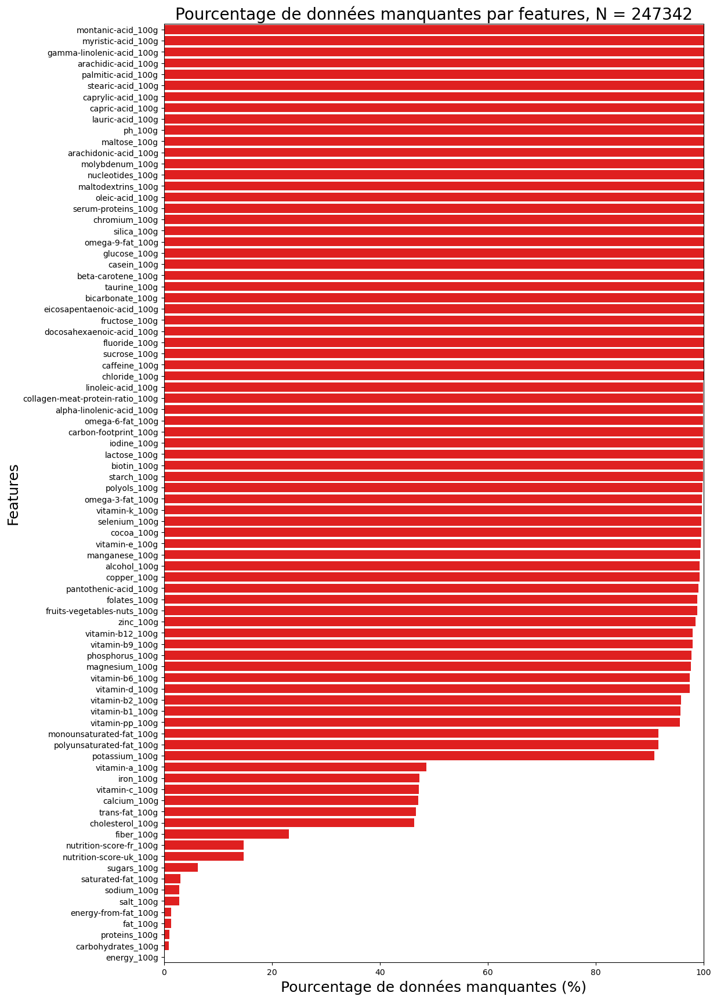

In [11]:
valeurs_manquantes_graph(data[poids_cols],'column')

Il y a 0 lignes où nous ne retrouvons aucune valeur entrée
Statistiques sur la complétude des données :


count    247342.000000
mean         17.950271
std           5.272164
min           1.190476
25%          14.285714
50%          20.238095
75%          21.428571
max          54.761905
dtype: float64

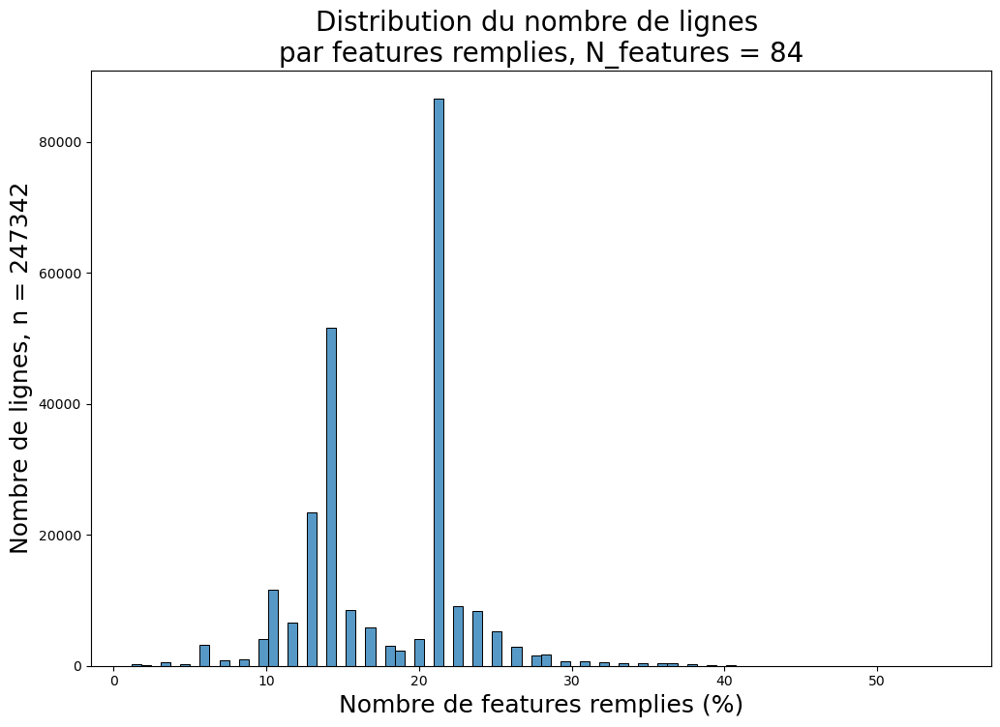

In [12]:
valeurs_manquantes_graph(data[poids_cols],"row")

Observation :  

    Un grand nombre de features sont peu complètes. 
    Pour la suite de l'analyse, nous garderons les features avec un degré de complétude > 30%

In [13]:
data_30 = copy.deepcopy(data) #Data avec moins de 70% de complétude

In [14]:
# On élimine les features avec moins de 30 % de complétude
poids_cols = [col for col in data.columns if "100g" in col]

data = eliminationFeature(data, 70, ">", poids_cols)
data_30 = eliminationFeature(data_30, 70, "<=", poids_cols)


On passe de 141 à 75 features
Avec cette liste de features éliminées :


4                   caprylic-acid_100g
5                     capric-acid_100g
6                     lauric-acid_100g
7                   myristic-acid_100g
8                   palmitic-acid_100g
9                    stearic-acid_100g
10                 arachidic-acid_100g
11                  montanic-acid_100g
12            monounsaturated-fat_100g
13            polyunsaturated-fat_100g
14                    omega-3-fat_100g
15           alpha-linolenic-acid_100g
16          eicosapentaenoic-acid_100g
17           docosahexaenoic-acid_100g
18                    omega-6-fat_100g
19                  linoleic-acid_100g
20               arachidonic-acid_100g
21           gamma-linolenic-acid_100g
22                    omega-9-fat_100g
23                     oleic-acid_100g
28                        sucrose_100g
29                        glucose_100g
30                       fructose_100g
31                        lactose_100g
32                        maltose_100g
33                  malto

On passe de 141 à 123 features
Avec cette liste de features éliminées :


0                 energy_100g
1        energy-from-fat_100g
2                    fat_100g
3          saturated-fat_100g
24             trans-fat_100g
25           cholesterol_100g
26         carbohydrates_100g
27                sugars_100g
36                 fiber_100g
37              proteins_100g
41                  salt_100g
42                sodium_100g
44             vitamin-a_100g
49             vitamin-c_100g
63               calcium_100g
65                  iron_100g
82    nutrition-score-fr_100g
83    nutrition-score-uk_100g
Name: Features, dtype: object

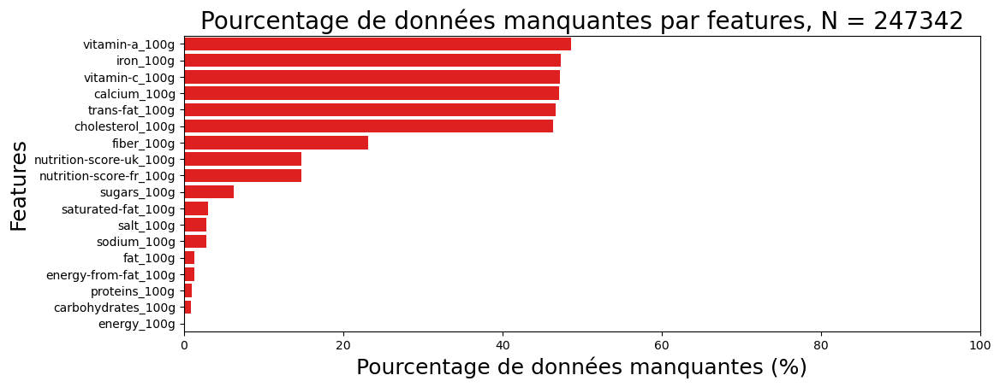

In [15]:
poids_cols = [col for col in data.columns if "100g" in col]

valeurs_manquantes_graph(data[poids_cols],'column')

Il y a 0 lignes où nous ne retrouvons aucune valeur entrée
Statistiques sur la complétude des données :


count    247342.000000
mean         80.276702
std          20.815151
min           5.555556
25%          66.666667
50%          83.333333
75%         100.000000
max         100.000000
dtype: float64

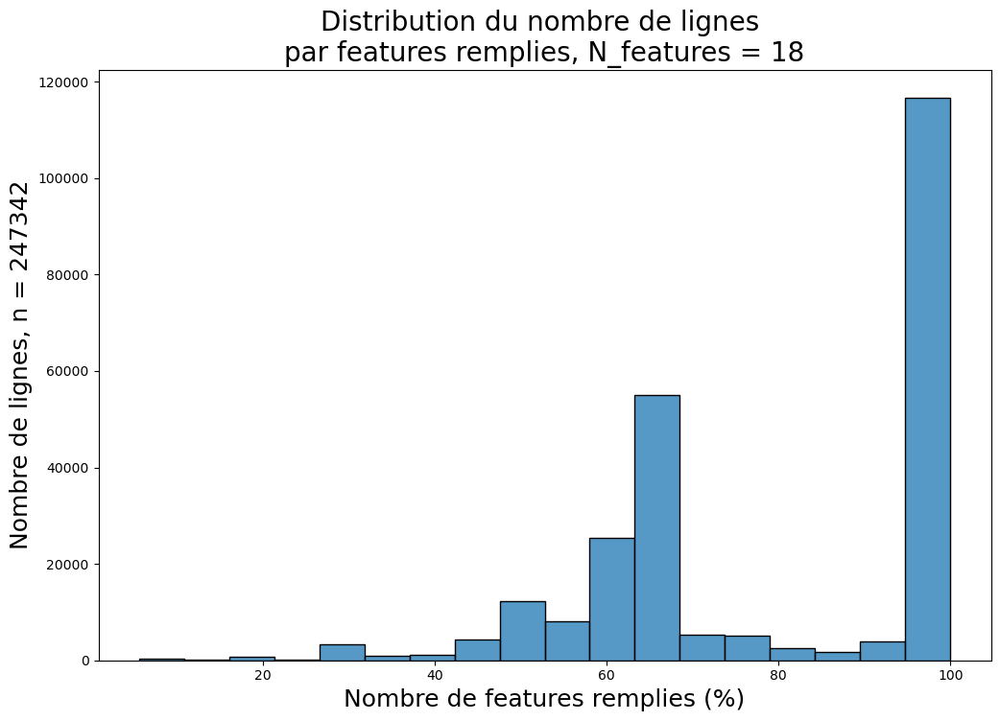

In [16]:
# On regarde le niveau de complétude des lignes après élimination des features
valeurs_manquantes_graph(data[poids_cols],"row")

**Observations**

- On observe qu'au moins 25% des produits ont 100 % des features avec une information.
- Quelques produits n'ont aucune information, on les élimine.


On passe de 247342 à 247342 lignes (- 0)
Il y a 0 lignes où nous ne retrouvons aucune valeur entrée
Statistiques sur la complétude des données :


count    247342.000000
mean         80.276702
std          20.815151
min           5.555556
25%          66.666667
50%          83.333333
75%         100.000000
max         100.000000
dtype: float64

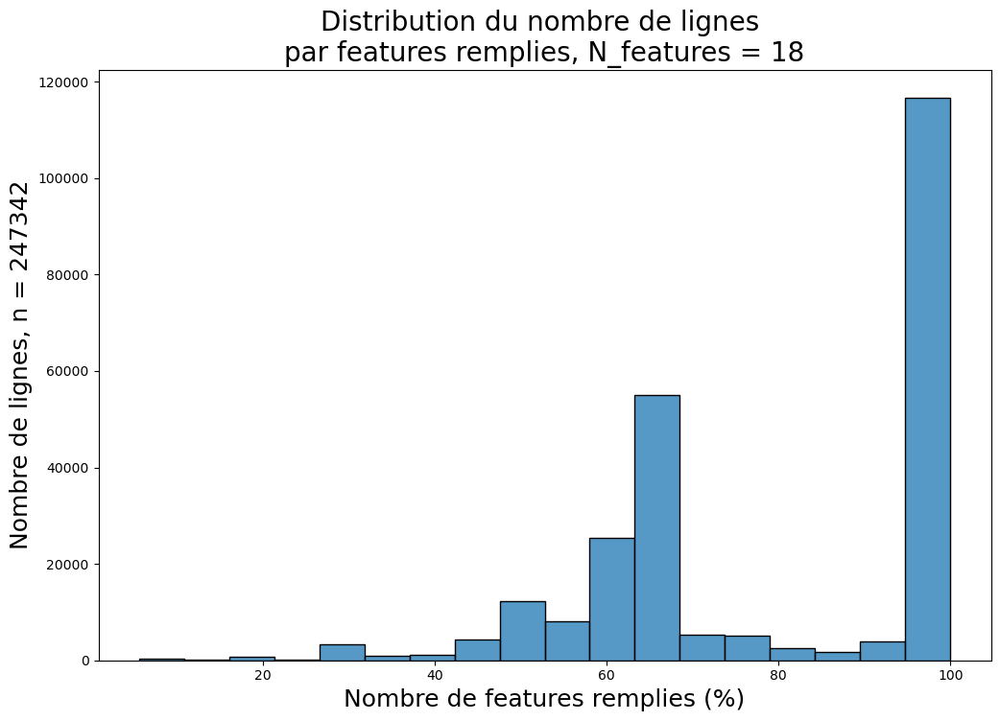

In [17]:
data = eliminationRows(data, 0, "==", poids_cols)

# On regarde le niveau de complétude des lignes après élimination des features
valeurs_manquantes_graph(data[poids_cols],"row")

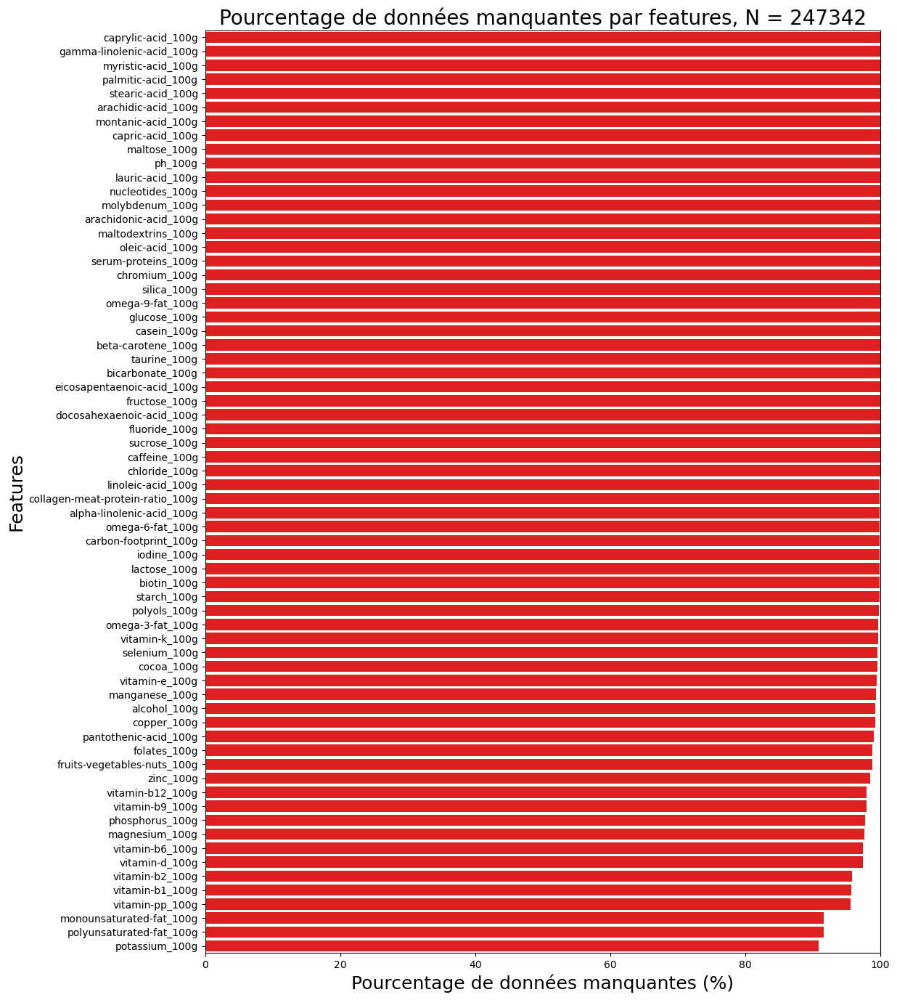

In [18]:
valeurs_manquantes_graph(data_30[[col for col in data_30.columns if "100g" in col]],'column')

On passe de 123 à 85 features
Avec cette liste de features éliminées :


0                   caprylic-acid_100g
1                     capric-acid_100g
2                     lauric-acid_100g
3                   myristic-acid_100g
4                   palmitic-acid_100g
5                    stearic-acid_100g
6                  arachidic-acid_100g
7                   montanic-acid_100g
11           alpha-linolenic-acid_100g
12          eicosapentaenoic-acid_100g
13           docosahexaenoic-acid_100g
14                    omega-6-fat_100g
15                  linoleic-acid_100g
16               arachidonic-acid_100g
17           gamma-linolenic-acid_100g
18                    omega-9-fat_100g
19                     oleic-acid_100g
20                        sucrose_100g
21                        glucose_100g
22                       fructose_100g
24                        maltose_100g
25                  maltodextrins_100g
28                         casein_100g
29                 serum-proteins_100g
30                    nucleotides_100g
32                  beta-

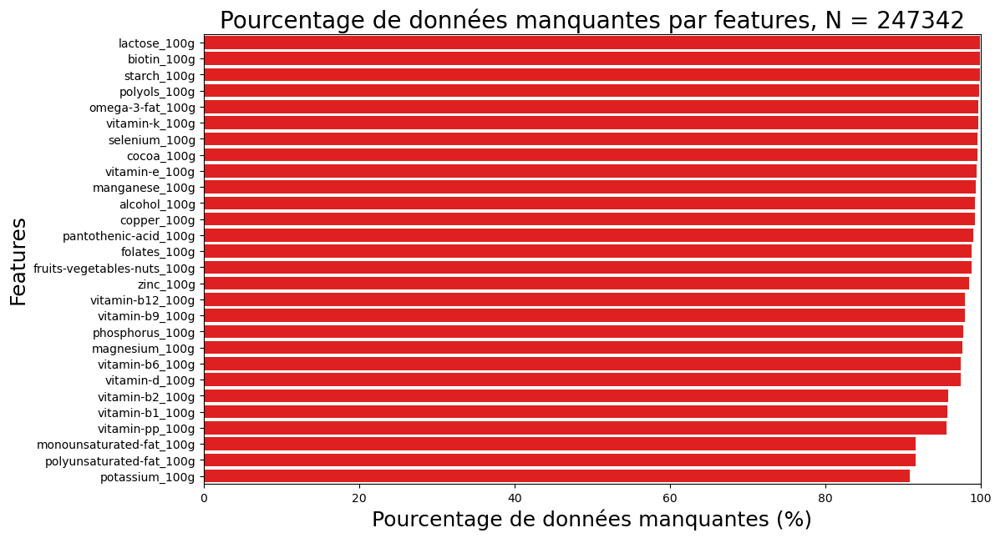

In [19]:
# On élimine les features avec moins de 0.1 % de complétude
poids_cols = [col for col in data_30.columns if "100g" in col]

data_30 = eliminationFeature(data_30, 99.9, ">", poids_cols)

valeurs_manquantes_graph(data_30[[col for col in data_30.columns if "100g" in col]],'column')

### <a name="T4C2">2. Réduction des features à forte corrélation</a>

On va analyser la corrélation entre features, si certaines features sont très corrélées, on en gardera qu'une seule

<AxesSubplot:>

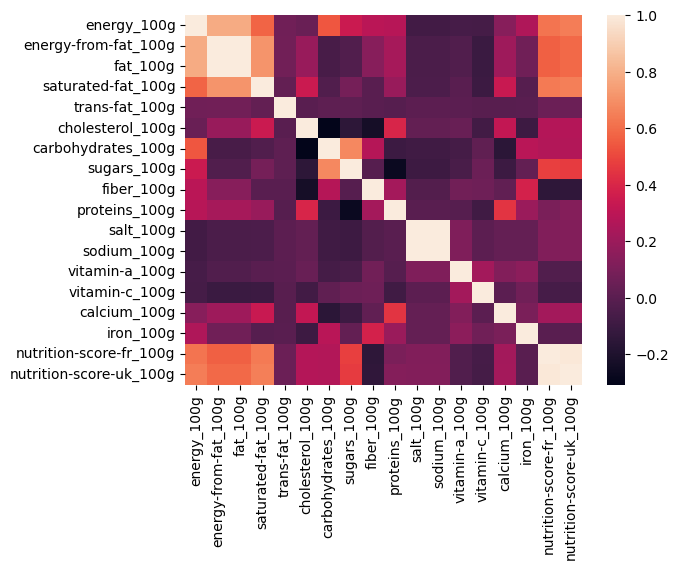

In [20]:
poids_cols = [col for col in data.columns if "100g" in col]

correlation = data[poids_cols].corr()

# plot the heatmap

sns.heatmap(correlation, xticklabels = correlation.columns, yticklabels = correlation.columns)

- energy-from-fat_100g et fat_100g sont très fortement corrélées. 
    **On ne va garder que fat_100g**
- sodium_100g et salt_100g sont fortement corrélées. 
    **On ne va garder que salt_100g**
- nutrition-score-fr_100g et nutrition-score-uk_100g sont fortement corrélées. 
    **On ne va garder que nutrition-score-fr_100g**

In [21]:
[data.pop(col) for col in ["energy-from-fat_100g", "nutrition-score-uk_100g", "sodium_100g"]]


[0         1077.089
 1          673.322
 2         2154.178
 3           53.911
 4          688.779
             ...   
 247337       0.000
 247338     324.220
 247339     324.220
 247340     128.180
 247341     128.180
 Name: energy-from-fat_100g, Length: 247342, dtype: float64,
 0         14.0
 1          0.0
 2         12.0
 3          NaN
 4          NaN
           ... 
 247337     NaN
 247338    10.0
 247339    10.0
 247340     9.0
 247341     9.0
 Name: nutrition-score-uk_100g, Length: 247342, dtype: float64,
 0         0.000000
 1         0.252051
 2         0.485955
 3              NaN
 4              NaN
             ...   
 247337    1.127173
 247338    3.730356
 247339    3.730356
 247340    0.535857
 247341    0.535857
 Name: sodium_100g, Length: 247342, dtype: float64]

In [22]:
# On élimine les lignes si aucune valeur

poids_cols = [col for col in data.columns if "100g" in col]

data = eliminationRows(data, 0, "==", poids_cols)

On passe de 247342 à 247342 lignes (- 0)


### <a name="T4C3">3. Elimination lignes</a>

In [23]:
elements = ["energy_100g", "carbohydrates_100g", "fat_100g", "salt_100g", "proteins_100g"]

data = eliminationRows(data, 0, "==", elements)

On passe de 247342 à 247342 lignes (- 0)


Il y a 0 lignes où nous ne retrouvons aucune valeur entrée
Statistiques sur la complétude des données :


count    247342.000000
mean         77.585287
std          23.074166
min           6.666667
25%          60.000000
50%          80.000000
75%         100.000000
max         100.000000
dtype: float64

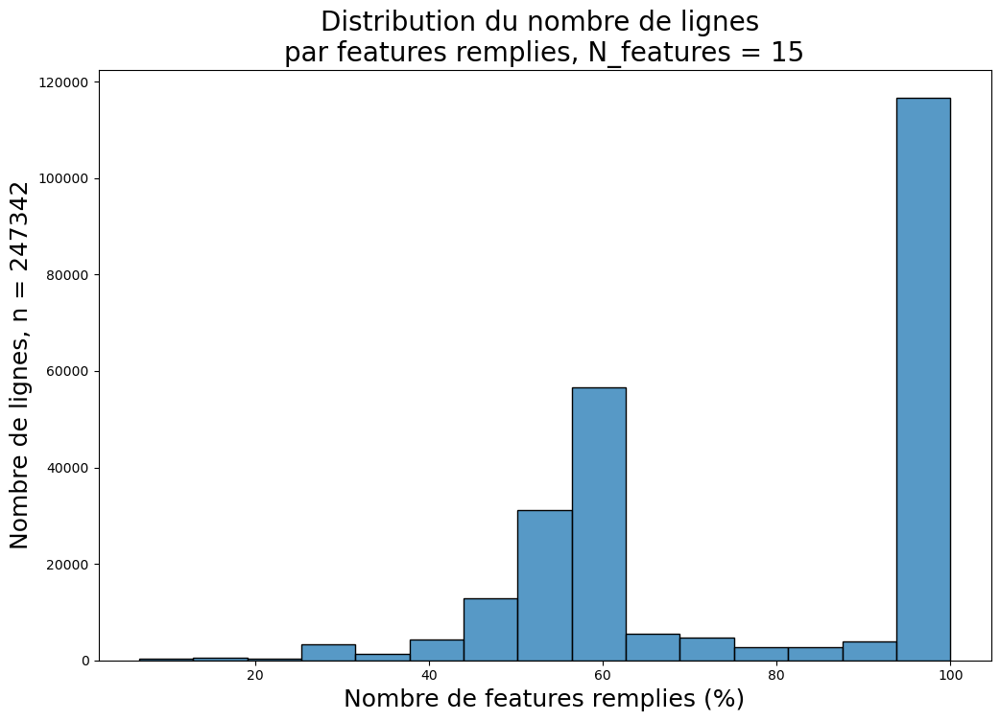

In [24]:
# On regarde le niveau de complétude des lignes après élimination des features

poids_cols = [col for col in data.columns if "100g" in col]

valeurs_manquantes_graph(data[poids_cols],"row")

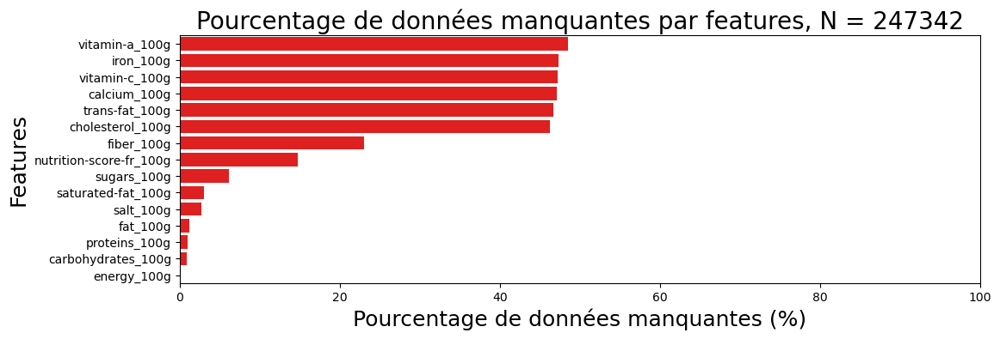

,energy_100g,fat_100g,saturated-fat_100g,trans-fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
count,247342.000000,244242.000000,239847.000000,131903.000000,132817.000000,245169.000000,232023.000000,190243.000000,244970.000000,240526.000000,127234.000000,130472.000000,130754.000000,130212.00000,210761.000000
mean,1102.106177,12.209357,4.628545,0.066263,0.018117,31.450284,15.852221,2.817088,7.107633,1.546113,0.000141,0.007989,0.092550,0.00184,9.186035
std,780.525856,16.604651,7.569950,0.869189,0.037362,28.653553,20.809978,4.437799,8.011948,6.032537,0.000484,0.038263,0.170858,0.00331,9.037711
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,-15.000000
25%,373.000000,0.100000,0.000000,0.000000,0.000000,6.000000,1.400000,0.000000,0.800000,0.068580,0.000000,0.000000,0.000000,0.00000,1.000000
50%,1048.000000,5.000000,1.250000,0.000000,0.000000,20.000000,5.830000,1.500000,5.000000,0.589280,0.000000,0.000000,0.036000,0.00105,10.000000
75%,1648.000000,19.570000,6.670000,0.000000,0.020000,57.140000,24.000000,3.600000,10.000000,1.361440,0.000107,0.003800,0.106000,0.00240,16.000000
max,3770.000000,100.000000,100.000000,83.000000,0.975000,100.000000,100.000000,100.000000,100.000000,100.000000,0.010179,1.200000,1.765000,0.05143,40.000000


In [25]:
poids_cols = [col for col in data.columns if "100g" in col]

valeurs_manquantes_graph(data[poids_cols],'column')

display(data[poids_cols].describe())

Maintenant que nous avons une sélection de features remplies.

Nous allons tenter de remplir les valeurs manquantes.

Plusieurs méthodes possibles.

- Remplissage par la moyenne / median

- Remplissage par machine learning

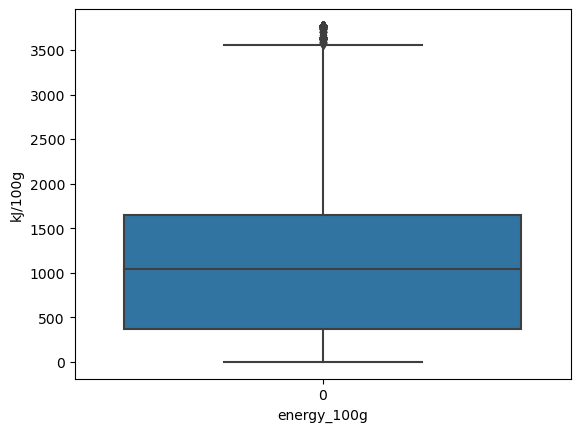

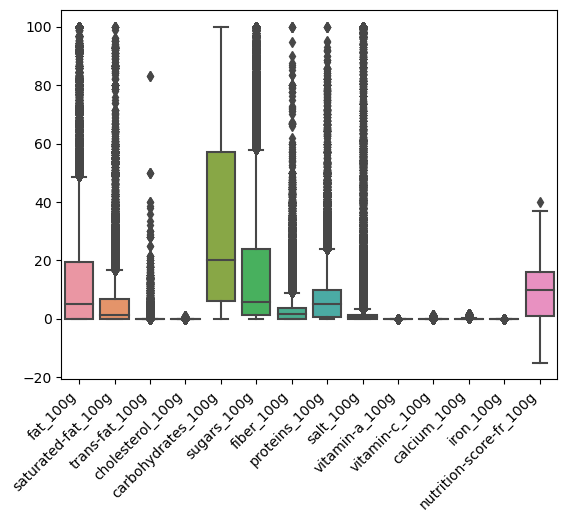

In [26]:
# Distributions des différentes métriques

sns.boxplot(data = data["energy_100g"]) 
plt.ylabel("kJ/100g")
plt.xlabel("energy_100g")
plt.show()

sns.boxplot(data = data[[col for col in poids_cols if col != "energy_100g"]]) 
plt.xticks(rotation=45, ha='right')
plt.show()

In [27]:
data_mean = copy.deepcopy(data)
data_median = copy.deepcopy(data)
for col in poids_cols:
    # On remplace les valeurs manquantes par la moyenne
    data_mean.loc[data_mean[col].isnull(), col] = data_mean[col].mean() 
    # On remplace les valeurs manquantes par la moyenne
    data_median.loc[data_median[col].isnull(), col] = data_median[col].median()
    
    result_test1 = stats.ttest_ind(data[col], data_mean[col], nan_policy = "omit")
    if result_test1[1] < 0.05:
        print("data VS moyenne(",col,")"" pvalue  =",result_test1[1])
    
    result_test2 = stats.ttest_ind(data[col], data_median[col], nan_policy = "omit")
    if result_test2[1] < 0.05:
        print("data VS median(",col,")"" pvalue  =",result_test2[1])

data VS median( saturated-fat_100g ) pvalue  = 2.046160922630901e-06
data VS median( trans-fat_100g ) pvalue  = 7.20989940703623e-36
data VS median( cholesterol_100g ) pvalue  = 0.0
data VS median( sugars_100g ) pvalue  = 1.4418415413226085e-25
data VS median( fiber_100g ) pvalue  = 6.4897725508583196e-127
data VS median( vitamin-a_100g ) pvalue  = 0.0
data VS median( vitamin-c_100g ) pvalue  = 1.1131689944711818e-260
data VS median( calcium_100g ) pvalue  = 0.0
data VS median( iron_100g ) pvalue  = 0.0
data VS median( nutrition-score-fr_100g ) pvalue  = 2.830189282781964e-06


On peut voir que seulement la médiane change significativement la distribution.

In [28]:
display(data[poids_cols].describe())    
display(data_mean[poids_cols].describe())
display(data_median[poids_cols].describe())

,energy_100g,fat_100g,saturated-fat_100g,trans-fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
count,247342.000000,244242.000000,239847.000000,131903.000000,132817.000000,245169.000000,232023.000000,190243.000000,244970.000000,240526.000000,127234.000000,130472.000000,130754.000000,130212.00000,210761.000000
mean,1102.106177,12.209357,4.628545,0.066263,0.018117,31.450284,15.852221,2.817088,7.107633,1.546113,0.000141,0.007989,0.092550,0.00184,9.186035
std,780.525856,16.604651,7.569950,0.869189,0.037362,28.653553,20.809978,4.437799,8.011948,6.032537,0.000484,0.038263,0.170858,0.00331,9.037711
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,-15.000000
25%,373.000000,0.100000,0.000000,0.000000,0.000000,6.000000,1.400000,0.000000,0.800000,0.068580,0.000000,0.000000,0.000000,0.00000,1.000000
50%,1048.000000,5.000000,1.250000,0.000000,0.000000,20.000000,5.830000,1.500000,5.000000,0.589280,0.000000,0.000000,0.036000,0.00105,10.000000
75%,1648.000000,19.570000,6.670000,0.000000,0.020000,57.140000,24.000000,3.600000,10.000000,1.361440,0.000107,0.003800,0.106000,0.00240,16.000000
max,3770.000000,100.000000,100.000000,83.000000,0.975000,100.000000,100.000000,100.000000,100.000000,100.000000,0.010179,1.200000,1.765000,0.05143,40.000000


,energy_100g,fat_100g,saturated-fat_100g,trans-fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
count,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000
mean,1102.106177,12.209357,4.628545,0.066263,0.018117,31.450284,15.852221,2.817088,7.107633,1.546113,0.000141,0.007989,0.092550,0.001840,9.186035
std,780.525856,16.500267,7.454374,0.634734,0.027379,28.527408,20.155248,3.892000,7.973438,5.948837,0.000347,0.027790,0.124226,0.002402,8.342659
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-15.000000
25%,373.000000,0.180000,0.000000,0.000000,0.000000,6.100000,1.670000,0.000000,0.810000,0.076200,0.000000,0.000000,0.032000,0.000900,2.000000
50%,1048.000000,5.170000,1.500000,0.000000,0.018117,20.285000,7.020000,2.700000,5.000000,0.630000,0.000141,0.007989,0.092550,0.001840,9.186035
75%,1648.000000,19.100000,6.400000,0.066263,0.018117,57.140000,22.000000,3.000000,10.000000,1.465580,0.000141,0.007989,0.092550,0.001840,15.000000
max,3770.000000,100.000000,100.000000,83.000000,0.975000,100.000000,100.000000,100.000000,100.000000,100.000000,0.010179,1.200000,1.765000,0.051430,40.000000


,energy_100g,fat_100g,saturated-fat_100g,trans-fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
count,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000,247342.000000
mean,1102.106177,12.119000,4.526168,0.035337,0.009728,31.349689,15.231500,2.513038,7.087421,1.519746,0.000073,0.004214,0.065895,0.001466,9.306418
std,780.525856,16.519748,7.476837,0.635594,0.028831,28.547412,20.299502,3.931371,7.976083,5.950898,0.000355,0.028075,0.127393,0.002434,8.347661
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-15.000000
25%,373.000000,0.180000,0.000000,0.000000,0.000000,6.100000,1.670000,0.000000,0.810000,0.076200,0.000000,0.000000,0.032000,0.000900,2.000000
50%,1048.000000,5.000000,1.250000,0.000000,0.000000,20.000000,5.830000,1.500000,5.000000,0.589280,0.000000,0.000000,0.036000,0.001050,10.000000
75%,1648.000000,19.100000,6.400000,0.000000,0.000000,57.140000,22.000000,3.000000,10.000000,1.330960,0.000000,0.000000,0.043000,0.001190,15.000000
max,3770.000000,100.000000,100.000000,83.000000,0.975000,100.000000,100.000000,100.000000,100.000000,100.000000,0.010179,1.200000,1.765000,0.051430,40.000000


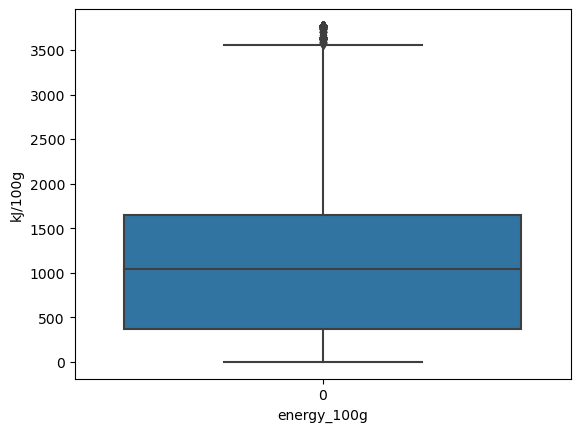

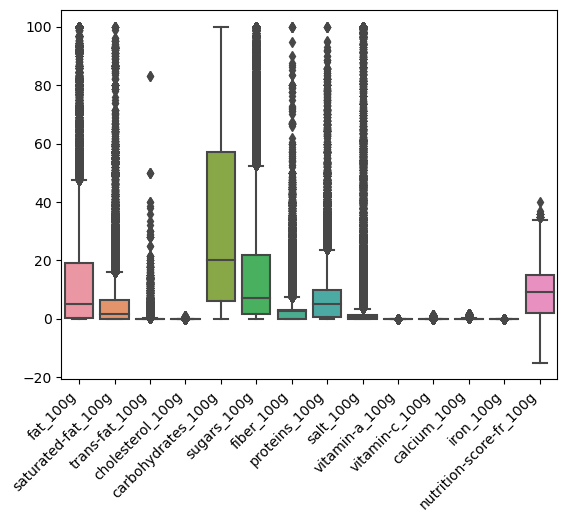

In [29]:
# Distributions des différentes métriques

sns.boxplot(data = data_mean["energy_100g"]) 
plt.ylabel("kJ/100g")
plt.xlabel("energy_100g")
plt.show()

sns.boxplot(data = data_mean[[col for col in poids_cols if col != "energy_100g"]]) 
plt.xticks(rotation=45, ha='right')
plt.show()


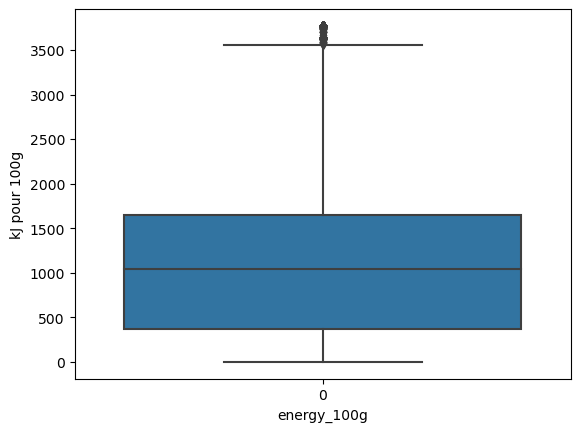

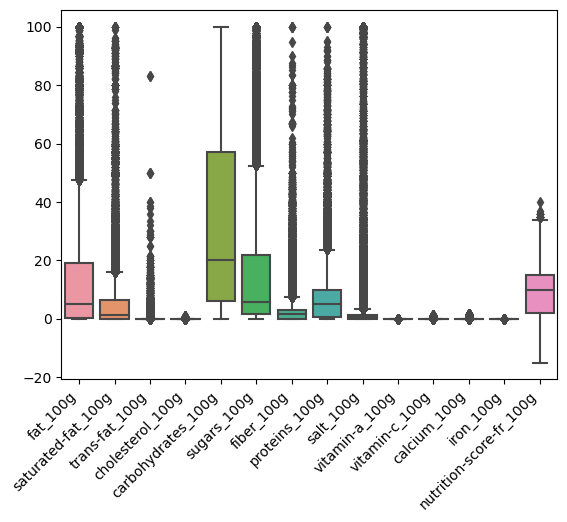

In [30]:
# Distributions des différentes métriques

sns.boxplot(data = data_median["energy_100g"]) 
plt.ylabel("kJ pour 100g")
plt.xlabel("energy_100g")
plt.show()

sns.boxplot(data = data_median[[col for col in poids_cols if col != "energy_100g"]]) 
plt.xticks(rotation=45, ha='right')
plt.show()


Il y a de grandes disparitées entre les produits.

Peut-être qu'ils peuvent être catégorisés.

Il existe deux features de catégorisation des produits : pnns_groups_1 et pnns_groups_2

On va d'abord s'intéresser à pnns_groups_1

### <a name = "T4C4">4. pnns1 : description des données</a>


In [31]:
display(data["pnns_groups_1"].count())
display(data["pnns_groups_1"].unique())

70770

array([nan, 'Fruits and vegetables', 'Sugary snacks', 'unknown',
       'Composite foods', 'Fish Meat Eggs', 'Beverages', 'Fat and sauces',
       'Cereals and potatoes', 'Milk and dairy products', 'Salty snacks',
       'fruits-and-vegetables', 'sugary-snacks', 'cereals-and-potatoes',
       'salty-snacks'], dtype=object)

Il y a des doublons dans les pnns_groups_1.

Et des unknowns.

Corrigeons les pnns_groups_1.

In [32]:
def correction_pnns1(df):
    # On met les textes en minuscules pour limiter les biais sur majuscule/minuscules
    df["pnns_groups_1"] = df["pnns_groups_1"].str.lower()

    # On élimine également les tirets
    df["pnns_groups_1"] = df["pnns_groups_1"].replace("fruits-and-vegetables", "fruits and vegetables")
    df["pnns_groups_1"] = df["pnns_groups_1"].replace("sugary-snacks", "sugary snacks")
    df["pnns_groups_1"] = df["pnns_groups_1"].replace("salty-snacks", "salty snacks")
    df["pnns_groups_1"] = df["pnns_groups_1"].replace("cereals-and-potatoes", "cereals and potatoes")

    df.loc[df["pnns_groups_1"] == "unknown", "pnns_groups_1"] = np.nan

    print(df["pnns_groups_1"].count(),"produits ont un pnns_groups_1 de renseignés.")
    display(df["pnns_groups_1"].unique())
    
    return df

In [33]:
data = correction_pnns1(data)

57865 produits ont un pnns_groups_1 de renseignés.


array([nan, 'fruits and vegetables', 'sugary snacks', 'composite foods',
       'fish meat eggs', 'beverages', 'fat and sauces',
       'cereals and potatoes', 'milk and dairy products', 'salty snacks'],
      dtype=object)

In [34]:
def distribution_pnns(df, pnns):
    
    print(pnns, "a cette distribution suivante au sein des échantillons")

    #On compte le nombre de produits par pnns
    mask = df[pnns].value_counts().reset_index()

    #On affiche ce compte
    plt.figure(figsize=(6,6))
    sns.barplot(data = mask, y = "index", x = pnns, color = "red", orient = "h")    
    if pnns == "pnns_groups_1":
        plt.title("Distribution de l'affiliation des produits selon le "+str(pnns), fontsize = 20)
    else :
        plt.title("Distribution de l'affiliation des produits,\n pnns_groups_1 = "+str(df.pnns_groups_1.unique()), fontsize = 20)
    plt.xlabel("Nombre de produits", fontsize=18)
    plt.ylabel(str(pnns), fontsize=18)
    plt.show()

pnns_groups_1 a cette distribution suivante au sein des échantillons


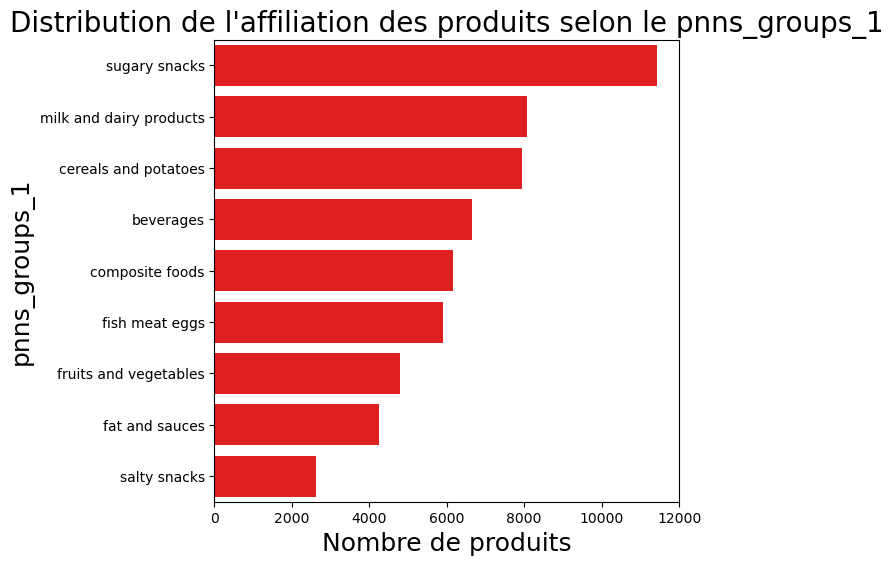

In [35]:
distribution_pnns(data, "pnns_groups_1")

Existe t'il une corrélation entre les pnns1 et les macronutriments ? 

In [36]:
def graphiquePNS_features(df, pnns_group):
    
    ## Fonction pour représenter la distribution des variables pour chaque pnns 
    
    ## On ne représente pas les produits sans pnns_groups
    dt = copy.deepcopy(df.loc[~df[pnns_group].isnull()])
    fig, axs = plt.subplots(dt[pnns_group].unique().shape[0],2, figsize = (12,60))

    liste_feat_majeur=["energy_100g", "fat_100g", "sugars_100g", "nutrition-score-fr_100g", "carbohydrates_100g", "saturated-fat_100g", "salt_100g", "fiber_100g","proteins_100g"]
    #liste_feat_mineur = [col for col in data.columns if (("100g" in col) & (col not in liste_feat_majeur))]

    i = 0

    for pnns1 in dt[pnns_group].unique(): 
        sous_data = dt[dt[pnns_group] == pnns1]
        for j in range(2):
            if j == 0 :
                sns.boxplot(data = sous_data[liste_feat_majeur[:1]], ax = axs[i,j]) 
                labels = liste_feat_majeur[:1]
            elif j == 1 :
                sns.boxplot(data = sous_data[liste_feat_majeur[1:]], ax = axs[i,j])  
                labels = liste_feat_majeur[1:]
            #elif j == 2 :
            #    sns.boxplot(data = sous_data[liste_feat_mineur], ax = axs[i,j]) 
            #    labels = liste_feat_mineur

            axs[i, j].set(xlabel='', title = pnns1)
            axs[i, j].set_xticklabels(labels = labels, rotation=45, ha='right')

        i += 1
    fig.tight_layout()



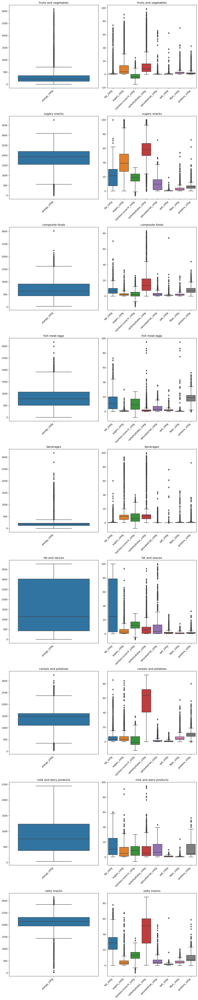

In [37]:
graphiquePNS_features(data, "pnns_groups_1")

On observe des différences sur les éléments macro selon le pnns, mais également sur quelques éléments micro.


In [38]:
def graphique_features_pnns(df, pnns_group, feat):
    
    ## Fonction pour représenter la distribution des variables pour chaque pnns 
    
    ## On ne représente pas les produits sans pnns_groups

    dt = copy.deepcopy(df.loc[~df[pnns_group].isnull()])

    fig, axs = plt.subplots(len(feat), figsize = (12, len(feat)* 8))

    for i, f in enumerate(feat): 
        
        #On représente chaque feature par rapport au pnns_group
        sns.boxplot(data = dt[[f, pnns_group]], y = f, ax = axs[i], x = pnns_group) 
    
        labels = dt[pnns_group].unique()
        
        axs[i].set(xlabel='', ylabel ='', title = f)
        
        axs[i].set_xticklabels(labels = labels, rotation=45, ha='right')

    fig.tight_layout()



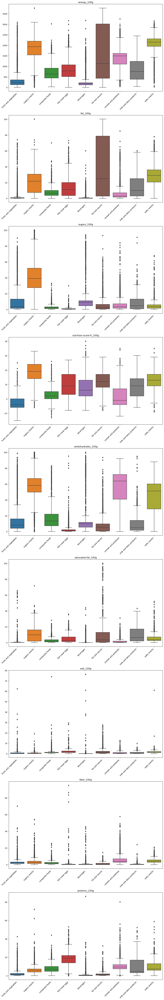

In [39]:
liste_feat_majeur = ["energy_100g", "fat_100g", "sugars_100g", "nutrition-score-fr_100g", "carbohydrates_100g", "saturated-fat_100g", "salt_100g", "fiber_100g","proteins_100g"]
graphique_features_pnns(data, "pnns_groups_1", liste_feat_majeur)


## Observation : 

Quand on analyse la répartition des macronutriments / pnns_groups_1, on observe que la distribution de certains des macronutriments est dépendant du pnns groups 1.

Un test ANOVA devrait le confirmer. 

Des concentrations en sel > 10g /100 devraient être rare.

In [40]:
from scipy.stats import f_oneway

In [41]:
def anova_oneway_pnns(df, feature, pnns_groups):
    
    liste_pnns = df[pnns_groups].unique()
    
    result = f_oneway(*[df[df[pnns_groups] == pnns][feature] for pnns in liste_pnns])
    
    print(result, "pour la feature :", feature)

In [42]:
liste_feat_majeur=["energy_100g", "fat_100g", "sugars_100g", "nutrition-score-fr_100g", "carbohydrates_100g", "saturated-fat_100g", "salt_100g", "fiber_100g","proteins_100g"]

for feat in liste_feat_majeur:
    anova_oneway_pnns(data[(data.pnns_groups_1.notnull()) & (data[feat].notnull())], feat, "pnns_groups_1")
    

F_onewayResult(statistic=7477.060950936131, pvalue=0.0) pour la feature : energy_100g
F_onewayResult(statistic=3575.0219752731387, pvalue=0.0) pour la feature : fat_100g
F_onewayResult(statistic=8103.803390824458, pvalue=0.0) pour la feature : sugars_100g
F_onewayResult(statistic=5854.675364896896, pvalue=0.0) pour la feature : nutrition-score-fr_100g
F_onewayResult(statistic=13557.966952347517, pvalue=0.0) pour la feature : carbohydrates_100g
F_onewayResult(statistic=2002.6403011462642, pvalue=0.0) pour la feature : saturated-fat_100g
F_onewayResult(statistic=1210.23770640345, pvalue=0.0) pour la feature : salt_100g
F_onewayResult(statistic=1123.7673177296372, pvalue=0.0) pour la feature : fiber_100g
F_onewayResult(statistic=6426.933653015529, pvalue=0.0) pour la feature : proteins_100g


Les résultats des ANOVA montrent que le PNNS1 influe sur les features. Pour lesquelles salt et fiber sera la moins visible et carbohydrate la plus visible.

On pourrait aller plus loin et comparer chaque feature entre elles par pnns1.


Une ACP devrait nous permettre  de séparer les pnns_groups_1 avec les features.

In [43]:
#Qu'en est-il des features peu remplies? 
liste_feat_mineur = [col for col in data_30.columns if "100g" in col ]

for feat in liste_feat_mineur:
    print(data_30[feat].count(), feat)
    anova_oneway_pnns(data_30[(data_30.pnns_groups_1.notnull()) & (data_30[feat].notnull())], feat, "pnns_groups_1")
    

20815 monounsaturated-fat_100g
F_onewayResult(statistic=236.8170379932966, pvalue=0.0) pour la feature : monounsaturated-fat_100g
20818 polyunsaturated-fat_100g
F_onewayResult(statistic=127.63615218330196, pvalue=9.564581282557261e-227) pour la feature : polyunsaturated-fat_100g
848 omega-3-fat_100g
F_onewayResult(statistic=14.809084918160929, pvalue=2.368726477741121e-22) pour la feature : omega-3-fat_100g
288 lactose_100g
F_onewayResult(statistic=5.468469384003888, pvalue=2.5753493762791933e-05) pour la feature : lactose_100g
300 starch_100g
F_onewayResult(statistic=17.79155917909877, pvalue=7.161402688700364e-27) pour la feature : starch_100g
417 polyols_100g
F_onewayResult(statistic=7.931194462062185, pvalue=4.498583918905125e-08) pour la feature : polyols_100g
1812 alcohol_100g
F_onewayResult(statistic=1.9461915194086326, pvalue=0.030118919657454876) pour la feature : alcohol_100g
6371 vitamin-d_100g
F_onewayResult(statistic=24.160644839306563, pvalue=1.6508592189379383e-30) pour 

57865 produits ont un pnns_groups_1 de renseignés.


array([nan, 'fruits and vegetables', 'sugary snacks', 'composite foods',
       'fish meat eggs', 'beverages', 'fat and sauces',
       'cereals and potatoes', 'milk and dairy products', 'salty snacks'],
      dtype=object)

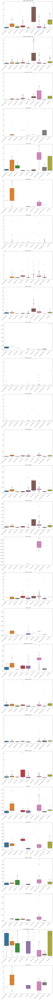

In [44]:
data_30 = correction_pnns1(data_30)

poids_cols = [col for col in data_30.columns if "100g" in col]

graphique_features_pnns(data_30, "pnns_groups_1", poids_cols)

On vient de regarder les valeurs par rapport aux pnns.

Qu'en est il des proportions ?

In [45]:
stacked = data_30.groupby("pnns_groups_1")[poids_cols].count()
pnns_count = data_30.groupby("pnns_groups_1")["pnns_groups_1"].count()
display(stacked / stacked.sum(axis = 0) * 100)
display(stacked / pnns_count.values[0] * 100)

,monounsaturated-fat_100g,polyunsaturated-fat_100g,omega-3-fat_100g,lactose_100g,starch_100g,polyols_100g,alcohol_100g,vitamin-d_100g,vitamin-e_100g,vitamin-k_100g,...,pantothenic-acid_100g,potassium_100g,phosphorus_100g,magnesium_100g,zinc_100g,copper_100g,manganese_100g,selenium_100g,fruits-vegetables-nuts_100g,cocoa_100g
pnns_groups_1,,,,,,,,,,,,,,,,,,,,,
beverages,9.156493,9.340045,2.017291,36.746988,0.806452,1.533742,18.711656,19.947849,20.543093,10.526316,...,34.693878,29.753915,8.407080,14.113390,14.718615,11.290323,11.111111,22.0,22.739726,0.588813
cereals and potatoes,14.317425,14.653244,4.610951,1.807229,41.935484,3.987730,15.874233,21.642764,11.097993,10.526316,...,46.485261,20.357942,47.197640,37.635706,57.142857,27.419355,37.037037,32.0,2.922374,0.588813
composite foods,3.607103,3.747204,3.025937,0.000000,4.838710,0.000000,14.263804,0.521512,0.354191,5.263158,...,0.453515,3.355705,1.474926,1.688782,0.432900,0.000000,5.555556,14.0,16.757991,0.000000
fat and sauces,26.082131,26.454139,22.046110,0.602410,2.016129,0.920245,6.825153,13.037810,34.002361,5.263158,...,0.226757,1.789709,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,2.557078,0.000000
fish meat eggs,11.154273,12.304251,60.518732,0.602410,1.209677,0.000000,5.674847,3.650587,2.243211,0.000000,...,0.453515,2.460850,4.719764,0.844391,2.597403,3.225806,1.851852,18.0,1.187215,0.000000
fruits and vegetables,2.053274,2.069351,0.144092,0.000000,1.612903,0.613497,5.981595,0.000000,4.014168,21.052632,...,2.040816,11.409396,5.752212,6.151990,2.597403,9.677419,11.111111,0.0,12.876712,0.196271
milk and dairy products,5.382908,5.369128,4.755043,33.132530,4.435484,0.306748,14.263804,34.810952,2.951594,31.578947,...,3.854875,7.382550,8.702065,1.568154,5.194805,4.838710,5.555556,8.0,14.840183,0.294406
salty snacks,11.653718,11.744966,1.008646,0.000000,2.016129,0.000000,2.070552,0.000000,2.715466,5.263158,...,0.000000,7.382550,5.162242,5.186972,3.896104,11.290323,14.814815,0.0,0.821918,0.000000
sugary snacks,16.592675,14.317673,1.873199,27.108434,41.129032,92.638037,16.334356,6.388527,22.077922,10.526316,...,11.791383,16.107383,18.584071,32.810615,13.419913,32.258065,12.962963,6.0,25.296804,98.331698


,monounsaturated-fat_100g,polyunsaturated-fat_100g,omega-3-fat_100g,lactose_100g,starch_100g,polyols_100g,alcohol_100g,vitamin-d_100g,vitamin-e_100g,vitamin-k_100g,...,pantothenic-acid_100g,potassium_100g,phosphorus_100g,magnesium_100g,zinc_100g,copper_100g,manganese_100g,selenium_100g,fruits-vegetables-nuts_100g,cocoa_100g
pnns_groups_1,,,,,,,,,,,,,,,,,,,,,
beverages,2.477477,2.507508,0.210210,0.915916,0.030030,0.075075,3.663664,2.297297,2.612613,0.030030,...,2.297297,1.996997,0.855856,1.756757,0.510511,0.105105,0.090090,0.165165,7.477477,0.090090
cereals and potatoes,3.873874,3.933934,0.480480,0.045045,1.561562,0.195195,3.108108,2.492492,1.411411,0.030030,...,3.078078,1.366366,4.804805,4.684685,1.981982,0.255255,0.300300,0.240240,0.960961,0.090090
composite foods,0.975976,1.006006,0.315315,0.000000,0.180180,0.000000,2.792793,0.060060,0.045045,0.015015,...,0.030030,0.225225,0.150150,0.210210,0.015015,0.000000,0.045045,0.105105,5.510511,0.000000
fat and sauces,7.057057,7.102102,2.297297,0.015015,0.075075,0.045045,1.336336,1.501502,4.324324,0.015015,...,0.015015,0.120120,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.840841,0.000000
fish meat eggs,3.018018,3.303303,6.306306,0.015015,0.045045,0.000000,1.111111,0.420420,0.285285,0.000000,...,0.030030,0.165165,0.480480,0.105105,0.090090,0.030030,0.015015,0.135135,0.390390,0.000000
fruits and vegetables,0.555556,0.555556,0.015015,0.000000,0.060060,0.030030,1.171171,0.000000,0.510511,0.060060,...,0.135135,0.765766,0.585586,0.765766,0.090090,0.090090,0.090090,0.000000,4.234234,0.030030
milk and dairy products,1.456456,1.441441,0.495495,0.825826,0.165165,0.015015,2.792793,4.009009,0.375375,0.090090,...,0.255255,0.495495,0.885886,0.195195,0.180180,0.045045,0.045045,0.060060,4.879880,0.045045
salty snacks,3.153153,3.153153,0.105105,0.000000,0.075075,0.000000,0.405405,0.000000,0.345345,0.015015,...,0.000000,0.495495,0.525526,0.645646,0.135135,0.105105,0.120120,0.000000,0.270270,0.000000
sugary snacks,4.489489,3.843844,0.195195,0.675676,1.531532,4.534535,3.198198,0.735736,2.807808,0.030030,...,0.780781,1.081081,1.891892,4.084084,0.465465,0.300300,0.105105,0.045045,8.318318,15.045045


La présence de certains micro nutriments semble associée au pnns 1. Un test statistique pourrait le confirmer.

### <a name = "T4C5">5. pnns1 : description des données par une ACP</a>


In [46]:
def ACP_generator(dataframe, critere, option = True):
    # option = True or False, permet de remplacer par la moyenne les valeurs manquantes ou non
    # Par défaut = True
    # critere = feature sur laquelle l'ACP sera dirigée
    
    df = preparation_ACP(dataframe, critere)
    
    features = df.columns
    
    if(option == True):
        ## on remplace les valeurs manquantes par la moyenne 
        moyenneRemplacement(df)
        
    else:
        ## on ne garde que les lignes où l'ensemble des valeurs sont présentes
        df = df[df[features].isnull().sum(axis = 1) == 0]
        
    X = df.values
    
    scaler = StandardScaler()
    
    X_scaled = scaler.fit_transform(X)
    
    n_components = len(features)
    
    pca = PCA(n_components=n_components)
    
    pca.fit(X_scaled)
    # On génére un Eboulis
    scree_cum = graphEboulis(pca, n_components)
    # On génére un tableau des corrélation
    graphCorrAcp(pca, features)
    
    #PCA sur les composantes F1 et F2
    correlation_graph(pca, (0,1), features)
    #PCA sur les composantes F3 et F4
    correlation_graph(pca, (2,3), features)
    if scree_cum < 60:
        #PCA sur les composantes F5 et F6
        correlation_graph(pca, (4,5), features)
    
    X_proj = pca.transform(X_scaled)
    # On projete
    display_factorial_planes(X_proj, [0,1], pca, figsize=(12,12), clusters=df.index, marker="o")
    
    display_factorial_planes(X_proj, [2,3], pca, figsize=(12,12), clusters=df.index, marker="o")
    if scree_cum < 60:
        #PCA sur les composantes F5 et F6
        display_factorial_planes(X_proj, [4,5], pca, figsize=(12,12), clusters=df.index, marker="o")
    
def graphEboulis(pca, n_components):
        
    scree = (pca.explained_variance_ratio_*100).round(2)
    
    scree_cum = scree.cumsum().round()
    
    x_list = range(1, n_components+1)
    list(x_list)
    
    plt.bar(x_list, scree)
    
    plt.plot(x_list, scree_cum,c="red",marker='o')
    
    plt.xlabel("rang de l'axe d'inertie")
    
    plt.ylabel("pourcentage d'inertie")
    
    plt.title("Eboulis des valeurs propres")
    
    plt.show(block=False)
    
    return scree_cum[3]
    
def moyenneRemplacement(df):
    for col in df.columns :
        # On remplace la valeur manquante par la moyenne
        moyenne = df.loc[~df[col].isnull(), col].mean()
            
        df.loc[df[col].isnull(), col] = moyenne 
            
def preparation_ACP(df, critere):
    # On clean le dataframe à envoyer pour ACP
    
    # On récupère les features ayant comme informations les valeurs nutritives (+nutriscore)
    features = [col for col in df.columns if "100g" in col]
    df = df[features + [critere]].set_index(critere)
    
    # On récupère le pourcentage de valeur manquantes
    valeur_manquantes = []
    
    for col in df.columns:
        valeur_manquantes.append([col, df[col].isnull().sum()/df.shape[0]*100])
        
    valeur_manquantes = pd.DataFrame(valeur_manquantes, columns = ["Col", "Pourcent"])

    # On élimine quand en dessous de 50 %
    valeur_manquantes = valeur_manquantes.loc[valeur_manquantes["Pourcent"] < 50, "Col"]
    
    # Actualise le dataframe avec nos colonnes d'intérêts
    df = df[valeur_manquantes.values]
    
    return df

def graphCorrAcp(pca, features):
    pcs = pca.components_
    
    pcs = pd.DataFrame(pcs)
    
    pcs.columns = features
    
    x_list = range(1, len(features)+1)
    
    list(x_list)
    
    pcs.index = [f"F{i}" for i in x_list]
    
    pcs.round(2)

    fig, ax = plt.subplots(figsize=(20, 6))
    sns.heatmap(pcs.T, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")

In [47]:
def correlation_graph(pca, 
                      x_y, 
                      features) : 
    """Affiche le graphe des correlations

    Positional arguments : 
    -----------------------------------
    pca : sklearn.decomposition.PCA : notre objet PCA qui a été fit
    x_y : list ou tuple : le couple x,y des plans à afficher, exemple [0,1] pour F1, F2
    features : list ou tuple : la liste des features (ie des dimensions) à représenter
    """

    # Extrait x et y 
    x,y=x_y

    # Taille de l'image (en inches)
    fig, ax = plt.subplots(figsize=(10, 9))

    # Pour chaque composante : 
    for i in range(0, pca.components_.shape[1]):

        # Les flèches
        ax.arrow(0,0, 
                pca.components_[x, i],  
                pca.components_[y, i],  
                head_width=0.07,
                head_length=0.07, 
                width=0.02, )

        # Les labels
        plt.text(pca.components_[x, i] + 0.05,
                pca.components_[y, i] + 0.05,
                features[i])
        
    # Affichage des lignes horizontales et verticales
    plt.plot([-1, 1], [0, 0], color='grey', ls='--')
    plt.plot([0, 0], [-1, 1], color='grey', ls='--')

    # Nom des axes, avec le pourcentage d'inertie expliqué
    plt.xlabel('F{} ({}%)'.format(x+1, round(100*pca.explained_variance_ratio_[x],1)))
    plt.ylabel('F{} ({}%)'.format(y+1, round(100*pca.explained_variance_ratio_[y],1)))

    # J'ai copié collé le code sans le lire
    plt.title("Cercle des corrélations (F{} et F{})".format(x+1, y+1))

    # Le cercle 
    an = np.linspace(0, 2 * np.pi, 100)
    plt.plot(np.cos(an), np.sin(an))  # Add a unit circle for scale

    # Axes et display
    plt.axis('equal')
    plt.show(block=False)

In [48]:
def display_factorial_planes(   X_projected, 
                                x_y, 
                                pca=None, 
                                labels = None,
                                clusters=None, 
                                alpha=1,
                                figsize=[10,8], 
                                marker="." ):
    """
    Affiche la projection des individus

    Positional arguments : 
    -------------------------------------
    X_projected : np.array, pd.DataFrame, list of list : la matrice des points projetés
    x_y : list ou tuple : le couple x,y des plans à afficher, exemple [0,1] pour F1, F2

    Optional arguments : 
    -------------------------------------
    pca : sklearn.decomposition.PCA : un objet PCA qui a été fit, cela nous permettra d'afficher la variance de chaque composante, default = None
    labels : list ou tuple : les labels des individus à projeter, default = None
    clusters : list ou tuple : la liste des clusters auquel appartient chaque individu, default = None
    alpha : float in [0,1] : paramètre de transparence, 0=100% transparent, 1=0% transparent, default = 1
    figsize : list ou tuple : couple width, height qui définit la taille de la figure en inches, default = [10,8] 
    marker : str : le type de marker utilisé pour représenter les individus, points croix etc etc, default = "."
    """

    # Transforme X_projected en np.array
    X_ = np.array(X_projected)

    # On définit la forme de la figure si elle n'a pas été donnée
    if not figsize: 
        figsize = (7,6)

    # On gère les labels
    if  labels is None : 
        labels = []
    try : 
        len(labels)
    except Exception as e : 
        raise e

    # On vérifie la variable axis 
    if not len(x_y) ==2 : 
        raise AttributeError("2 axes sont demandées")   
    if max(x_y )>= X_.shape[1] : 
        raise AttributeError("la variable axis n'est pas bonne")   

    # on définit x et y 
    x, y = x_y

    # Initialisation de la figure       
    fig, ax = plt.subplots(1, 1, figsize=figsize)

    # On vérifie s'il y a des clusters ou non
    c = None if clusters is None else clusters
 
    # Les points    
    # plt.scatter(   X_[:, x], X_[:, y], alpha=alpha, 
    #                     c=c, cmap="Set1", marker=marker)
    sns.scatterplot(data=None, x=X_[:, x], y=X_[:, y], hue=c)

    # Si la variable pca a été fournie, on peut calculer le % de variance de chaque axe 
    if pca : 
        v1 = str(round(100*pca.explained_variance_ratio_[x]))  + " %"
        v2 = str(round(100*pca.explained_variance_ratio_[y]))  + " %"
    else : 
        v1=v2= ''

    # Nom des axes, avec le pourcentage d'inertie expliqué
    ax.set_xlabel(f'F{x+1} {v1}')
    ax.set_ylabel(f'F{y+1} {v2}')

    # Valeur x max et y max
    x_max = np.abs(X_[:, x]).max() *1.1
    y_max = np.abs(X_[:, y]).max() *1.1

    # On borne x et y 
    ax.set_xlim(left=-x_max, right=x_max)
    ax.set_ylim(bottom= -y_max, top=y_max)

    # Affichage des lignes horizontales et verticales
    plt.plot([-x_max, x_max], [0, 0], color='grey', alpha=0.8)
    plt.plot([0,0], [-y_max, y_max], color='grey', alpha=0.8)

    # Affichage des labels des points
    if len(labels) : 
        for i,(_x,_y) in enumerate(X_[:,[x,y]]):
            plt.text(_x, _y+0.05, labels[i], fontsize='14', ha='center',va='center') 

    # Titre et display
    plt.title(f"Projection des individus (sur F{x+1} et F{y+1})")
    plt.show()



In [49]:
mask = copy.deepcopy(data.loc[(~data["pnns_groups_1"].isnull()) & (data["pnns_groups_1"] != "unknown")])
display(mask["pnns_groups_1"].unique())

poids_cols = [col for col in data.columns if "100g" in col]

display(mask[poids_cols].describe())

array(['fruits and vegetables', 'sugary snacks', 'composite foods',
       'fish meat eggs', 'beverages', 'fat and sauces',
       'cereals and potatoes', 'milk and dairy products', 'salty snacks'],
      dtype=object)

,energy_100g,fat_100g,saturated-fat_100g,trans-fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
count,57865.000000,56815.000000,54223.000000,1352.000000,1471.000000,56958.000000,54082.000000,34714.000000,56814.000000,54057.000000,1529.000000,2315.000000,3559.000000,2133.000000,52640.000000
mean,1091.737543,13.339060,5.460816,0.106670,0.016643,27.804139,13.396337,2.753090,7.448246,0.853978,0.000213,0.019847,0.214962,0.004470,8.510220
std,797.401094,17.340103,8.437118,0.731229,0.044408,27.350947,18.746982,3.953647,7.225881,1.581529,0.000564,0.041180,0.253015,0.005132,9.250362
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-15.000000
25%,372.000000,1.000000,0.200000,0.000000,0.000000,4.500000,1.100000,0.400000,1.600000,0.050800,0.000000,0.000000,0.084750,0.000864,1.000000
50%,997.000000,6.000000,1.800000,0.000000,0.000000,14.000000,4.500000,1.700000,5.900000,0.500000,0.000063,0.012000,0.120000,0.003000,8.000000
75%,1647.000000,21.700000,7.800000,0.000000,0.010550,53.600000,17.000000,3.570000,10.390000,1.200000,0.000212,0.024000,0.240000,0.007000,15.000000
max,3770.000000,100.000000,100.000000,17.200000,0.432000,100.000000,100.000000,94.800000,86.000000,76.200000,0.010000,1.200000,1.670000,0.037100,40.000000


Certains des micros éléments sont peu représentés dans les groupes pnns 1.

Dans un premier temps, ils ne seront pas utilisés dans l'analyse ACP PNNS_1.

Si nous arrivons à remplir plus les PNNS_1, nous ferons une nouvelle ACP, prenant en compte ces éléments.

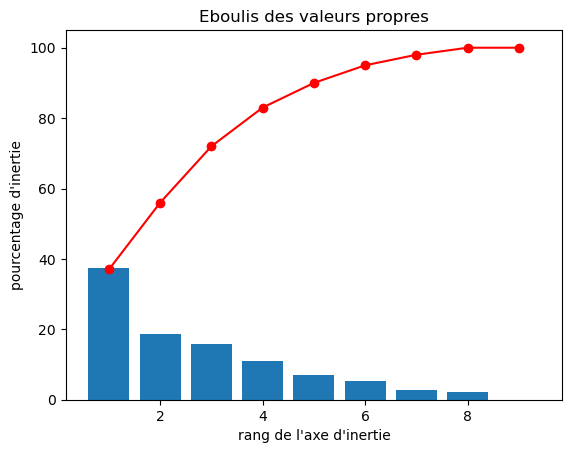

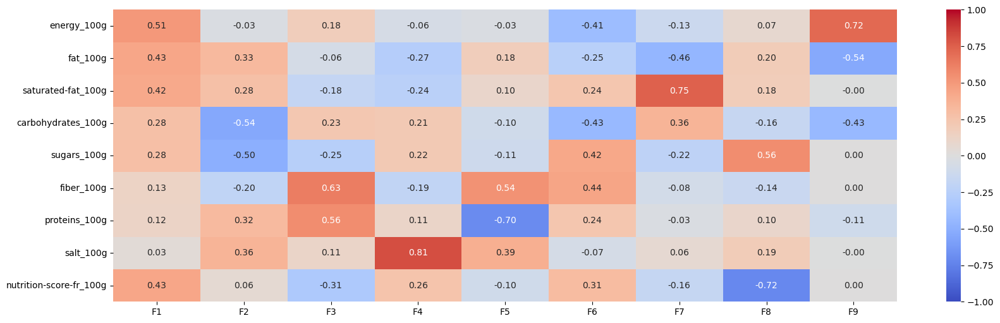

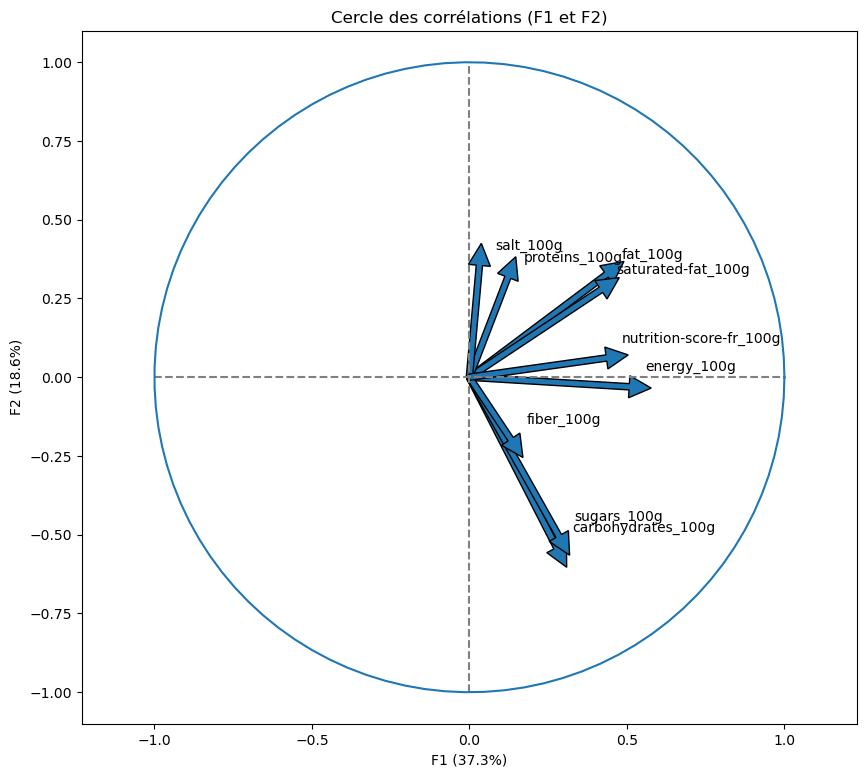

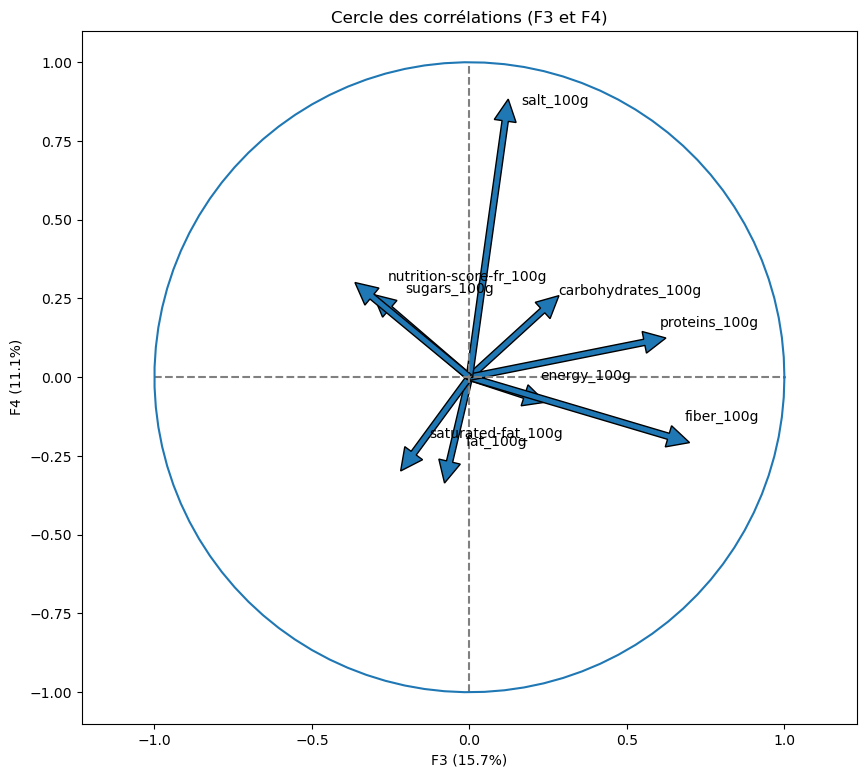

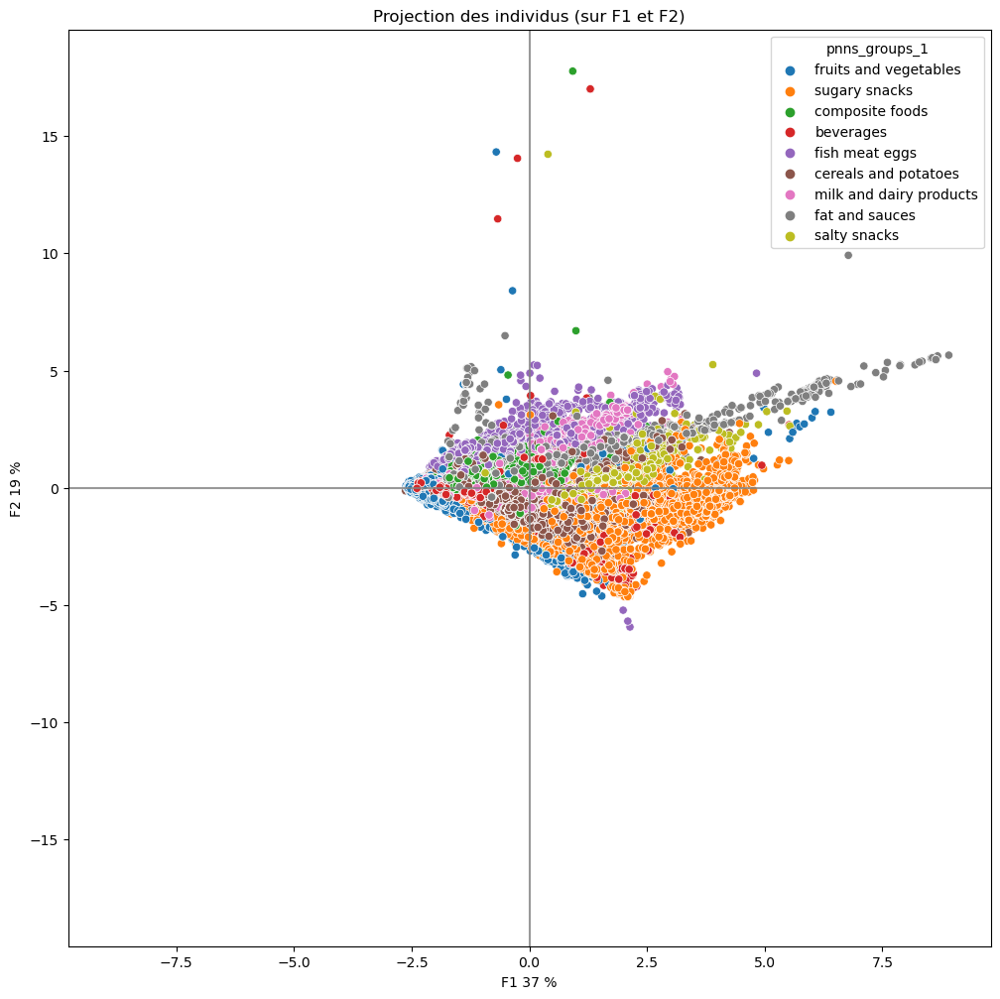

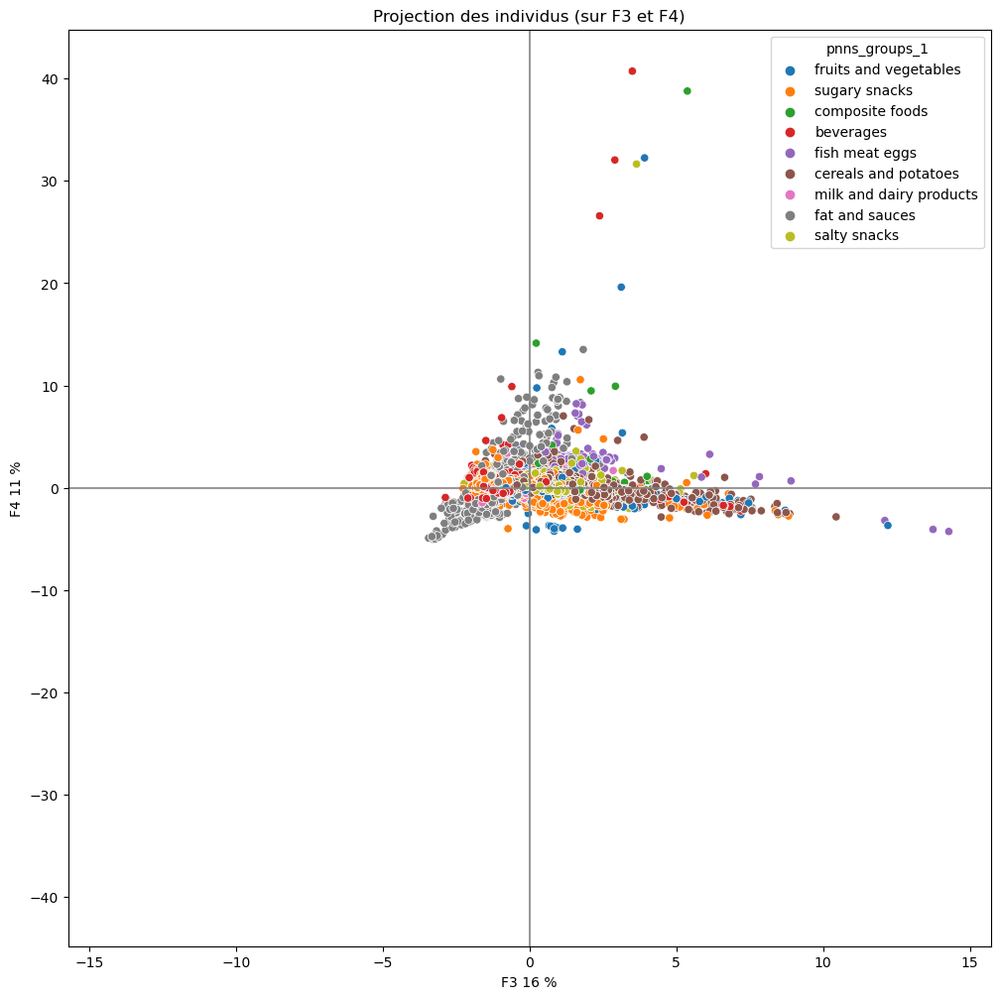

In [50]:
ACP_generator(mask, "pnns_groups_1", False)

## Commentaire ACP :

Axes d'inerties F1 à F4 rend comptent de 80 % de l'inertie total (On ne va s'intéresser qu'à ces plans), avec F1 et F2 qui totalisent presque 60 %.

Fat et saturated Fat se confondent sur F1, F2, F3 et F4. Nous pouvons donc en éliminer un, car similaire.

Carbohydrates et sugars se confondent sur F1, F2 et F4 mais pas sur F3.

Commentaires similaires pour d'autres.

Donc on peut juste réduire d'une feature (sans compter les autres qui n'ont pas pu être pris dans l'analyse).

Sur la projection des individus, on voit clairement que les groupes se séparent (quelques points proches).

On va tenter de donner une annotation pnns_groups_1 aux produits qui n'en avaient pas.

A la suite de cela, nous allons faire un nouvel ACP.

Et remplir les valeurs manquantes.


### <a name = "T4C6">6. pnns1 : évalution d'un remplissage par la méthode knn (global vs simple)</a>

L'ACP a montré que les PNNS_1 pouvaient être différenciés par leur composition en macro-éléments.

En utilisant une classification (knn), on devrait être capable de remplir les pnns_groups_1

##### Modèle global 
On va dans un premier temps tester si l'utilisation d'un knn permet de remplir les pnns_groups_1 avec un faible taux d'erreurs.

In [51]:
# on importe différente librairies

from sklearn.model_selection import train_test_split
from sklearn import linear_model
from sklearn import neighbors

In [52]:
#On ne garde que les données ayant un pnns non nulle
dt = copy.deepcopy(data.loc[~data["pnns_groups_1"].isnull()])
display(dt["pnns_groups_1"].unique())

array(['fruits and vegetables', 'sugary snacks', 'composite foods',
       'fish meat eggs', 'beverages', 'fat and sauces',
       'cereals and potatoes', 'milk and dairy products', 'salty snacks'],
      dtype=object)

In [53]:
#Liste de features d'intérêts (Choix selon les résultats de l'ACP)
liste_feat=["energy_100g", "fat_100g", "nutrition-score-fr_100g", "carbohydrates_100g", "salt_100g",'sugars_100g', "fiber_100g","proteins_100g"]
#On ne garde que nos colonnes d'intérêts
dt = dt[liste_feat + ["pnns_groups_1"]]

display(dt.shape)

(57865, 9)

In [54]:
# On enlève les lignes  qui ne sont pas remplies à 100 %
dt = dt[dt.isnull().sum(axis = 1) == 0]
dt

,energy_100g,fat_100g,nutrition-score-fr_100g,carbohydrates_100g,salt_100g,sugars_100g,fiber_100g,proteins_100g,pnns_groups_1
161,1210.00,12.000,6.0,23.00,2.160000,0.000,2.000,22.00,fruits and vegetables
164,1090.00,11.327,9.0,38.70,0.647000,24.700,2.000,3.33,sugary snacks
166,478.00,6.790,2.0,7.86,0.499000,0.714,0.357,5.36,composite foods
194,1284.00,7.000,10.0,54.20,0.199898,44.000,4.700,3.90,sugary snacks
195,177.00,0.000,13.0,10.40,0.025400,10.400,0.000,0.00,beverages
...,...,...,...,...,...,...,...,...,...
247335,76.10,0.000,-4.0,4.55,0.088500,4.000,0.000,0.00,beverages
247338,1538.00,8.600,10.0,62.90,9.398000,1.300,10.000,15.20,cereals and potatoes
247339,1538.00,8.600,10.0,62.90,9.398000,1.300,10.000,15.20,cereals and potatoes
247340,382.02,3.400,9.0,7.40,1.350000,1.800,5.600,7.80,salty snacks


On ne travail plus que sur 33010 lignes. Un autre modèle de machine learning nous permettrait de remplir avec des valeurs nulles.

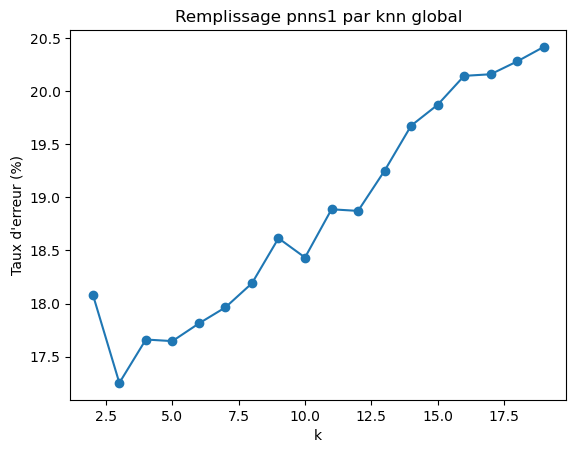

In [55]:
# train_size : on sépare les données en : 80 % pour l'entraînement et 20 % la validation
xtrain, xtest, ytrain, ytest = train_test_split(dt[liste_feat], dt['pnns_groups_1'], train_size=0.8)

# on mesure le taux d'erreurs du modèle pour un knn de 2 à 20 
errors_global = []
for k in range(2, 20):
    print(k)
    knn = neighbors.KNeighborsClassifier(k)
    errors_global.append(100*(1 - knn.fit(xtrain, ytrain).score(xtest, ytest)))
plt.plot(range(2,20), errors_global, 'o-')

clear_output(wait=True)

plt.title("Remplissage pnns1 par knn global")
plt.xlabel("k")
plt.ylabel("Taux d'erreur (%)")
plt.show()


k compris entre 3 et 6 permet d'avoir un taux d'erreur faible. Cependant, cet erreur reste élevé (~17-19%)

#### Modèle simple

On fait un knn cette fois ci en comparant un pnns1 précis à la fois. Le reste étant "autre"

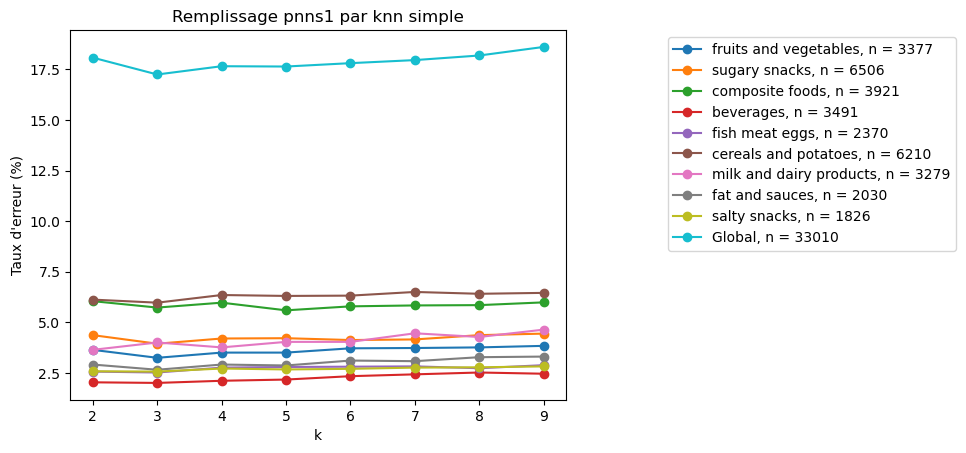

In [56]:
dt_simple = copy.deepcopy(dt)

for pnns in dt.pnns_groups_1.unique():
    dt_simple = copy.deepcopy(dt)
    dt_simple.loc[dt_simple.pnns_groups_1 != pnns, "pnns_groups_1"] = "Autre"
    display(dt_simple.pnns_groups_1.unique())
    xtrain, xtest, ytrain, ytest = train_test_split(dt_simple[liste_feat], dt_simple['pnns_groups_1'], train_size=0.8)
    nb = dt[dt['pnns_groups_1'] == pnns].shape[0]
    errors = []
    
    for k in range(2, 10):
        print(pnns, k)
        knn = neighbors.KNeighborsClassifier(k)
        errors.append(100*(1 - knn.fit(xtrain, ytrain).score(xtest, ytest)))
    
    
    
    plt.plot(range(2,10), errors, 'o-', label = pnns + ", n = " + str(nb))
    #plt.legend(loc="upper right", bbox_to_anchor = (1.8,1))

plt.plot(range(2,10), errors_global[:8], 'o-', label = "Global" + ", n = " + str(dt.shape[0]))

plt.legend(loc="upper right", bbox_to_anchor = (1.8,1))

clear_output(wait=True)
plt.title("Remplissage pnns1 par knn simple")
plt.xlabel("k")
plt.ylabel("Taux d'erreur (%)")
plt.show()

L'erreur quand on catégorise individuellement est plus faible, entre 2 et 7 %. Ce qui est bien meilleur que la valeur globale. Néanmoins, il faudrait quantifier l'erreur global après remplissage.

3 groupes de pnns 1 se distinguent.

Salty snacks, beverage et fish meat eggs semblent être ceux avec le moins d'erreur (2-3%)

Puis sugary snacks, milk and dairy, fruits and vegetable et fat and sauces (3-4 %)

Et enfin composite foods et cereals and potatoes (6-7 %)



On va remplir les pnns individuellement et non avec une fonction globale

### <a name = "T4C7">7. pnns1 : remplissage par la méthode knn simple </a>


Fonctions pour remplir les pnns (1 et 2)


In [57]:
def knn_pnns_simple(df, liste_feat, type_pnns):
    # Création  d'une liste  contenant les prédictions 
    prediction = []
    # On conserve le pourcentage d'erreur par pnns
    error = []

    pnns_group = df.loc[~df[type_pnns].isnull(),type_pnns]
    # On va faire une prédiction pour chaque pnns
    for i, pnns in enumerate(pnns_group.unique()):

        #clear_output(wait=True)
        print(type_pnns,": ", pnns)
        print(i+1, "/", len(pnns_group.unique()))

        # on copie notre dataframe
        dt = copy.deepcopy(df.loc[~df[type_pnns].isnull()])

        # On remplace le pnns1 des autres, pour n'avoir que 2 valeurs possibles
        dt.loc[dt[type_pnns] != pnns, type_pnns] = "Autre"

        # On sépare en datasets train et test. Ce qui va permettre de mesurer le taux d'erreur
        xtrain, xtest, ytrain, ytest = train_test_split(dt[liste_feat], dt[type_pnns], train_size=0.8)

        # Données préliminaires ont montré qu'un knn = 3 était satisfaisant
        knn = neighbors.KNeighborsClassifier(n_neighbors=3)

        # On entraîne notre modèle 
        knn.fit(xtrain, ytrain)

        error.append([pnns, (1 - knn.score(xtest, ytest)) * 100])

        # On fait la prédiction sur l'ensemble des données
        prediction.append([df.index, pnns, knn.predict(df[liste_feat])])

    #Etapes de réduction de la liste

    prediction = [[prediction[j][1], prediction[j][0][i], prediction[j][2][i]] for j in range(len(prediction)) for i in range(len(prediction[j][0]))]
    # Transformation en DataFrame
    prediction = pd.DataFrame(prediction, columns = [type_pnns,"Indexes","Prediction"])
    # Elimination des prédictions "Autre"
    prediction = prediction.loc[prediction["Prediction"] != "Autre"]
    # Elimination des prédictions quand il y en a plusieurs de proposé
    prediction = prediction.drop_duplicates(subset= "Indexes")
    # On fait le remplacement sur les valeurs nulles
    df = knn_pnn_remplacement(df, prediction, type_pnns)
    
    print("Une prédiction a pu être réalisé sur %d produits" %prediction.shape[0])
    print("\n%d produits n'ont donc pas d'affiliation" %(df.shape[0] - prediction.shape[0]))
    print("\nPourcentage d'erreur par",type_pnns,"sur training set :" )
    print([str(i) + "\n" for i in error])
    
    # Affiche la distribution des pnns
    distribution_pnns(df, type_pnns)
    
    return df
    

In [58]:
def knn_pnns_global(df, liste_feat, type_pnns):

    # on copie notre dataframe
    dt = copy.deepcopy(df.loc[~df[type_pnns].isnull()])

    # On sépare en datasets train et test. Ce qui va permettre de mesurer le taux d'erreur
    xtrain, xtest, ytrain, ytest = train_test_split(dt[liste_feat], dt[type_pnns], train_size=0.8)

    # Données préliminaires ont montré qu'un knn = 3 était satisfaisant
    knn = neighbors.KNeighborsClassifier(n_neighbors=3)

    # On entraîne notre modèle 
    knn.fit(xtrain, ytrain)

    error = (1 - knn.score(xtest, ytest)) * 100

    # On fait la prédiction sur l'ensemble des données
    prediction = [df.index, knn.predict(df[liste_feat])]
    
    # Transformation
    prediction = np.array(prediction).T.tolist()
    
    # Transformation en DataFrame
    prediction = pd.DataFrame(prediction, columns = ["Indexes","Prediction"])
    
    # On fait le remplacement sur les valeurs nulles
    df = knn_pnn_remplacement(df, prediction, type_pnns)
    
    print("Une prédiction a pu être réalisé sur %d produits" %prediction.shape[0])
    print("\n%d produits n'ont donc pas d'affiliation" %(df.shape[0] - prediction.shape[0]))
    print("\nPourcentage d'erreur par sur training set :", error )
    
    return df

In [59]:
def knn_pnn_remplacement(df, prediction, type_pnns):
    
    # On va mettre à jour la valeur des pnn1 qui n'avaient pas de valeurs
    nb_debut = df[df[type_pnns].isnull()].shape[0]

    # on créé un dictionnaire pour faire remplacement
    dict_lookup = dict(zip(prediction["Indexes"], prediction["Prediction"]))
    
    df[type_pnns] = pd.Series(dict_lookup)
       
    nb_fin = df[df[type_pnns].isnull()].shape[0]

    print(nb_debut  - nb_fin, "lignes modifiées")
    
    return df

In [60]:
def Pourcentage_Erreur(df, df_test, pnns):
    
    indexe = df_test[df_test[pnns].notnull()].index
    indexe2 = df[df[pnns].notnull()].index
    
    mask1 = df[(df.index.isin(indexe)) & (df.index.isin(indexe2))]
    mask2 = df_test[(df_test.index.isin(indexe)) & (df_test.index.isin(indexe2))]
    
    difference = mask2[pnns].compare(mask1[pnns]).shape[0]
    
    pourcentage_erreur = difference/mask2.shape[0]* 100
    
    return pourcentage_erreur
    

In [61]:
def remplissage_knn(df, pnns, liste_feat, simple = True):
    
    # On créé une copie de notre dataframe pour le remplissage
    dataframe_remplissage = copy.deepcopy(df)
    # On met à 0 le pnns_group
    dataframe_remplissage[pnns] = np.nan
    
    # On ne prend en compte que les lignes où les features sont remplies à 100 %
    condition = df[liste_feat].isnull().sum(axis = 1) == 0
    
    if(simple == True):
        ## On appel notre fonction pour remplir notre pnns groupe.
        dataframe_remplis = knn_pnns_simple(df[condition], liste_feat, pnns)
    else :
        dataframe_remplis = knn_pnns_global(df[condition], liste_feat, pnns) 
        
    ## Puis on remplace les valeurs manquantes sur notre dataframe
    dataframe_remplissage = dataframe_remplissage.combine_first(dataframe_remplis)
    
    return dataframe_remplissage

In [62]:
## Fonction permettant de remplir le knn en plusieurs étapes

def knn_pnns1_Etapes(df, liste_feat_simple, liste_feat_complexe, pnns):
    
    df_originel = copy.deepcopy(df)
    
    # Première étape - affinage - simple# 
    print("Etape 1")
    dataframe_remplissage1 = remplissage_knn(df_originel, pnns, liste_feat_simple)
    
    # Seconde étape - affinage - complexe#
    print("Etape 2")
    dataframe_remplissage2 = remplissage_knn(dataframe_remplissage1, pnns, liste_feat_complexe)
    
    # Troisième étape - remplissage complexe #
    print("Etape 3")
    dataframe_remplissage3 = remplissage_knn(dataframe_remplissage2, pnns, liste_feat_complexe)   
    
    #On réinitialise df
    df['pnns_groups_1'] = np.nan
    
    # On rempli df par les valeurs du dataframe 3
    df = df.combine_first(dataframe_remplissage3)
    
    # Quatrième étape - remplissage simple #
    print("Etape 4")
    dataframe_remplissage4 = remplissage_knn(df, pnns, liste_feat_simple)    
    
    # On complète df par les valeurs du dataframe 4
    df = df.combine_first(dataframe_remplissage4)
    
    # Remplissage des dernières valeurs NaN par méthode globale
    
        # Cinquième étape - remplissage simple #
    print("Etape 5")
    dataframe_remplissage5 = remplissage_knn(df, pnns, liste_feat_complexe, False)   
    
    # On complète df par les valeurs du dataframe 5
    df = df.combine_first(dataframe_remplissage5)
    
        # Sixième étape - remplissage simple #
    print("Etape 6")
    dataframe_remplissage6 = remplissage_knn(df, pnns, liste_feat_simple, False)  
    
    # On complète df par les valeurs du dataframe 6
    df = df.combine_first(dataframe_remplissage6)
    
    ## On évalue le pourcentage d'erreur
    
    eval_erreur = [dataframe_remplissage1, dataframe_remplissage2, dataframe_remplissage3, dataframe_remplissage4, dataframe_remplissage5, dataframe_remplissage6, df]
    
    for i, dataframes in enumerate(eval_erreur):
        pourcen = Pourcentage_Erreur(dataframes, df_originel, pnns)
        print("Etape n°:",i+1,"\tPourcentage d'erreur :", pourcen)
    
    
    return df
    

In [63]:
test1 = copy.deepcopy(data)
test2 = copy.deepcopy(data)

Etape 1
pnns_groups_1 :  fruits and vegetables
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  sugary snacks
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  composite foods
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  beverages
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fish meat eggs
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  cereals and potatoes
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fat and sauces
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  salty snacks
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

132037 lignes modifiées
Une prédiction a pu être réalisé sur 165047 produits

15752 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_1 sur training set :
["['fruits and vegetables', 3.5292335655861873]\n", "['sugary snacks', 3.9230536201151134]\n", "['composite foods', 6.301120872462896]\n", "['beverages', 1.9236594971220877]\n", "['fish meat eggs', 2.756740381702516]\n", "['cereals and potatoes', 5.9981823689791]\n", "['milk and dairy products', 3.6655558921538933]\n", "['fat and sauces', 2.62041805513481]\n", "['salty snacks', 1.9842471978188447]\n"]
pnns_groups_1 a cette distribution suivante au sein des échantillons


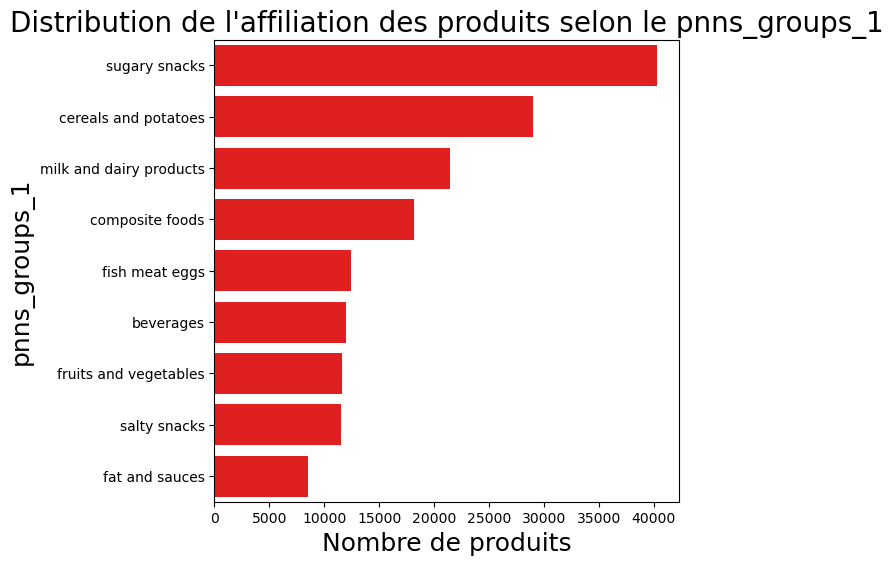

Etape 2
pnns_groups_1 :  salty snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  sugary snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fruits and vegetables
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  composite foods
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  milk and dairy products
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  beverages
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fish meat eggs
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

8772 lignes modifiées
Une prédiction a pu être réalisé sur 117087 produits

2102 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_1 sur training set :
["['salty snacks', 0.7201218667774567]\n", "['cereals and potatoes', 2.169597931957712]\n", "['sugary snacks', 1.8603148225084243]\n", "['fruits and vegetables', 0.9647786548492854]\n", "['composite foods', 1.6156580344365956]\n", "['milk and dairy products', 1.6156580344365956]\n", "['beverages', 0.6785763744633688]\n", "['fish meat eggs', 0.7247380325901331]\n", "['fat and sauces', 1.0294049762267443]\n"]
pnns_groups_1 a cette distribution suivante au sein des échantillons


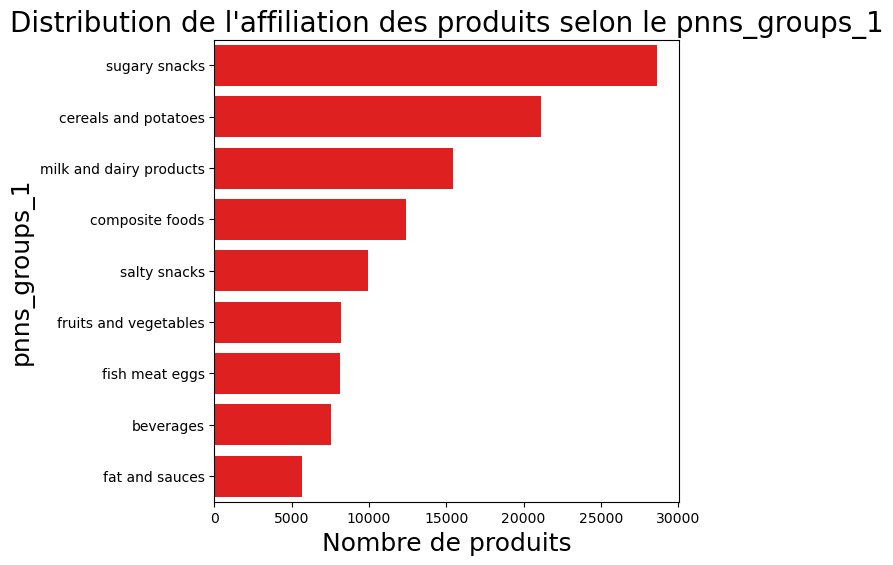

Etape 3
pnns_groups_1 :  salty snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  sugary snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fruits and vegetables
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  composite foods
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  milk and dairy products
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  beverages
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fish meat eggs
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

865 lignes modifiées
Une prédiction a pu être réalisé sur 117952 produits

1237 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_1 sur training set :
["['salty snacks', 0.431292168417452]\n", "['cereals and potatoes', 1.0163122384490575]\n", "['sugary snacks', 0.9693398240669615]\n", "['fruits and vegetables', 0.5551285336066303]\n", "['composite foods', 0.9906909215133708]\n", "['milk and dairy products', 0.8625843368349151]\n", "['beverages', 0.4142112904603312]\n", "['fish meat eggs', 0.4014006319924879]\n", "['fat and sauces', 0.4868050217781139]\n"]
pnns_groups_1 a cette distribution suivante au sein des échantillons


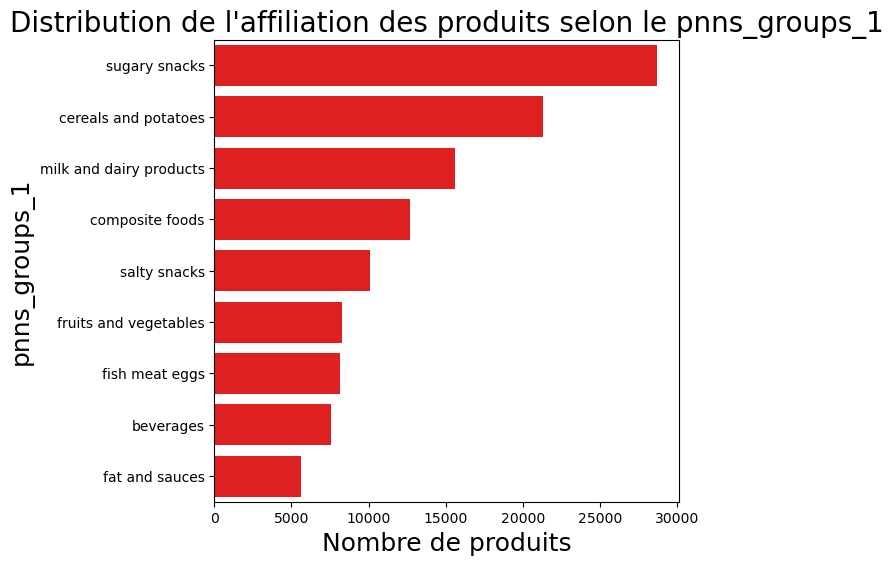

Etape 4
pnns_groups_1 :  salty snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  sugary snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fruits and vegetables
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  composite foods
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  milk and dairy products
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  beverages
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fish meat eggs
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

60209 lignes modifiées
Une prédiction a pu être réalisé sur 178161 produits

2638 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_1 sur training set :
["['salty snacks', 0.22890085201984212]\n", "['cereals and potatoes', 0.7418083167309519]\n", "['sugary snacks', 0.6443135093891716]\n", "['fruits and vegetables', 0.3136789453605182]\n", "['composite foods', 0.7926751727353687]\n", "['milk and dairy products', 0.7418083167309519]\n", "['beverages', 0.3221567546945914]\n", "['fish meat eggs', 0.33487346869568446]\n", "['fat and sauces', 0.37726251536602806]\n"]
pnns_groups_1 a cette distribution suivante au sein des échantillons


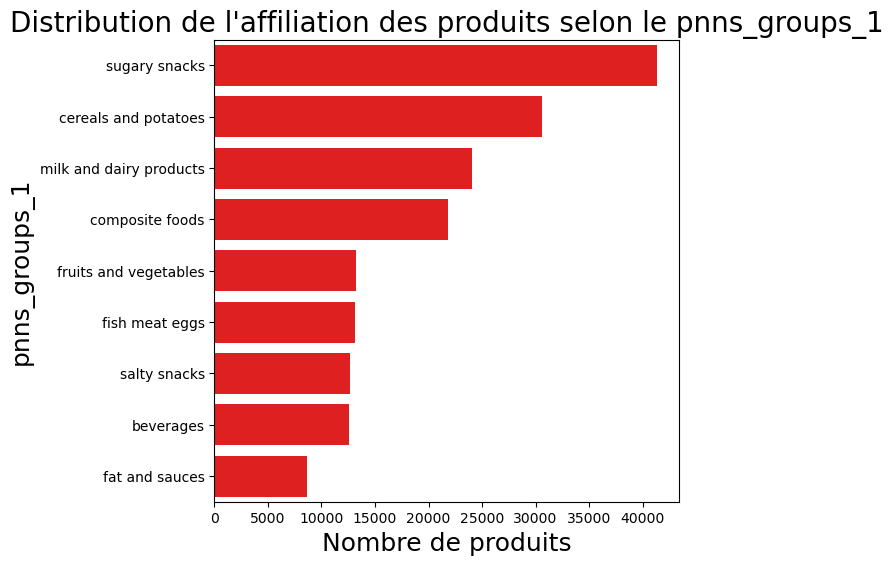

Etape 5


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

204 lignes modifiées
Une prédiction a pu être réalisé sur 119189 produits

0 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par sur training set : 2.46669748287599
Etape 6


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

1664 lignes modifiées
Une prédiction a pu être réalisé sur 180799 produits

0 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par sur training set : 3.3550115834426575
Etape n°: 1 	Pourcentage d'erreur : 8.790266217675837
Etape n°: 2 	Pourcentage d'erreur : 16.705069124423964
Etape n°: 3 	Pourcentage d'erreur : 17.741935483870968
Etape n°: 4 	Pourcentage d'erreur : 19.510009886307465
Etape n°: 5 	Pourcentage d'erreur : 18.870056497175142
Etape n°: 6 	Pourcentage d'erreur : 20.327173583762495
Etape n°: 7 	Pourcentage d'erreur : 20.251438957891548


In [64]:
liste_feat_simple = ["energy_100g", "fat_100g", "nutrition-score-fr_100g", "carbohydrates_100g", "salt_100g",'sugars_100g', "fiber_100g","proteins_100g"]

liste_feat_complexe = ["energy_100g", "fat_100g", "nutrition-score-fr_100g", "carbohydrates_100g", "salt_100g",'sugars_100g', "fiber_100g","proteins_100g", "iron_100g", "vitamin-a_100g", "calcium_100g", "cholesterol_100g"]

test1 = knn_pnns1_Etapes(test1, liste_feat_simple, liste_feat_complexe, "pnns_groups_1")



In [65]:
## Fonction permettant de remplir le knn en plusieurs étapes

def knn_pnns_Etapes_v2(df, liste_feat_simple, pnns):
    ## C'est à partir de l'étape 2 que nous remplissons le dataframe.
    ## Le pourcentage d'erreur à regarder est donc de cette étape
    
    df_originel = copy.deepcopy(df)
    
    # Première étape - affinage - simple# 
    print("Etape 1")
    dataframe_remplissage1 = remplissage_knn(df_originel, pnns, liste_feat_simple)

    # Seconde étape - remplissage - simple# 
    print("Etape 2")
    dataframe_remplissage2 = remplissage_knn(df.combine_first(dataframe_remplissage1), pnns, liste_feat_simple)
        
    # Troisième étape - remplissage global simple #
    print("Etape 3")
    dataframe_remplissage3 = remplissage_knn(df.combine_first(dataframe_remplissage2), pnns, liste_feat_simple, False)  
    
    # On complète df par les valeurs du dataframe 3
    df = df.combine_first(dataframe_remplissage3)
    
    ## On évalue le pourcentage d'erreur
    
    eval_erreur = [dataframe_remplissage1, dataframe_remplissage2, dataframe_remplissage3]
    
    for i, dataframes in enumerate(eval_erreur):
        pourcen = Pourcentage_Erreur(dataframes, df_originel, pnns)
        print("Etape n°:",i+1,"\tPourcentage d'erreur :", pourcen)
    
    
    ## On renvoie le df modifié 
    return df
    

Etape 1
pnns_groups_1 :  fruits and vegetables
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  sugary snacks
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  composite foods
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  beverages
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fish meat eggs
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  cereals and potatoes
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fat and sauces
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  salty snacks
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

131717 lignes modifiées
Une prédiction a pu être réalisé sur 164727 produits

16072 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_1 sur training set :
["['fruits and vegetables', 3.30202968797334]\n", "['sugary snacks', 4.438049076037565]\n", "['composite foods', 5.740684641017868]\n", "['beverages', 2.317479551651014]\n", "['fish meat eggs', 2.272038776128449]\n", "['cereals and potatoes', 5.528627688579213]\n", "['milk and dairy products', 3.5292335655861873]\n", "['fat and sauces', 3.014238109663736]\n", "['salty snacks', 2.1508633747349237]\n"]
pnns_groups_1 a cette distribution suivante au sein des échantillons


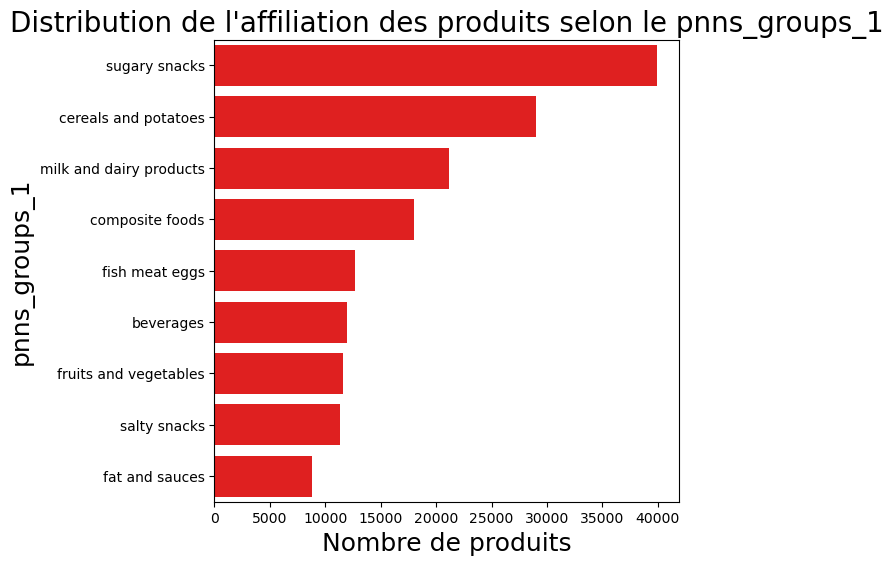

Etape 2
pnns_groups_1 :  salty snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  sugary snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

10122 lignes modifiées
Une prédiction a pu être réalisé sur 176434 produits

4365 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_1 sur training set :
["['salty snacks', 0.8658268947479231]\n", "['cereals and potatoes', 2.3178907494814105]\n", "['sugary snacks', 1.9210534227219411]\n", "['fish meat eggs', 1.1033280221266928]\n", "['fruits and vegetables', 1.3137720590445823]\n", "['composite foods', 2.435138141478521]\n", "['milk and dairy products', 1.782761627033036]\n", "['beverages', 0.8598142079788373]\n", "['fat and sauces', 1.1965246670474716]\n"]
pnns_groups_1 a cette distribution suivante au sein des échantillons


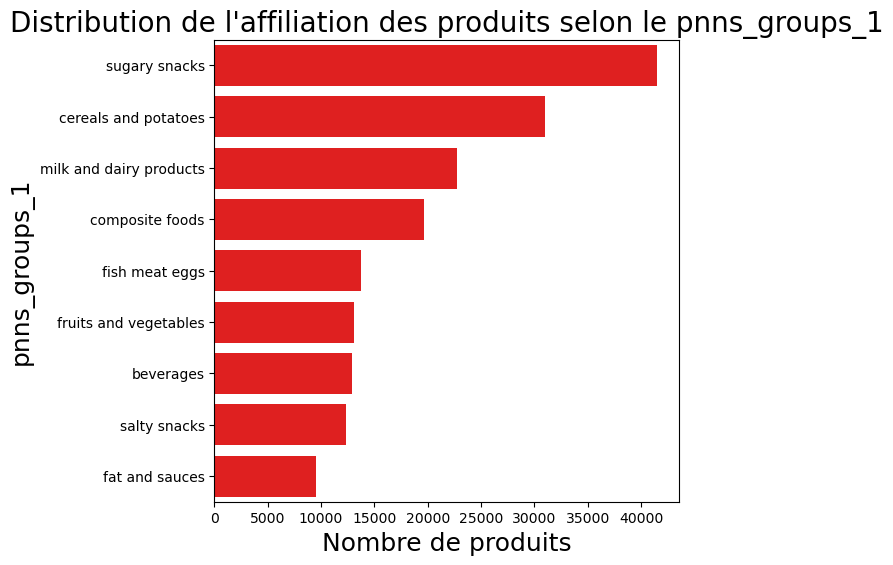

Etape 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

3550 lignes modifiées
Une prédiction a pu être réalisé sur 180799 produits

0 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par sur training set : 5.088857545839209
Etape n°: 1 	Pourcentage d'erreur : 8.766905330151154
Etape n°: 2 	Pourcentage d'erreur : 8.749805870476782
Etape n°: 3 	Pourcentage d'erreur : 10.23326264768252


In [66]:
test2 = knn_pnns_Etapes_v2(test2, liste_feat_simple, "pnns_groups_1")

En restant simple, on garde l'erreur au plus bas. 

On est entre 8 et 10 % d'errreur, ce qui est mieux que les 20 % d'une méthode globale.

La V2 est la version qui sera choisie

In [67]:
# On actualise
data = copy.deepcopy(test2)

Remplissage des dernières valeurs nulles

In [68]:
print("Il reste %d pnns1 non rempli" %data.pnns_groups_1.isnull().sum())

Il reste 41688 pnns1 non rempli


Regardons combien de features chaque ligne a.

Il y a 0 lignes où nous ne retrouvons aucune valeur entrée
Statistiques sur la complétude des données :


count    41688.000000
mean        74.667470
std         11.939684
min         12.500000
25%         62.500000
50%         75.000000
75%         87.500000
max         87.500000
dtype: float64

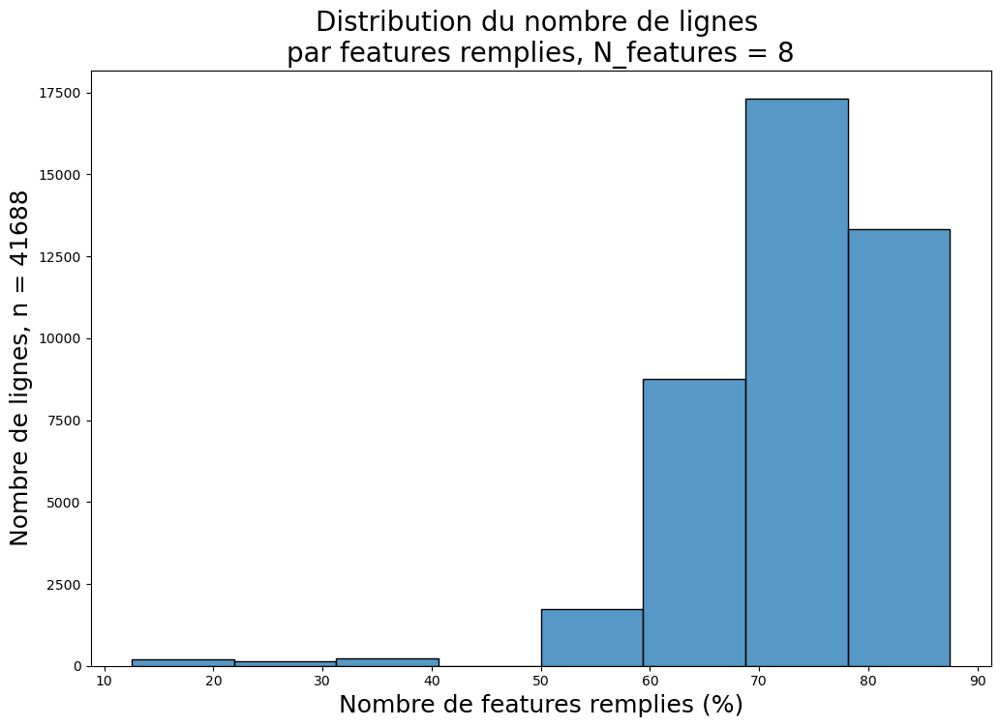

In [69]:
mask = data[data.pnns_groups_1.isnull()]
valeurs_manquantes_graph(mask[liste_feat_simple],"row")

On voit que certaines lignes ont peu de features remplies, ce qui pourrait rendre la tâche ardue à remplir avec un knn.

Dans un premier temps, nous allons éliminer ces lignes.

Sinon le reste est rempli entre 5 et 7 features.

On va créer un knn global pour remplir le pnns

In [70]:
# On appel notre fonction permettant d'éliminer les lignes ayant moins de 50% features remplies

data = eliminationRows(data, 50, "<", liste_feat_simple)

On passe de 247342 à 245871 lignes (- 1471)


Il y a 0 lignes où nous ne retrouvons aucune valeur entrée
Statistiques sur la complétude des données :


count    41134.000000
mean        75.326980
std         10.498265
min         50.000000
25%         62.500000
50%         75.000000
75%         87.500000
max         87.500000
dtype: float64

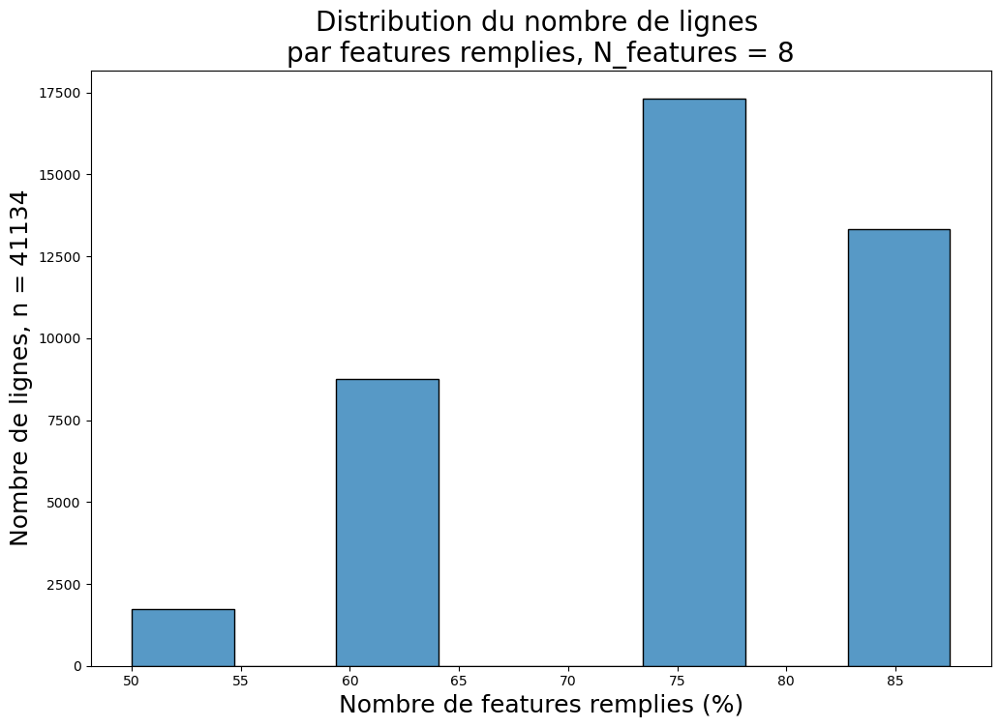

In [71]:
mask = data[data.pnns_groups_1.isnull()]
valeurs_manquantes_graph(mask[liste_feat_simple],"row")

In [72]:
mask[liste_feat_simple].count()

energy_100g                41134
fat_100g                   39468
nutrition-score-fr_100g    10332
carbohydrates_100g         40228
salt_100g                  38622
sugars_100g                30072
fiber_100g                  7738
proteins_100g              40286
dtype: int64

On voit qu'il manque majoritairement le nutrition score et la quantité de fiber.

On remplira après.

Dans un premier temps, nous allons tenter d'identifier un pnns1 quand une valeur est manquante, puis 2 valeurs.

Il nous reste 216355 produits

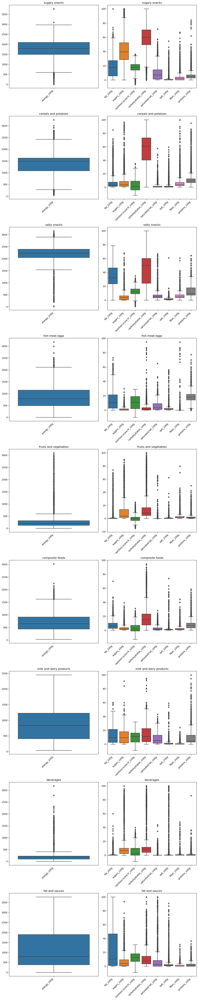

In [73]:
graphiquePNS_features(data, "pnns_groups_1")

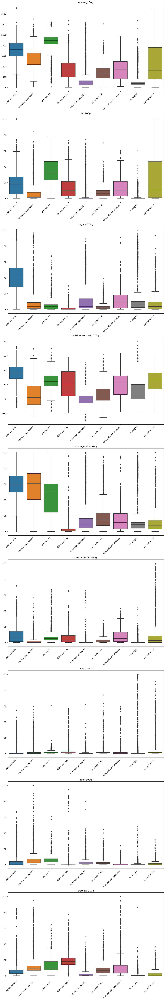

In [74]:
liste_feat_majeur = ["energy_100g", "fat_100g", "sugars_100g", "nutrition-score-fr_100g", "carbohydrates_100g", "saturated-fat_100g", "salt_100g", "fiber_100g","proteins_100g"]
graphique_features_pnns(data, "pnns_groups_1", liste_feat_majeur)


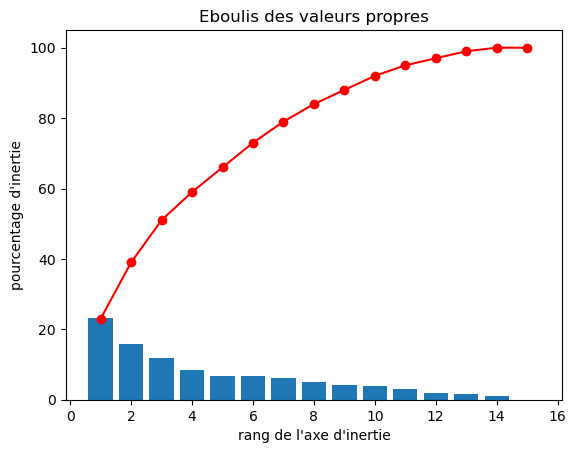

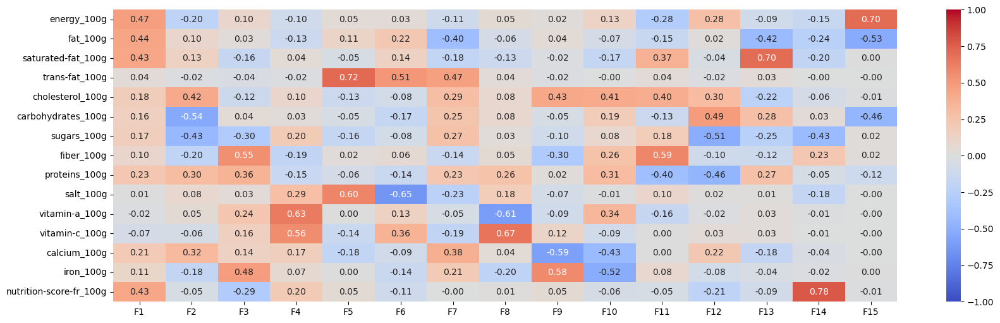

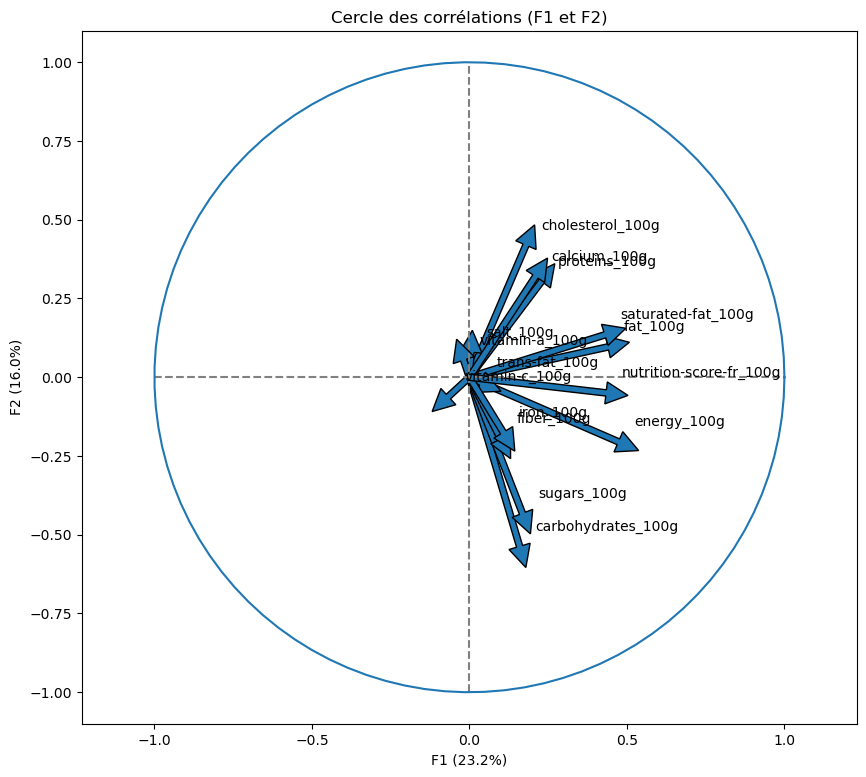

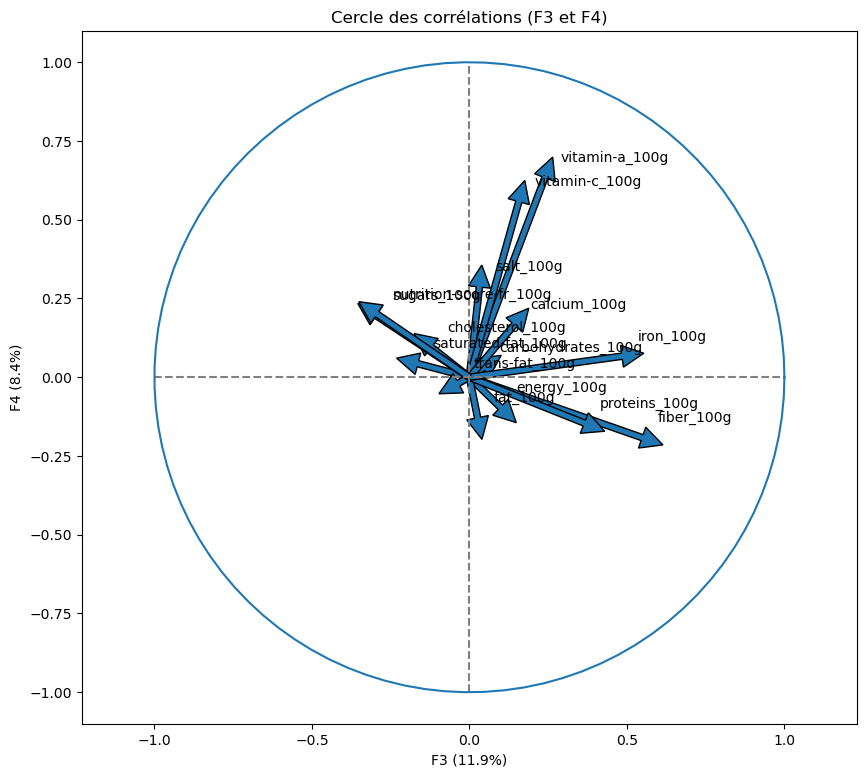

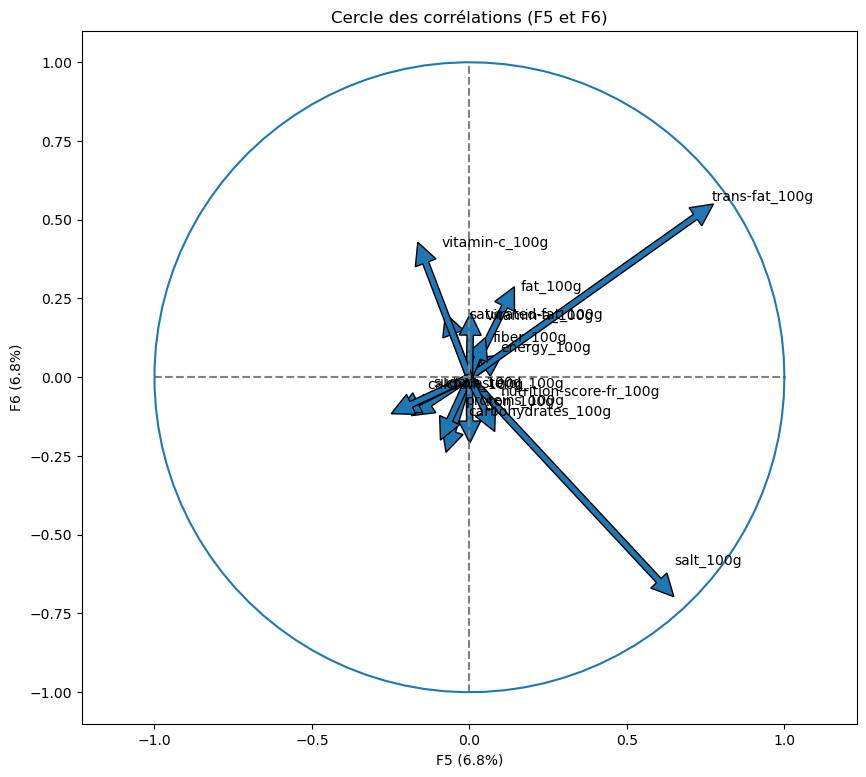

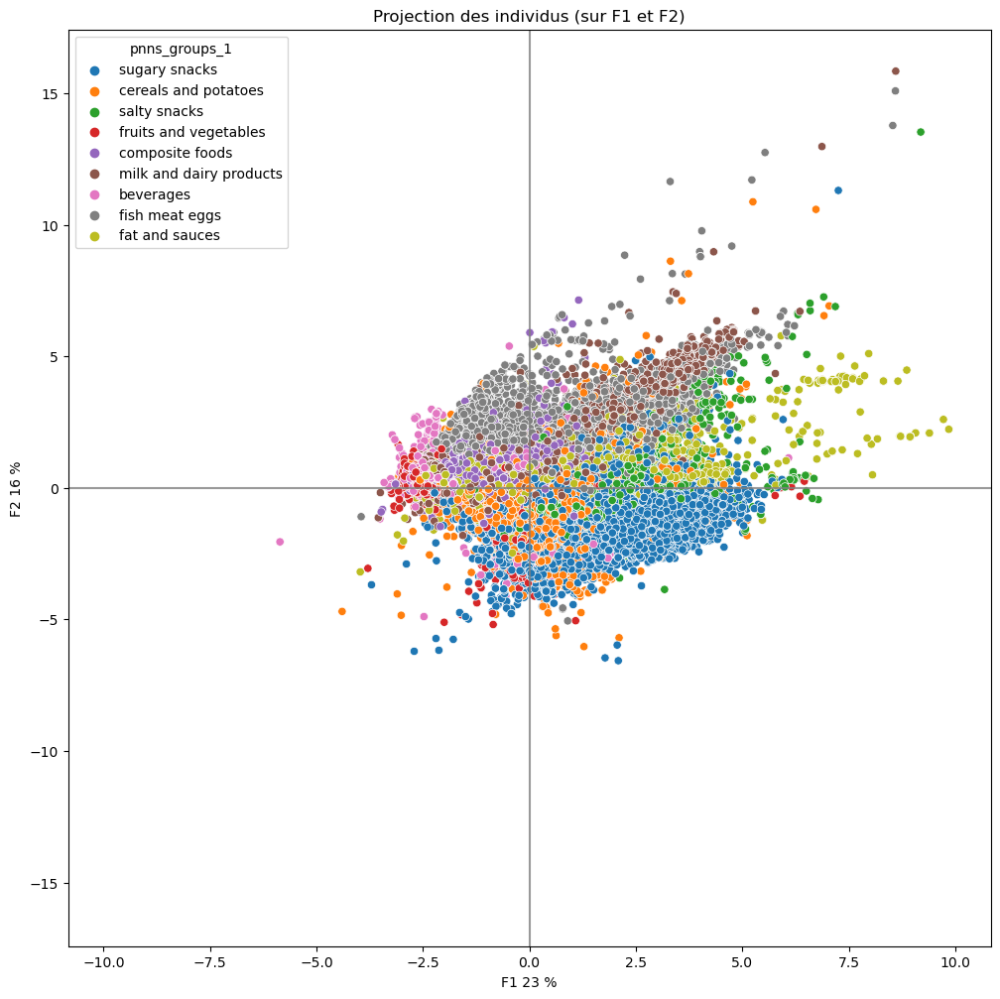

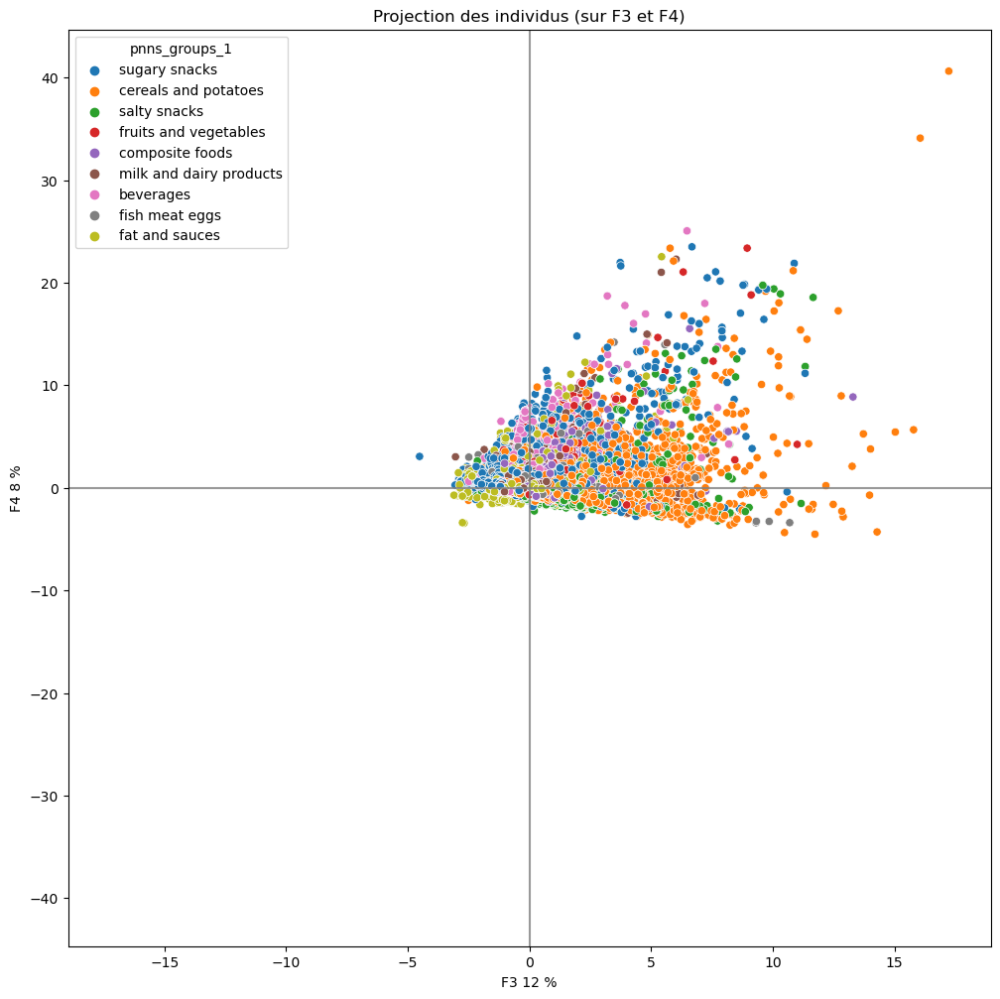

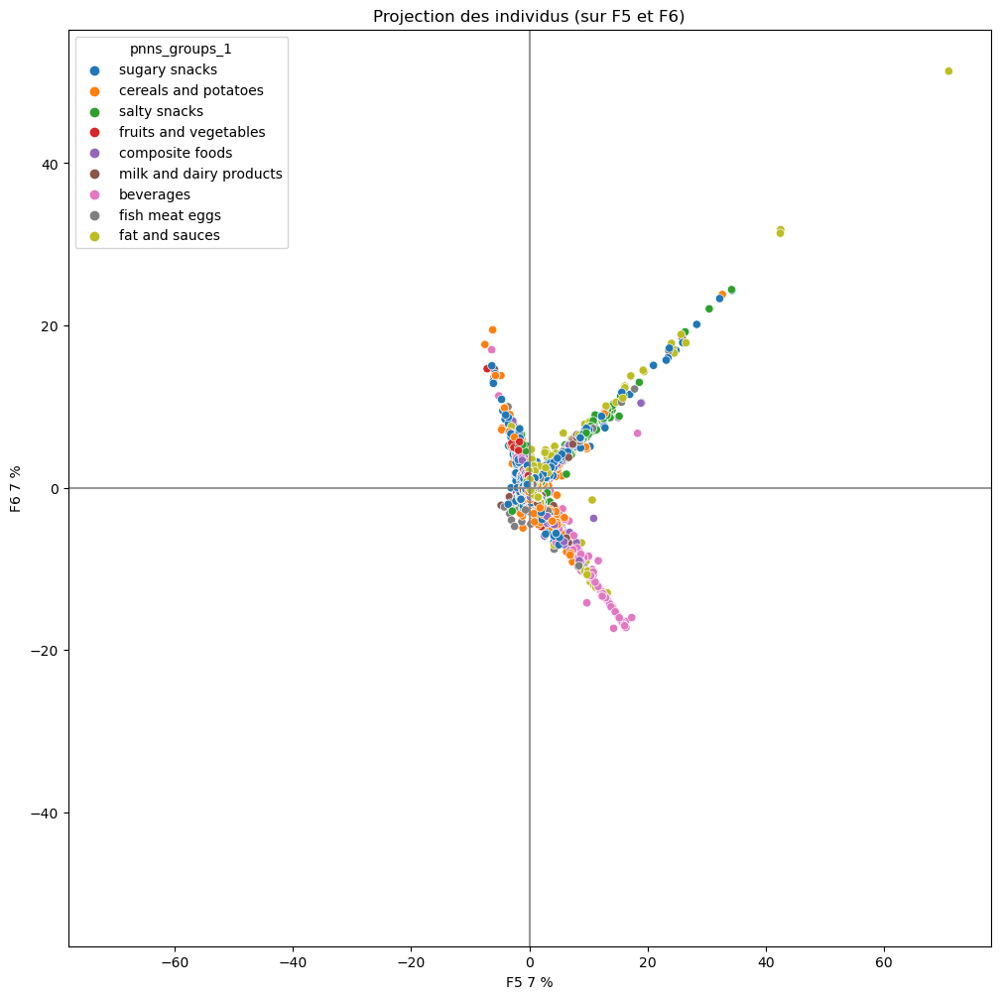

In [75]:
ACP_generator(data, "pnns_groups_1", False)

Il faut aller jusqu'au 7ème plan pour arriver à 80 %

Se suivent sur plusieurs plans

- vitamin A et C
- Fat et saturated fat

On garde vitamine A et fat.

Se suivent jusqu'au 3ème plan

- iron et fiber
- Calcium et protein

Sugary snacks et fish meat eggs se séparent bien des autres groupes.

Maintenant, on peut remplir pnns2.

### <a name = "T4C8">8. pnns2 : description des données </a>

In [76]:
# On met les textes en minuscules pour limiter les biais sur majuscule/minuscules
data["pnns_groups_2"] = data["pnns_groups_2"].str.lower()
data.loc[data["pnns_groups_2"] == "unknown", "pnns_groups_2"] = np.nan

display(data["pnns_groups_2"].unique())

print("Nombre de pnns2 :", data[~data["pnns_groups_2"].isnull()].shape[0])

array([nan, 'vegetables', 'biscuits and cakes', 'pizza pies and quiche',
       'meat', 'sweets', 'sweetened beverages', 'dressings and sauces',
       'one-dish meals', 'soups', 'cereals', 'fruits', 'milk and yogurt',
       'fats', 'non-sugared beverages', 'chocolate products', 'bread',
       'nuts', 'legumes', 'breakfast cereals', 'appetizers',
       'artificially sweetened beverages', 'fruit juices', 'eggs',
       'fish and seafood', 'dried fruits', 'cheese', 'ice cream',
       'processed meat', 'potatoes', 'alcoholic beverages', 'pastries',
       'dairy desserts', 'fruit nectars', 'sandwich',
       'salty and fatty products', 'tripe dishes'], dtype=object)

Nombre de pnns2 : 57105


Regardons la distribution des pnns 2

pnns_groups_2 a cette distribution suivante au sein des échantillons


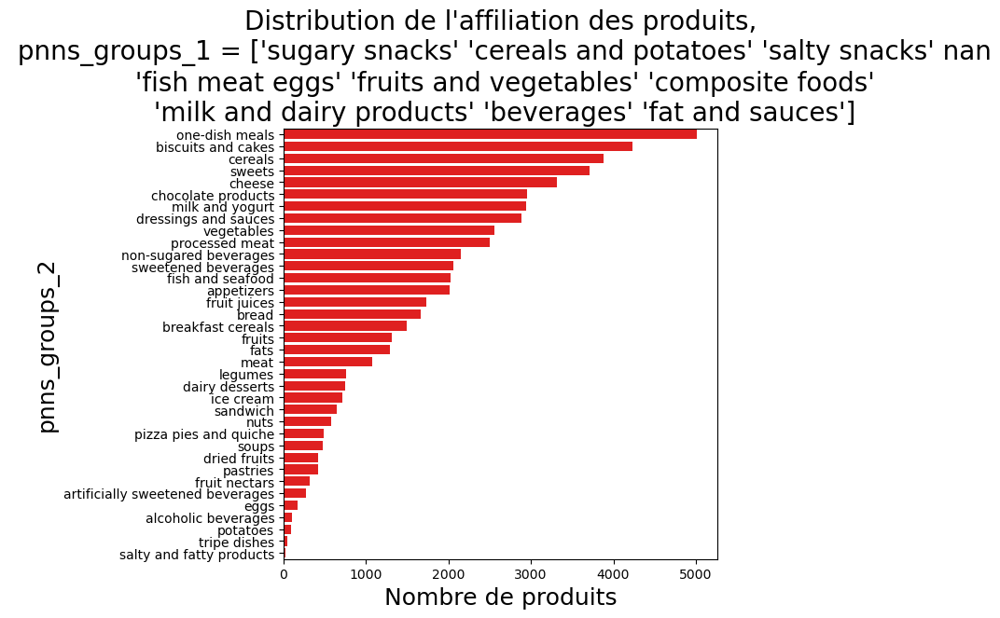

In [77]:
distribution_pnns(data, "pnns_groups_2")

C:\Users\33664\AppData\Local\Temp\ipykernel_9052\3251991973.py:31: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  fig.tight_layout()


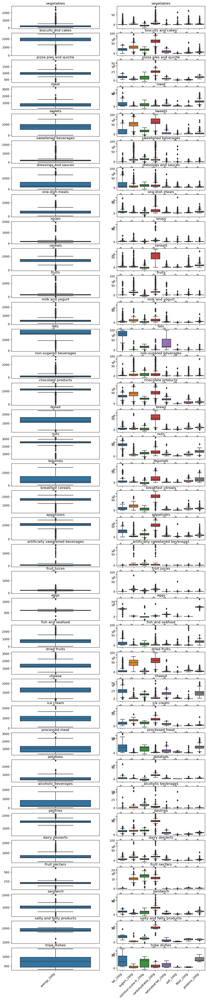

In [78]:
graphiquePNS_features(data, "pnns_groups_2")

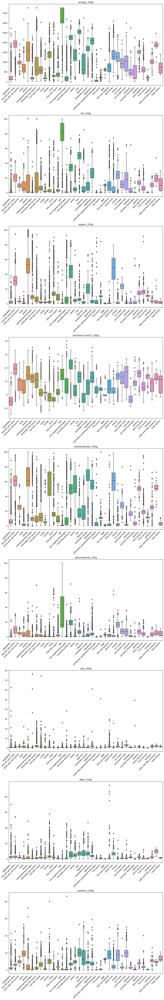

In [79]:
liste_feat_majeur = ["energy_100g", "fat_100g", "sugars_100g", "nutrition-score-fr_100g", "carbohydrates_100g", "saturated-fat_100g", "salt_100g", "fiber_100g","proteins_100g"]
graphique_features_pnns(data, "pnns_groups_2", liste_feat_majeur)

In [80]:
for feat in liste_feat_majeur:
    anova_oneway_pnns(data[(data.pnns_groups_2.notnull()) & (data[feat].notnull())], feat, "pnns_groups_2")

F_onewayResult(statistic=3947.3772923059296, pvalue=0.0) pour la feature : energy_100g
F_onewayResult(statistic=2804.983856455279, pvalue=0.0) pour la feature : fat_100g
F_onewayResult(statistic=3290.3424496575512, pvalue=0.0) pour la feature : sugars_100g
F_onewayResult(statistic=2229.3065015162115, pvalue=0.0) pour la feature : nutrition-score-fr_100g
F_onewayResult(statistic=4897.66710901796, pvalue=0.0) pour la feature : carbohydrates_100g
F_onewayResult(statistic=2030.26752750975, pvalue=0.0) pour la feature : saturated-fat_100g
F_onewayResult(statistic=461.8159009633861, pvalue=0.0) pour la feature : salt_100g
F_onewayResult(statistic=401.9676781400903, pvalue=0.0) pour la feature : fiber_100g
F_onewayResult(statistic=3042.758142424476, pvalue=0.0) pour la feature : proteins_100g


L'analyse ANOVA montre que les valeurs associées aux pnns2 permettent de séparer les groupes.

On peut regarder la distribution des pnns2 selon les pnns1

pnns_groups_2 a cette distribution suivante au sein des échantillons


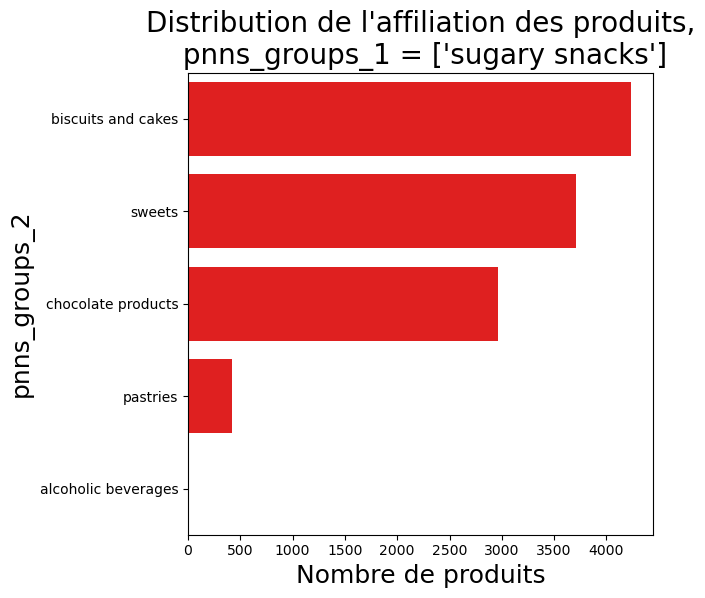

pnns_groups_2 a cette distribution suivante au sein des échantillons


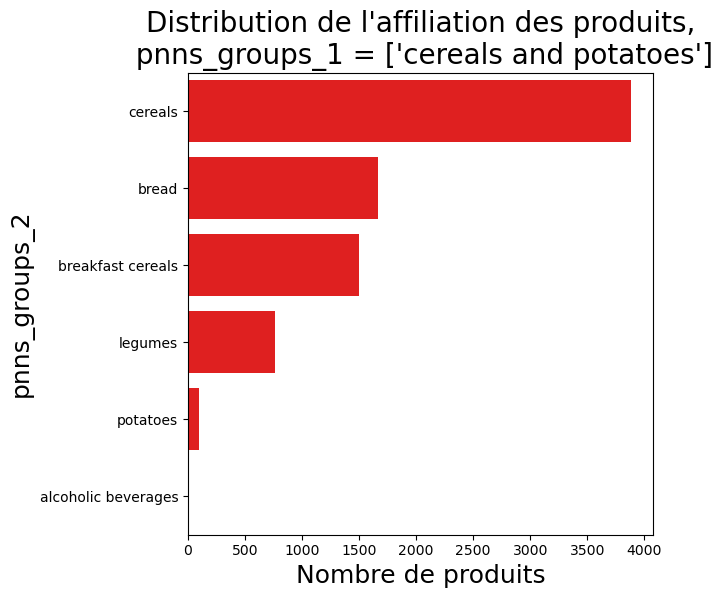

pnns_groups_2 a cette distribution suivante au sein des échantillons


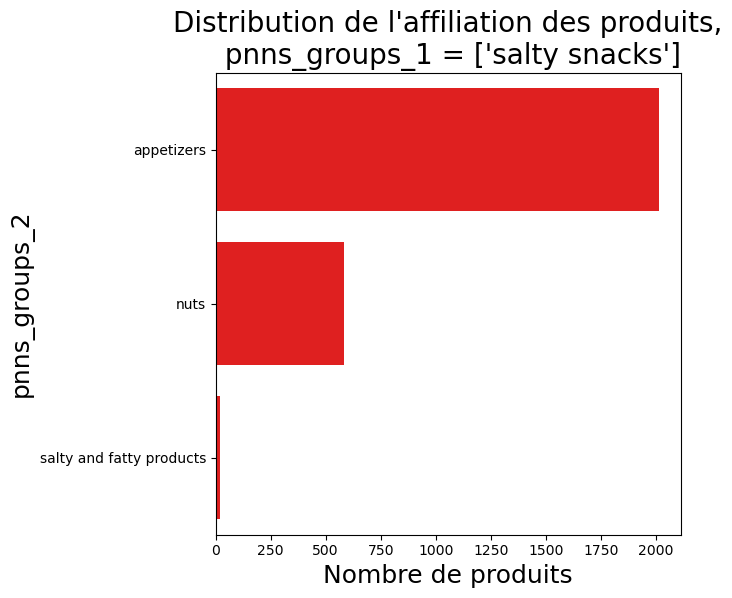

pnns_groups_2 a cette distribution suivante au sein des échantillons


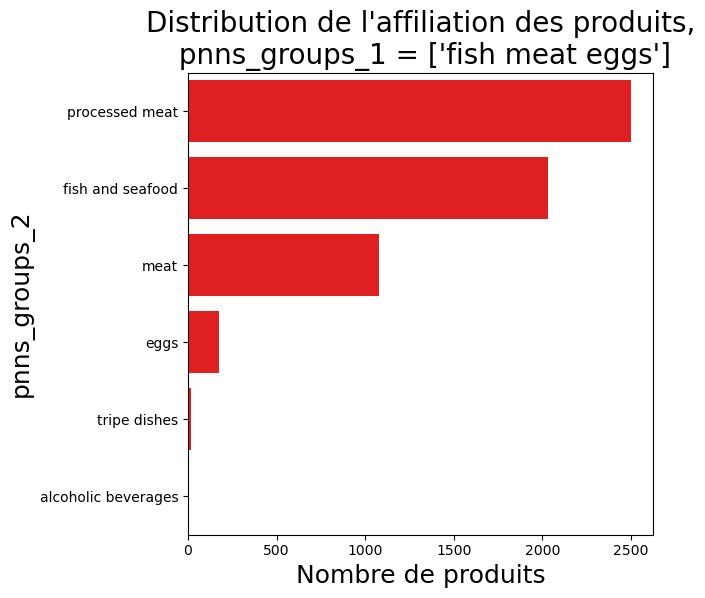

pnns_groups_2 a cette distribution suivante au sein des échantillons


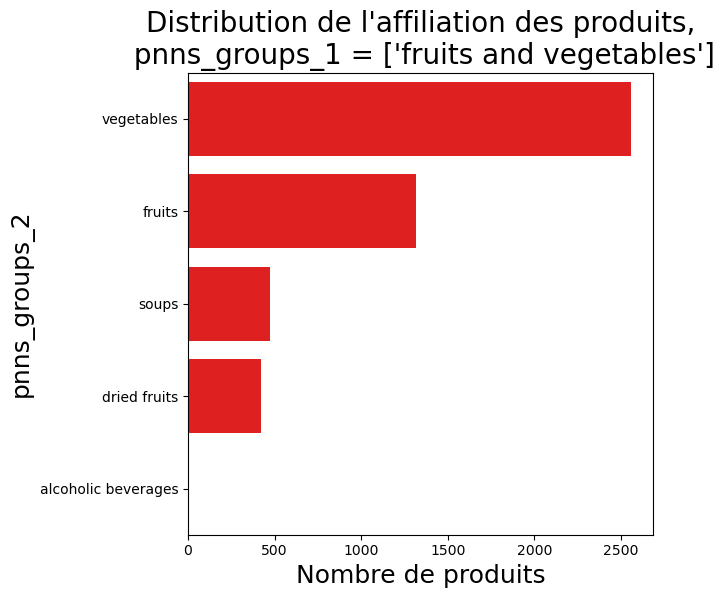

pnns_groups_2 a cette distribution suivante au sein des échantillons


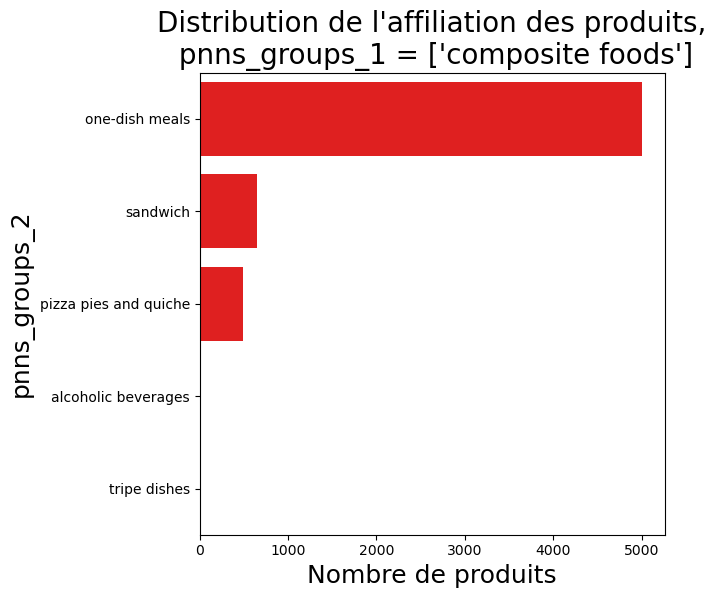

pnns_groups_2 a cette distribution suivante au sein des échantillons


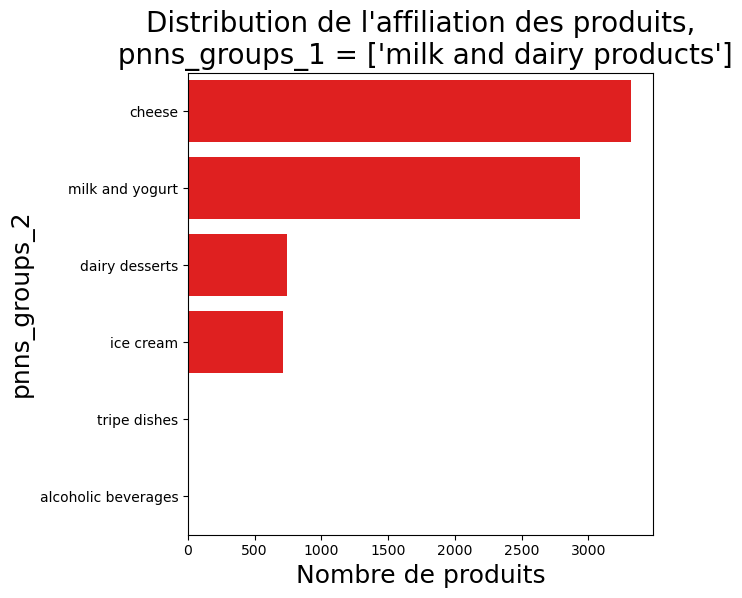

pnns_groups_2 a cette distribution suivante au sein des échantillons


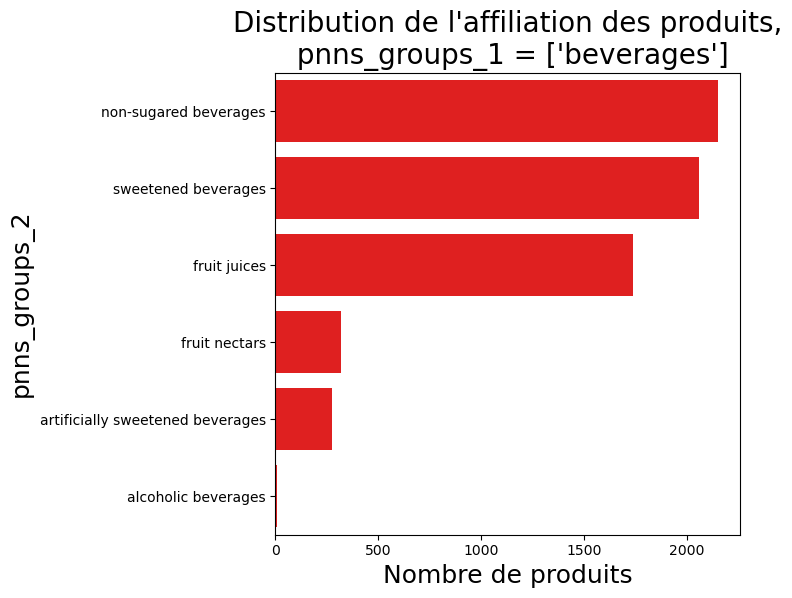

pnns_groups_2 a cette distribution suivante au sein des échantillons


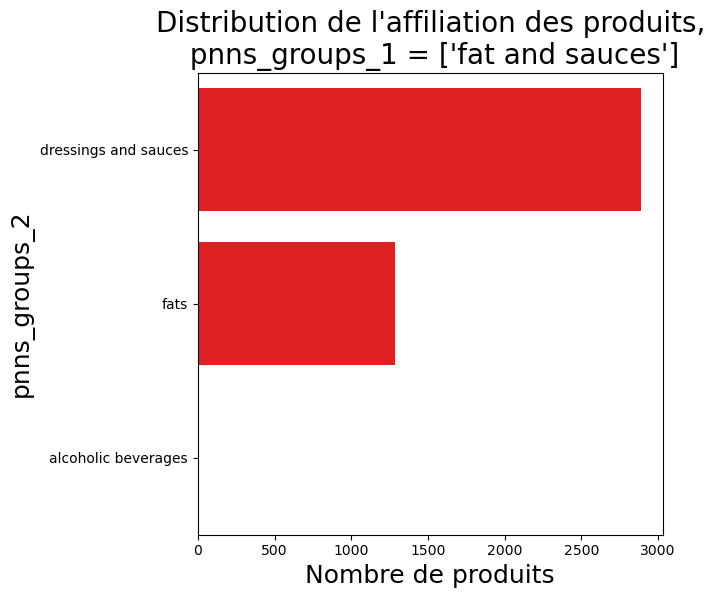

In [81]:
# Distribution pnns2 par pnns1
for pnns1 in data.loc[data["pnns_groups_1"].notnull(), "pnns_groups_1"].unique():
    distribution_pnns(data[data["pnns_groups_1"] == pnns1], "pnns_groups_2")
    

Il semblerait qu'il y ait des erreurs d'attribution du pnns2 aux pnns1 (alcoholic beverage qui devaient être dans le pnns1 beverage). 

Ca ne concerne que peu de produits, ce qui confirme la bonne affiliation des pnns1.

On corrigera pas la suite.

Regardons de façon générale comment se distribue les différents groups selon les features par une ACP

### <a name = "T4C9">9. pnns2 : description des données par une ACP </a>

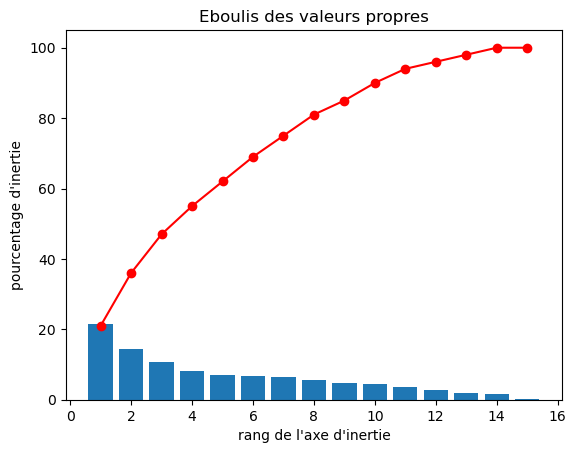

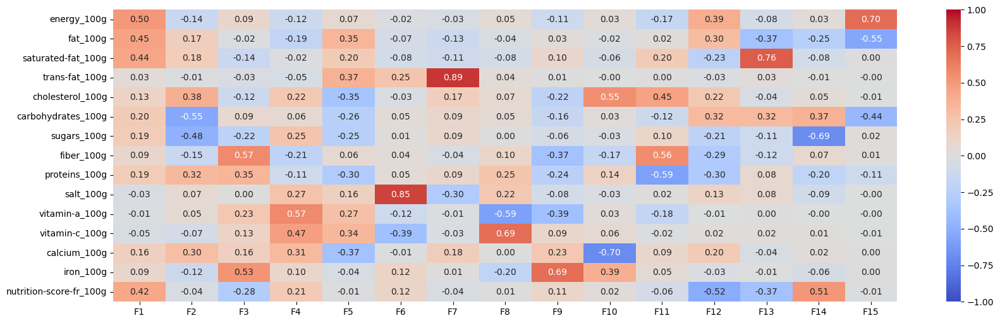

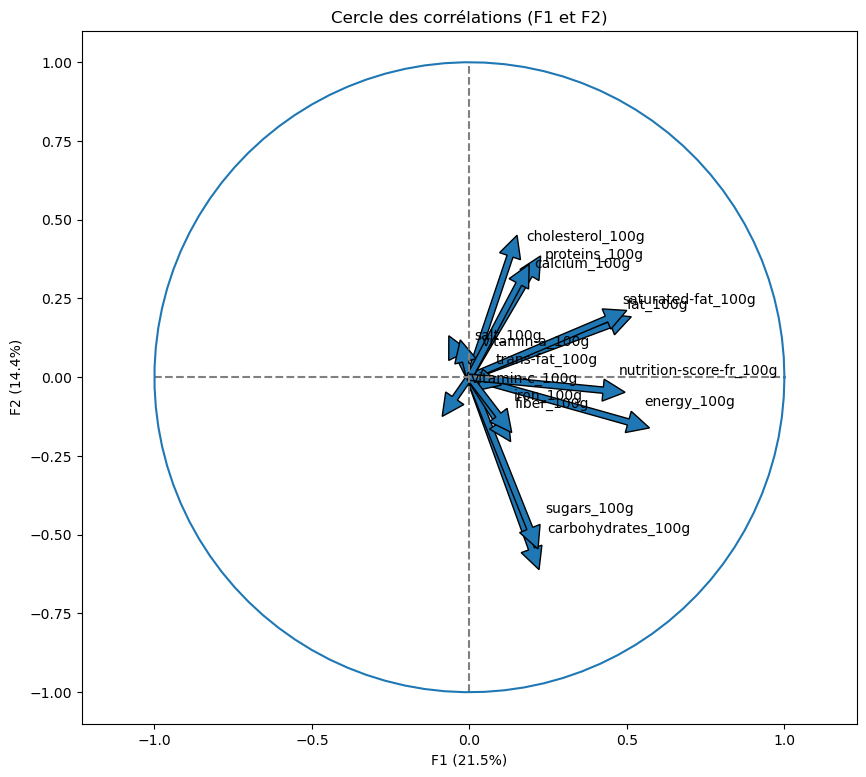

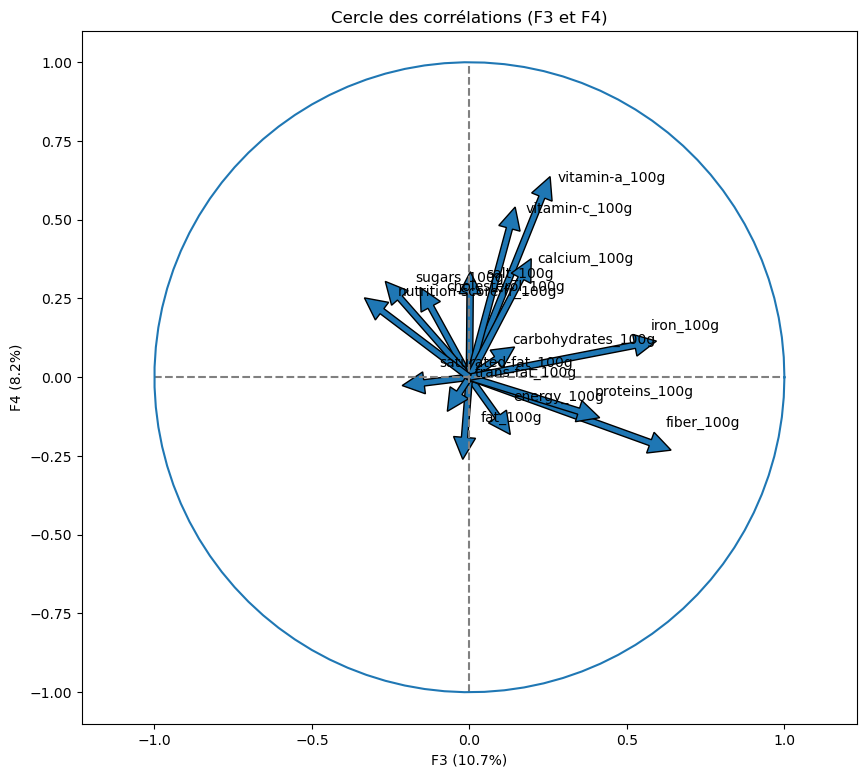

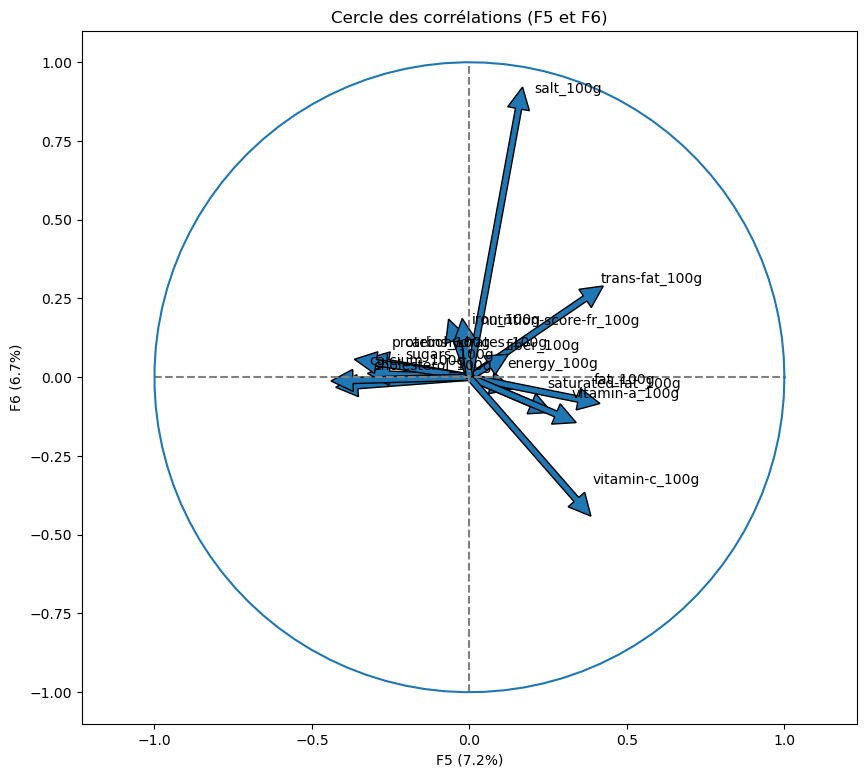

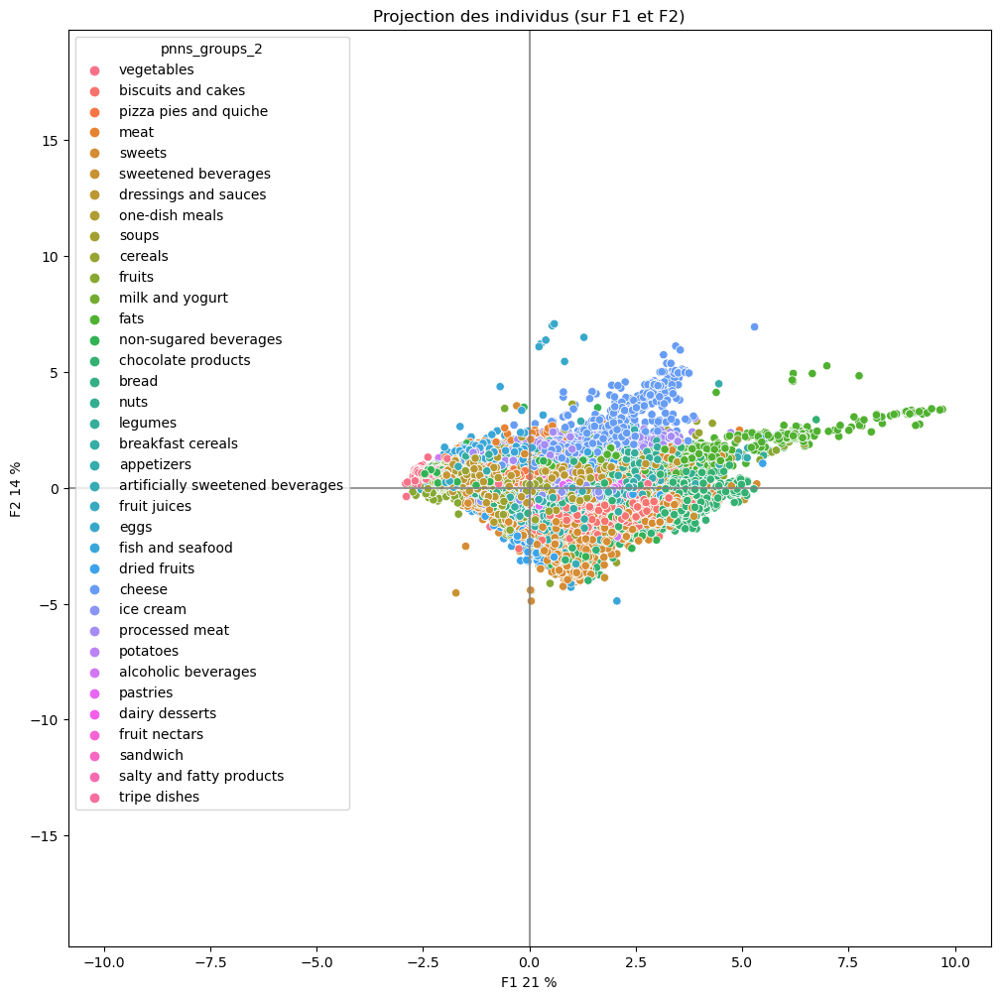

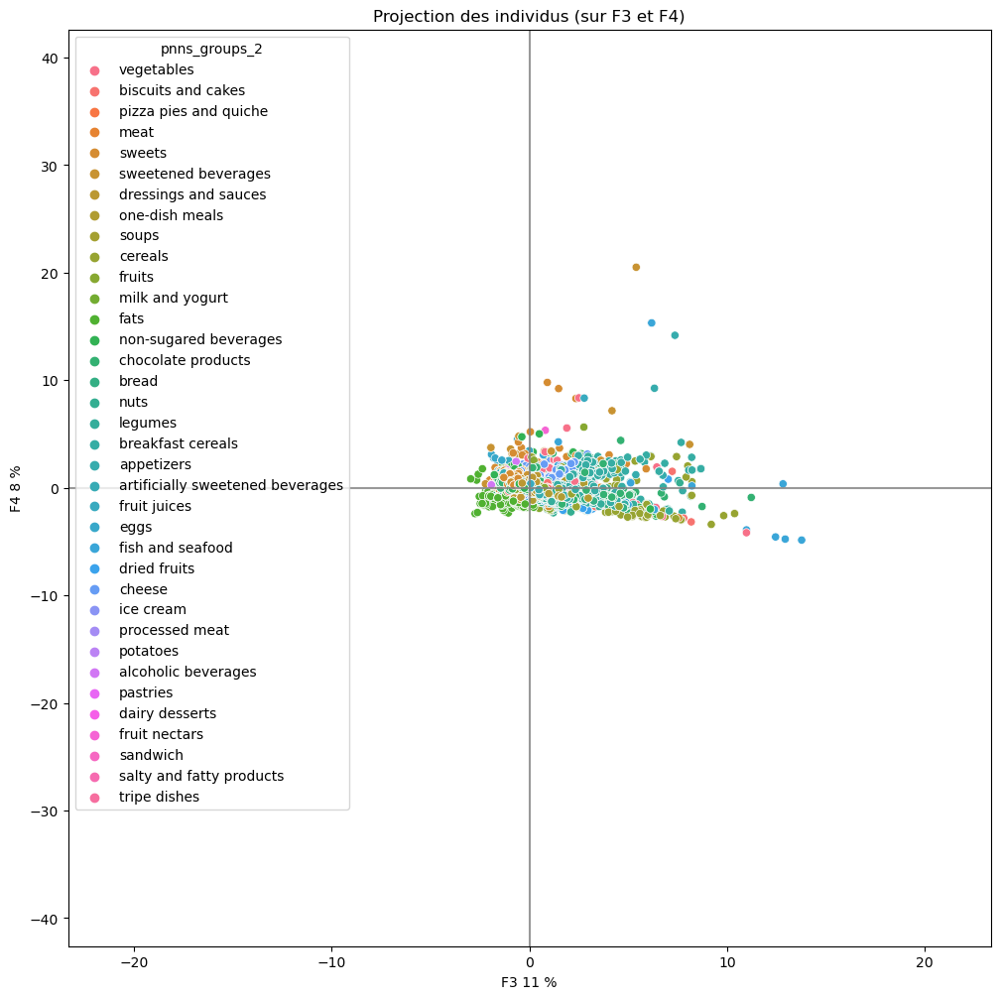

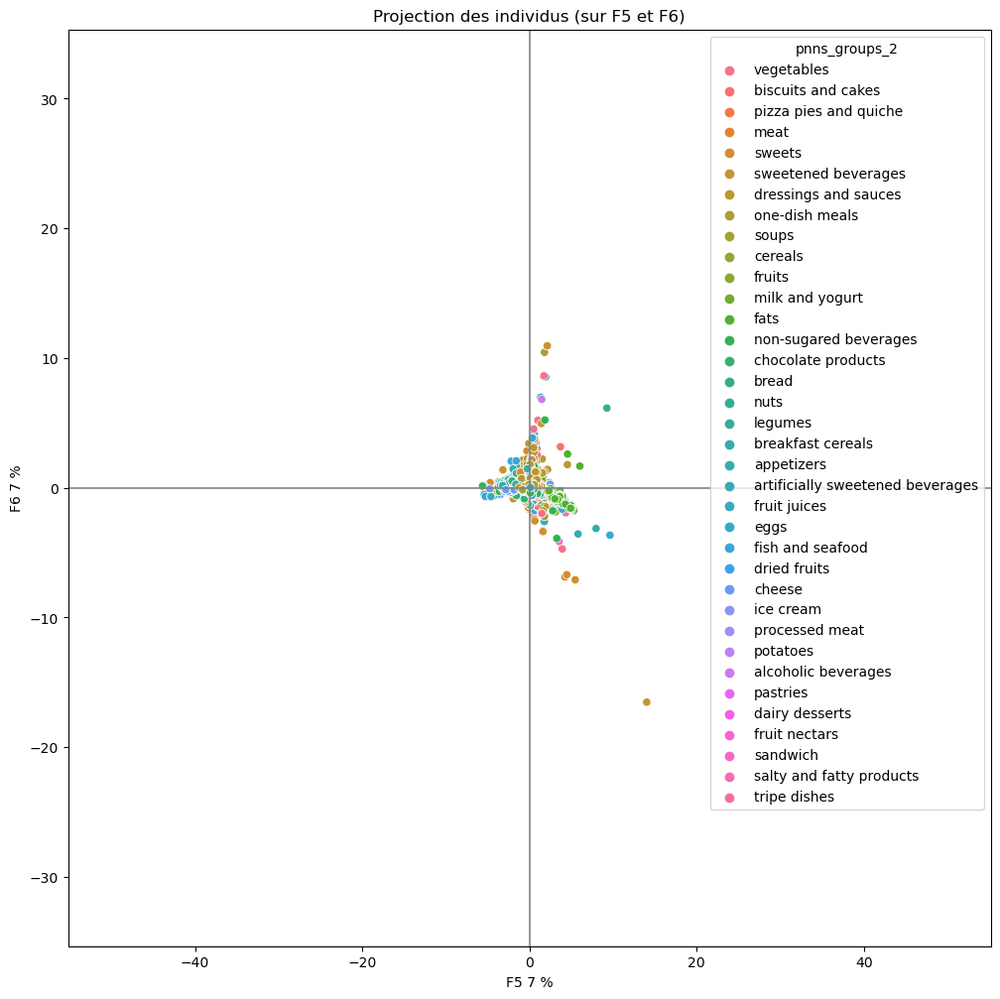

In [82]:
ACP_generator(data, "pnns_groups_2")

On peut voir un certain groupement, mais maintenant, voyons comment ils se groupent selon les pnns1

sugary snacks


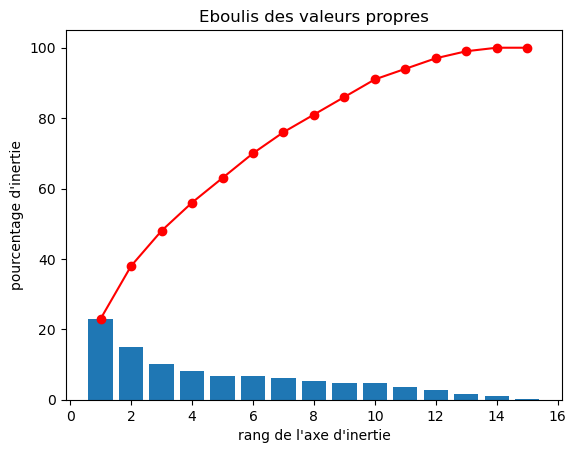

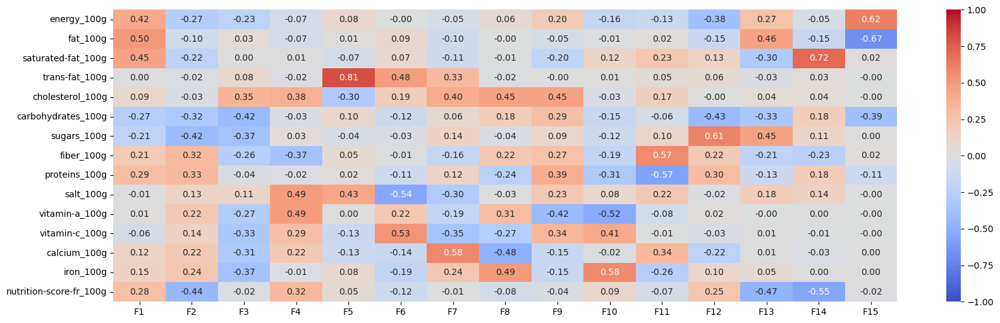

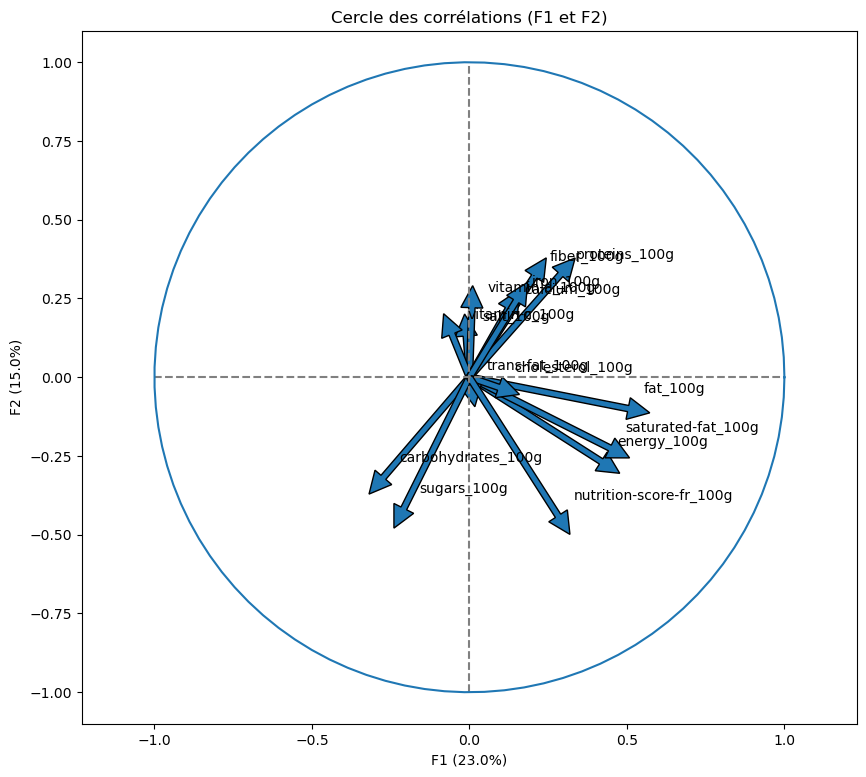

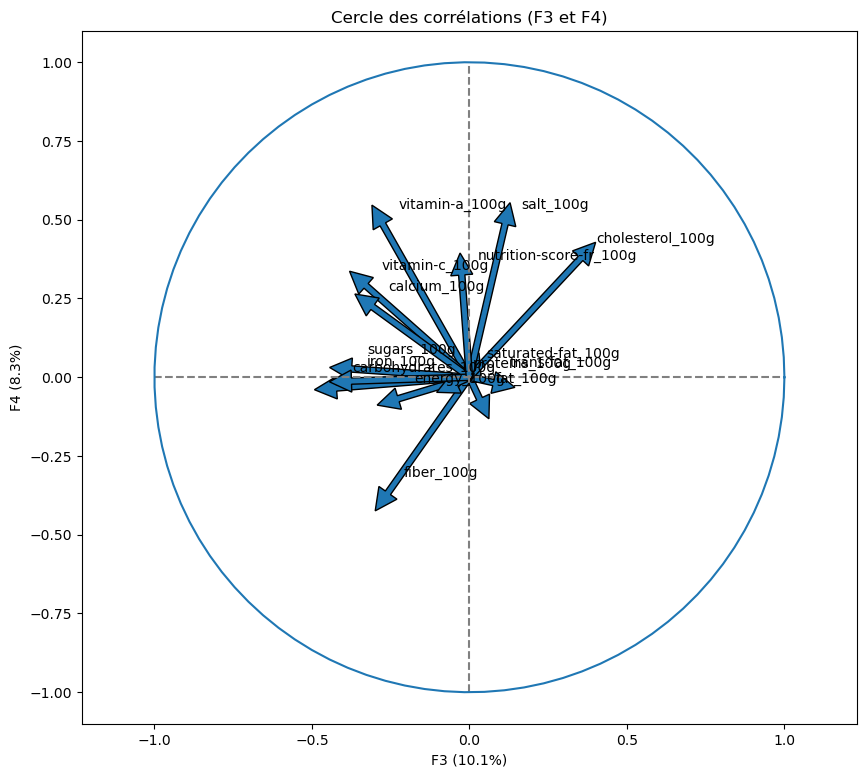

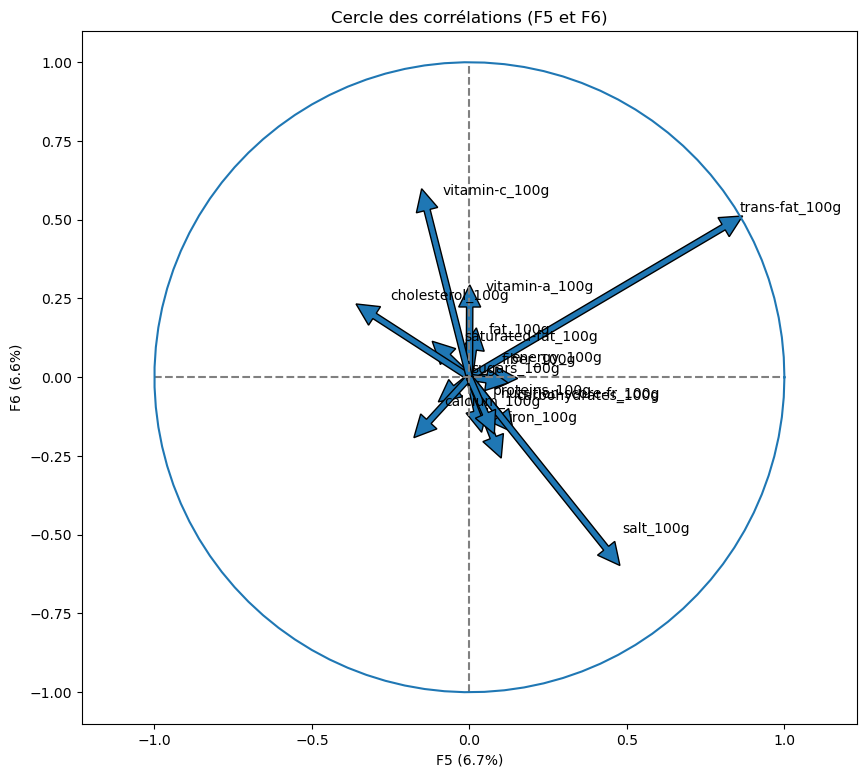

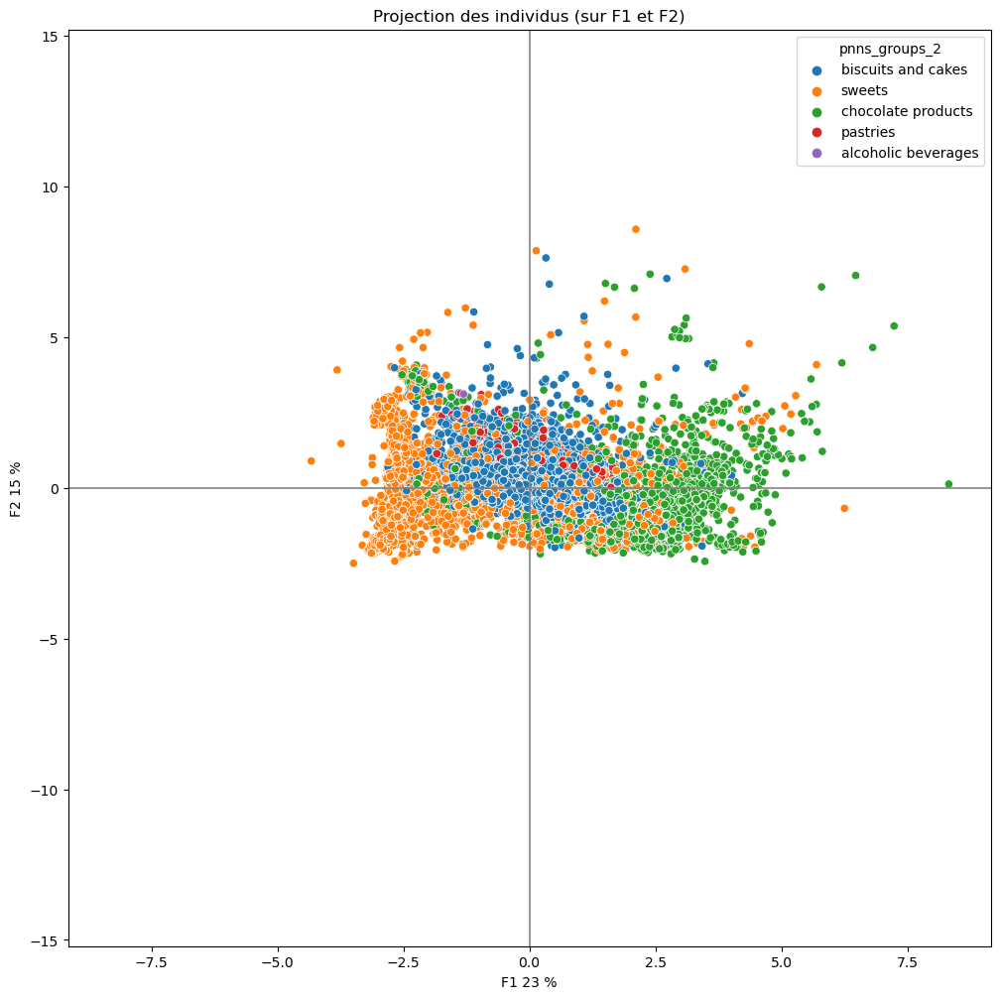

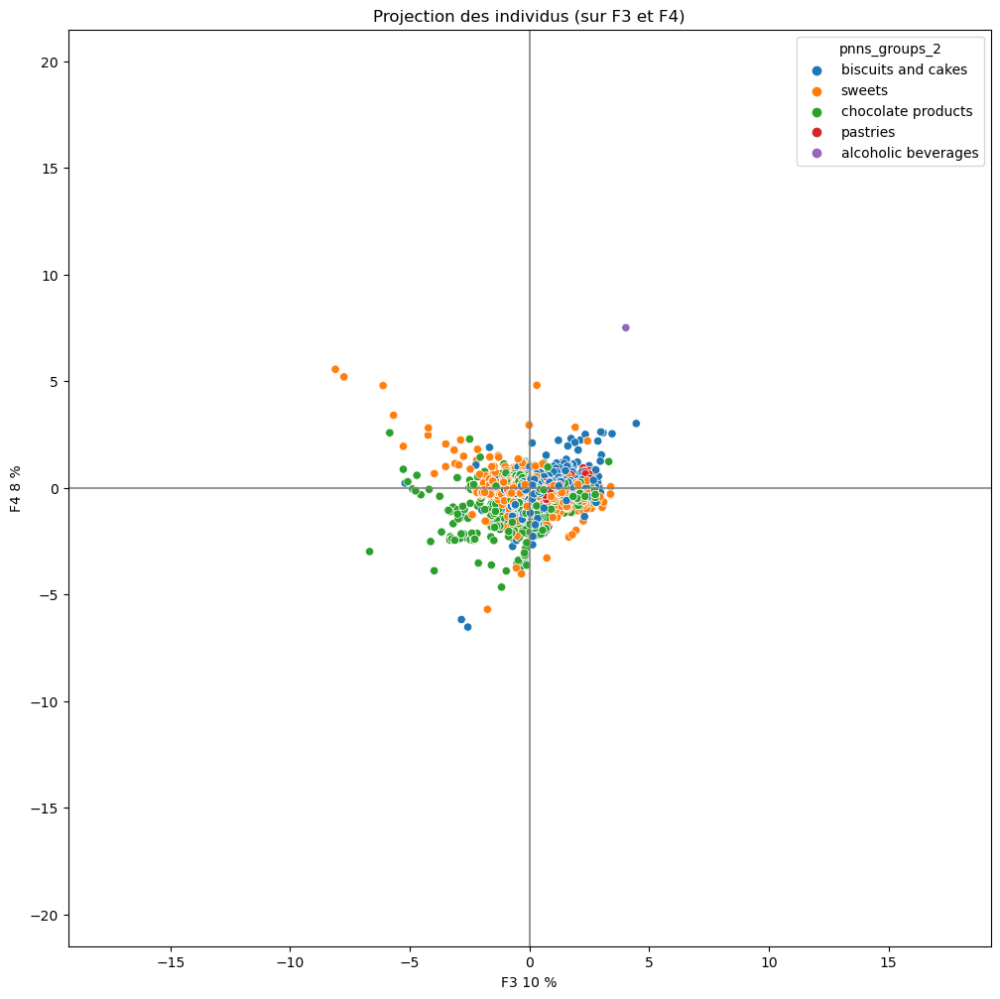

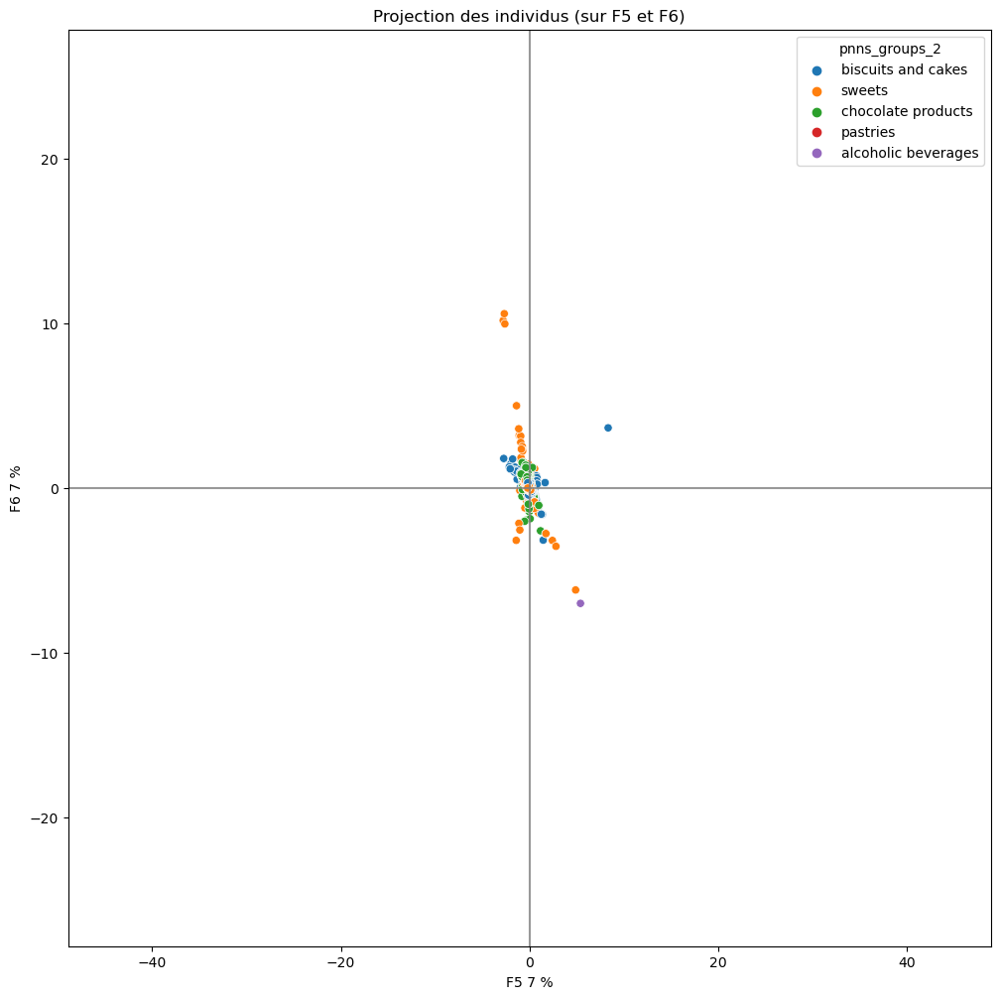

cereals and potatoes


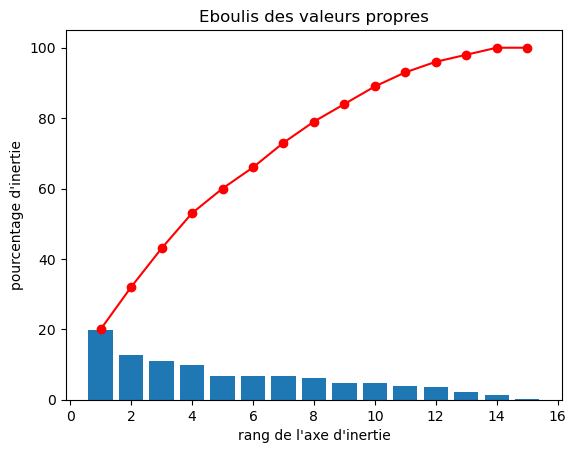

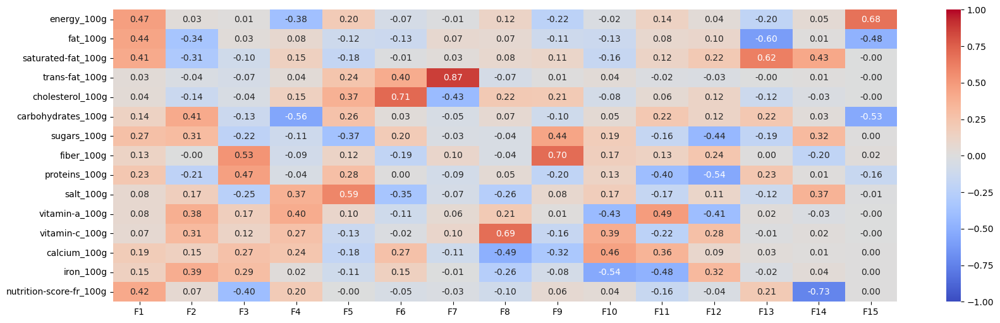

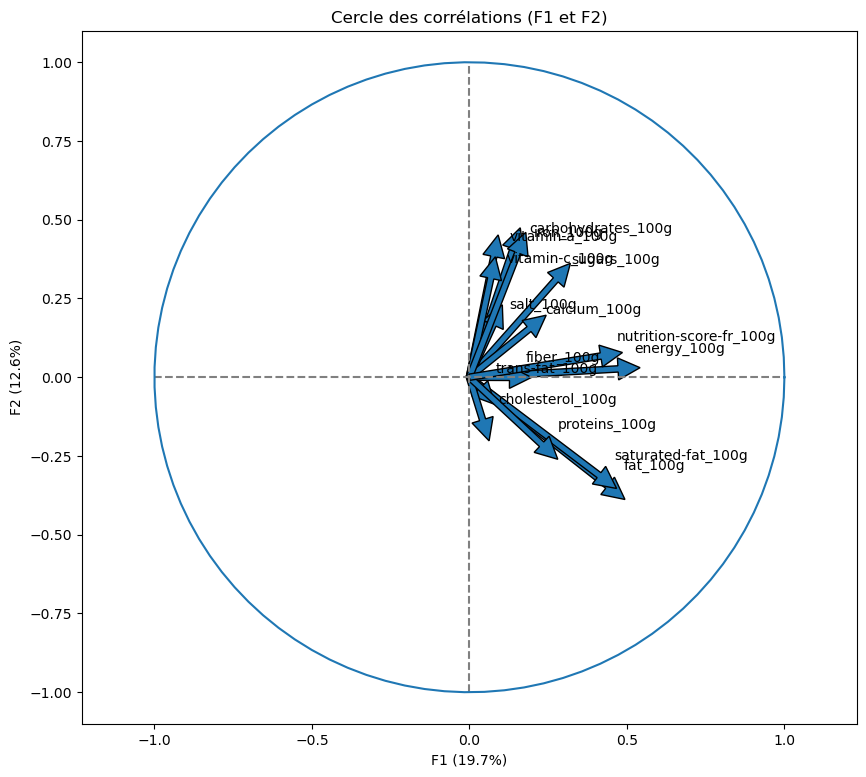

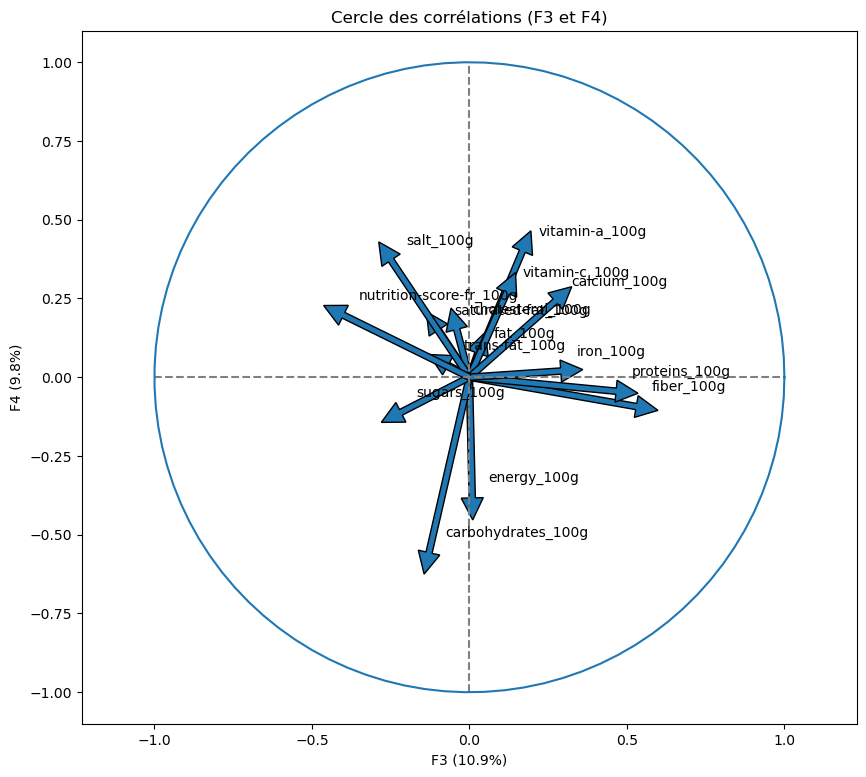

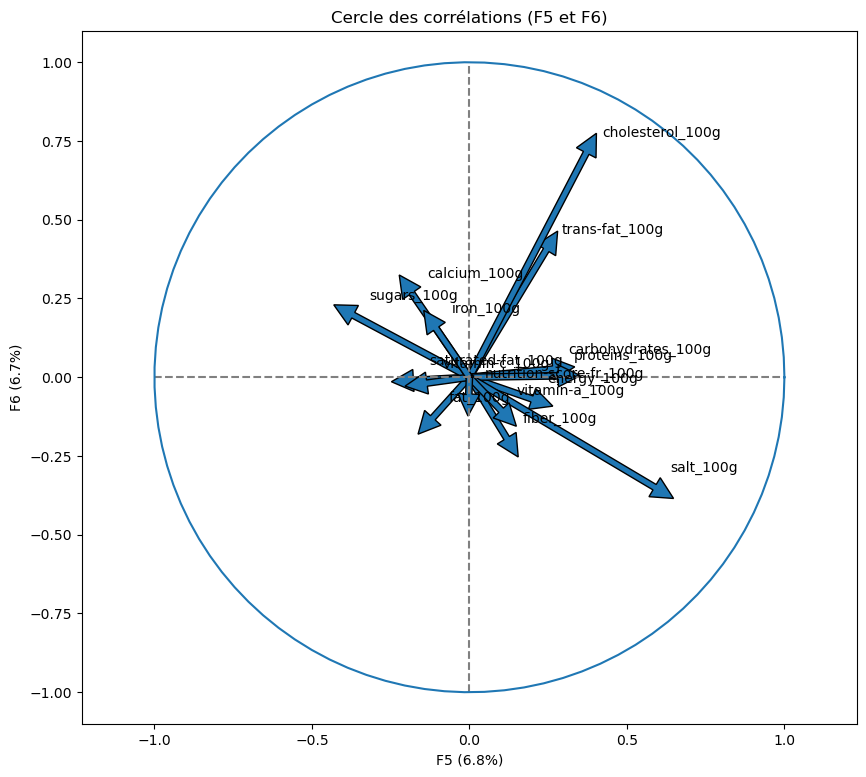

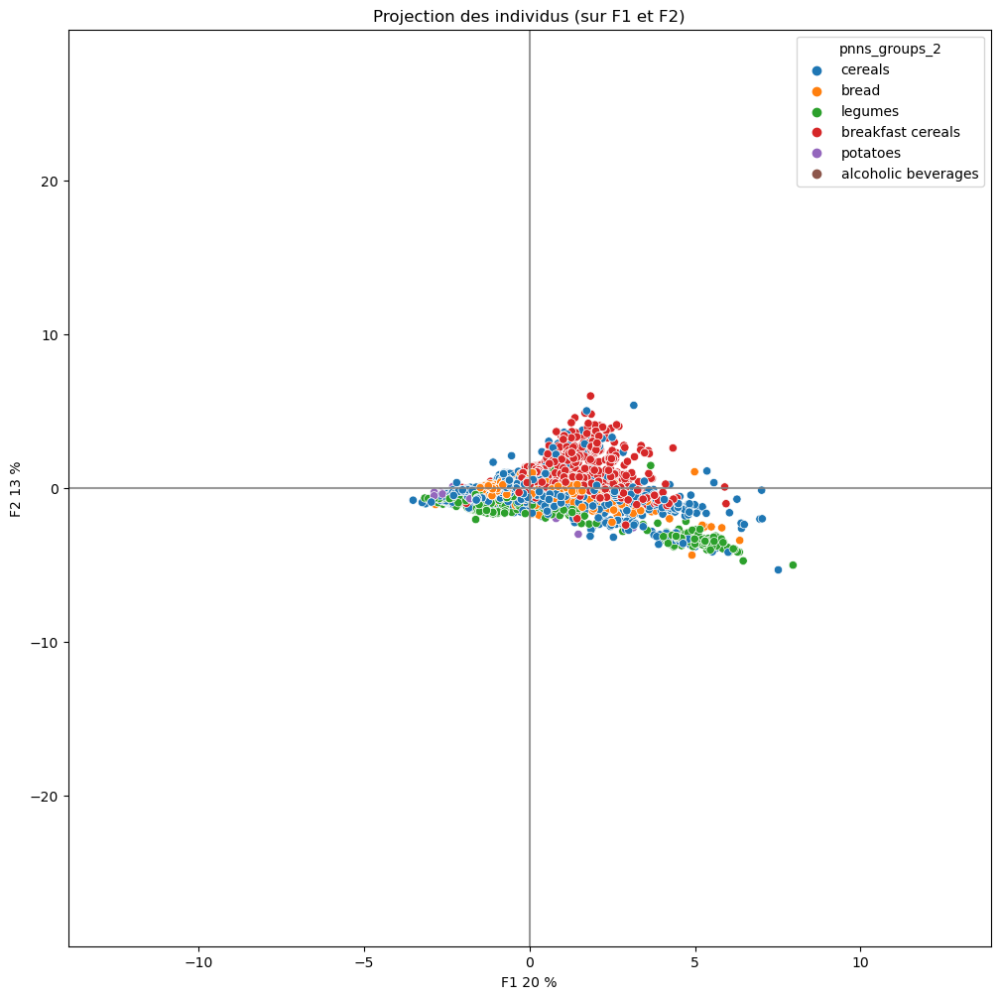

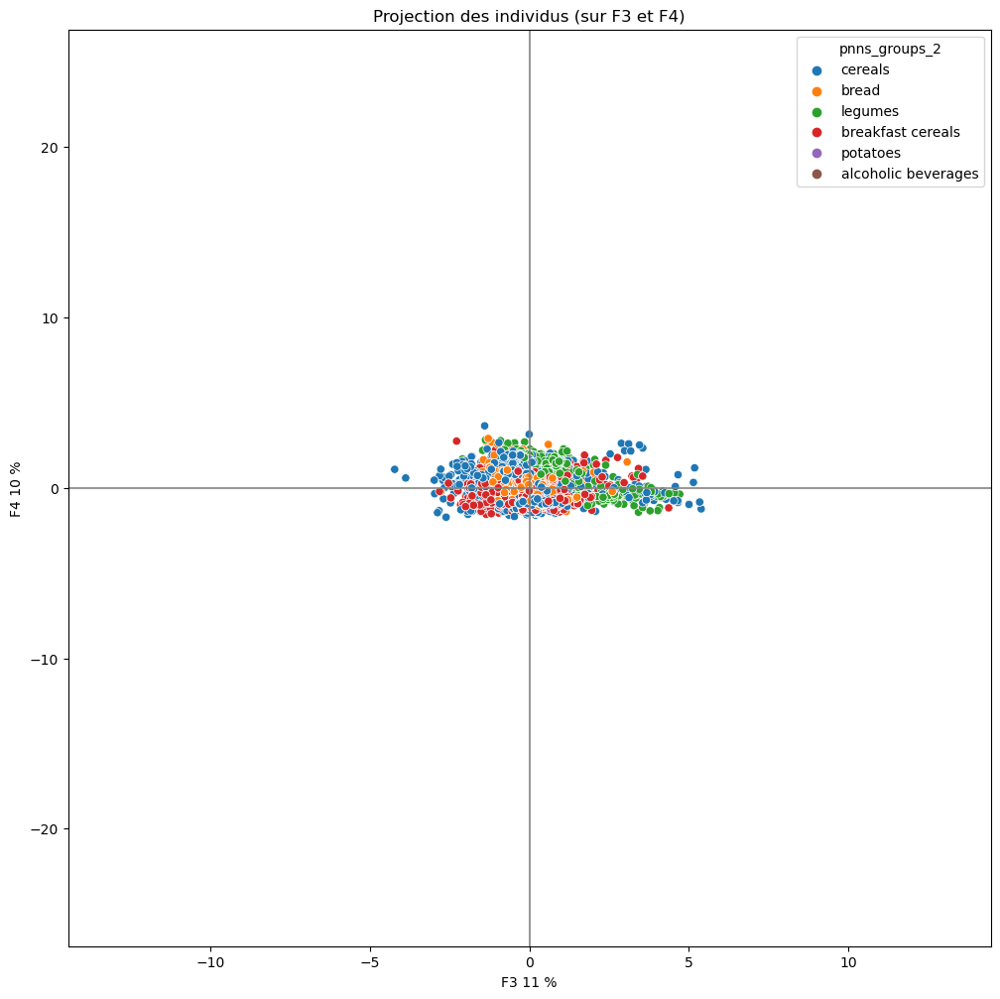

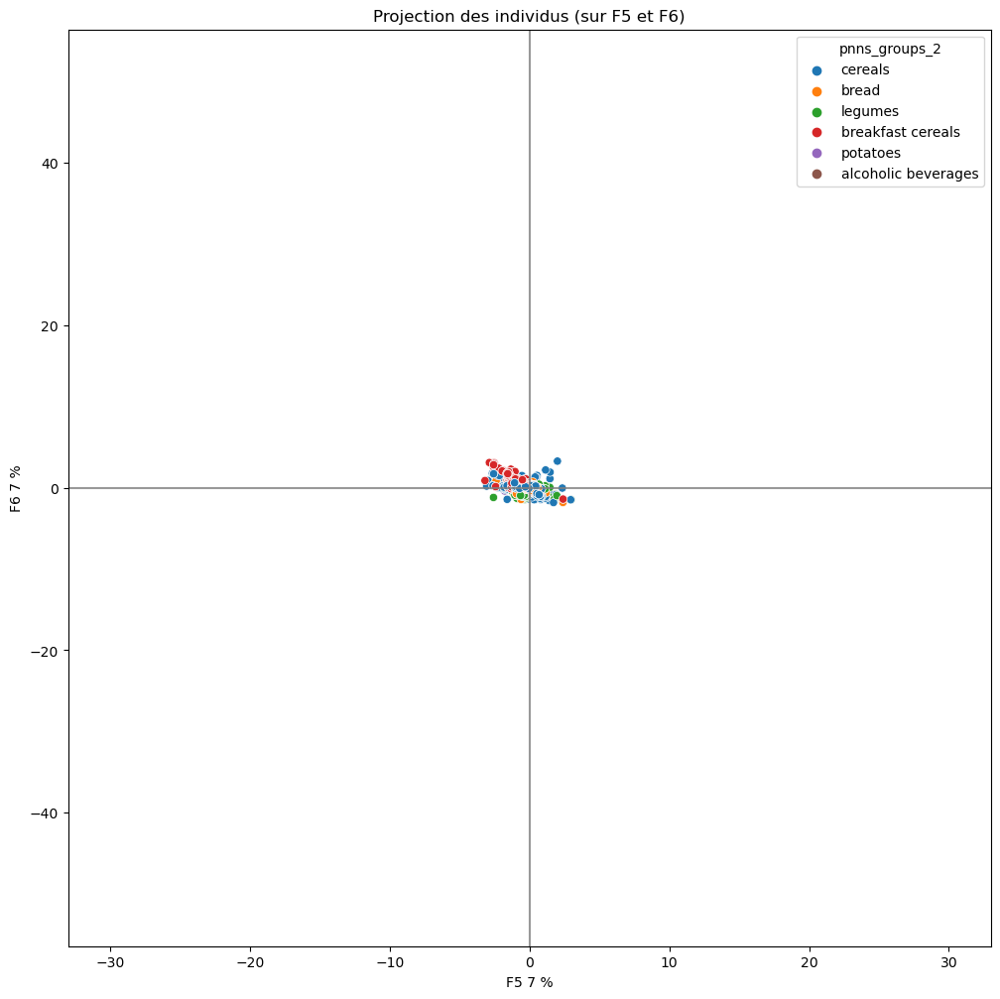

salty snacks


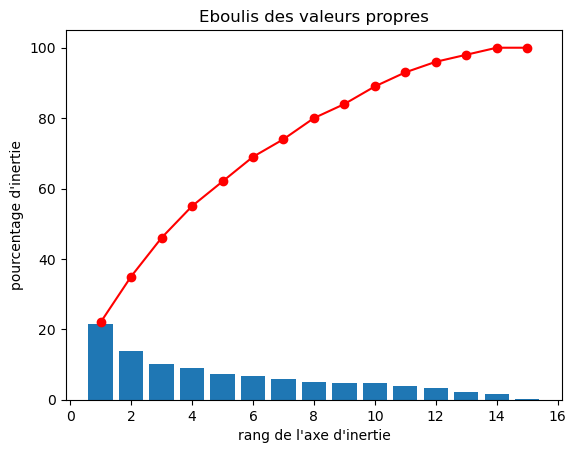

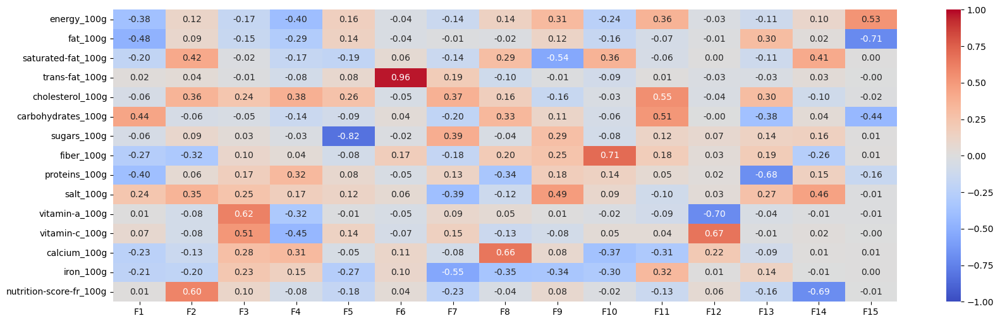

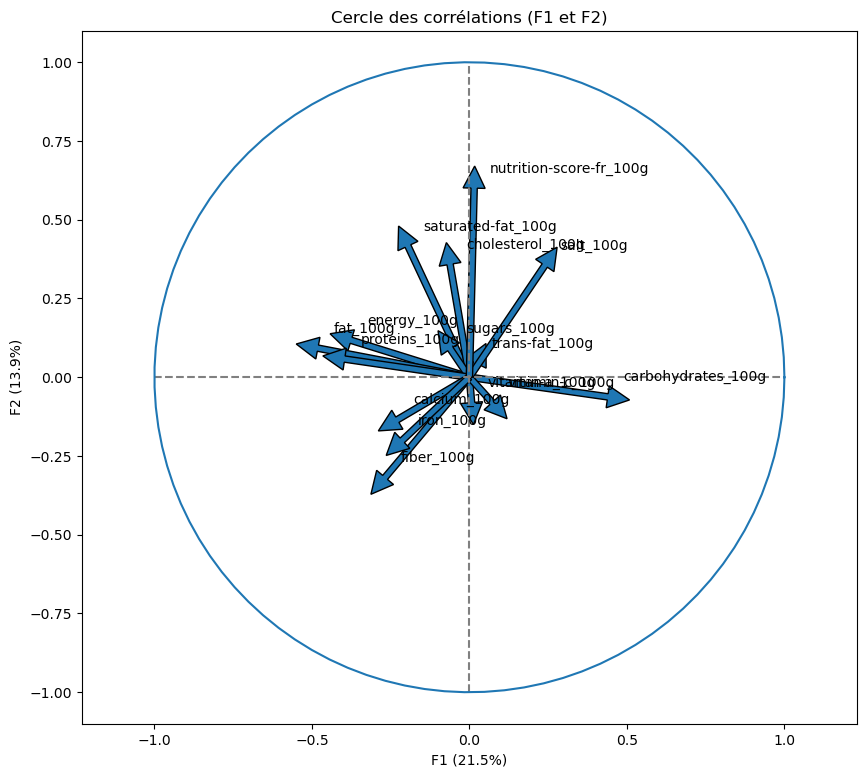

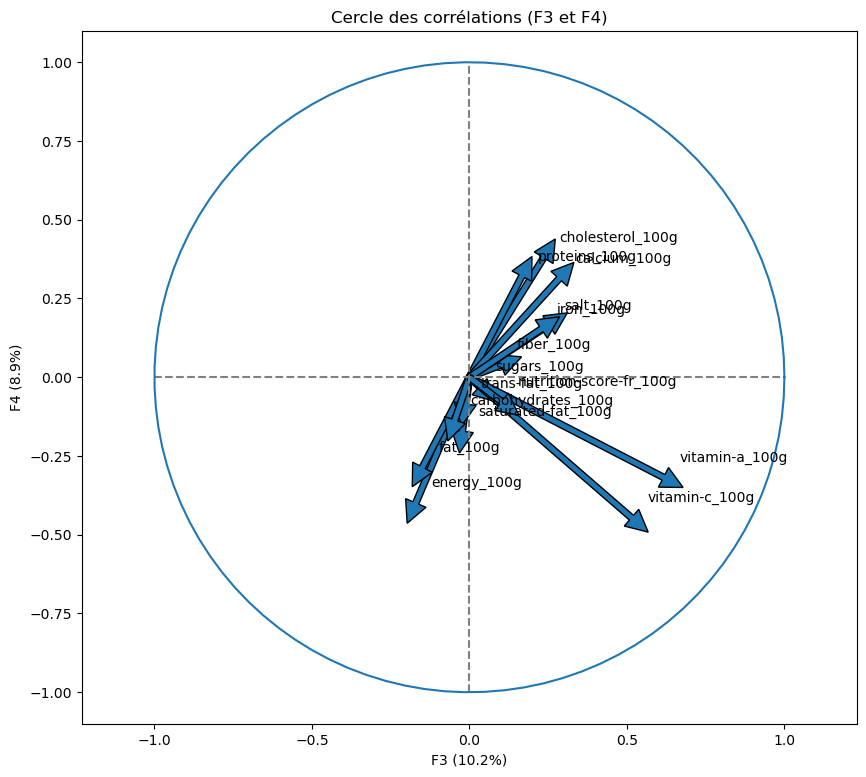

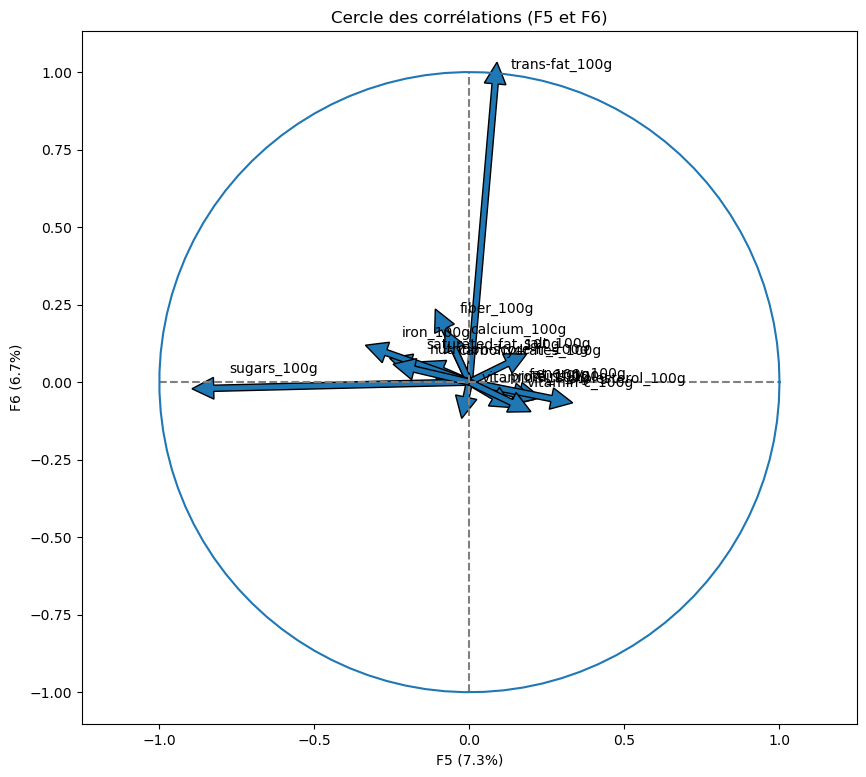

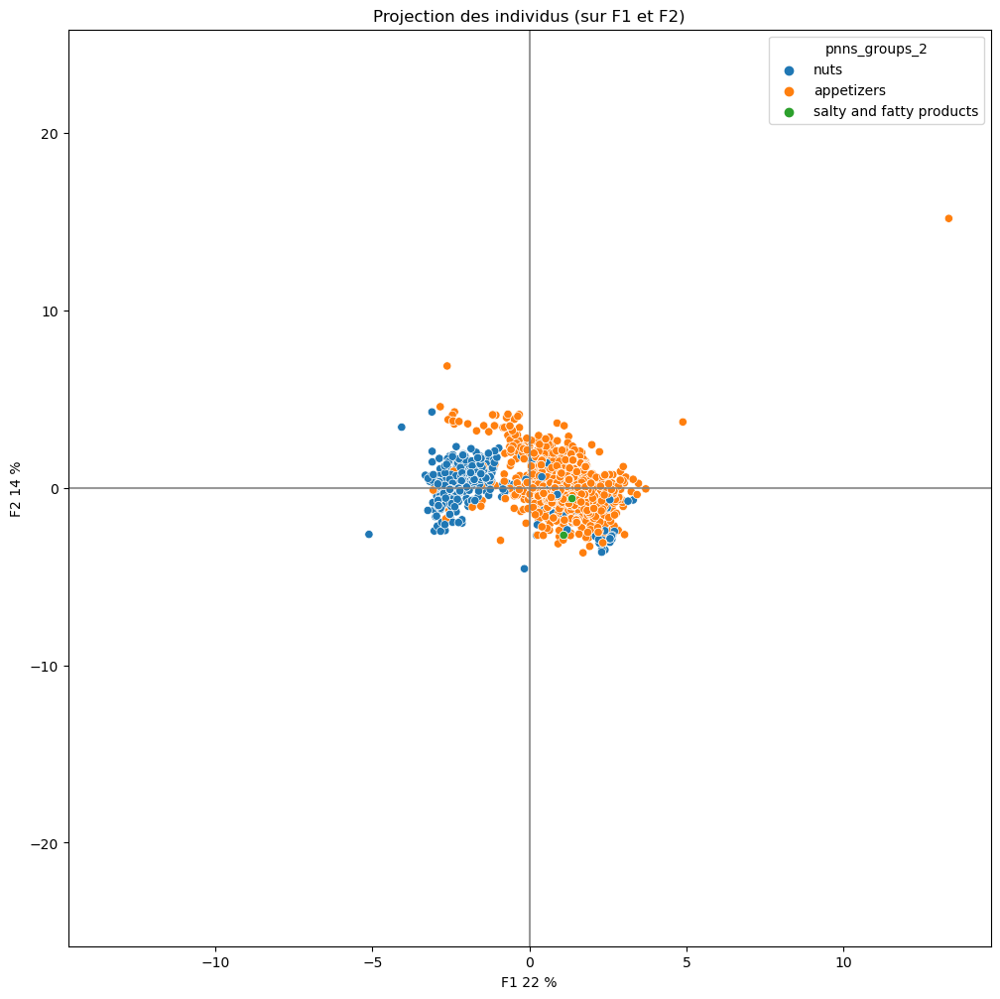

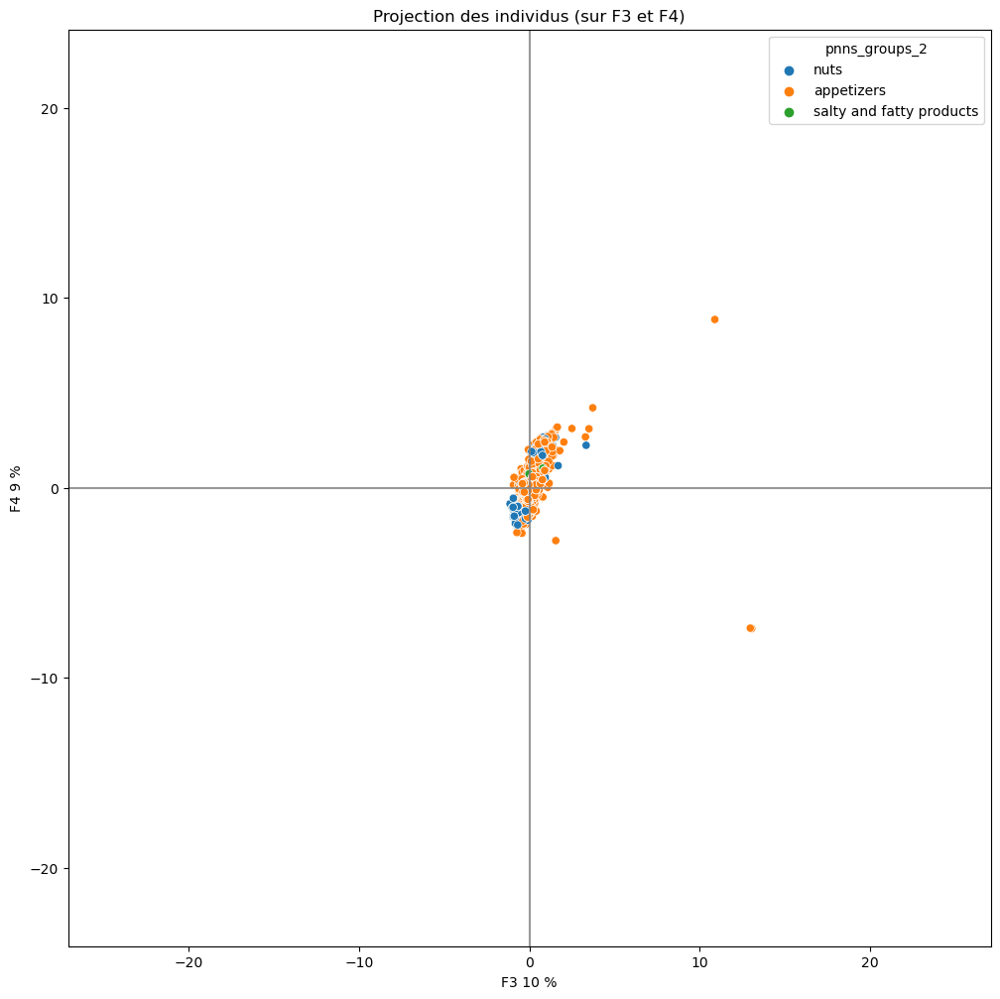

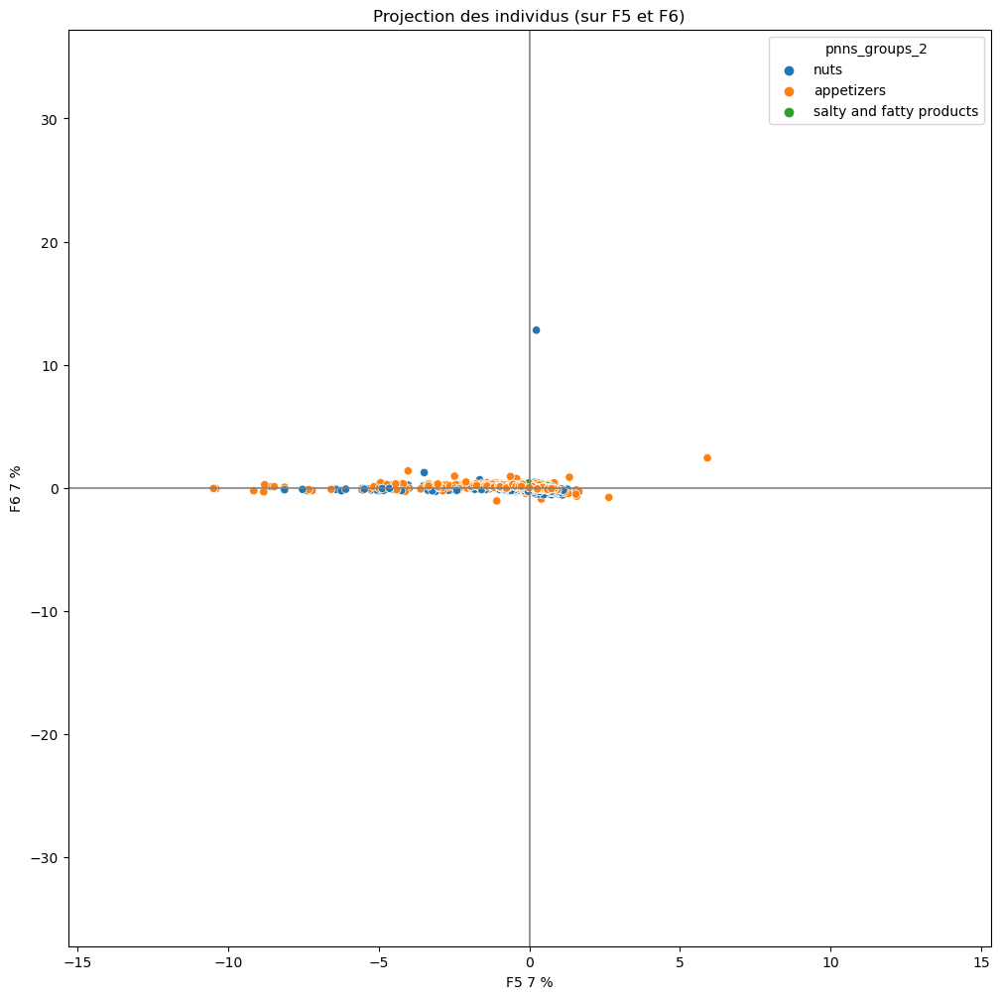

fish meat eggs


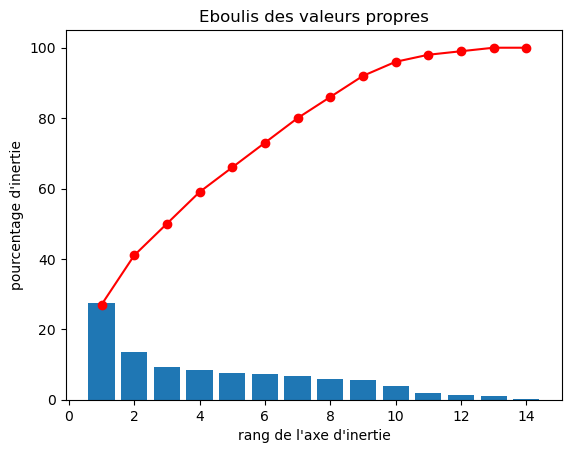

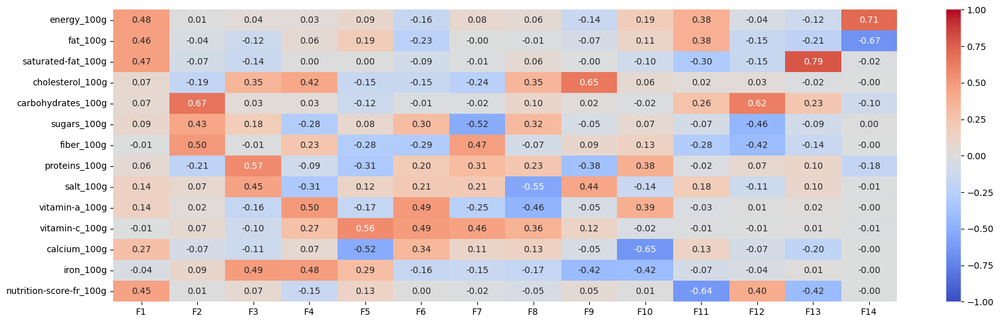

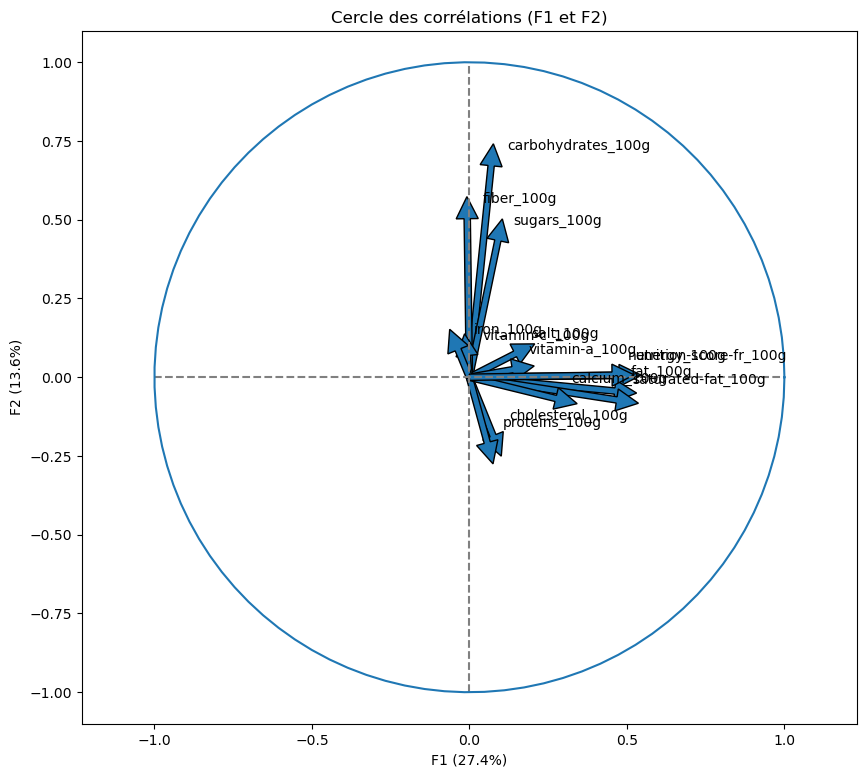

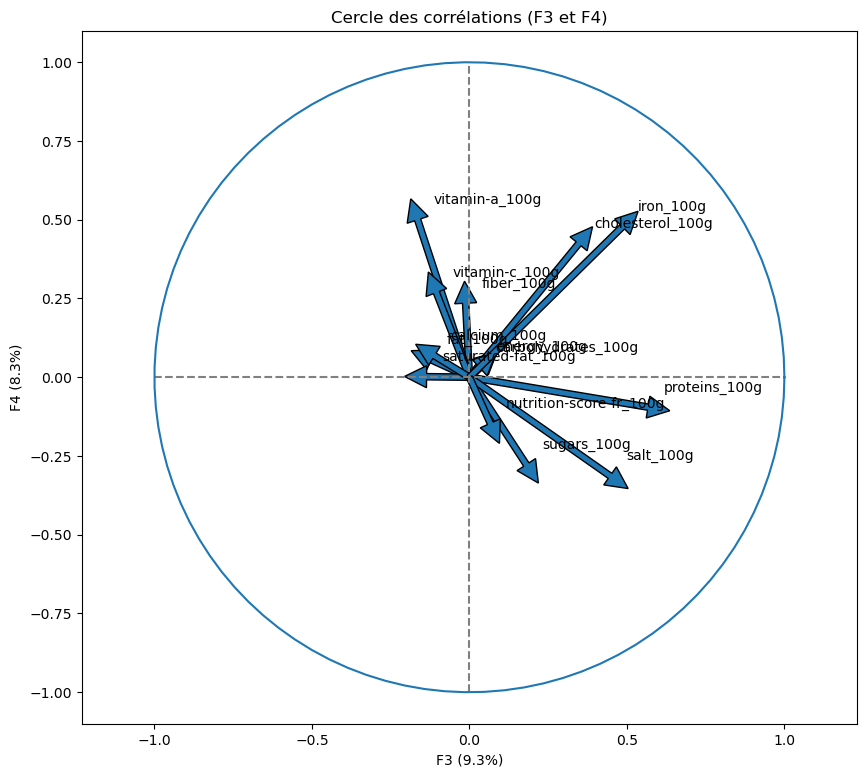

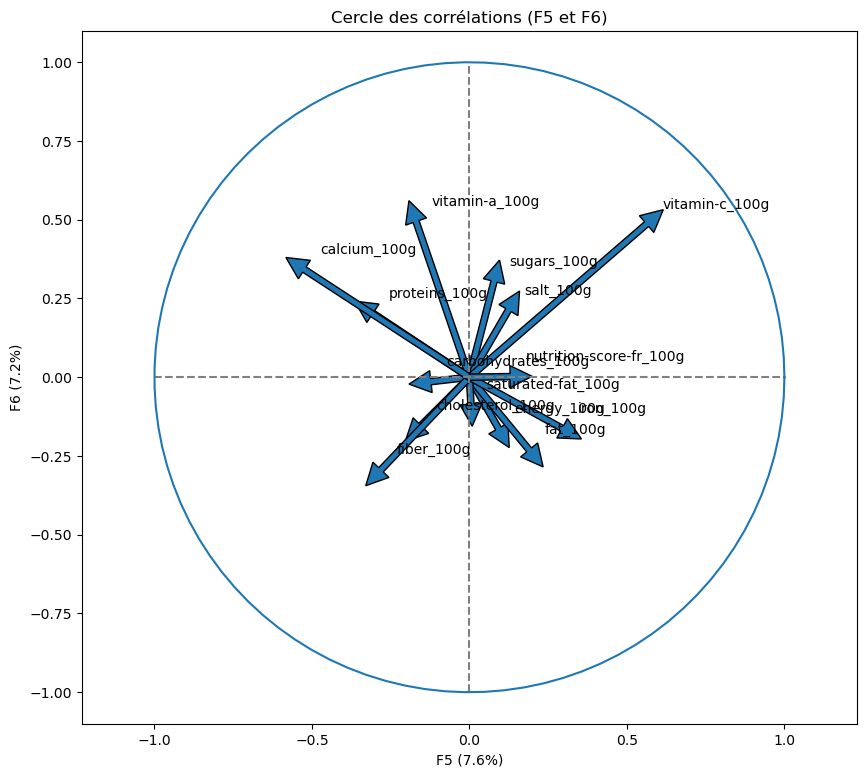

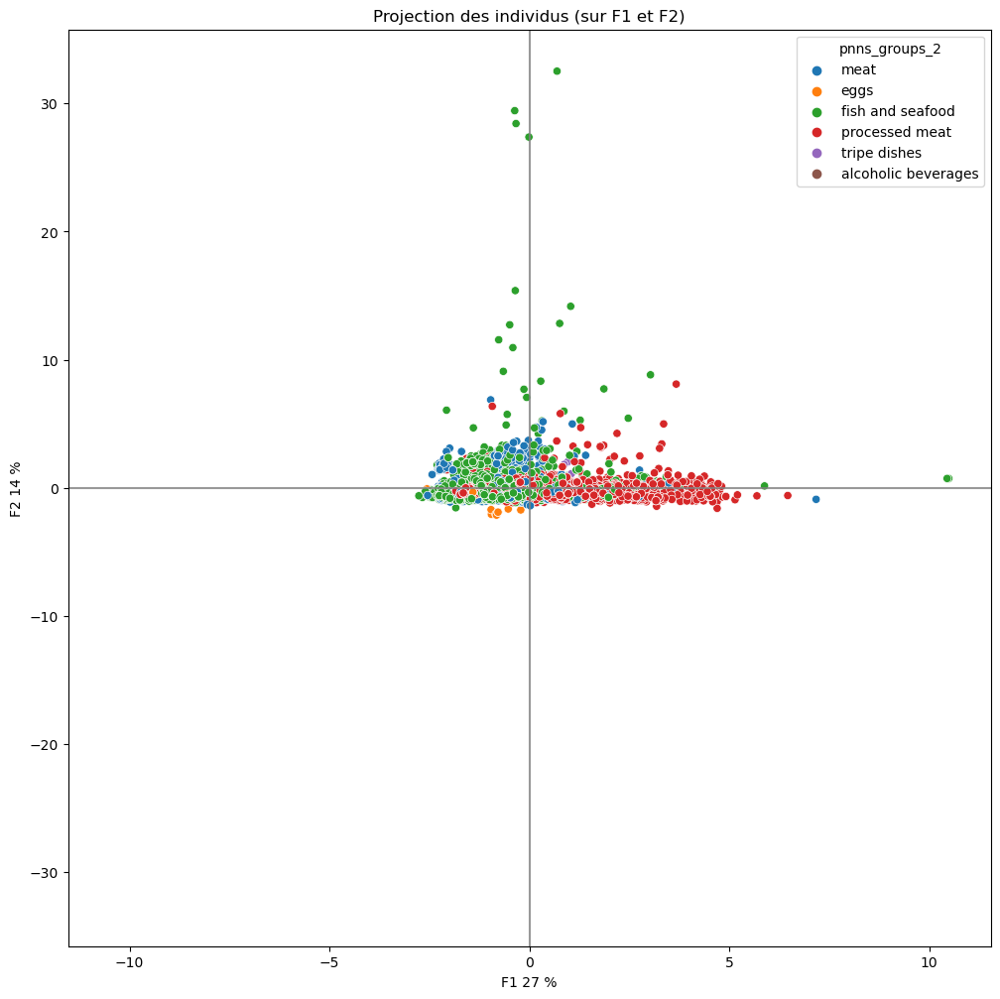

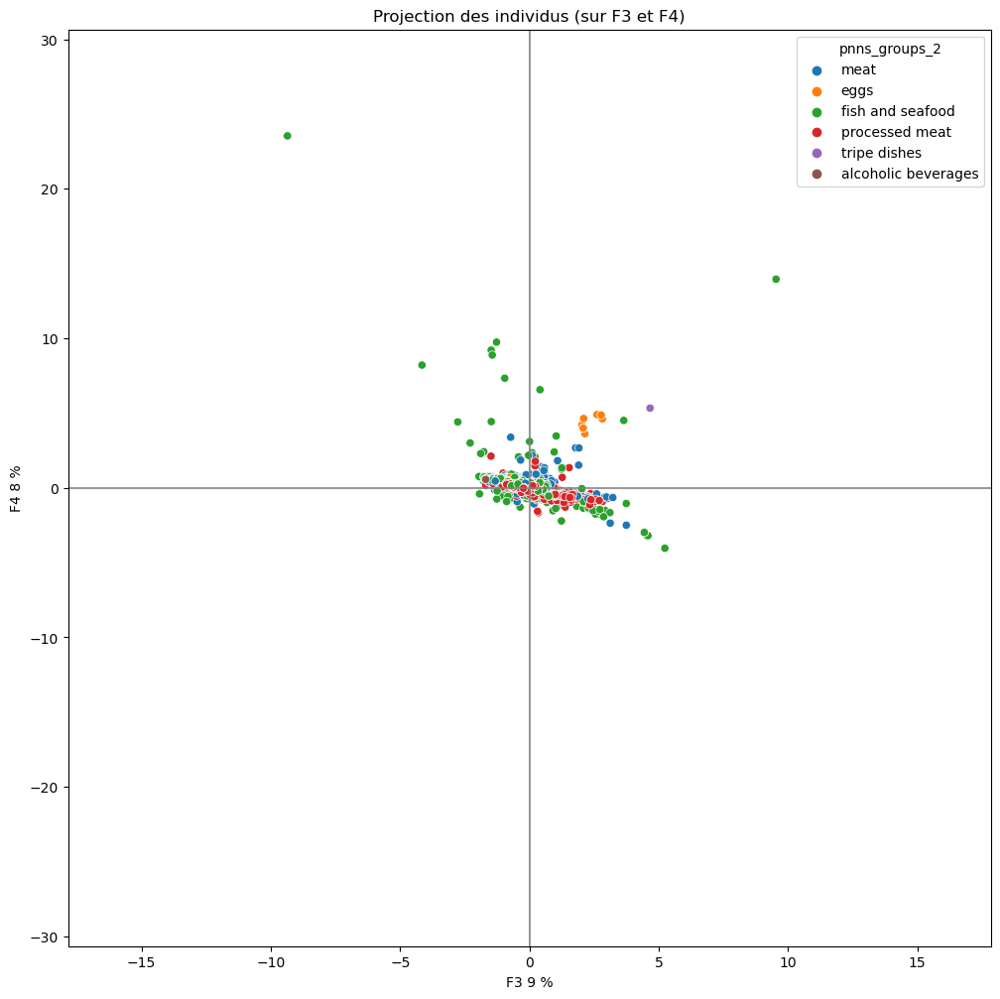

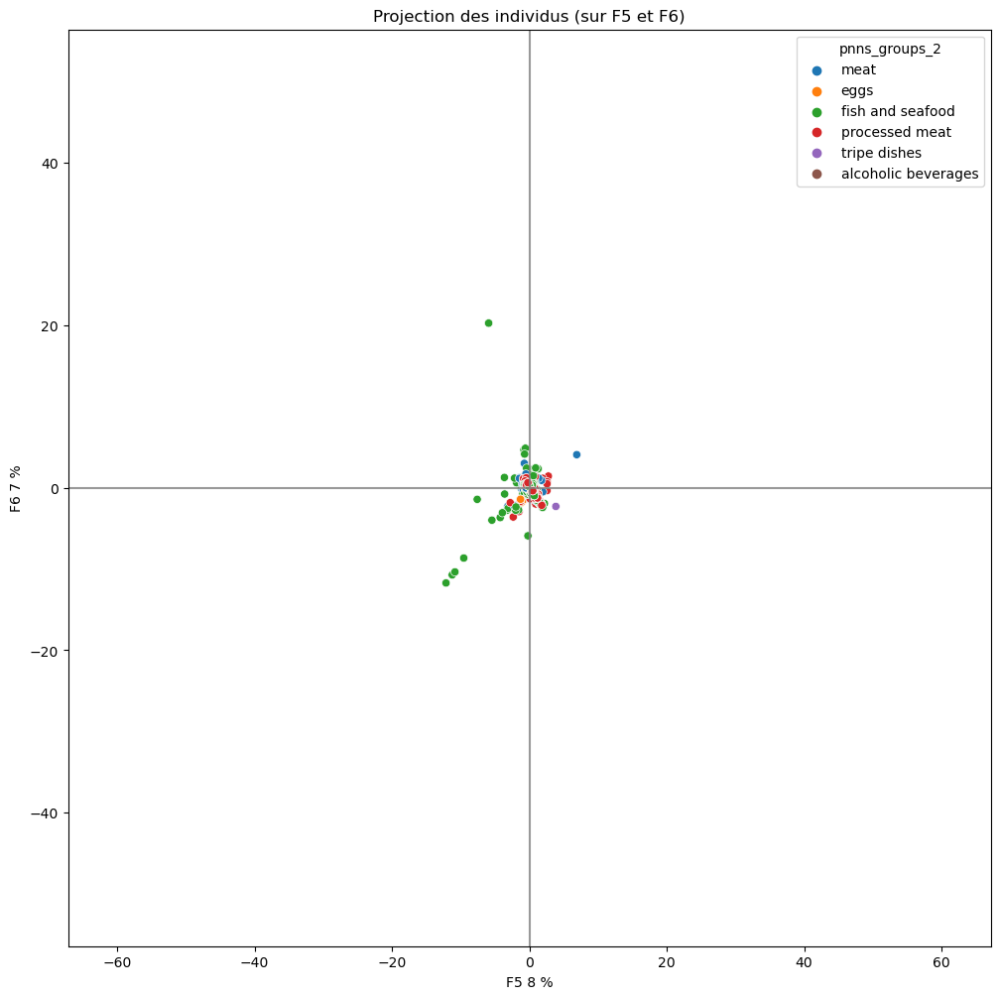

fruits and vegetables


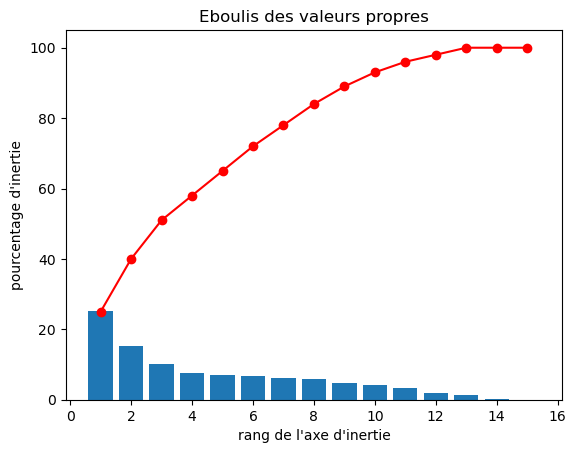

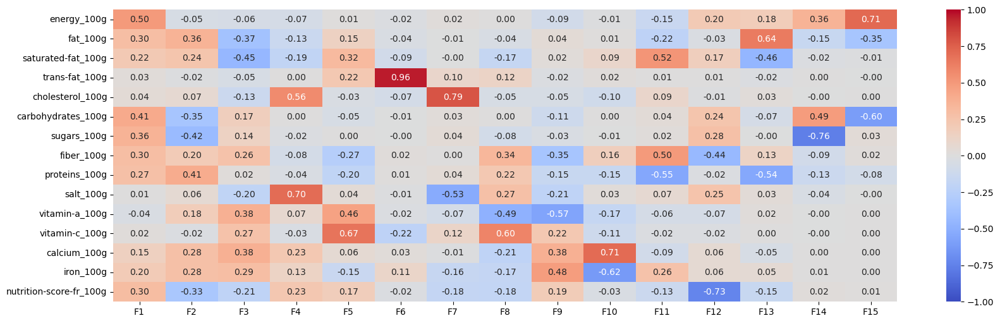

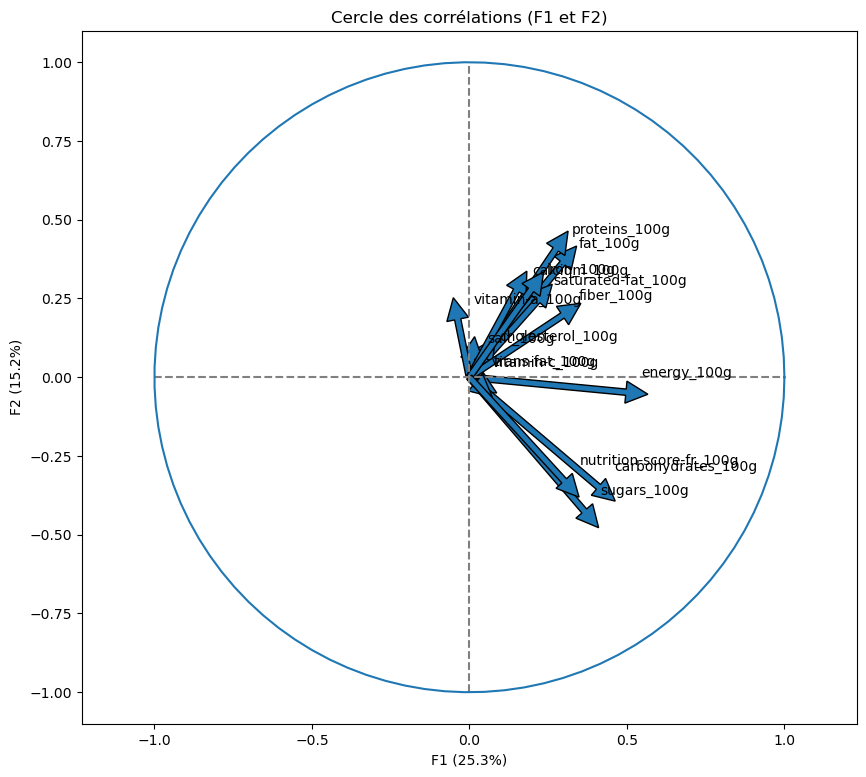

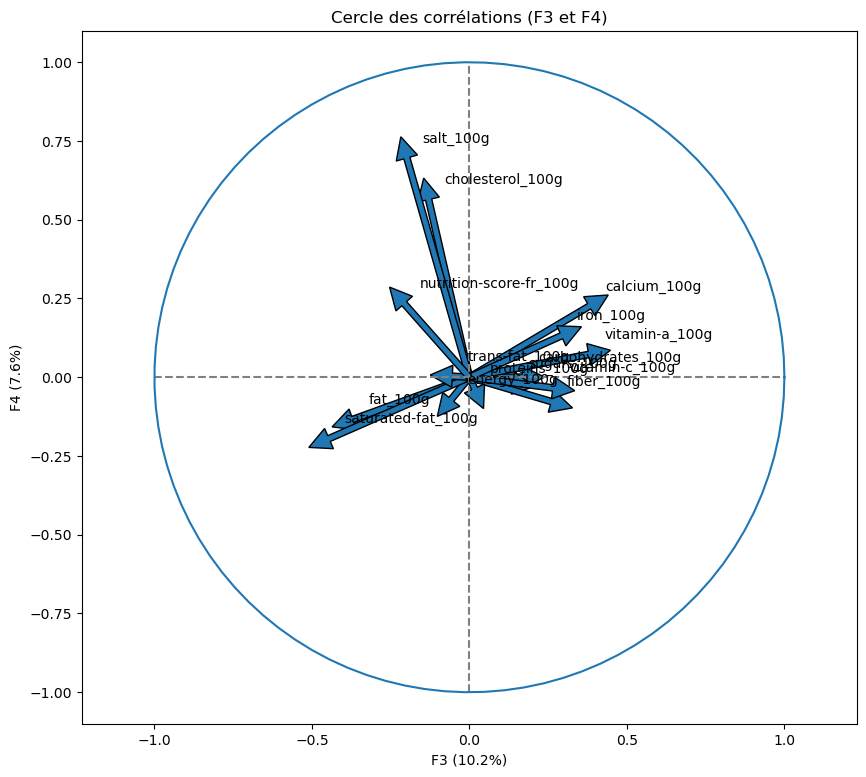

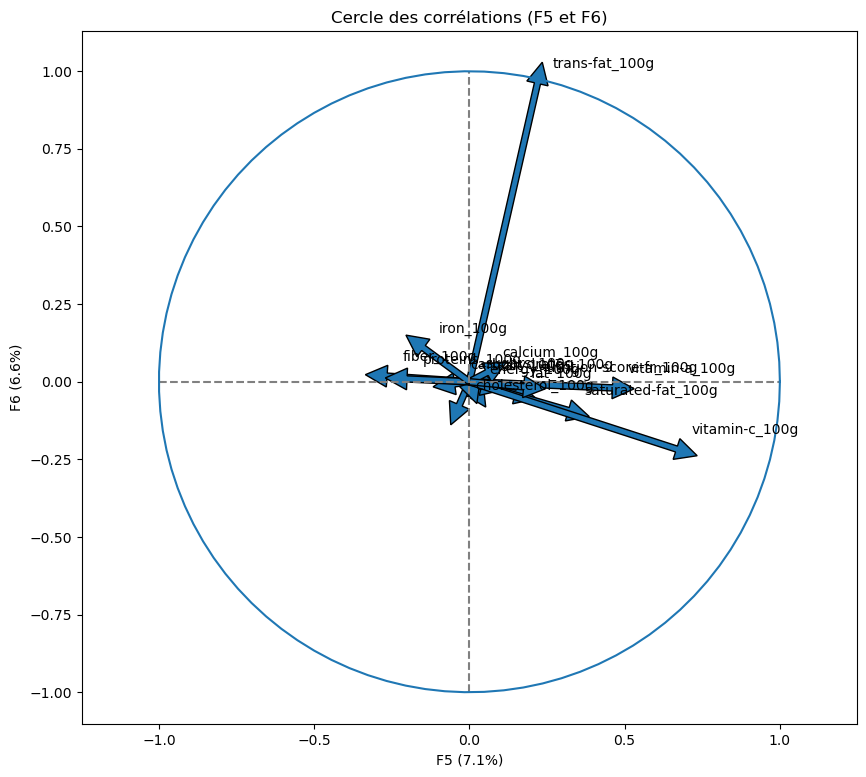

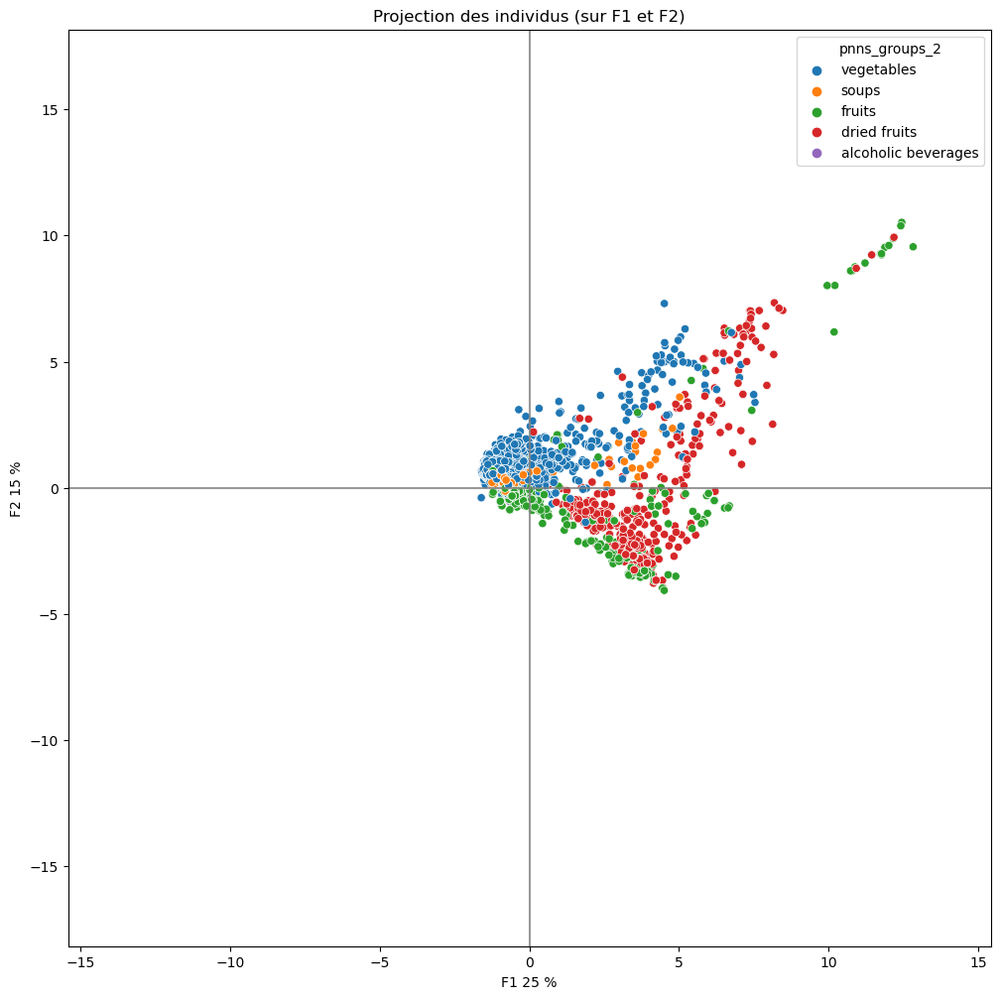

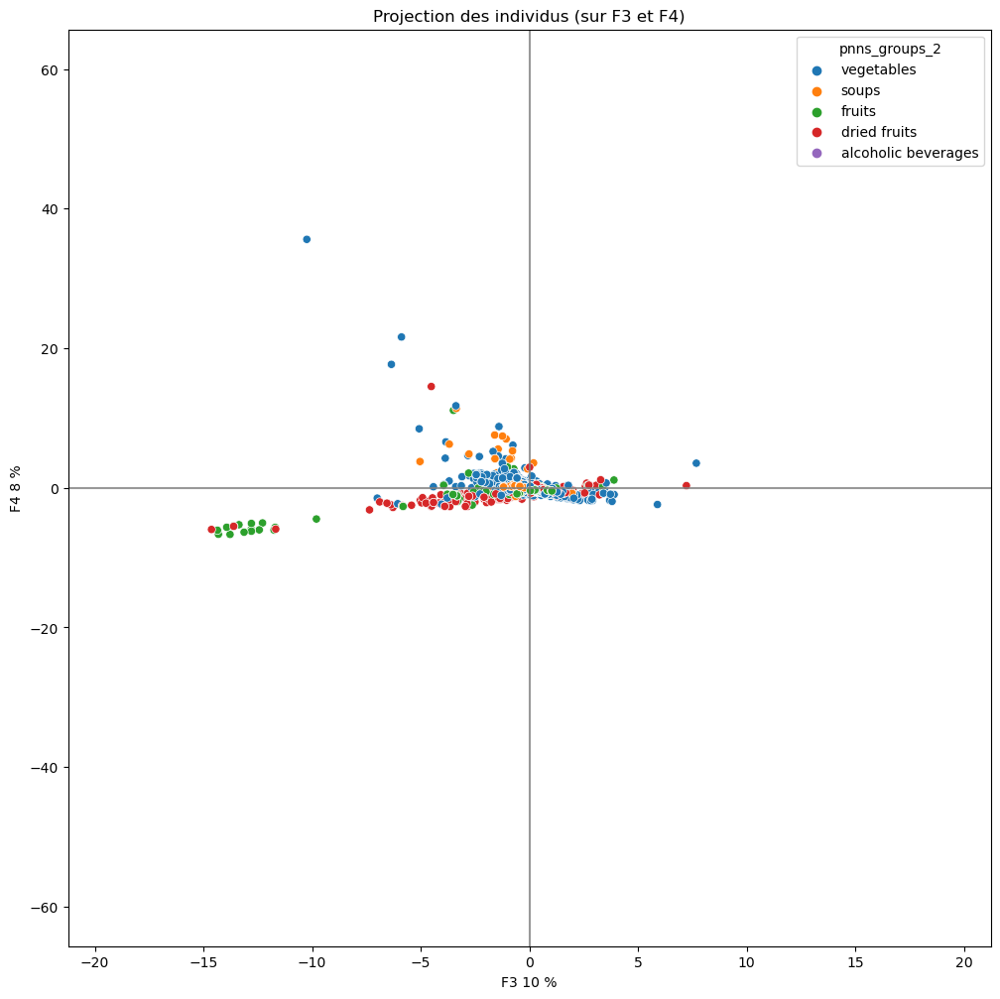

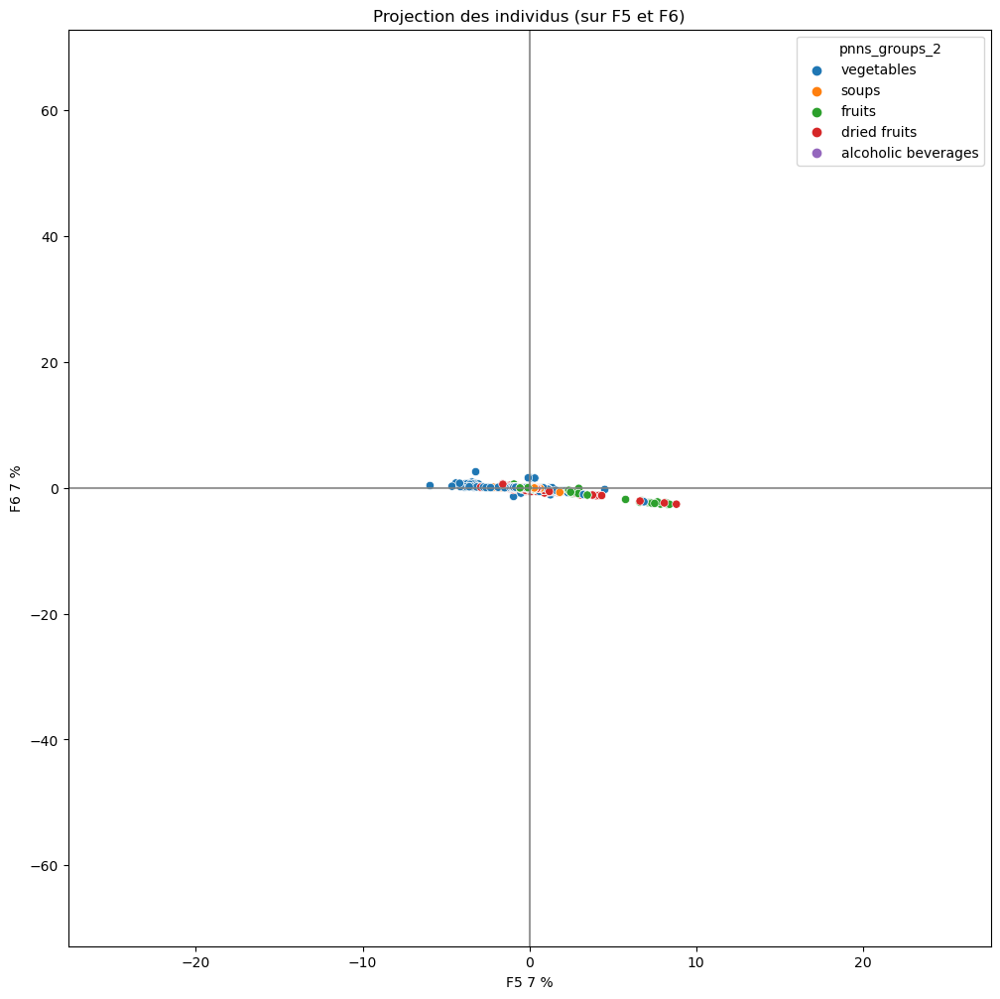

composite foods


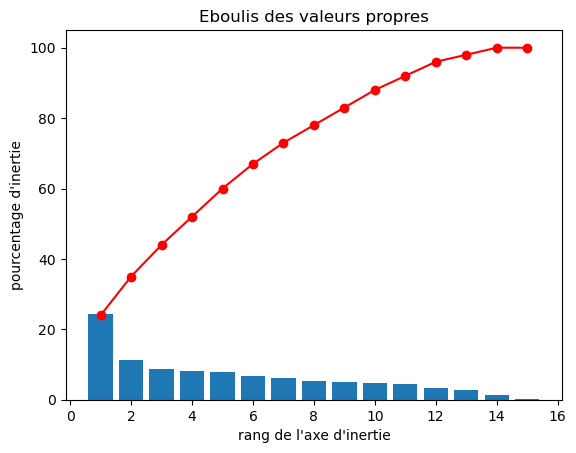

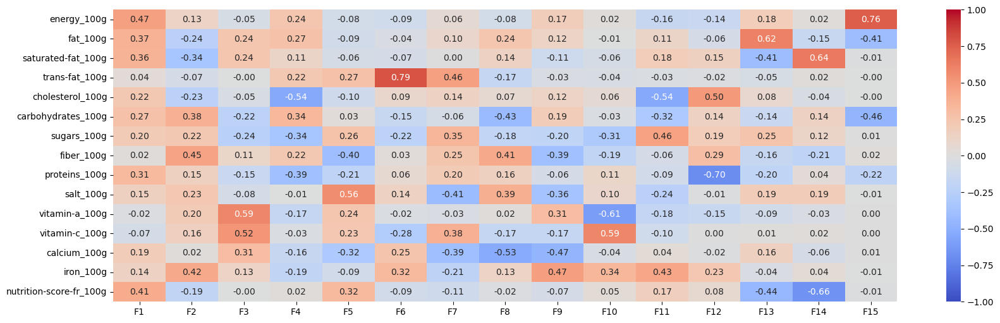

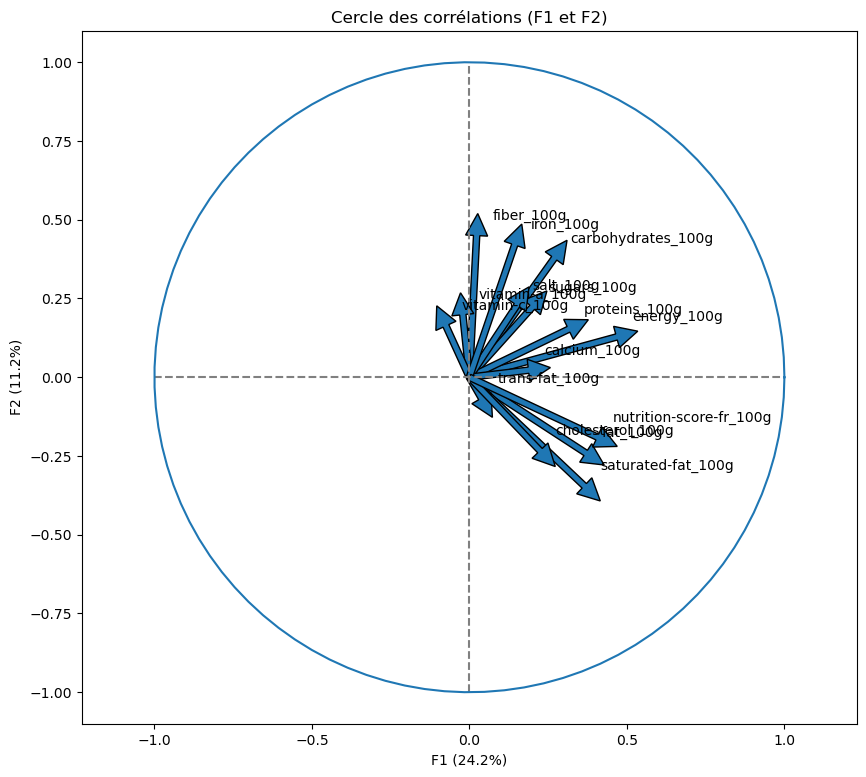

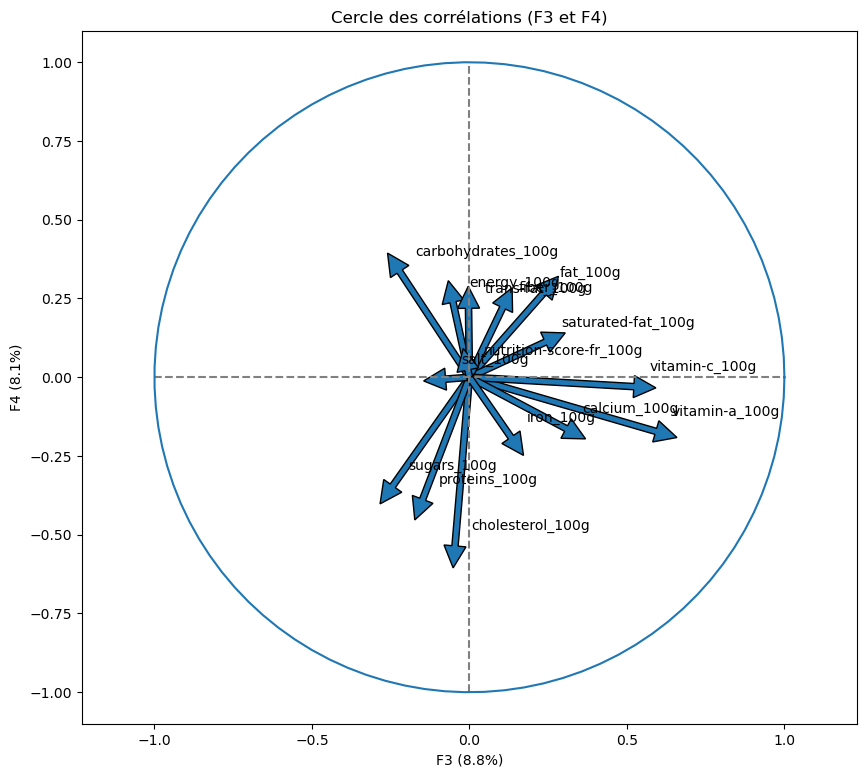

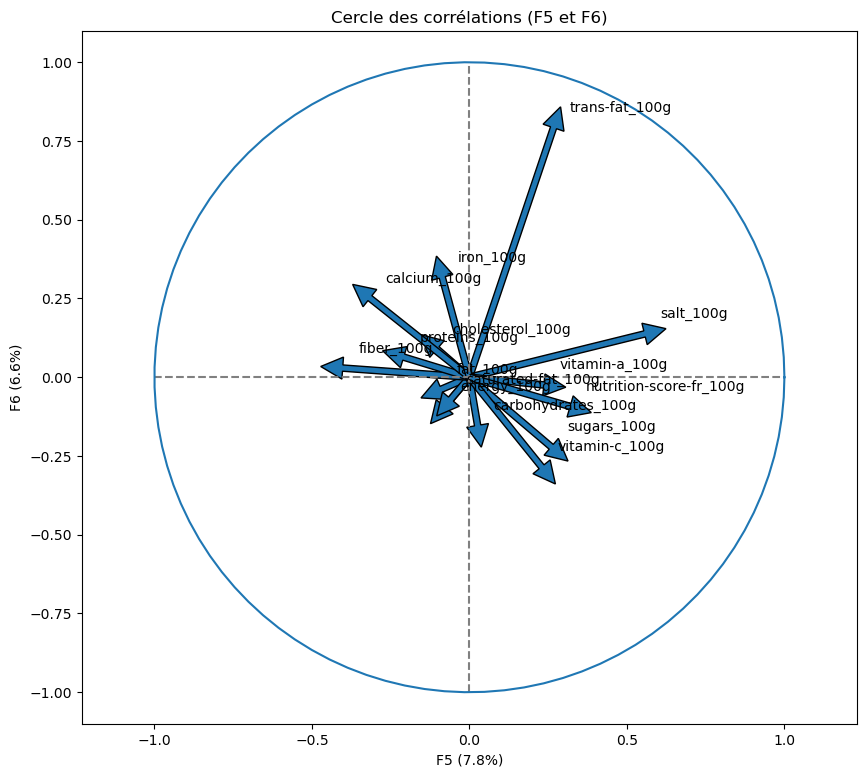

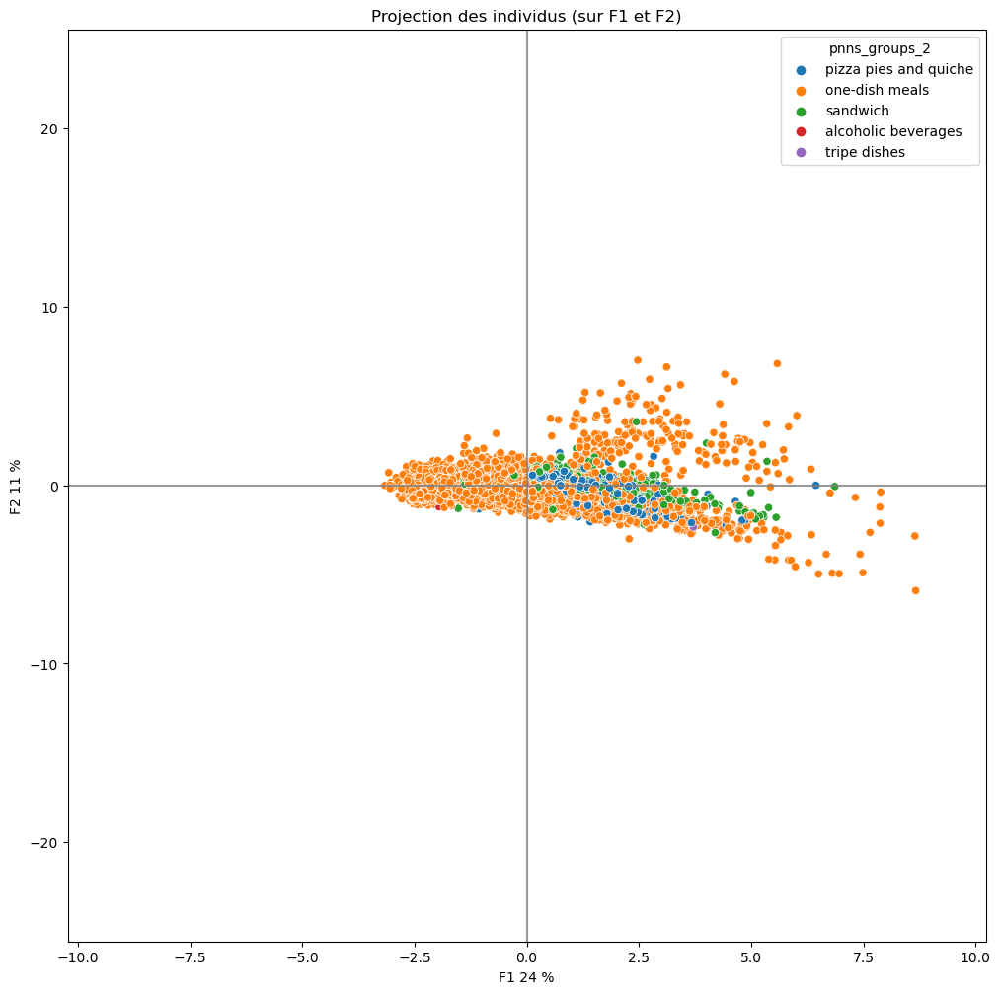

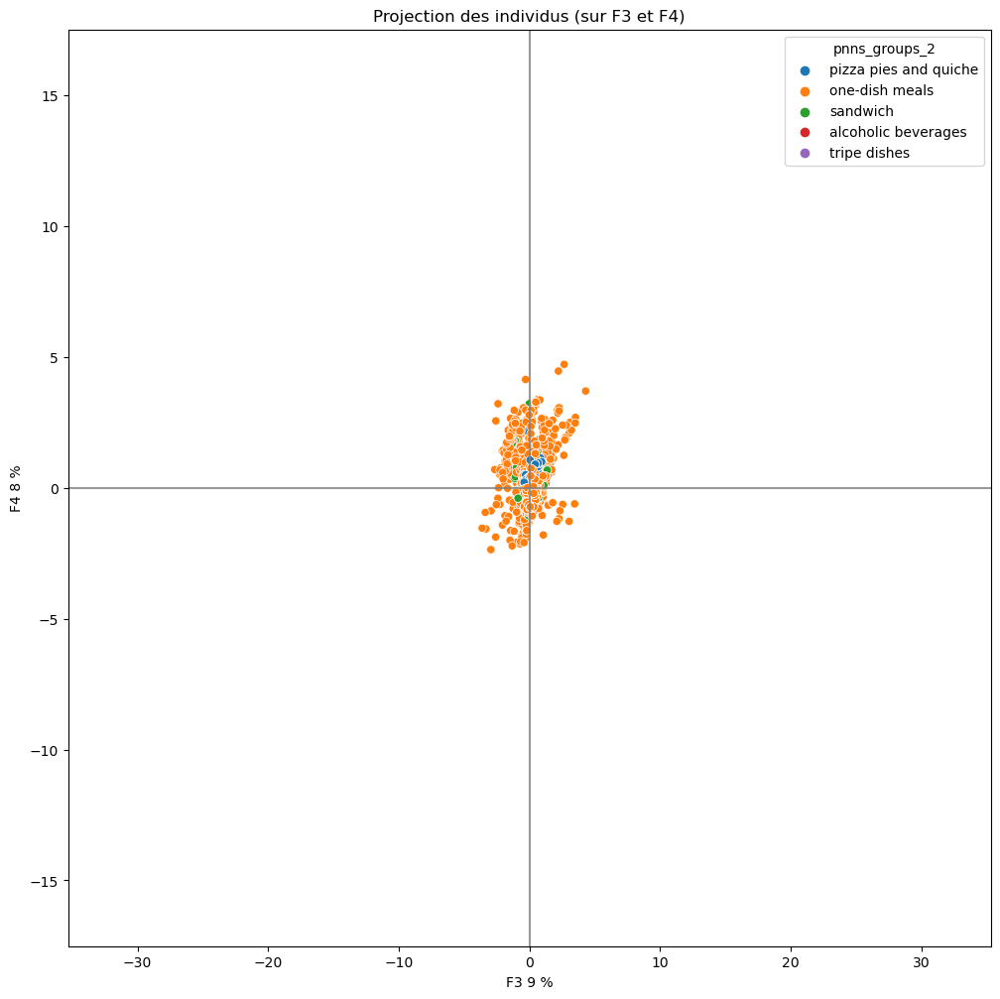

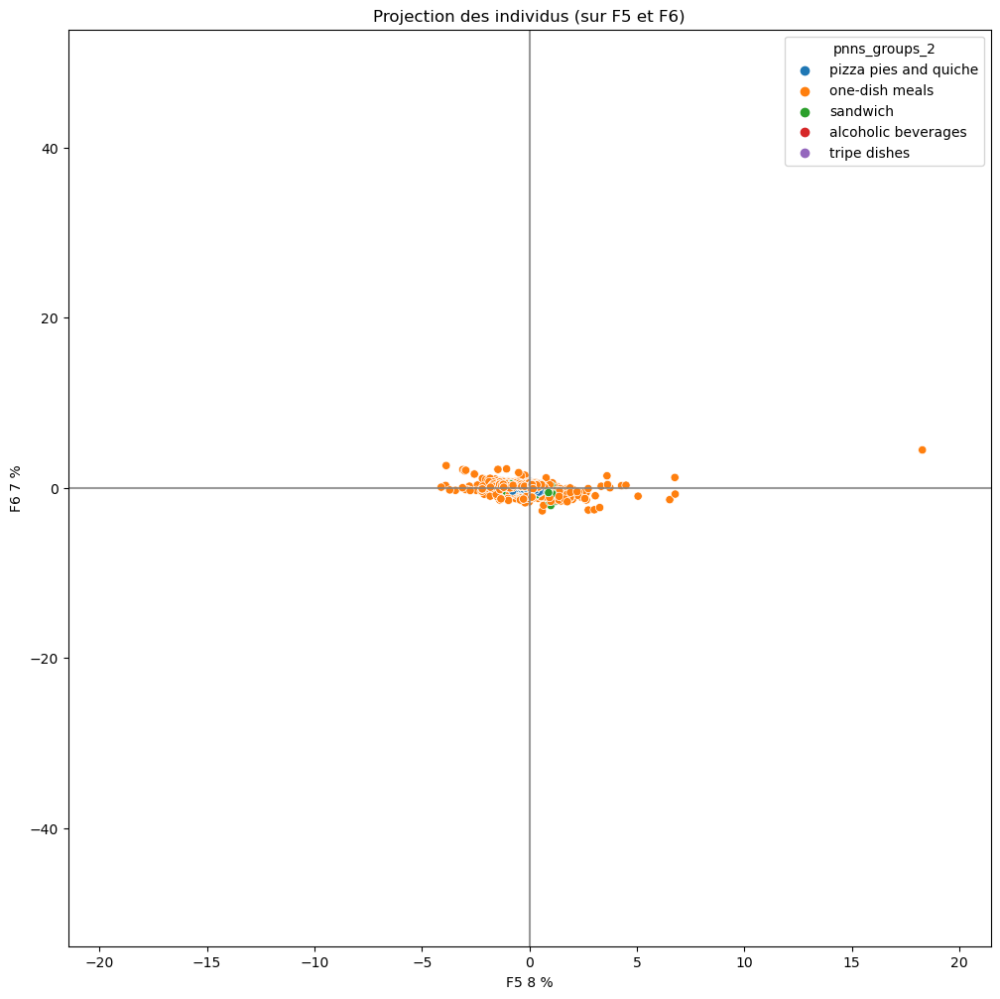

milk and dairy products


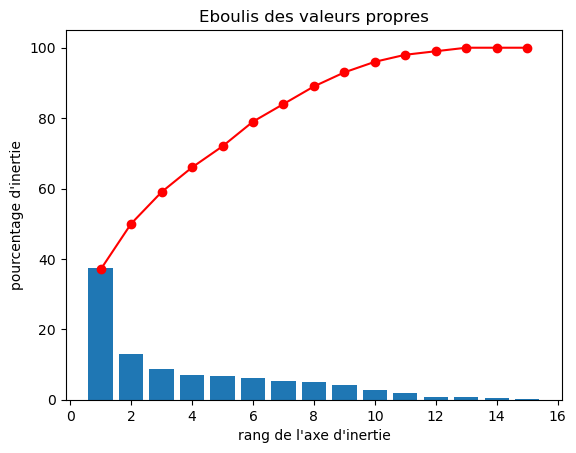

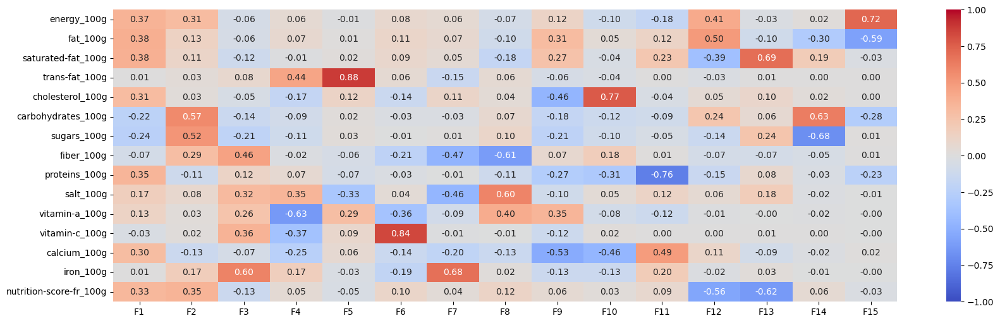

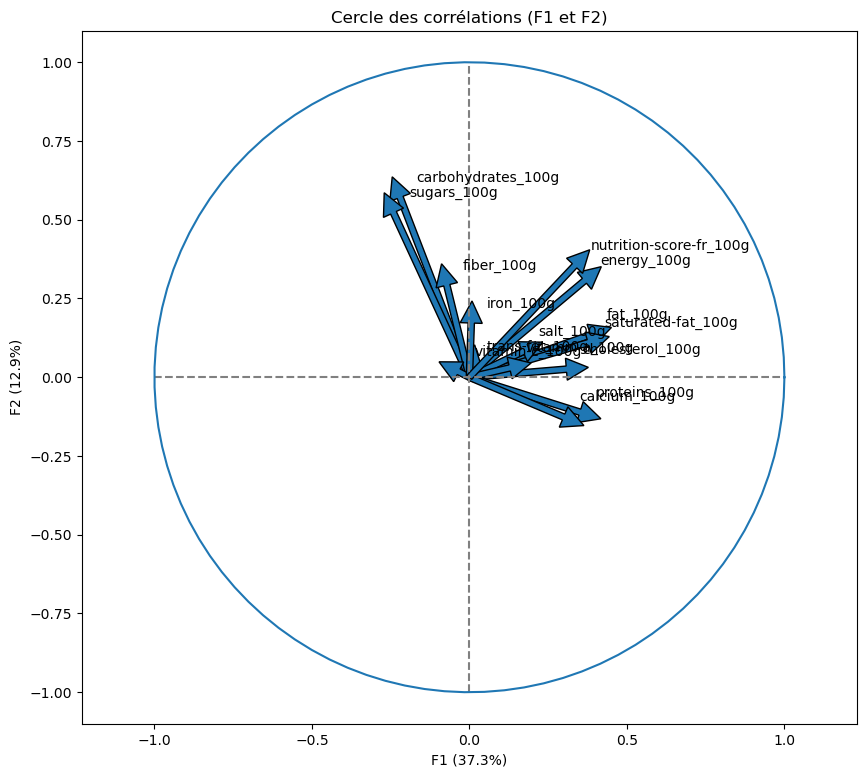

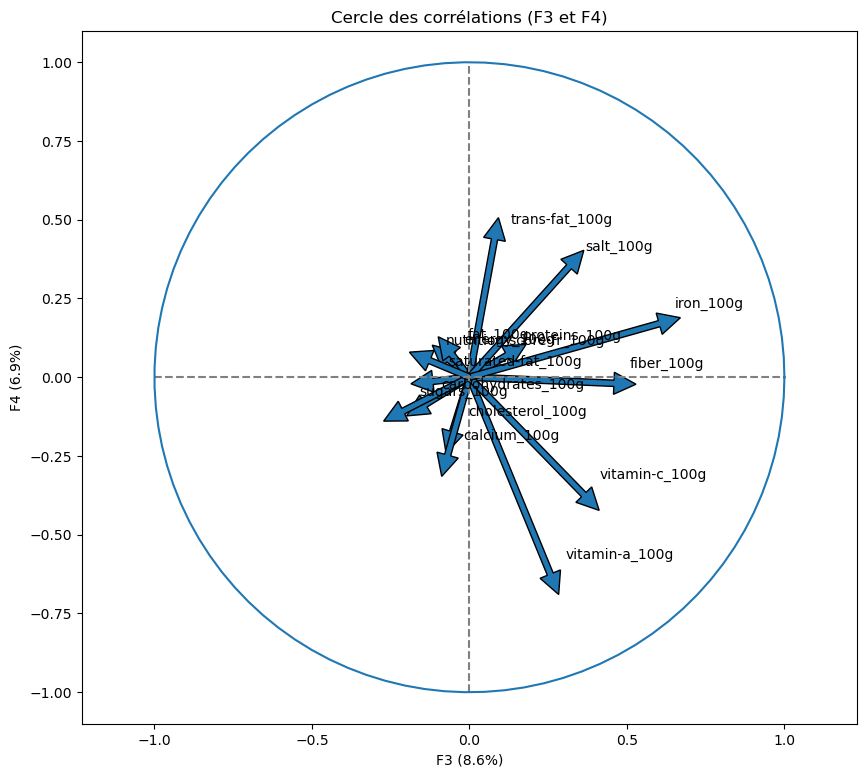

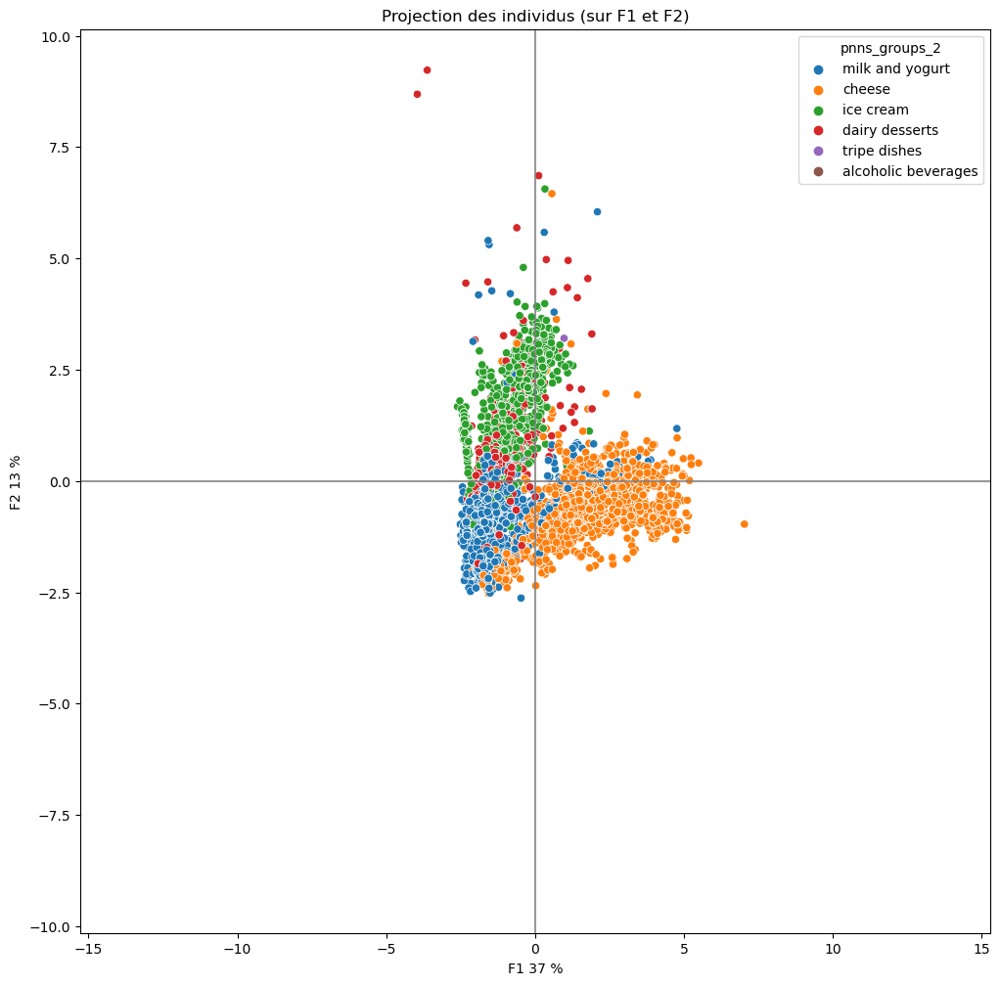

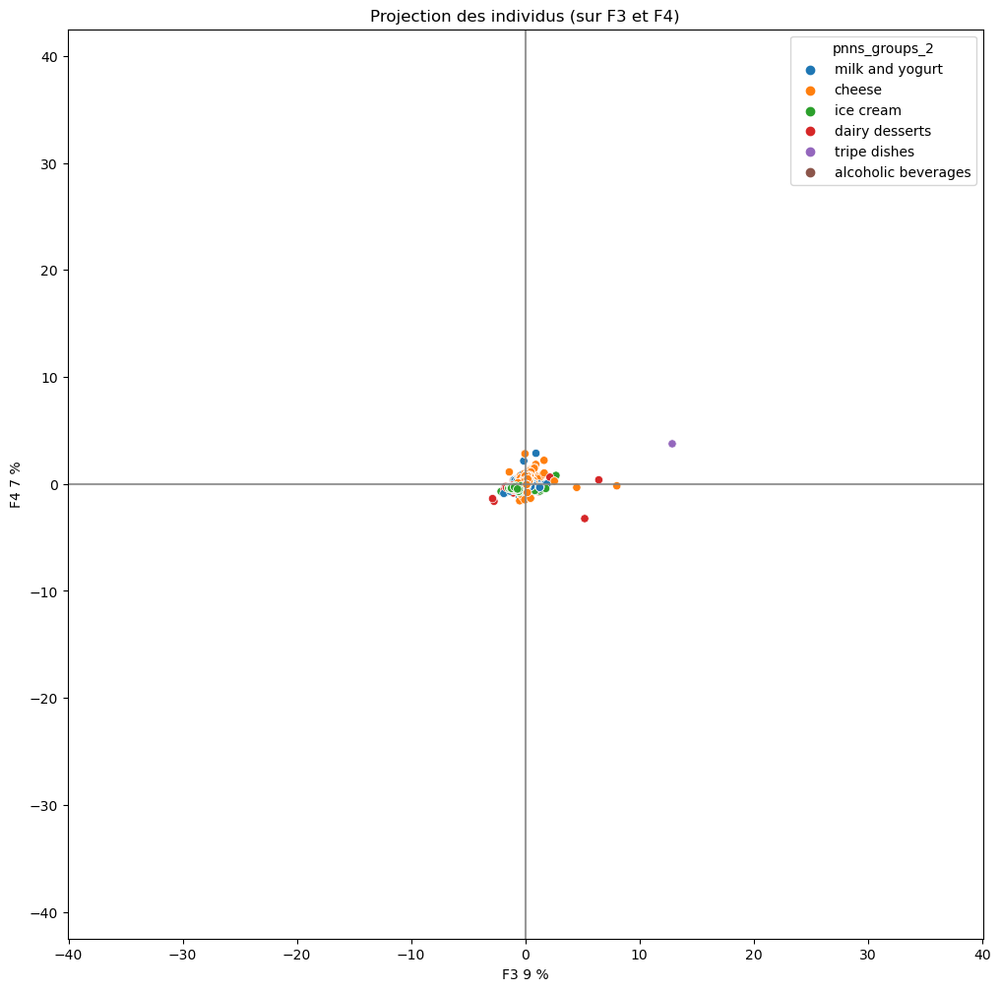

beverages


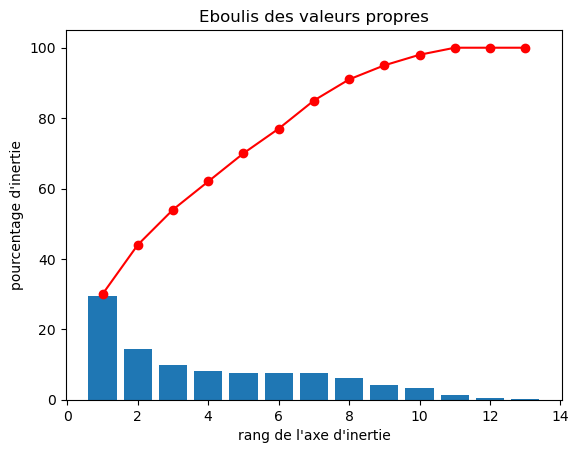

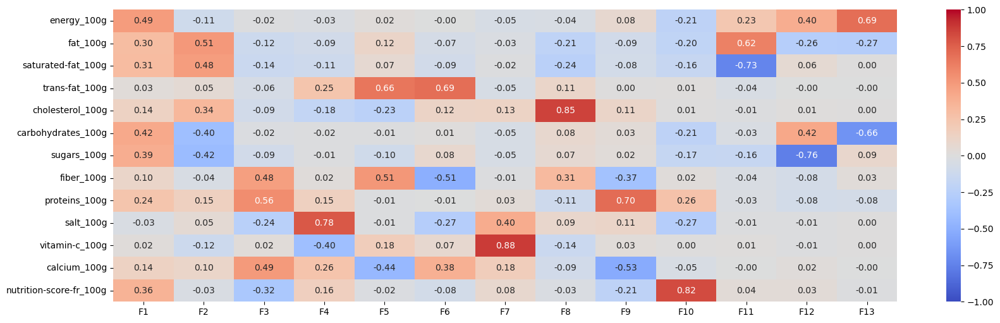

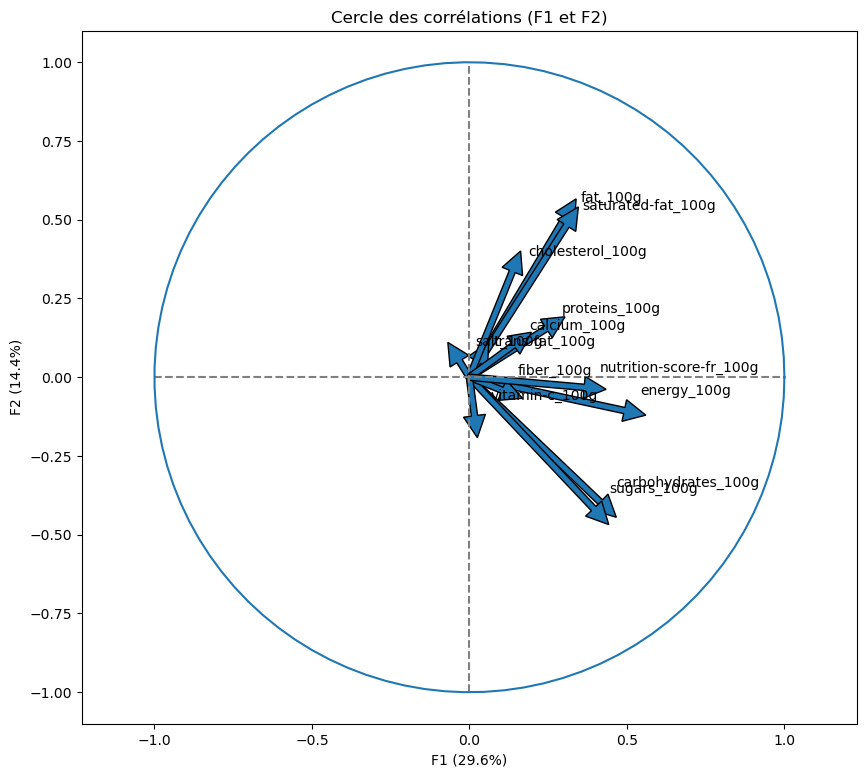

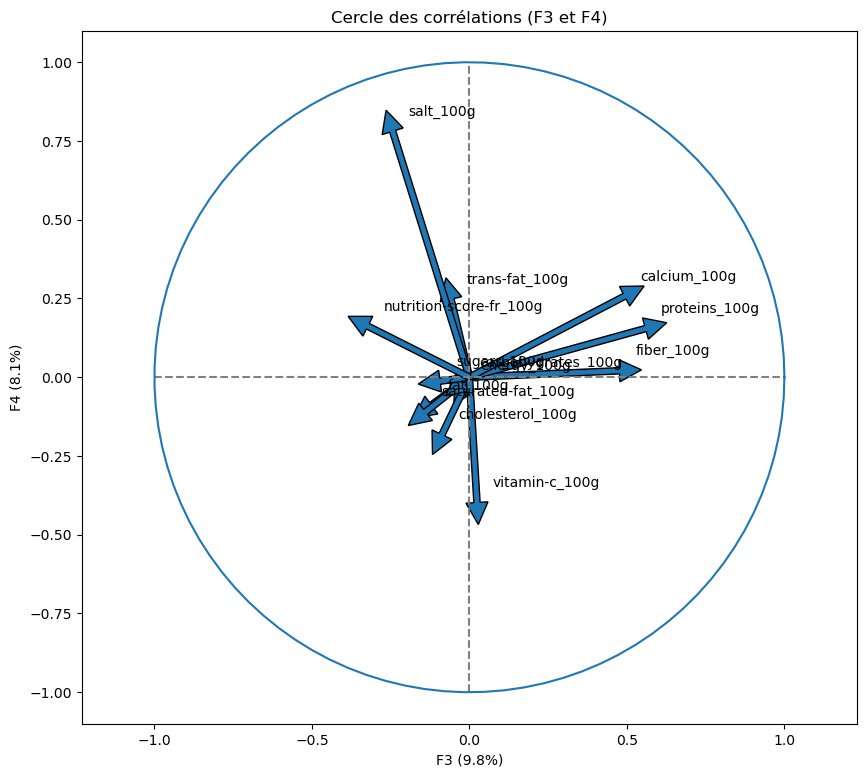

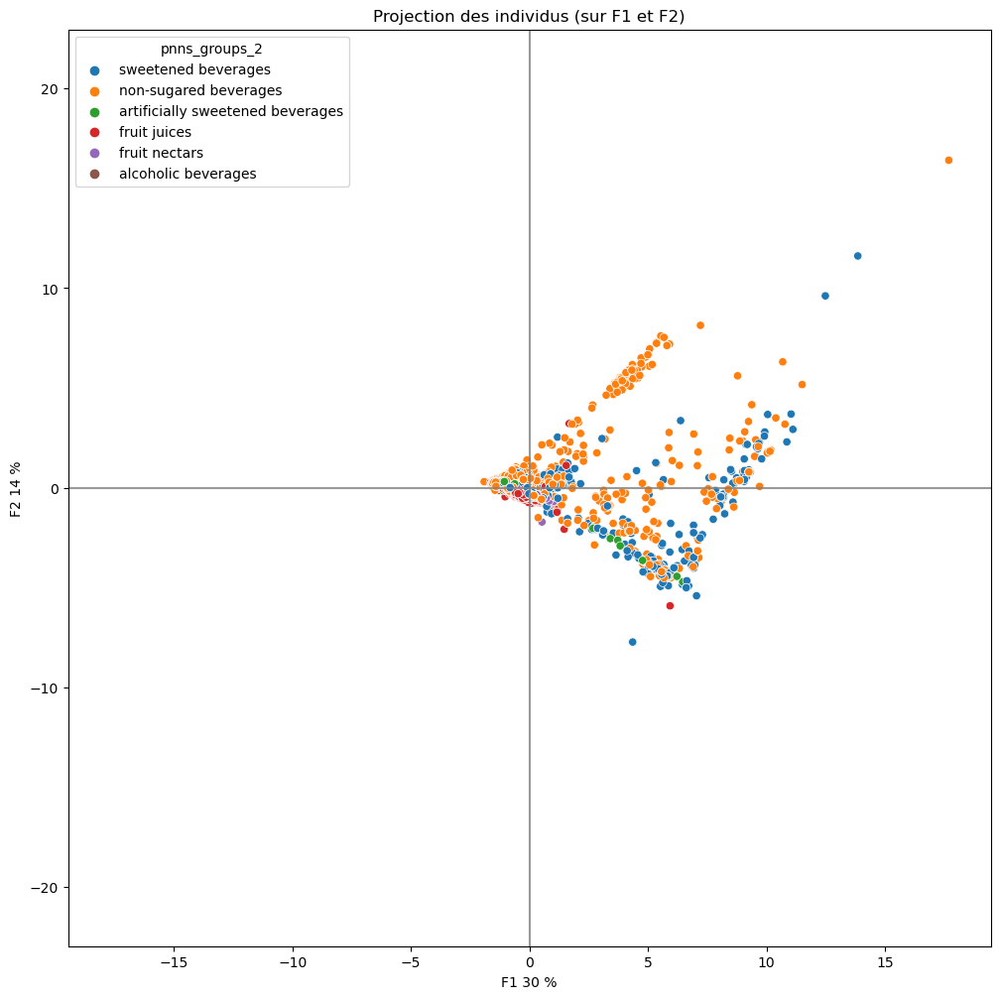

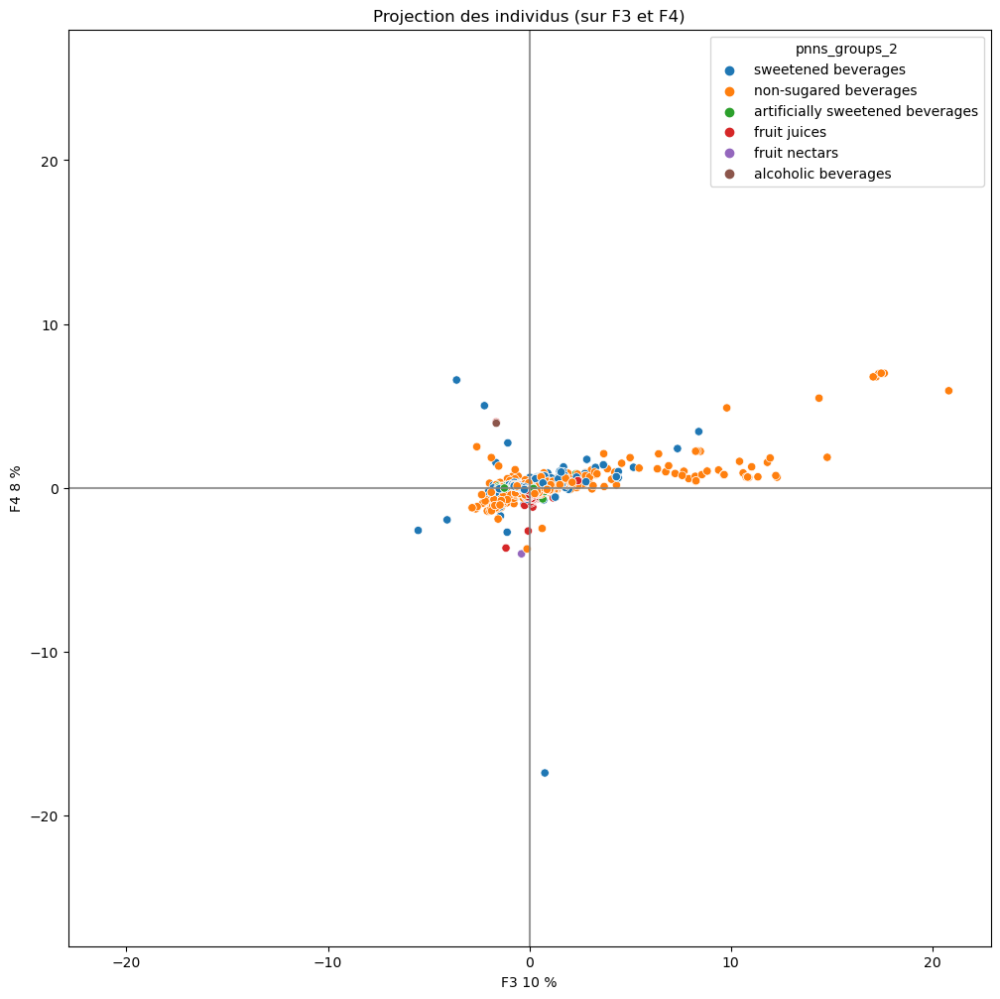

fat and sauces


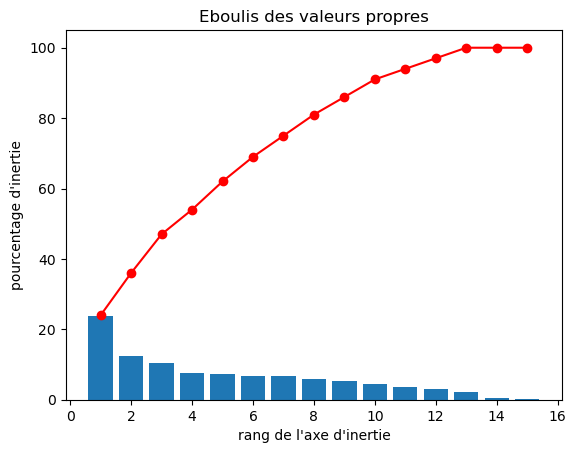

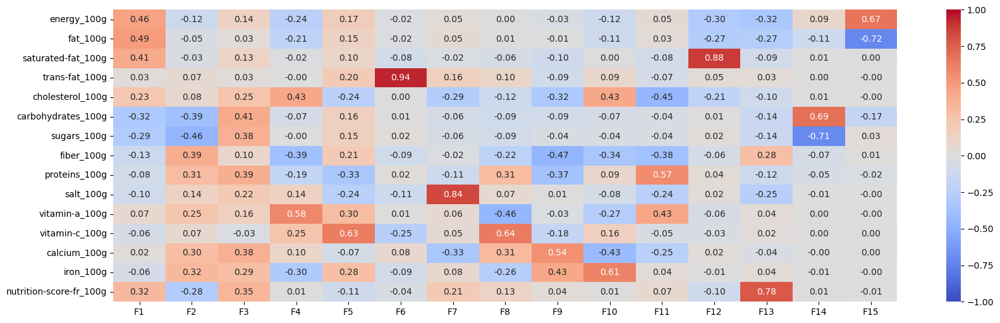

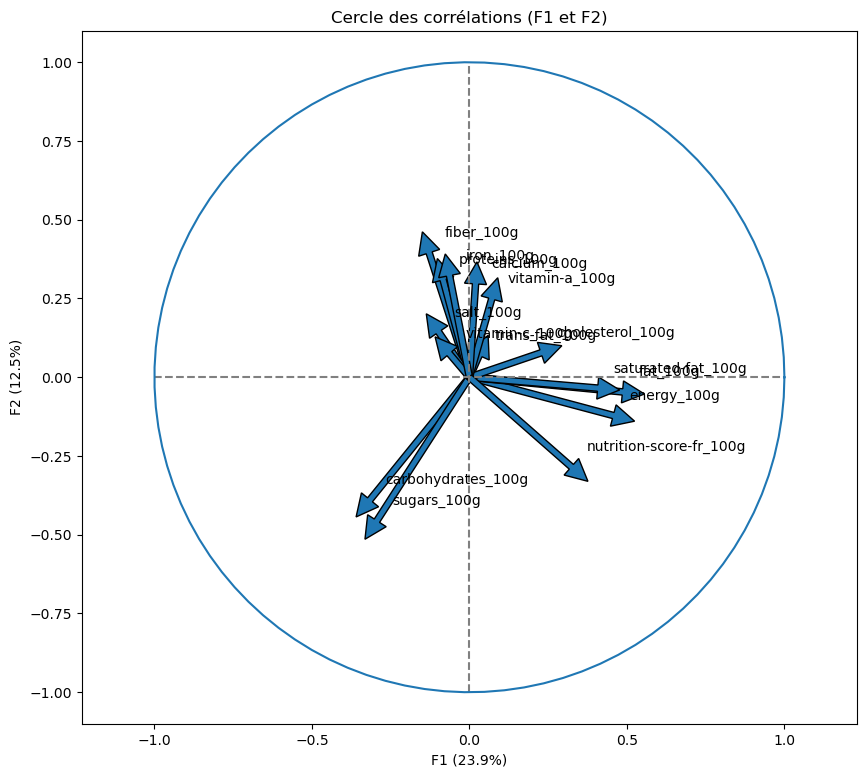

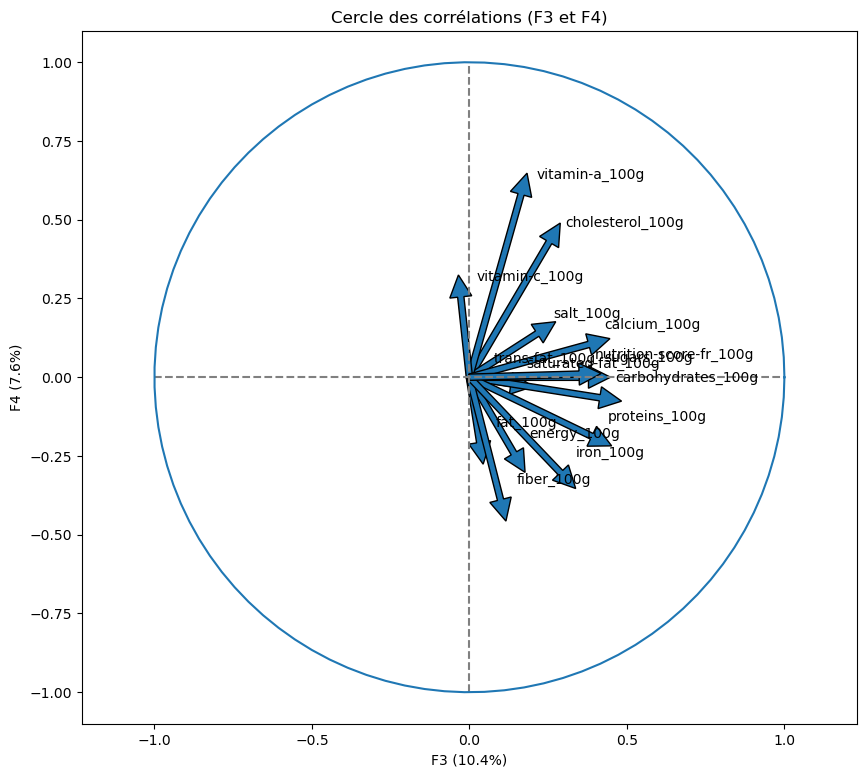

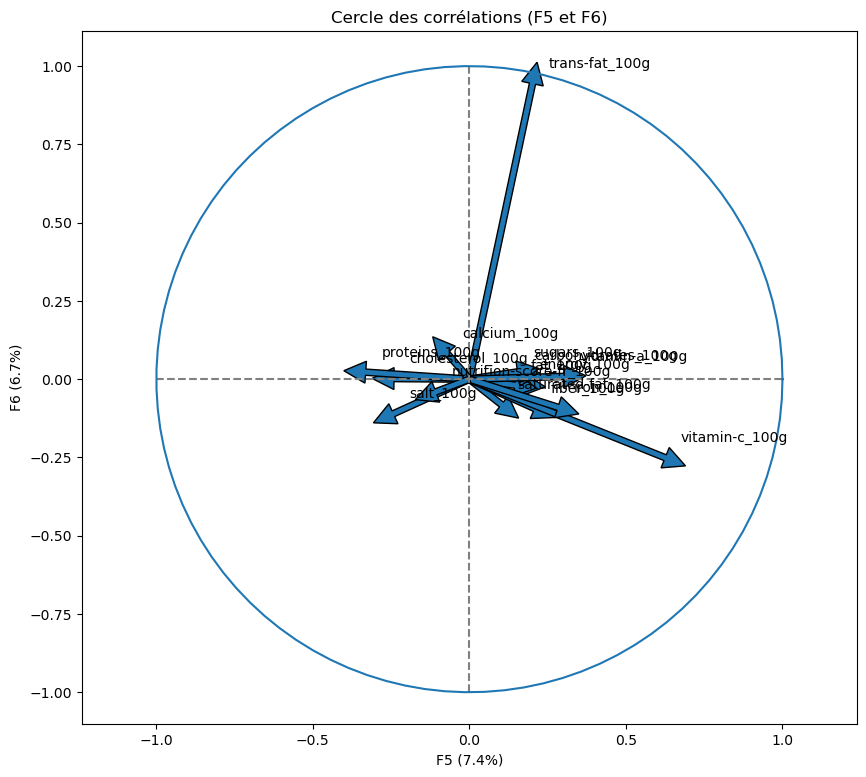

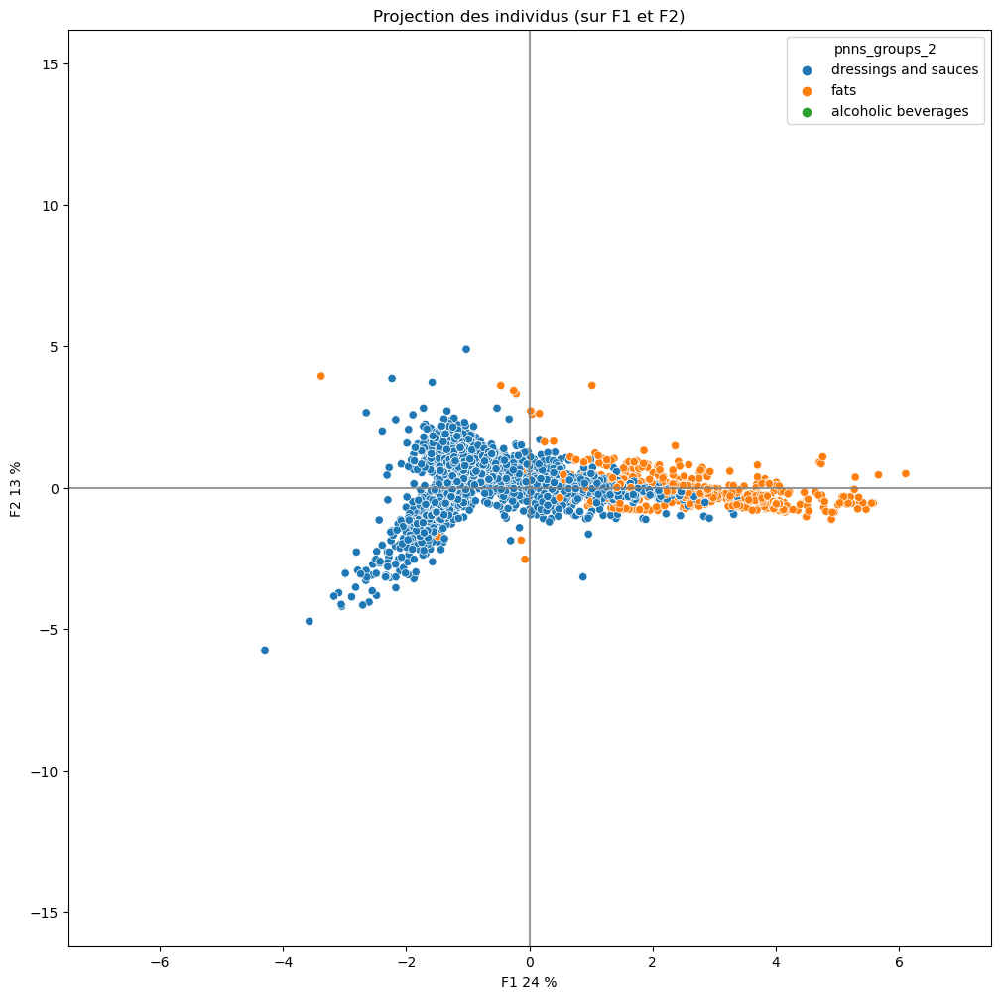

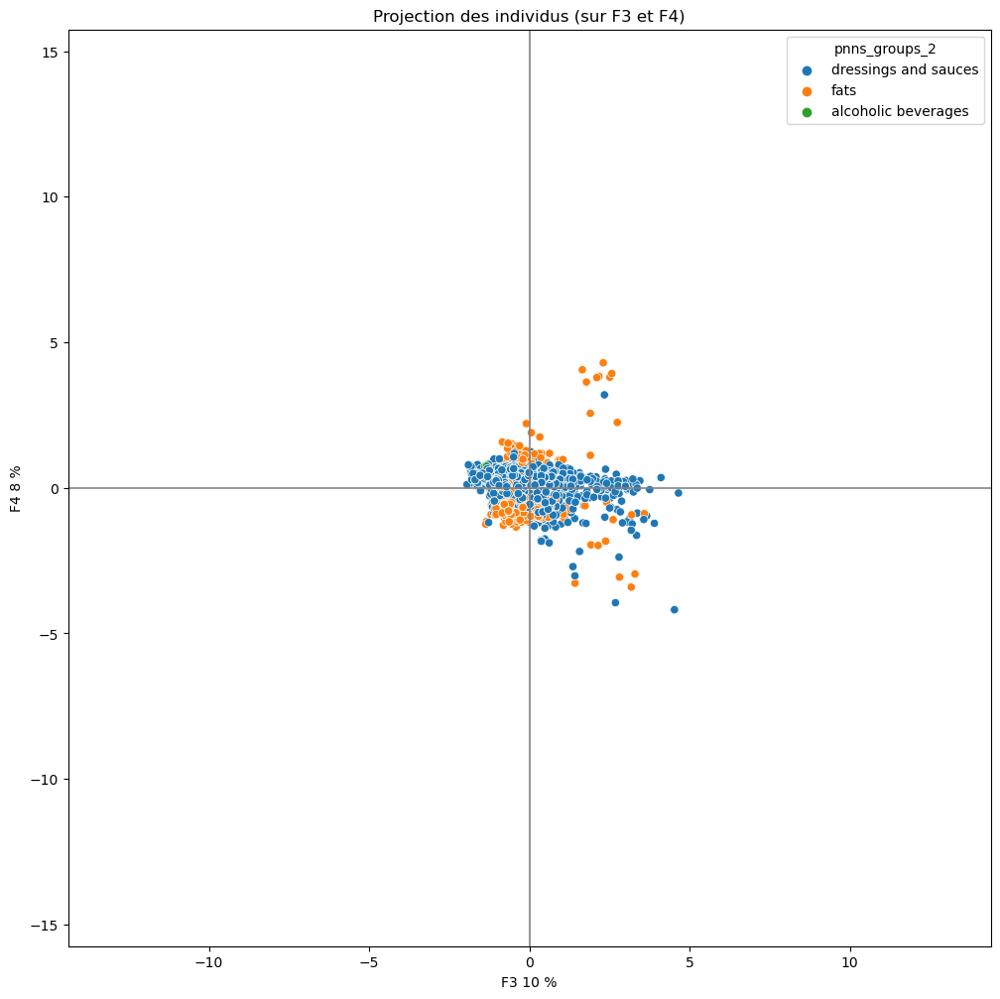

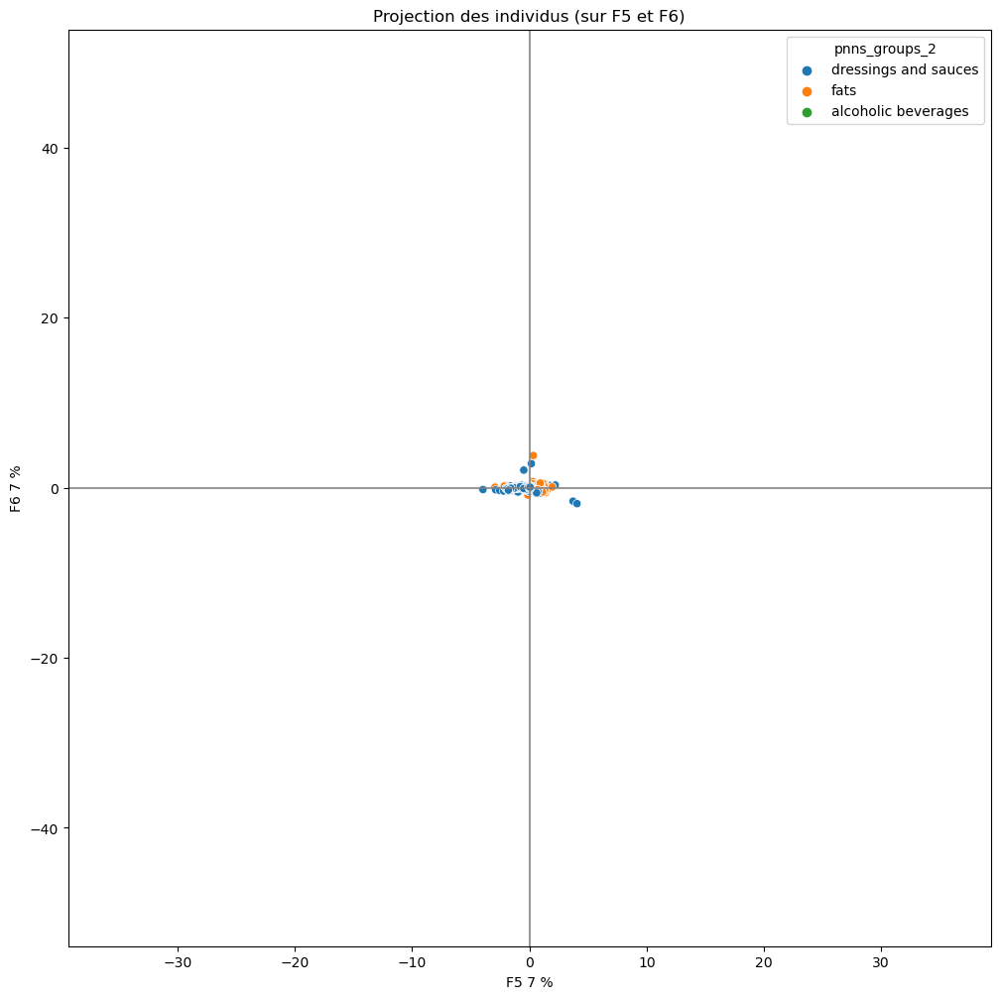

In [83]:
for pnns1 in data.loc[data["pnns_groups_1"].notnull(), "pnns_groups_1"].unique():
    print(pnns1)
    sous_data = data[data["pnns_groups_1"] == pnns1]
    ACP_generator(sous_data, "pnns_groups_2")

Quand on analyse les pnns 2 par pnns1, on voit que pour la plupart, les groupes se séparent bien.

Cependant, il est à noter, que pour certains pnns2, il va être compliqué de les affilier car certaines features ne sont plus présentes suite à leur élimination.
- Entre Fish and meat par exemple. Une richesse en fat oméga aurait sûrement permis de mieux les séparer, on va les fusionner en un seul pnns2 = raw_meat
- Pastries est compliqué à affilier, on le fusionne à biscuits and cakes
- Fusion de dairy dessert et ice cream, car produits similaires
- Soups sera fusionné à vegetable
- Alcoholic, fruit juice et fruit nectar seront enlevés et redistribués sur les autres catégories du pnns1 beverage, car nous n'avons plus l'information sur le % alcool et % de fruits
- On observe également que certains légumes pourraient être séparés selon leur fat, on pourrait créer 2 nouvelles catégories selon le fat.
- On observe pour fat and sauces un groupe de produits riches en sugars, faible en fat et en fibres.
- On doit corriger certaines mauvaises affiliations de pnns1

On observe que les features corrélent de façon similaire à ce qu'on a observé avec les pnns1, on va donc utiliser la même approche.

In [84]:
mask = copy.deepcopy(data)
mask = mask[mask["pnns_groups_1"] == "fat and sauces"]

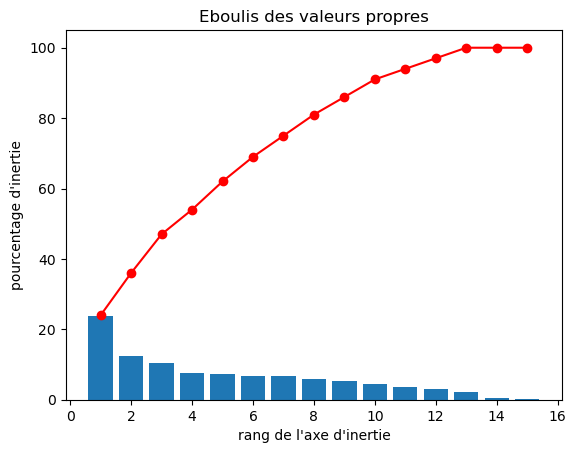

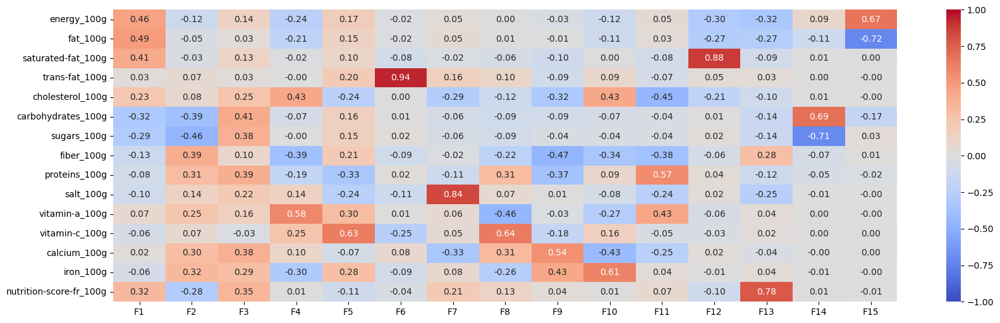

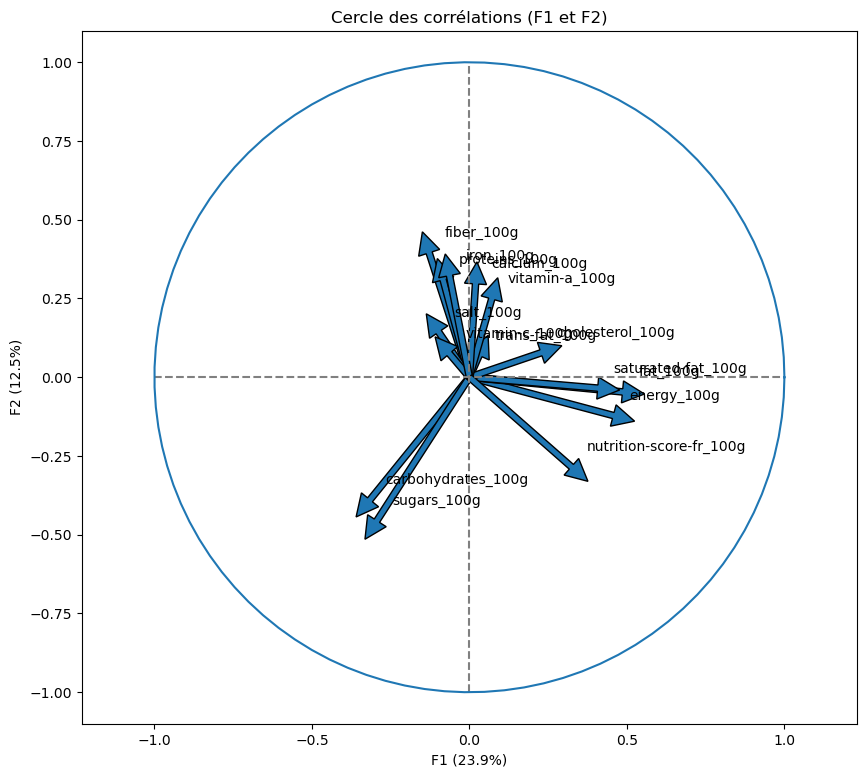

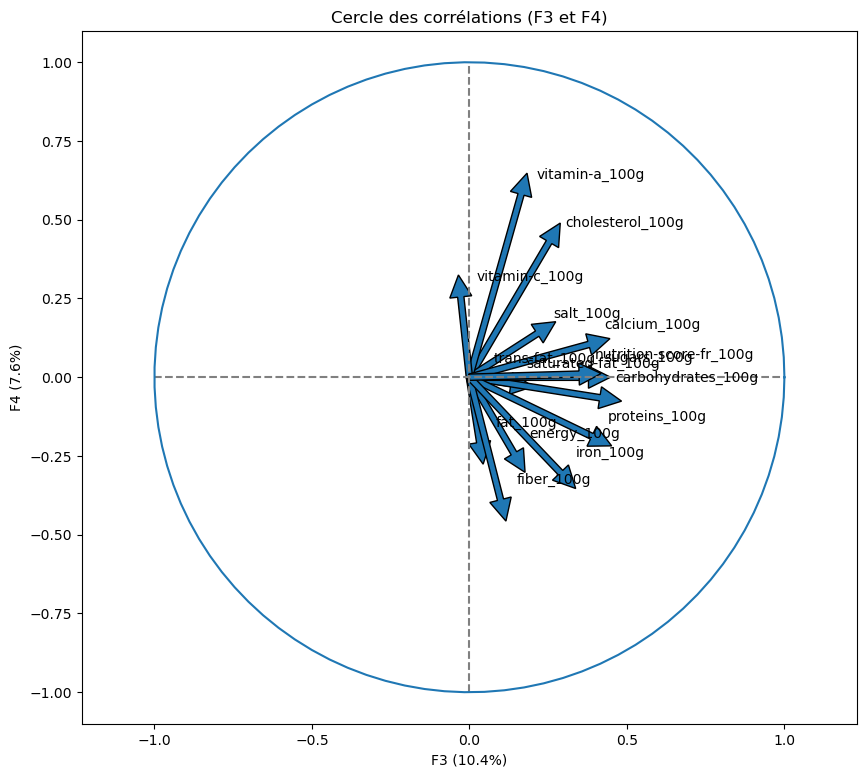

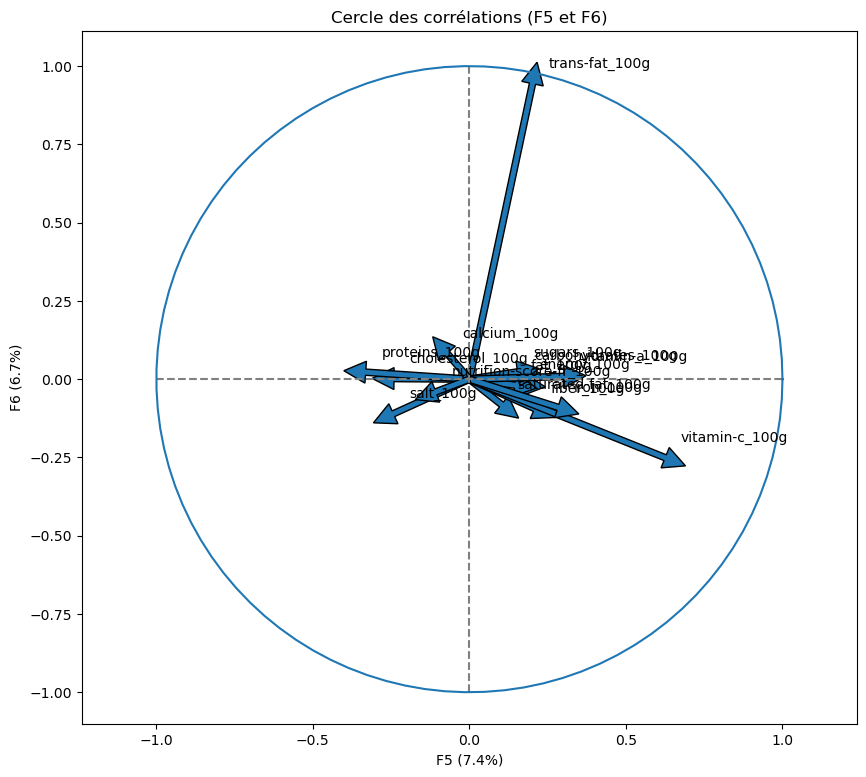

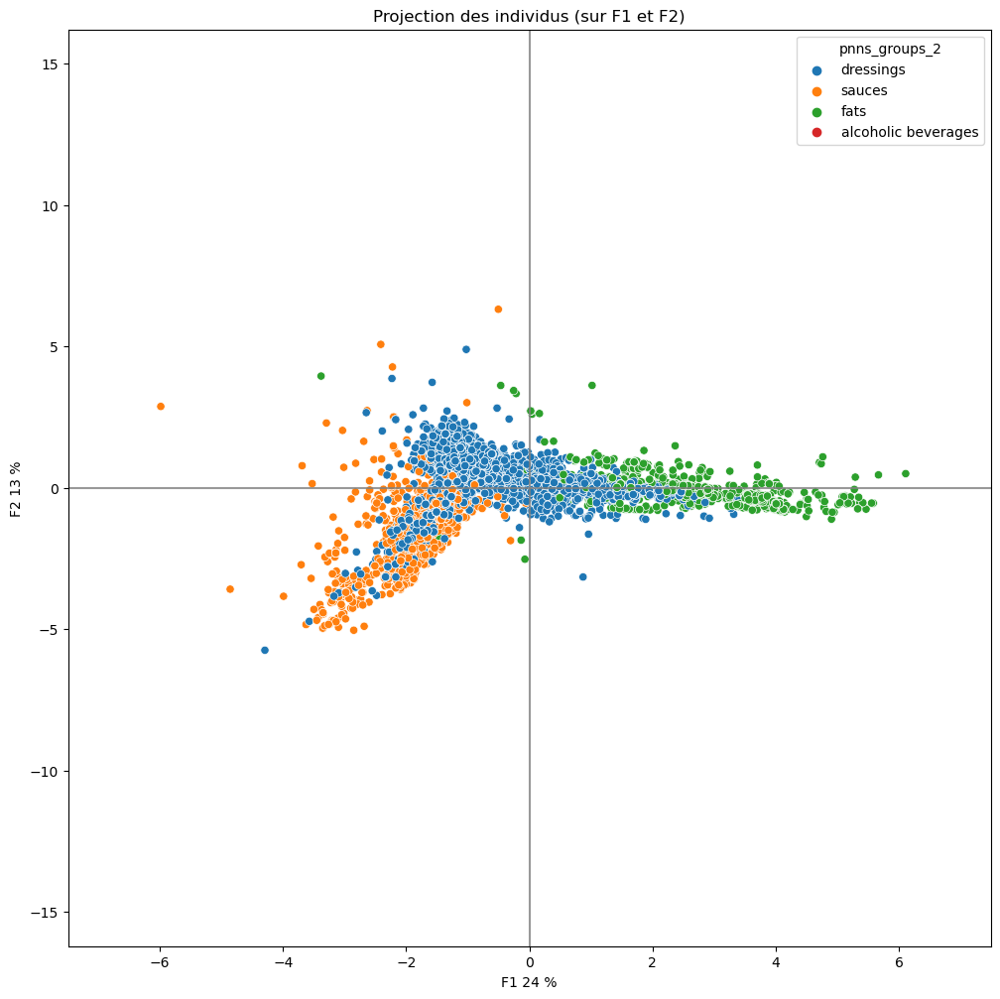

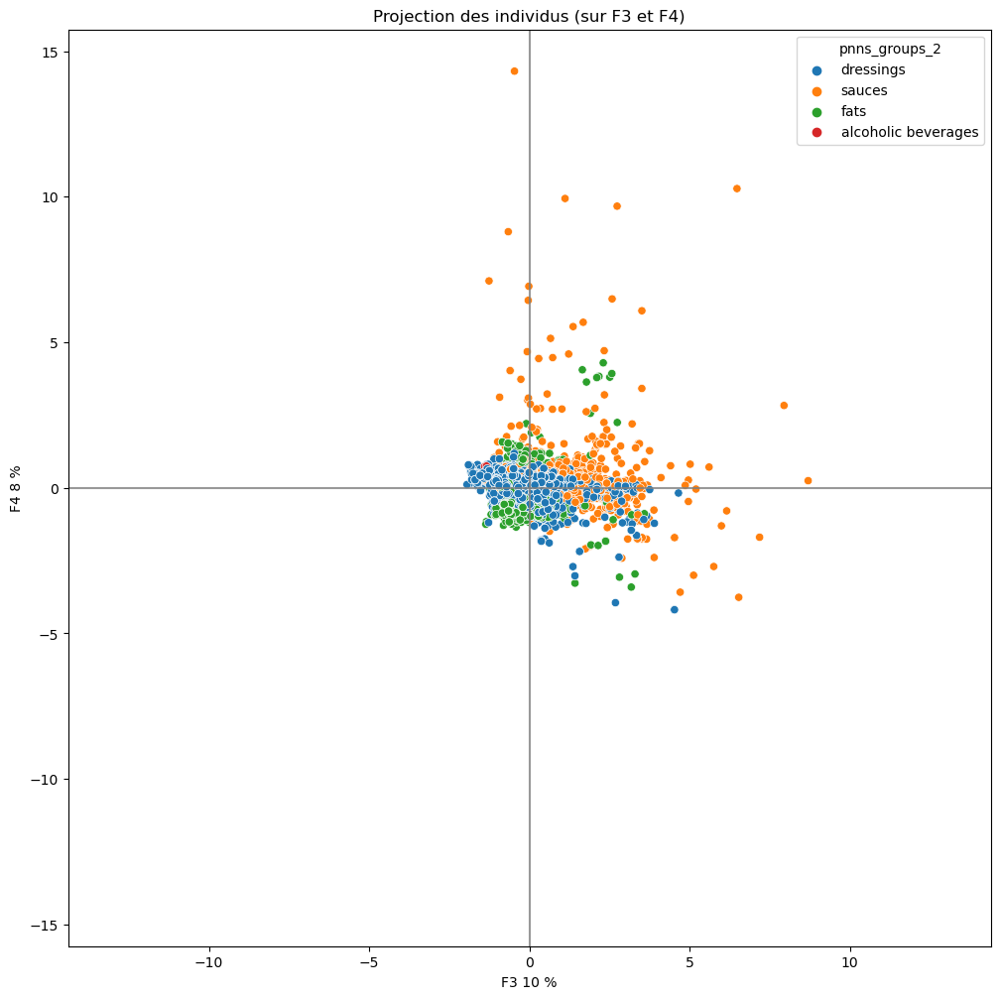

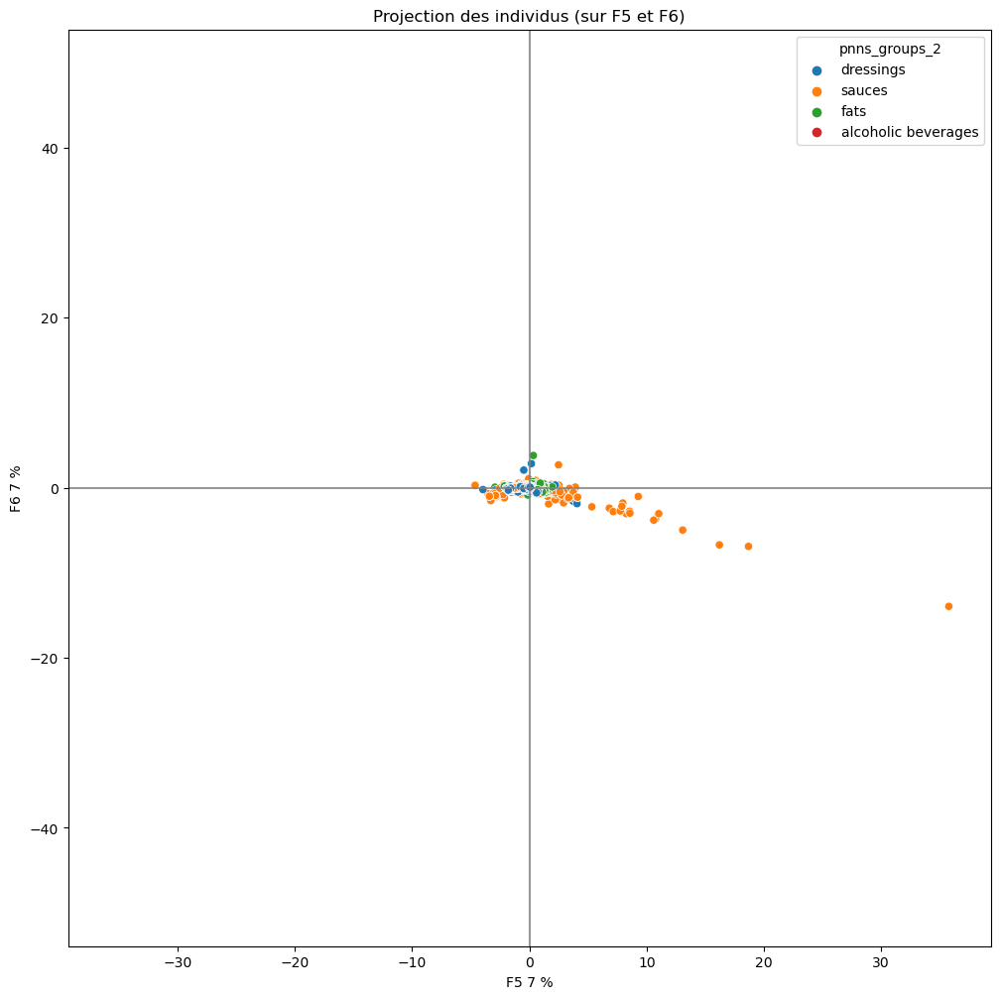

In [85]:
mask.loc[(mask["fat_100g"] < 15) & (mask["sugars_100g"] > 10) & (mask["fiber_100g"] < 2) , "pnns_groups_2"] = "sauces"

mask.loc[mask["pnns_groups_2"] == "dressings and sauces","pnns_groups_2"] = "dressings"

ACP_generator(mask, "pnns_groups_2")


In [86]:
with pd.option_context('display.max_columns', None):
    display(mask[mask["pnns_groups_2"] == "sauces"].head())

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,packaging,packaging_tags,brands,brands_tags,categories,categories_tags,categories_fr,origins,origins_tags,manufacturing_places,manufacturing_places_tags,labels,labels_tags,labels_fr,emb_codes,emb_codes_tags,first_packaging_code_geo,cities_tags,purchase_places,stores,countries,countries_tags,countries_fr,ingredients_text,allergens,traces,traces_tags,traces_fr,serving_size,additives_n,additives,additives_tags,additives_fr,ingredients_from_palm_oil_n,ingredients_from_palm_oil_tags,ingredients_that_may_be_from_palm_oil_n,ingredients_that_may_be_from_palm_oil_tags,nutrition_grade_fr,pnns_groups_1,pnns_groups_2,states,states_tags,states_fr,main_category,main_category_fr,image_url,image_small_url,energy_100g,fat_100g,saturated-fat_100g,trans-fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
340,790620105,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489143054,2017-03-10T10:50:54Z,1489143054,2017-03-10T10:50:54Z,"Fruit Ninja, Fruit Snacks, Original",NaN,NaN,NaN,NaN,Healthy Food Brands Llc,healthy-food-brands-llc,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,US,en:united-states,Etats-Unis,"Sugar, white grape juice from concentrate, cor...",NaN,NaN,NaN,NaN,20 g (1 POUCH),8.0,[ sugar -> en:sugar ] [ white-grape-juice-f...,"en:e428,en:e330,en:e331,en:e300,en:e903,en:e12...","E428 - Gélatine,E330 - Acide citrique,E331 - C...",0.0,NaN,0.0,NaN,d,fat and sauces,sauces,"en:to-be-completed, en:nutrition-facts-complet...","en:to-be-completed,en:nutrition-facts-complete...","A compléter,Informations nutritionnelles compl...",NaN,NaN,NaN,NaN,1255.0,0.0,0.0,0.0,0.0,100.00,60.00,0.0,5.0,0.25400,0.0,0.3,NaN,0.0,14.0
554,8295615268,http://world-fr.openfoodfacts.org/produit/0008...,usda-ndb-import,1489079723,2017-03-09T17:15:23Z,1489079723,2017-03-09T17:15:23Z,"Di Nigris, Sweet & Thicker Balsamic Glaze, Ori...",NaN,NaN,NaN,NaN,Acetificio Marcello Denigris,acetificio-marcello-denigris,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,US,en:united-states,Etats-Unis,"Cooked grape must, (39%), (wine vinegar, conce...",NaN,NaN,NaN,NaN,15 ml (1 Tbsp),3.0,[ cooked-grape-must -> en:cooked-grape-must ...,"en:e150d,en:e224,en:e415","E150d - Caramel au sulfite d'ammonium,E224 - D...",0.0,NaN,0.0,NaN,d,fat and sauces,sauces,"en:to-be-completed, en:nutrition-facts-complet...","en:to-be-completed,en:nutrition-facts-complete...","A compléter,Informations nutritionnelles compl...",NaN,NaN,NaN,NaN,1255.0,0.0,0.0,0.0,0.0,73.33,66.67,0.0,0.0,0.17018,0.0,0.0,0.0,0.0,13.0
556,8295660084,http://world-fr.openfoodfacts.org/produit/0008...,usda-ndb-import,1489079723,2017-03-09T17:15:23Z,1489079723,2017-03-09T17:15:23Z,"De Nigris, Balsamic Glaze, Raspberry",NaN,NaN,NaN,NaN,Acetificio Marcello Denigris,acetificio-marcello-denigris,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,US,en:united-states,Etats-Unis,"Balsamic condiment (min. 90%), glucose syrup, ...",NaN,NaN,NaN,NaN,15 ml (1 Tbsp),1.0,[ balsamic-condiment -> en:balsamic-condiment...,en:e412,E412 - Gomme de guar,0.0,NaN,0.0,NaN,d,fat and sauces,sauces,"en:to-be-completed, en:nutrition-facts-complet...","en:to-be-completed,en:nutrition-facts-complete...","A compléter,Informations nutritionnelles compl...",NaN,NaN,NaN,NaN,1255.0,0.0,0.0,0.0,0.0,73.33,66.67,0.0,0.0,0.17018,0.0,0.0,0.0,0.0,13.0
557,8295660107,http://world-fr.openfoodfacts.org/produit/0008...,usda-ndb-import,1489143171,2017-03-10T10:52:51Z,1489143171,2017-03-10T10:52:51Z,Glaze Organic Sweeter & Thicker Balsamic Reduc...,NaN,NaN,NaN,NaN,Acetificio Marcello Denigris,acetificio-marcello-denigris,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,US,en:united-states,Etats-Unis,"Organic grape must, ""aceto balsamico di modena...",NaN,NaN,NaN,NaN,15 m

Ce nouveau groupe représente bien les sauces et il a pu être assez bien séparé des deux autres groupes d'après l'ACP.

<AxesSubplot:ylabel='Count'>

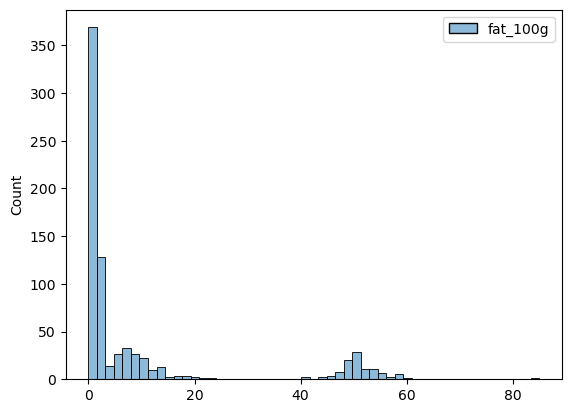

In [87]:
sns.histplot(data = pd.DataFrame(data.loc[data["pnns_groups_2"] == "legumes", "fat_100g"]))

Sur le sous groupe legumes, on observe 2 groupes distincts selon la quantité de fat.

In [88]:
mask = data[data["pnns_groups_2"] == "legumes"]
with pd.option_context('display.max_columns', None):
    display(mask[mask["fat_100g"] > 30])

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,packaging,packaging_tags,brands,brands_tags,categories,categories_tags,categories_fr,origins,origins_tags,manufacturing_places,manufacturing_places_tags,labels,labels_tags,labels_fr,emb_codes,emb_codes_tags,first_packaging_code_geo,cities_tags,purchase_places,stores,countries,countries_tags,countries_fr,ingredients_text,allergens,traces,traces_tags,traces_fr,serving_size,additives_n,additives,additives_tags,additives_fr,ingredients_from_palm_oil_n,ingredients_from_palm_oil_tags,ingredients_that_may_be_from_palm_oil_n,ingredients_that_may_be_from_palm_oil_tags,nutrition_grade_fr,pnns_groups_1,pnns_groups_2,states,states_tags,states_fr,main_category,main_category_fr,image_url,image_small_url,energy_100g,fat_100g,saturated-fat_100g,trans-fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
25853,33776100803,http://world-fr.openfoodfacts.org/produit/0033...,ndiggity,1430117365,2015-04-27T06:49:25Z,1489143360,2017-03-10T10:56:00Z,Natural peanut butter and flaxseed,NaN,16 oz,NaN,NaN,earth balance,earth-balance,"Plant-based foods and beverages,Plant-based fo...","en:plant-based-foods-and-beverages,en:plant-ba...","Aliments et boissons à base de végétaux,Alimen...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,United States,en:united-states,Etats-Unis,"Peanuts, flaxseed, agave syrup peanut oil, pal...",NaN,NaN,NaN,NaN,2 Tbsp (32g),0.0,[ peanuts -> en:peanuts ] [ flaxseed -> en:...,NaN,NaN,0.0,NaN,0.0,NaN,d,cereals and potatoes,legumes,"en:to-be-completed, en:nutrition-facts-complet...","en:to-be-completed,en:nutrition-facts-complete...","A compléter,Informations nutritionnelles compl...",en:spreads,Produits à tartiner,http://fr.openfoodfacts.org/images/products/00...,http://fr.openfoodfacts.org/images/products/00...,2480.0,51.57,9.38,0.0,0.0,25.00,6.25,9.38,21.90,0.87300,NaN,NaN,NaN,0.00225,15.0
25857,33776100872,http://world-fr.openfoodfacts.org/produit/0033...,yotann,1479667197,2016-11-20T18:39:57Z,1479667436,2016-11-20T18:43:56Z,Earth Balance Coconut & Peanut Spread,peanut butter,453 g,"Plastic,Jar","plastic,jar",Earth Balance,earth-balance,Peanut butters,"en:plant-based-foods-and-beverages,en:plant-ba...","Aliments et boissons à base de végétaux,Alimen...",NaN,NaN,NaN,NaN,"Non GMO Project Verified,Vegan,Gluten-free","en:vegetarian,en:gluten-free,en:vegan,en:non-g...","Végétarien,Sans gluten,Végétalien,en:Non-gmo-p...",NaN,NaN,NaN,NaN,USA,Common Ground,United States,en:united-states,Etats-Unis,"_peanuts_, organic extra virgin coconut oil, a...",peanuts,NaN,NaN,NaN,32 g,0.0,[ peanuts -> en:peanuts ] [ organic-extra-v...,NaN,NaN,0.0,NaN,0.0,NaN,d,cereals and potatoes,legumes,"en:to-be-completed, en:nutrition-facts-complet...","en:to-be-completed,en:nutrition-facts-complete...","A compléter,Informations nutritionnelles compl...",en:spreads,Produits à tartiner,NaN,NaN,2480.0,50.06,14.10,0.0,0.0,21.90,6.25,6.25,18.80,0.75400,0.0,0.0,0.0,0.00225,16.0
26039,34000400126,http://world-fr.openfoodfacts.org/produit/0034...,kiliweb,1488626459,2017-03-04T11:20:59Z,1488637169,2017-03-04T14:19:29Z,Beurre De Cacahuètes Crémeux,NaN,NaN,NaN,NaN,Reese s,reese-s,Beurres de cacahuètes,"en:plant-based-foods-and-beverages,en:plant-ba...","Aliments et boissons à base de végétaux,Alimen...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,France,en:france,France,"arachides grillées, sucre, huile végétale hydr...",NaN,NaN,NaN,NaN,NaN,0.0,[ arachides-grillees -> fr:arachides-grillees...,NaN,NaN,0.0,NaN,1.0,huile-vegetale,e,cereals and potatoes,legumes,"en:to-be-completed, en:nutrition-facts-complet...","en:to-be-completed,en:nutrition-facts-complete...","A compléter,Informations nutritionnelles compl...",en:spreads,Produits à tartiner,NaN,NaN,2481.0,50.00,8.00,NaN,NaN,21.00,9.00,0.00,25.00,1.00000,NaN,NaN,NaN,NaN,19.0
3

Ce sont des margarines. On va les classifier en legumes-fat.

On effectue les différentes corrections

In [89]:
data.loc[data["pnns_groups_2"] == "alcoholic beverages", "pnns_groups_1"] = "beverages"
data.loc[data["pnns_groups_2"] == "tripe dishes", "pnns_groups_1"] = "composite foods"
data.loc[data["pnns_groups_2"] == "pastries", "pnns_groups_2"] = "biscuits and cakes"
data.loc[data["pnns_groups_2"] == "soups", "pnns_groups_2"] = "vegetables"
beverages_corr = ["fruit nectars", "fruit juices", "alcoholic beverages"]
data.loc[data["pnns_groups_2"].isin(beverages_corr), "pnns_groups_2"] = np.nan
data.loc[(data["pnns_groups_2"] == "dairy desserts") | (data["pnns_groups_2"] == "ice cream"), "pnns_groups_2"] = "dairy desserts-ice cream"
raw_meat = ["meat", "fish and seafood"]
data.loc[data["pnns_groups_2"].isin(raw_meat), "pnns_groups_2"] = "raw_meat"
data.loc[(data["pnns_groups_2"] == "legumes") & (data["fat_100g"] > 30), "pnns_groups_2"] = "legumes-fat"
data.loc[(data["fat_100g"] < 15) & (data["sugars_100g"] > 10) & (data["fiber_100g"] < 2) & (data["pnns_groups_1"] == "fat and sauces"), "pnns_groups_2"] = "sauces"
data.loc[data["pnns_groups_2"] == "dressings and sauces","pnns_groups_2"] = "dressings"
data.loc[data["pnns_groups_2"] == "tripe dishes", "pnns_groups_2"] = "triple dishes"


pnns_groups_2 a cette distribution suivante au sein des échantillons


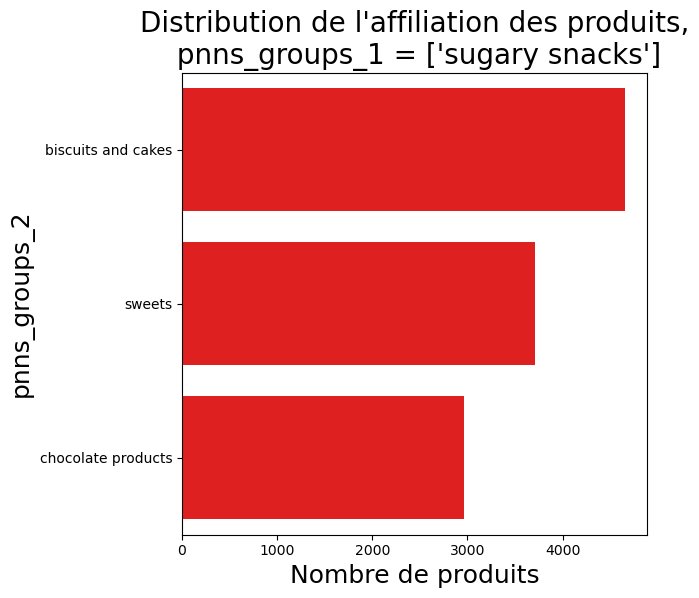

pnns_groups_2 a cette distribution suivante au sein des échantillons


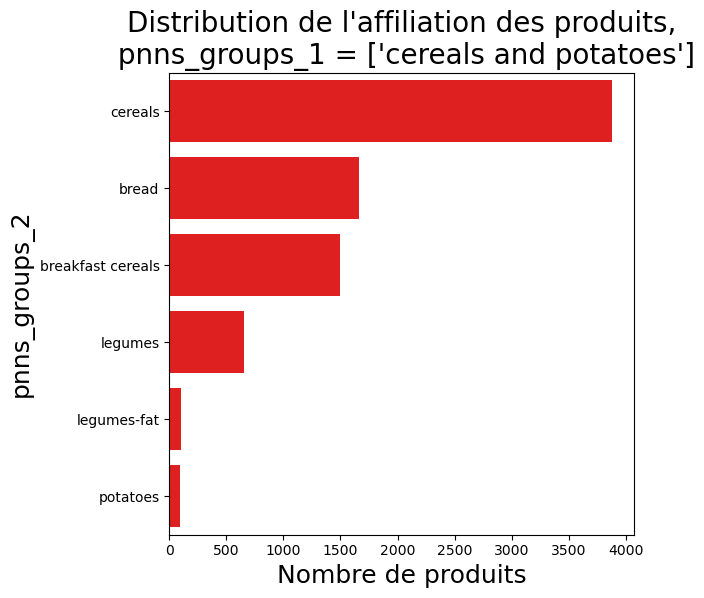

pnns_groups_2 a cette distribution suivante au sein des échantillons


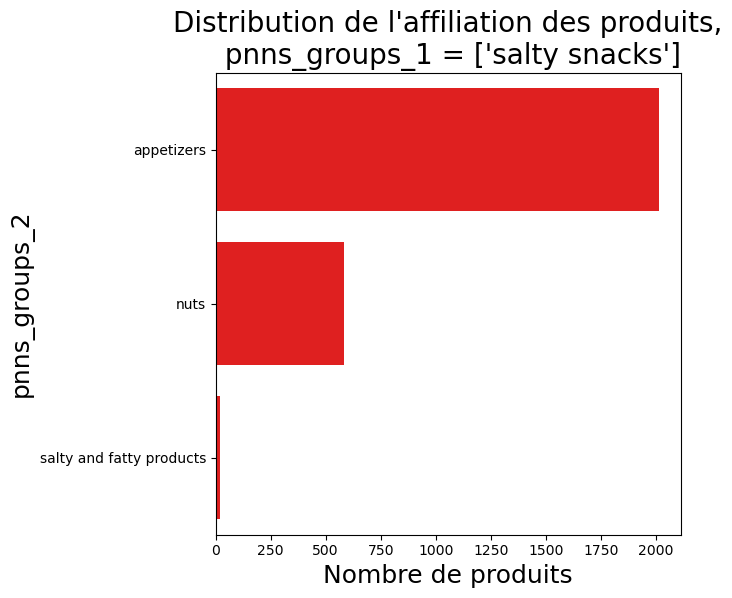

pnns_groups_2 a cette distribution suivante au sein des échantillons


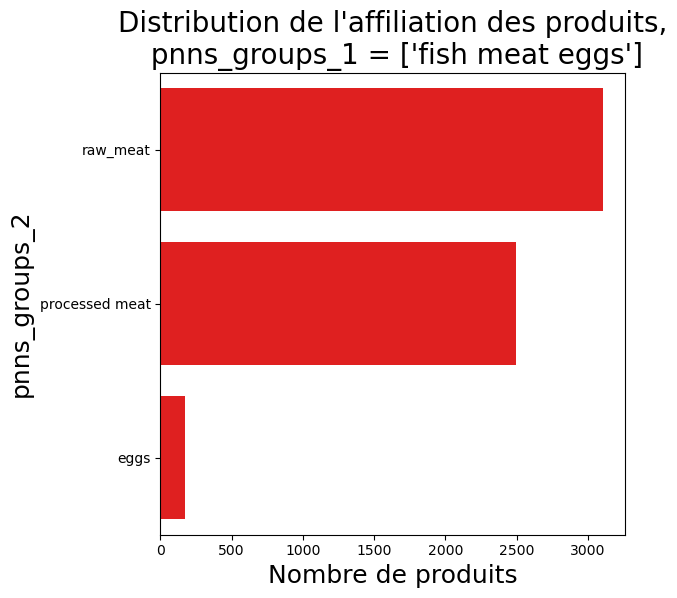

pnns_groups_2 a cette distribution suivante au sein des échantillons


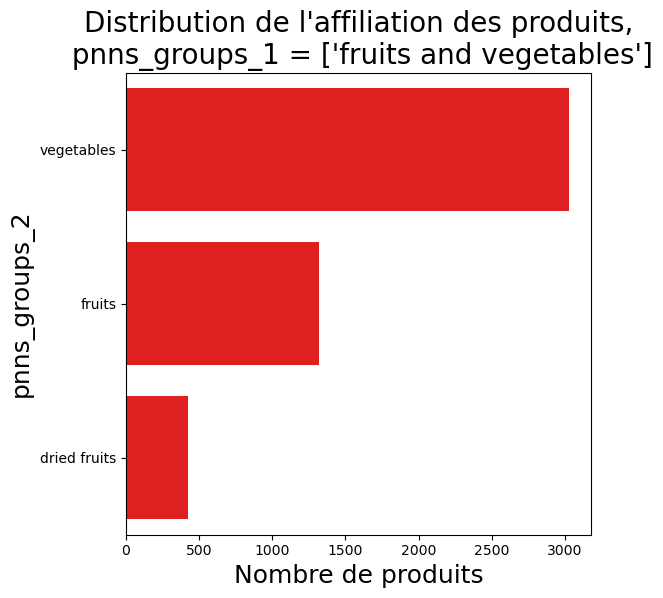

pnns_groups_2 a cette distribution suivante au sein des échantillons


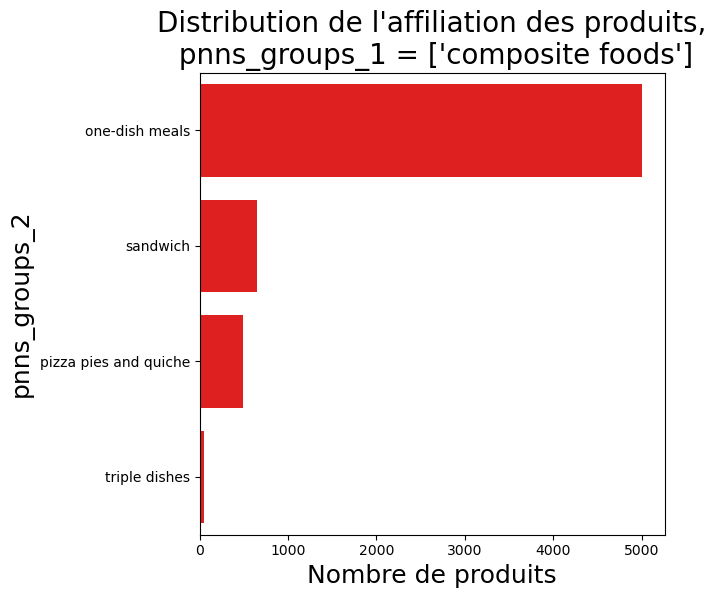

pnns_groups_2 a cette distribution suivante au sein des échantillons


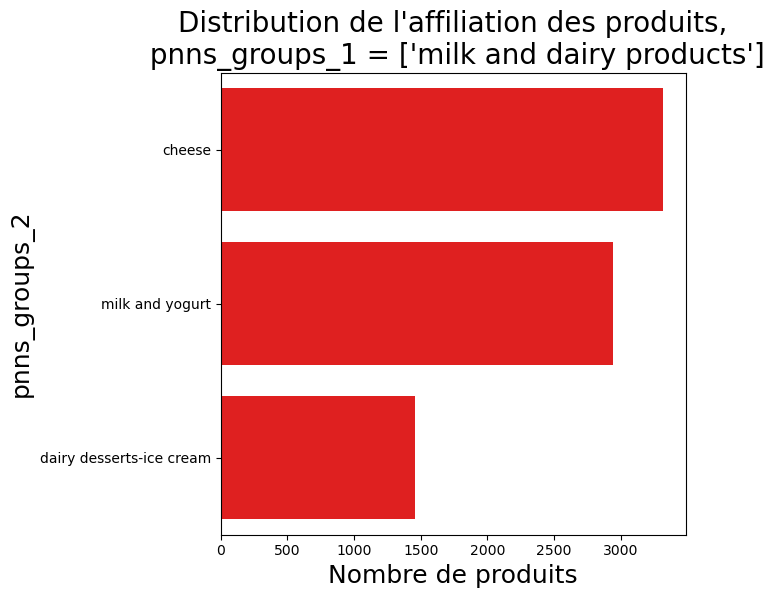

pnns_groups_2 a cette distribution suivante au sein des échantillons


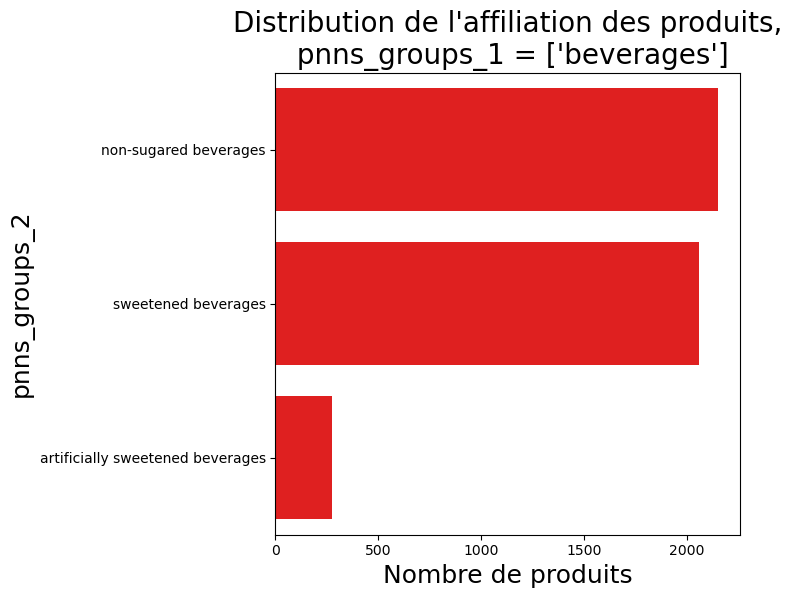

pnns_groups_2 a cette distribution suivante au sein des échantillons


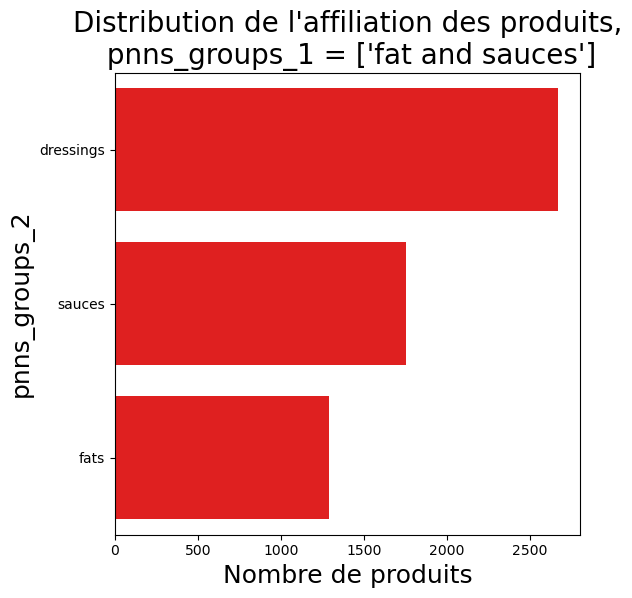

In [90]:
# Distribution pnns2 par pnns1
for pnns1 in data.loc[data["pnns_groups_1"].notnull(), "pnns_groups_1"].unique():
    distribution_pnns(data[data["pnns_groups_1"] == pnns1], "pnns_groups_2")

sugary snacks


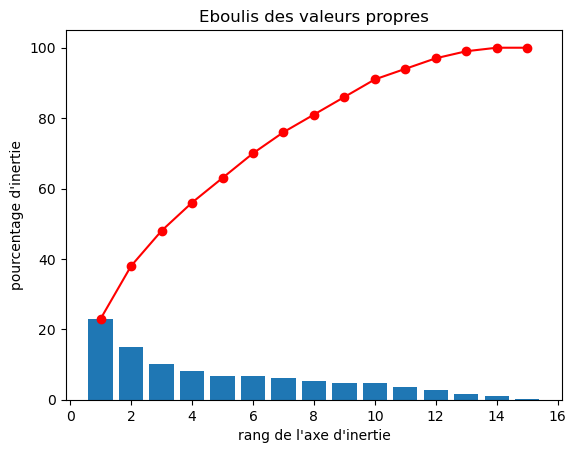

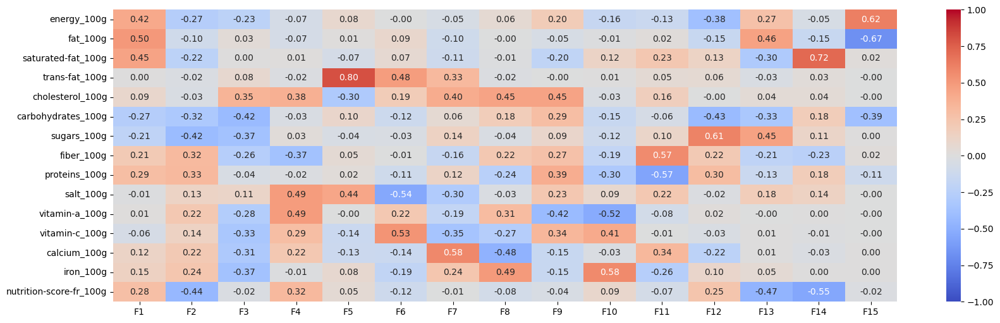

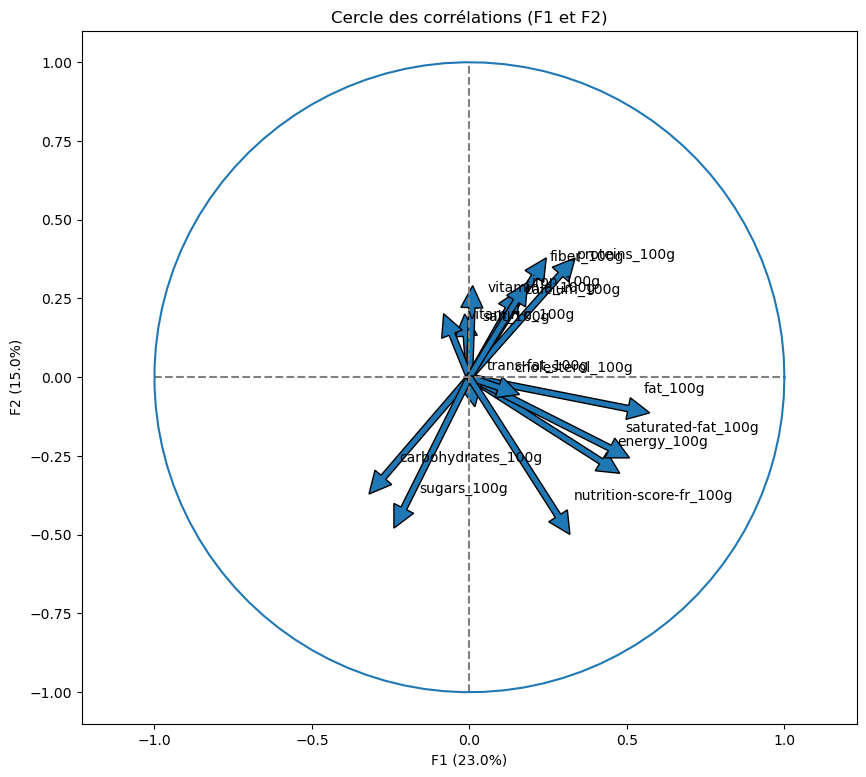

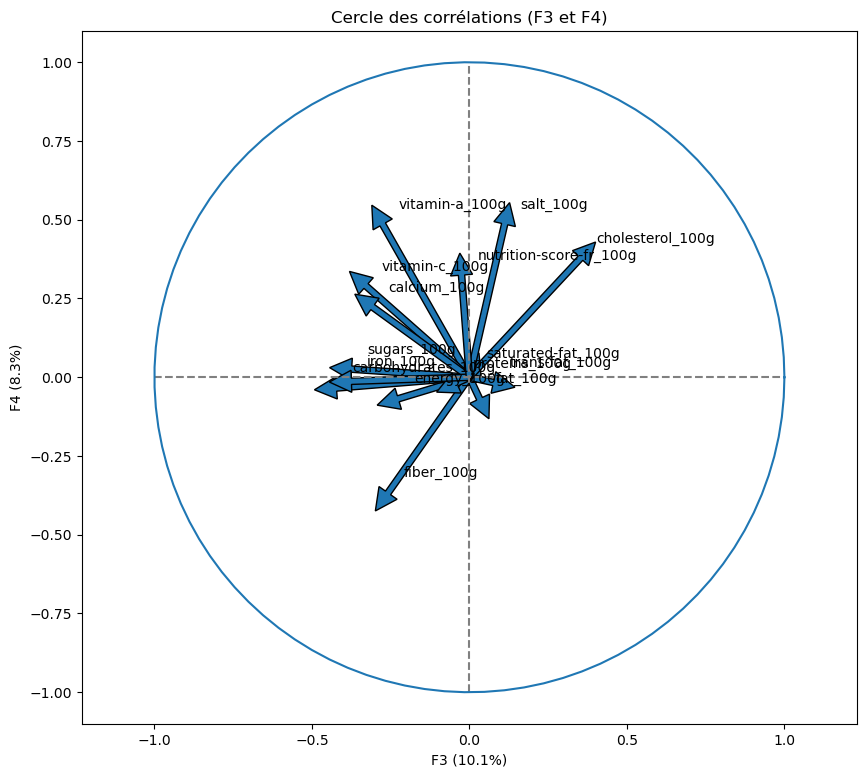

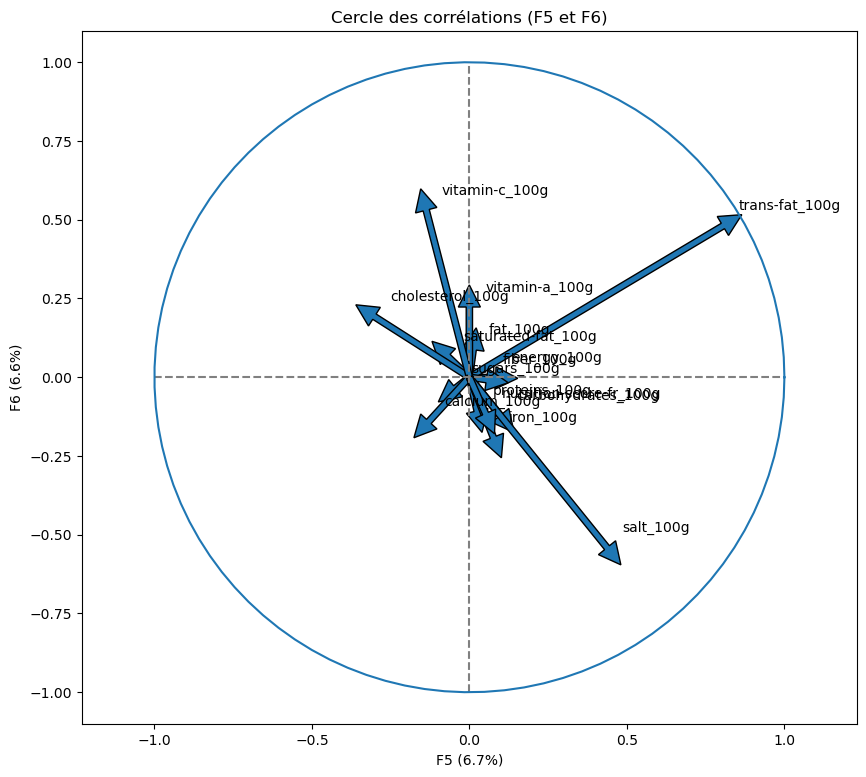

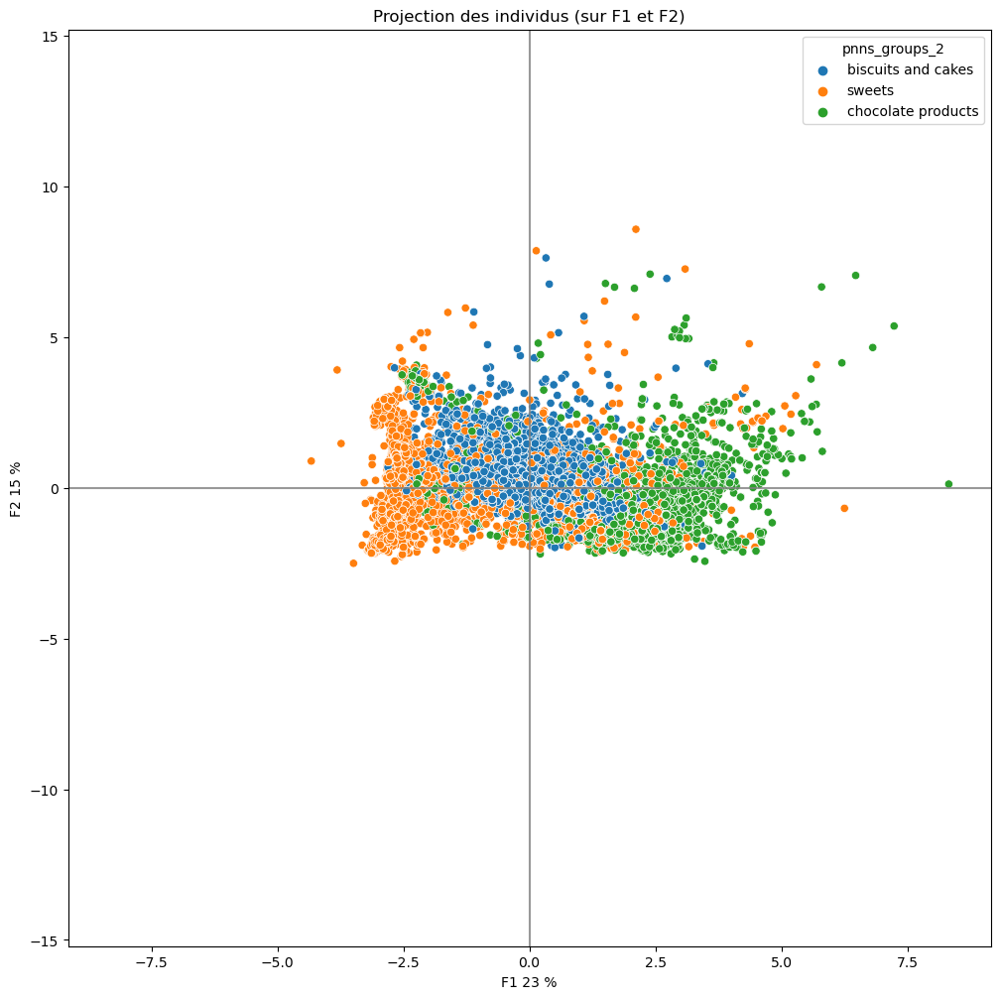

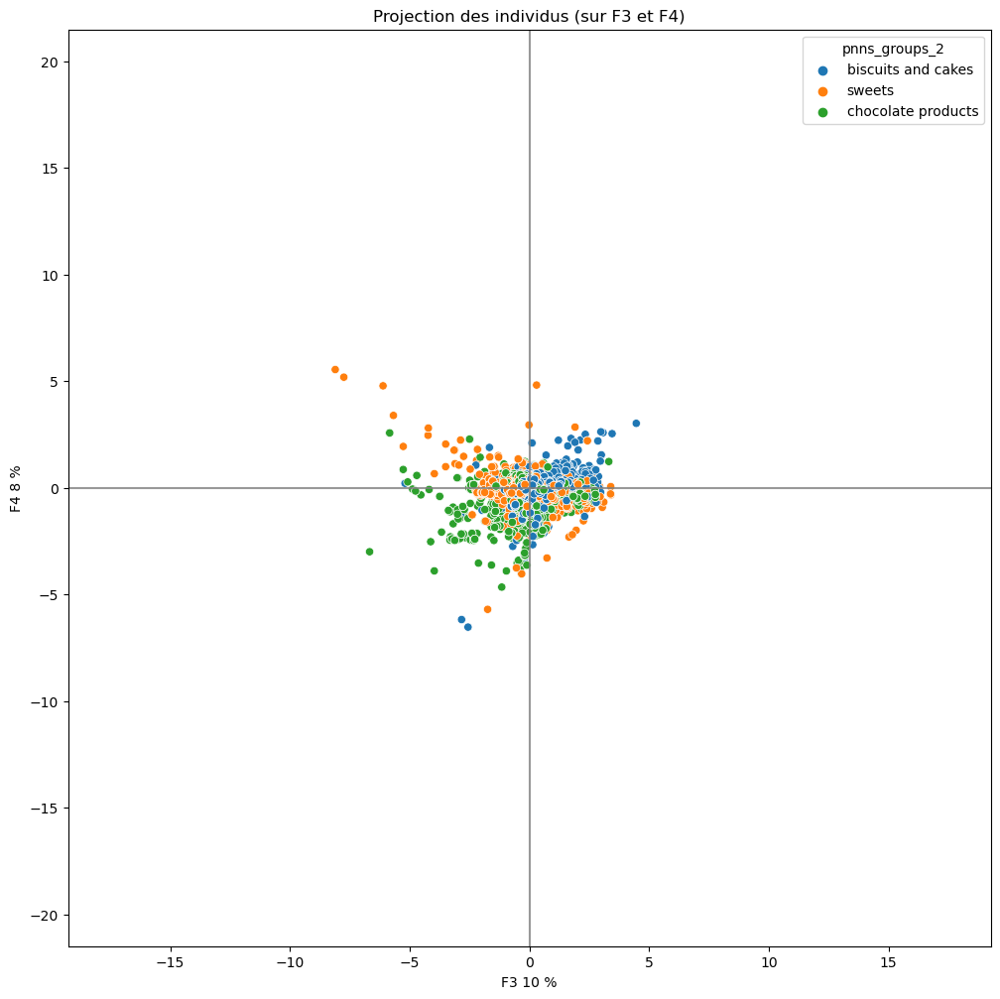

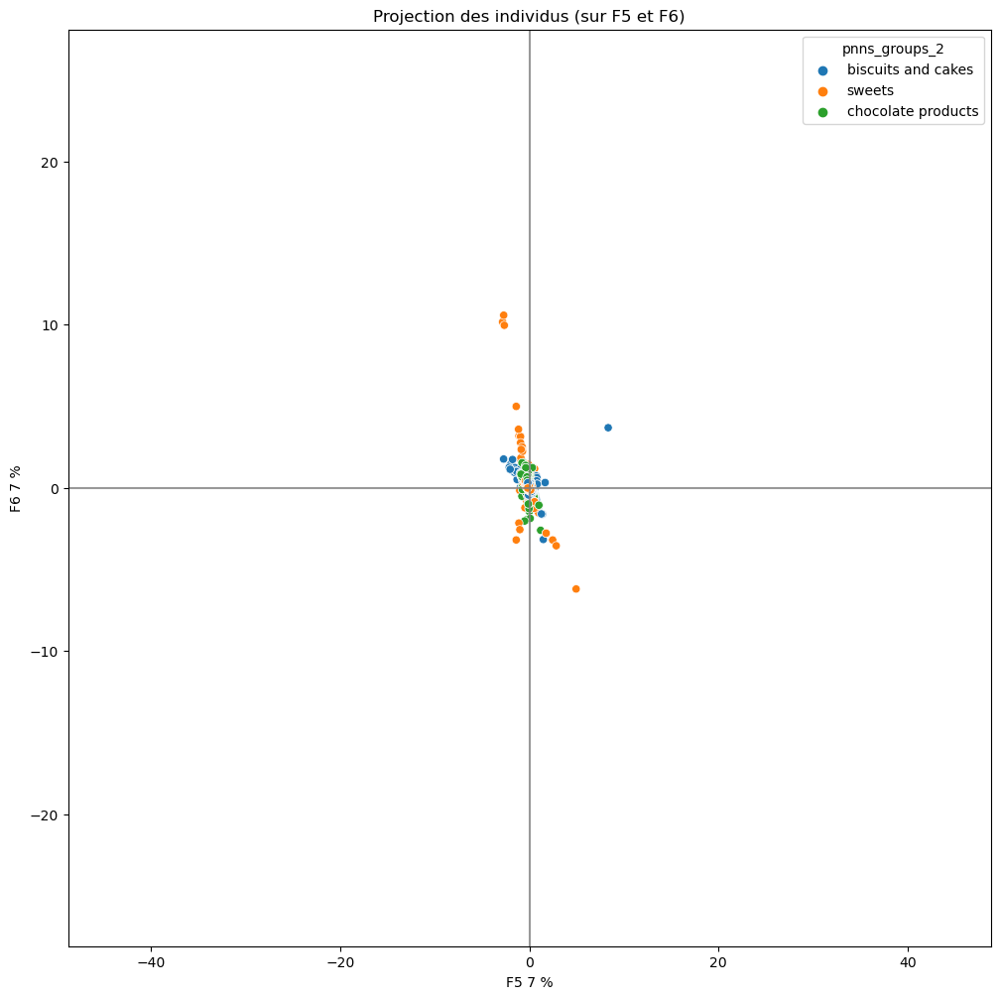

cereals and potatoes


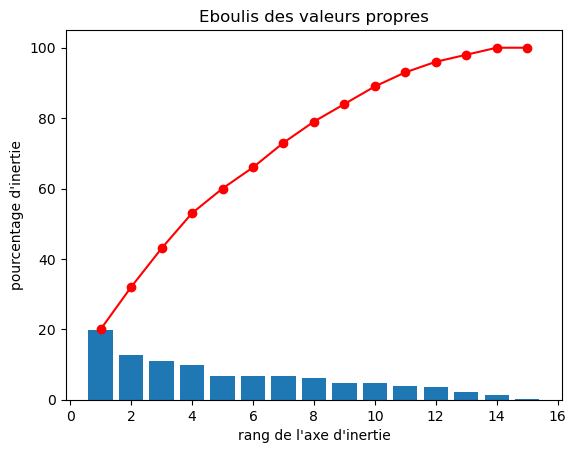

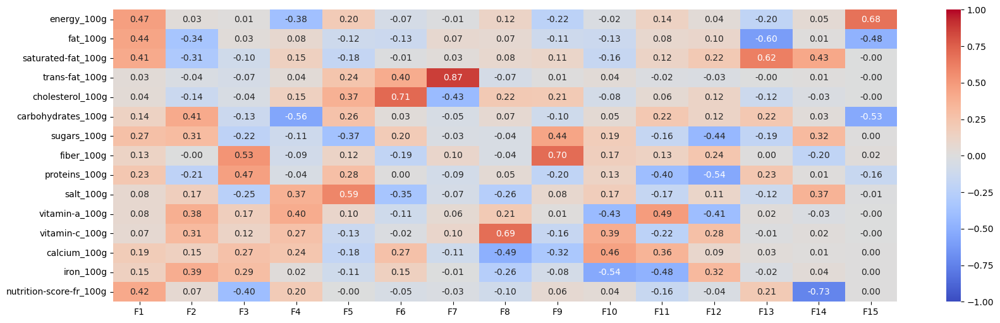

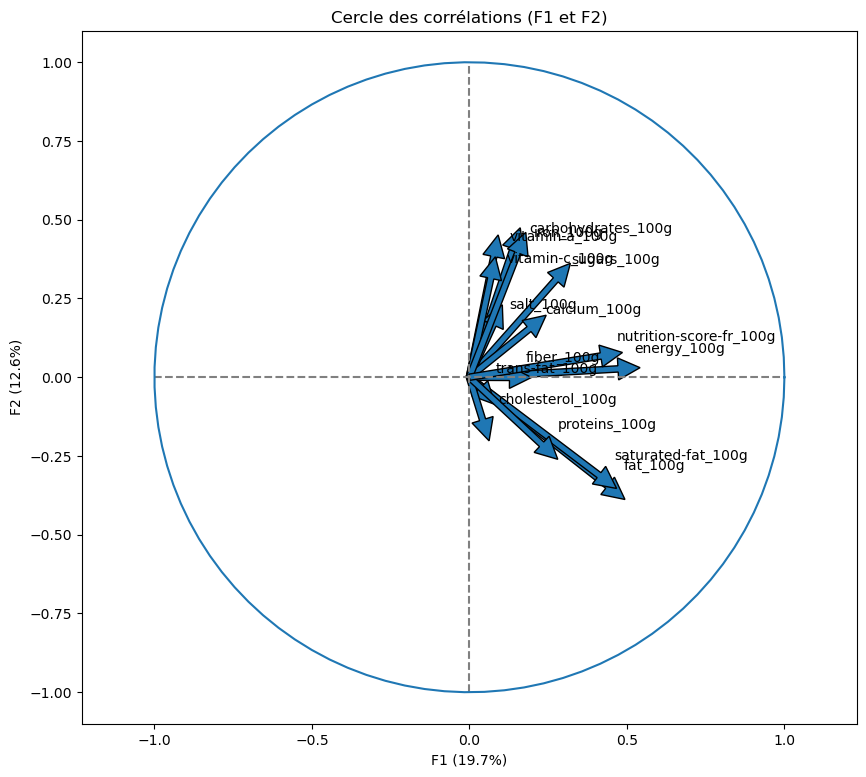

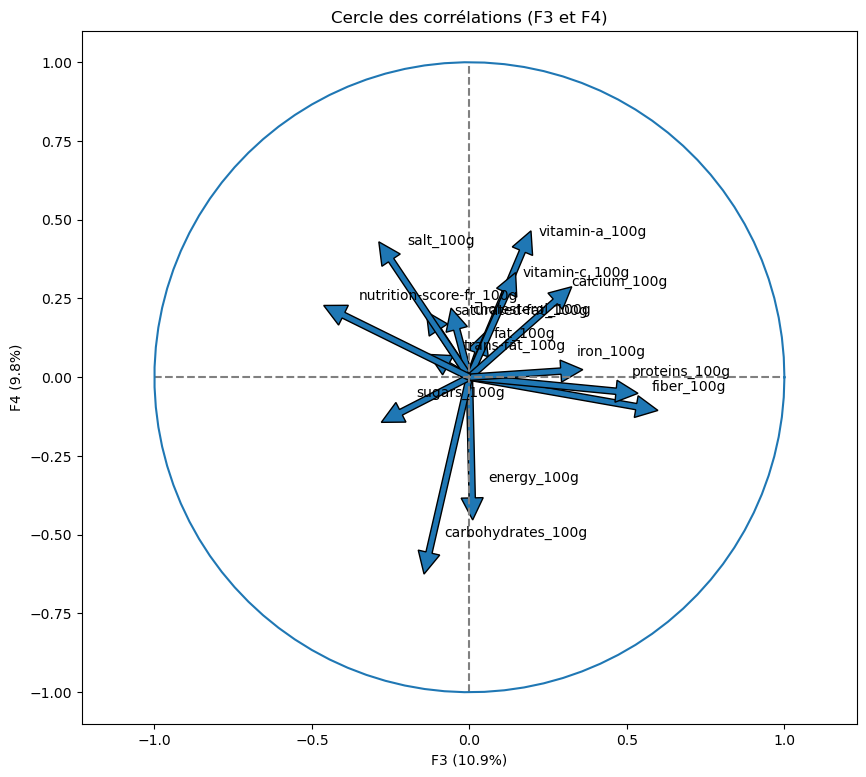

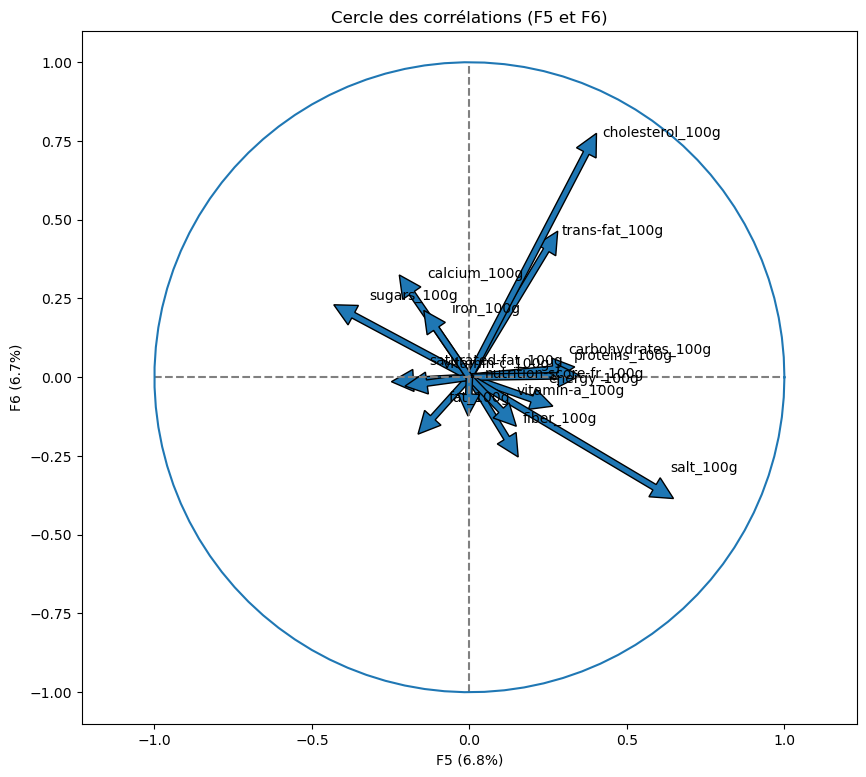

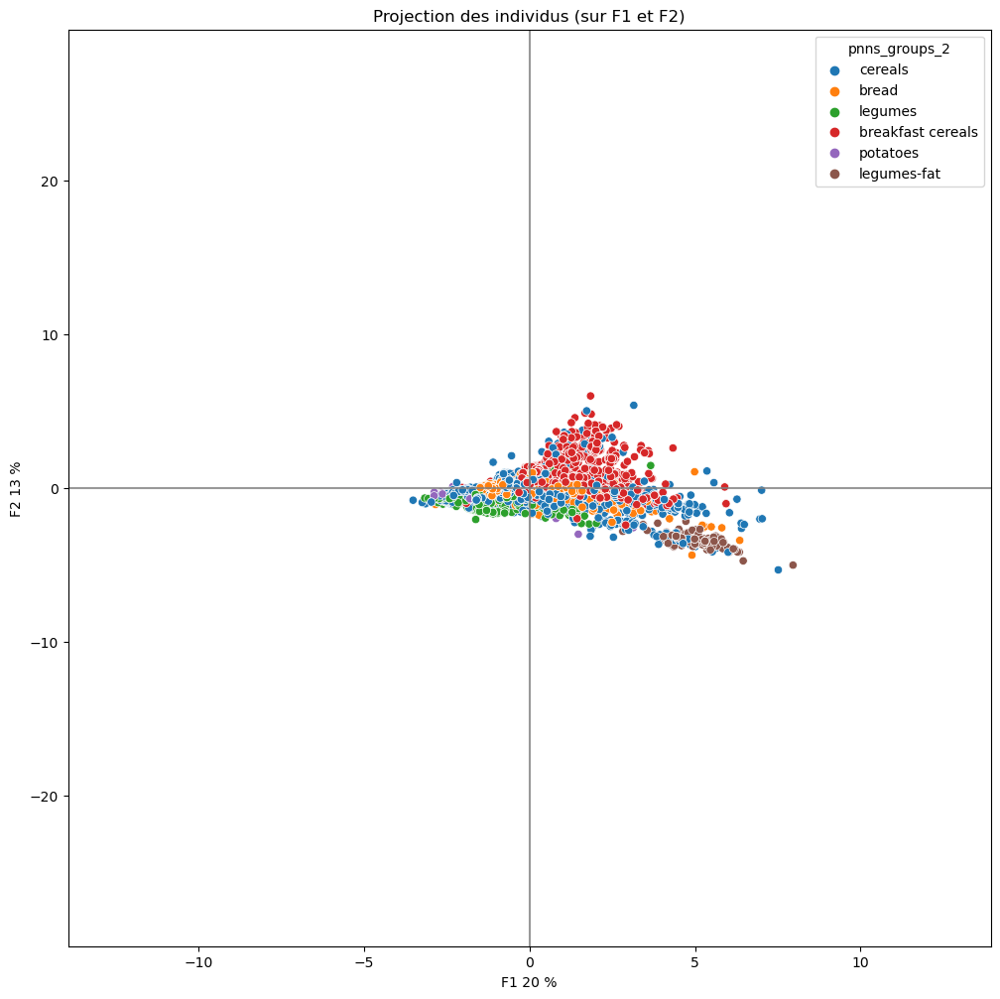

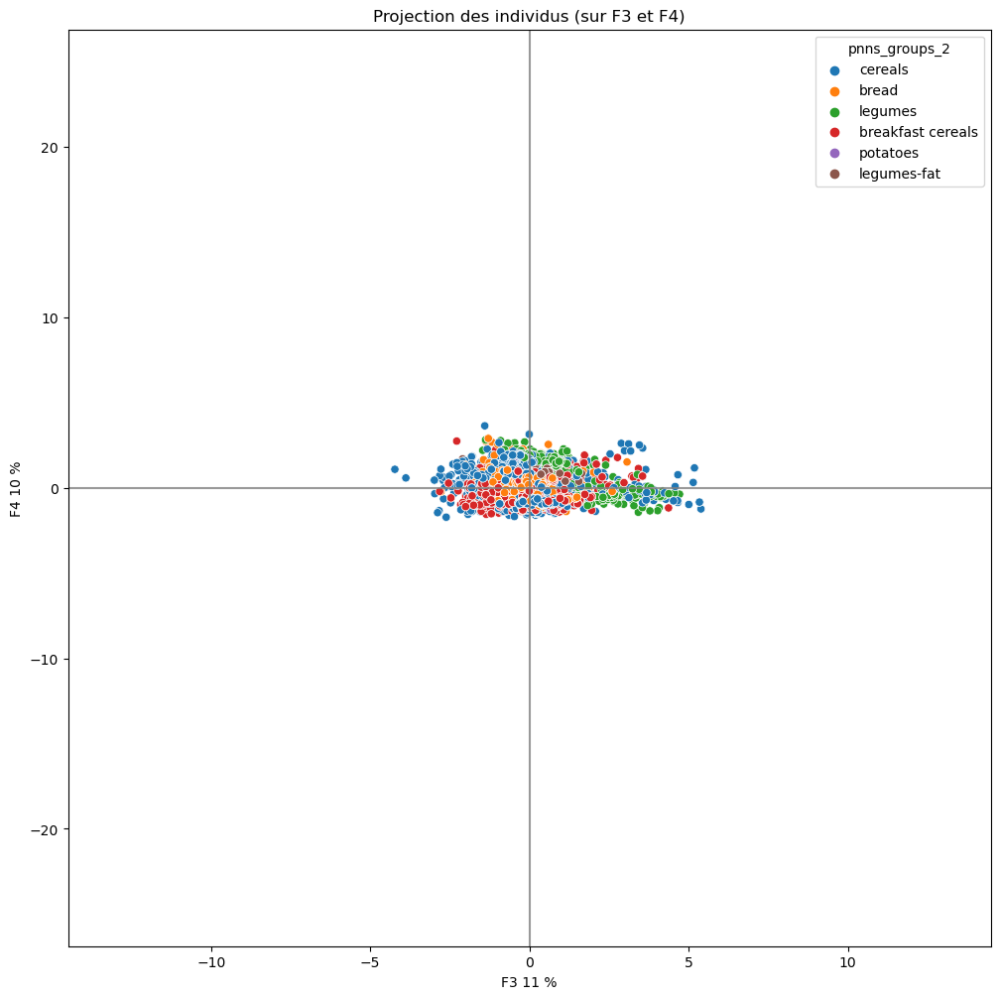

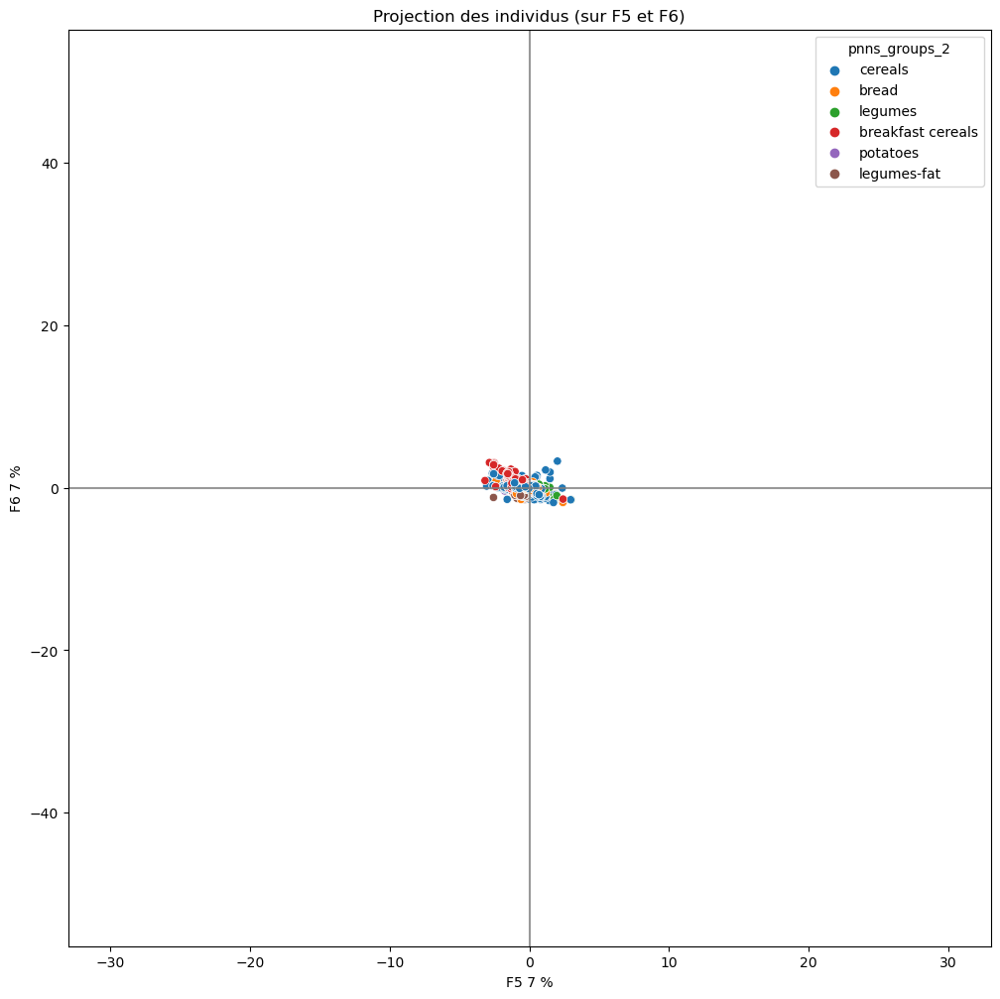

salty snacks


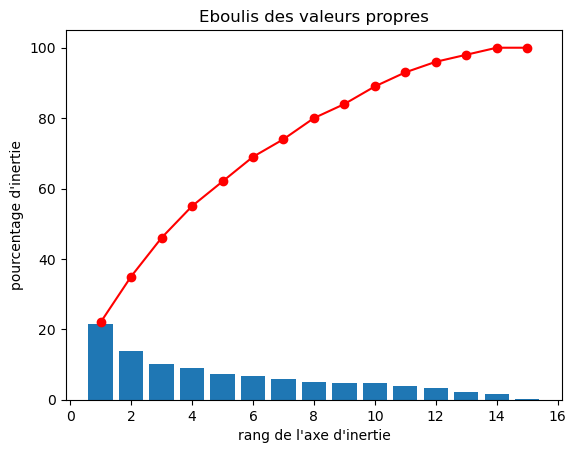

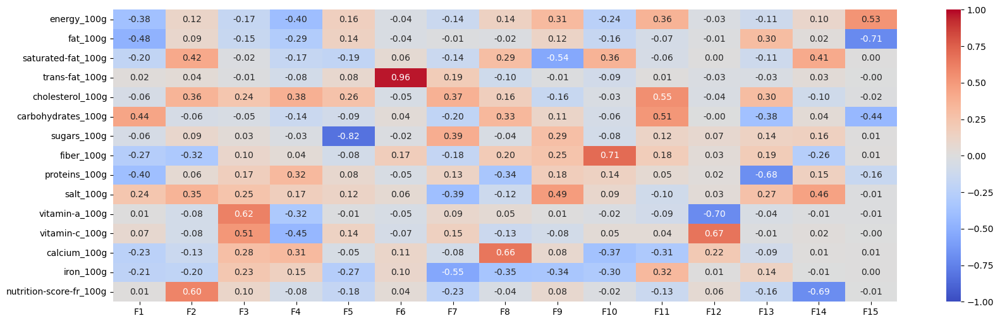

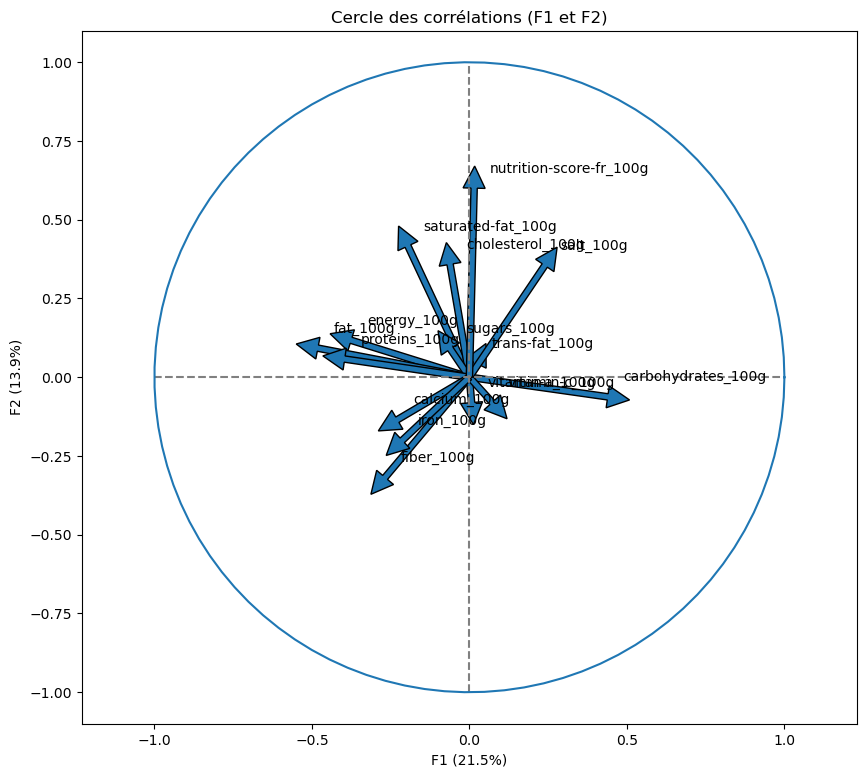

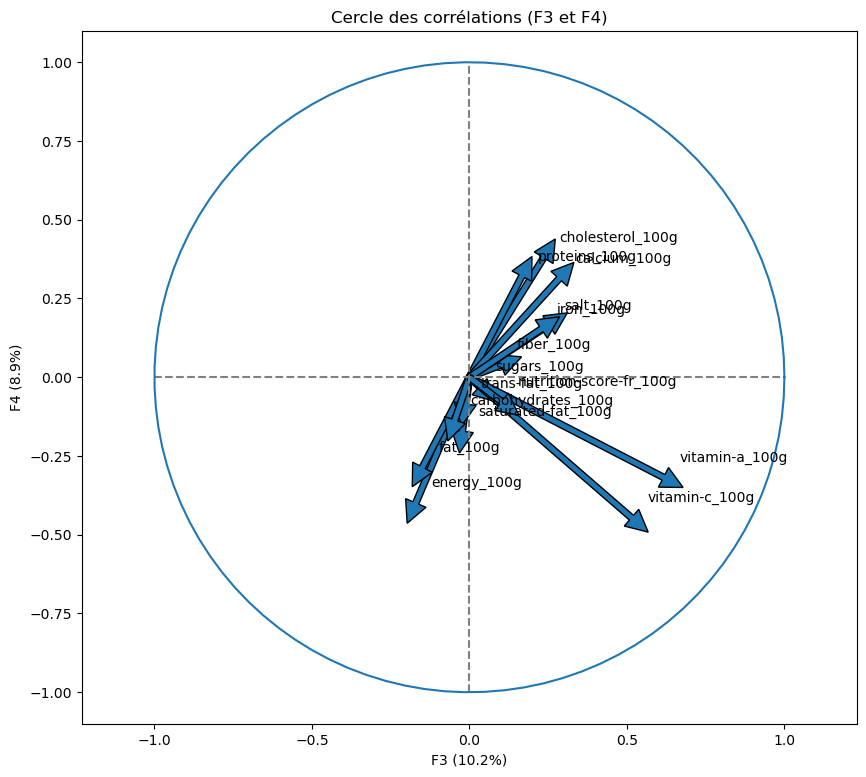

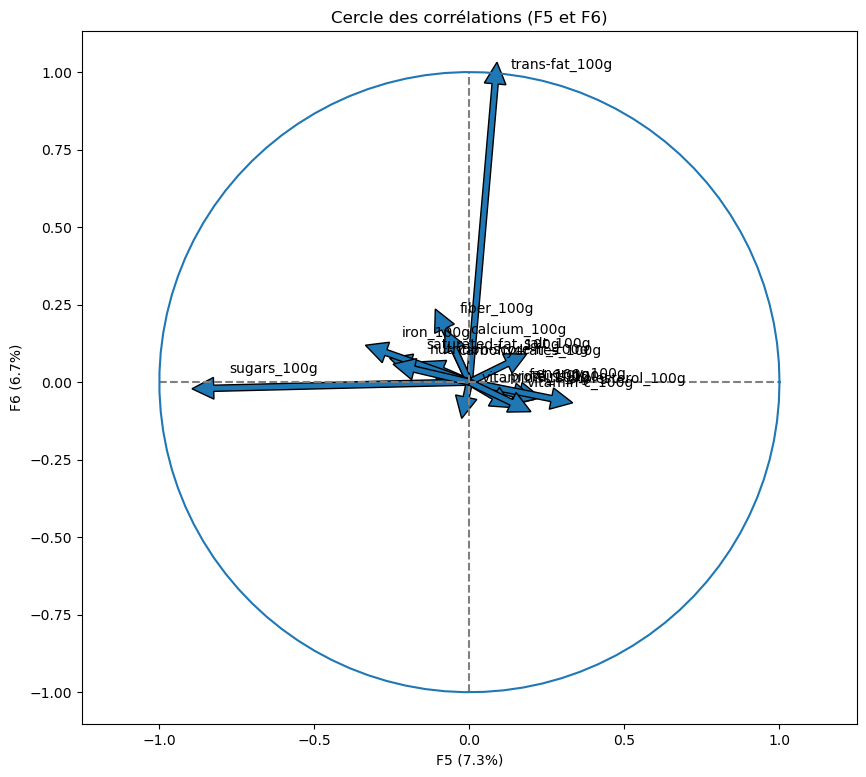

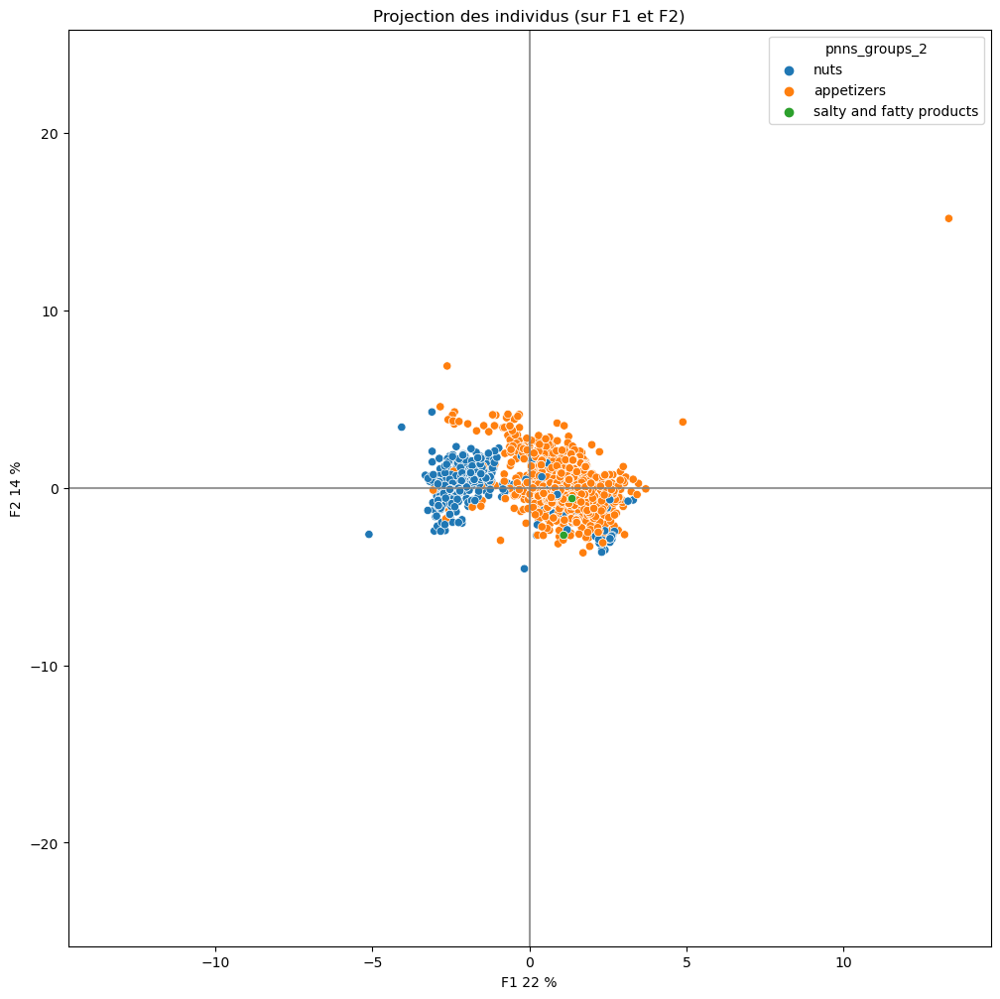

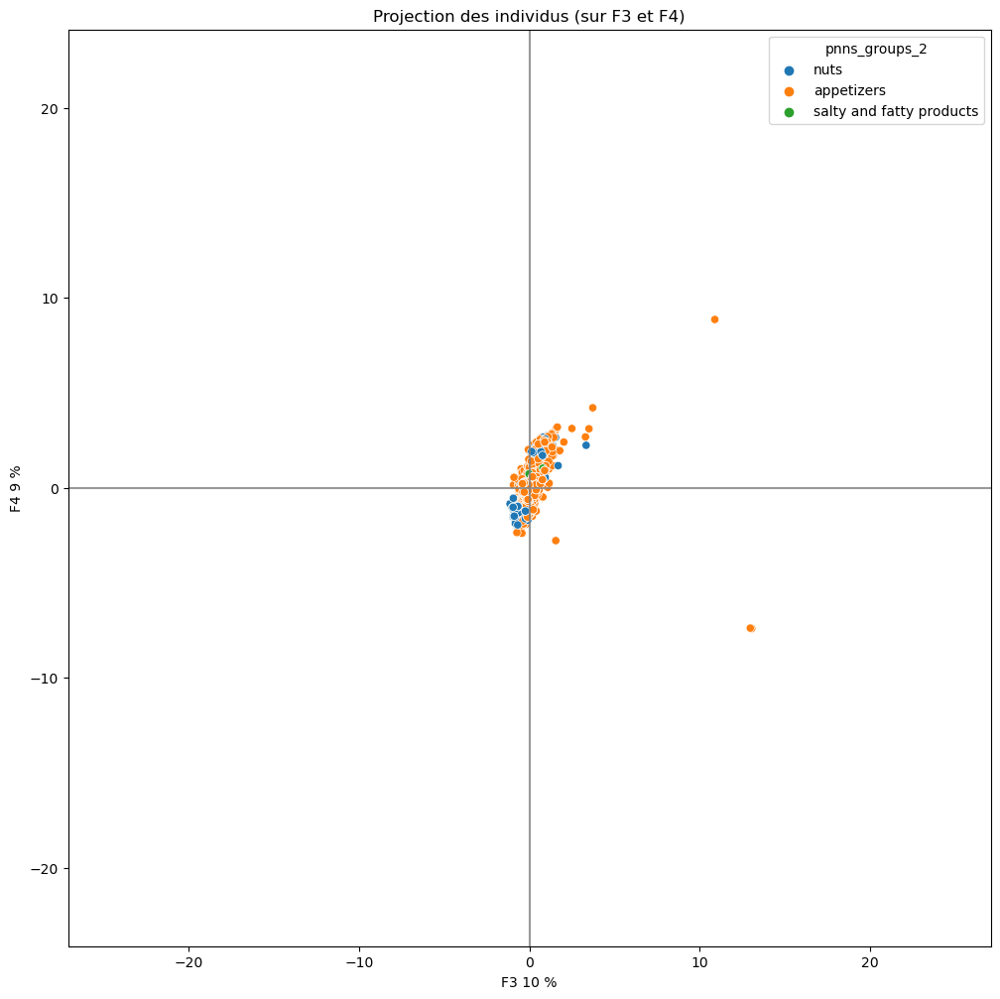

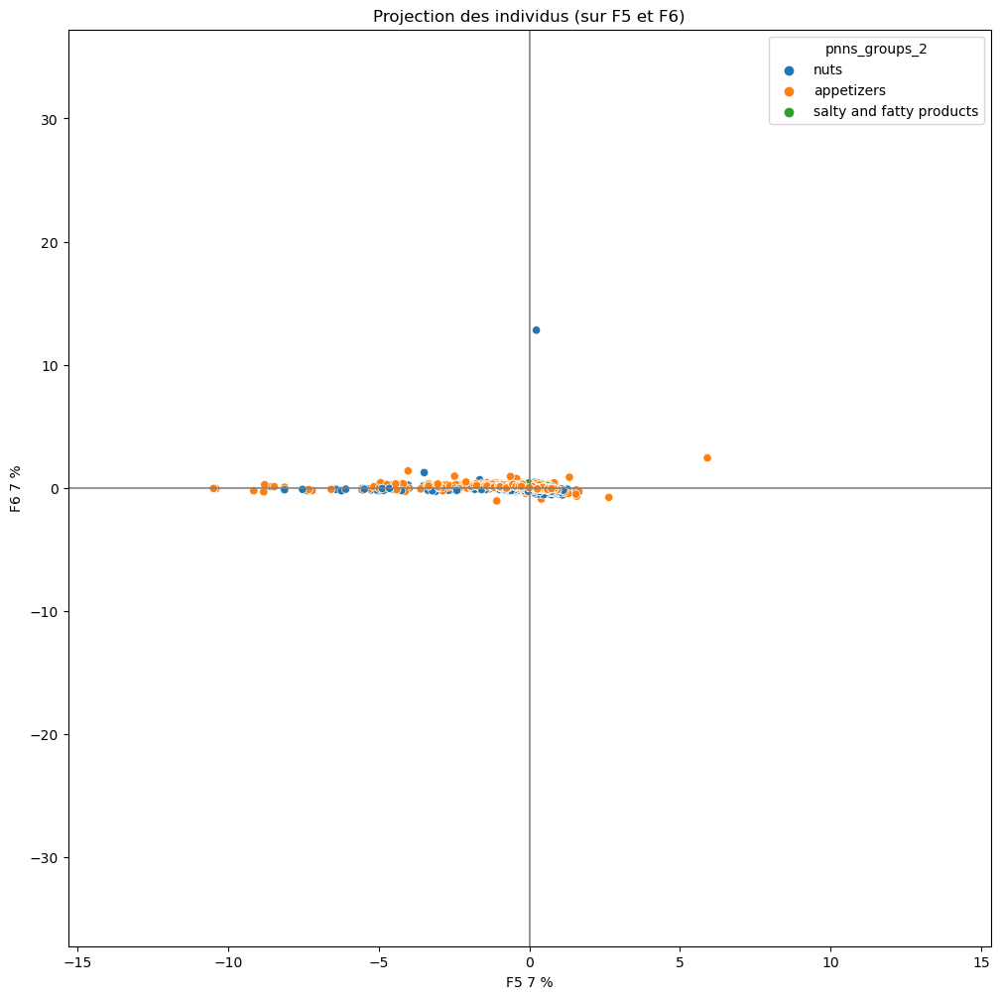

fish meat eggs


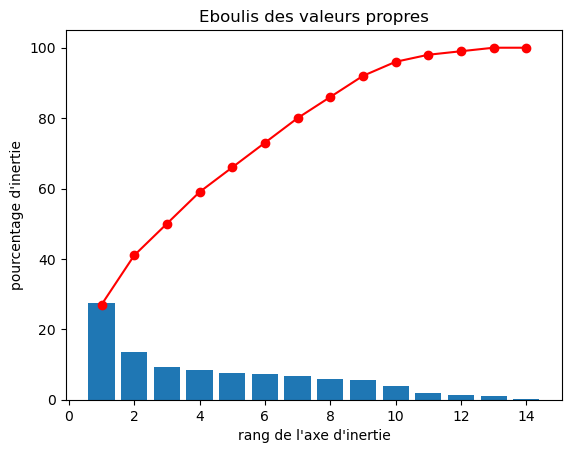

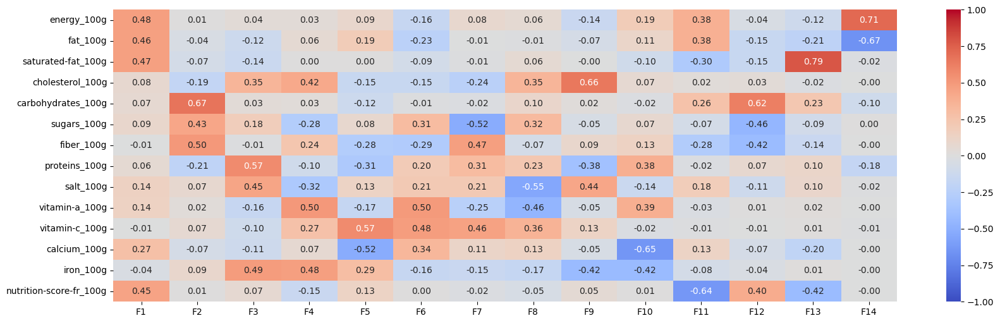

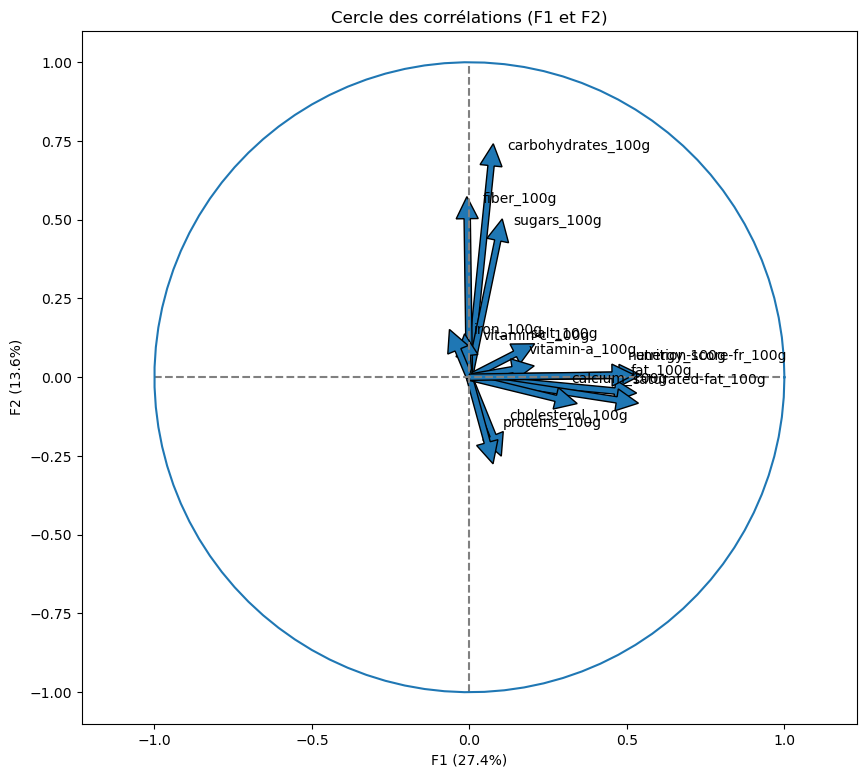

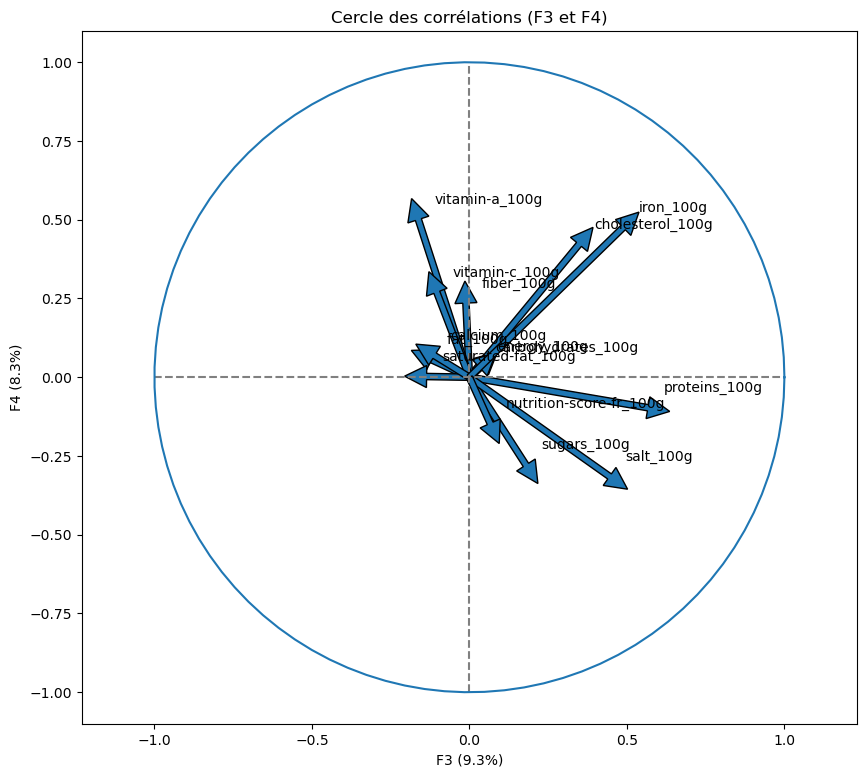

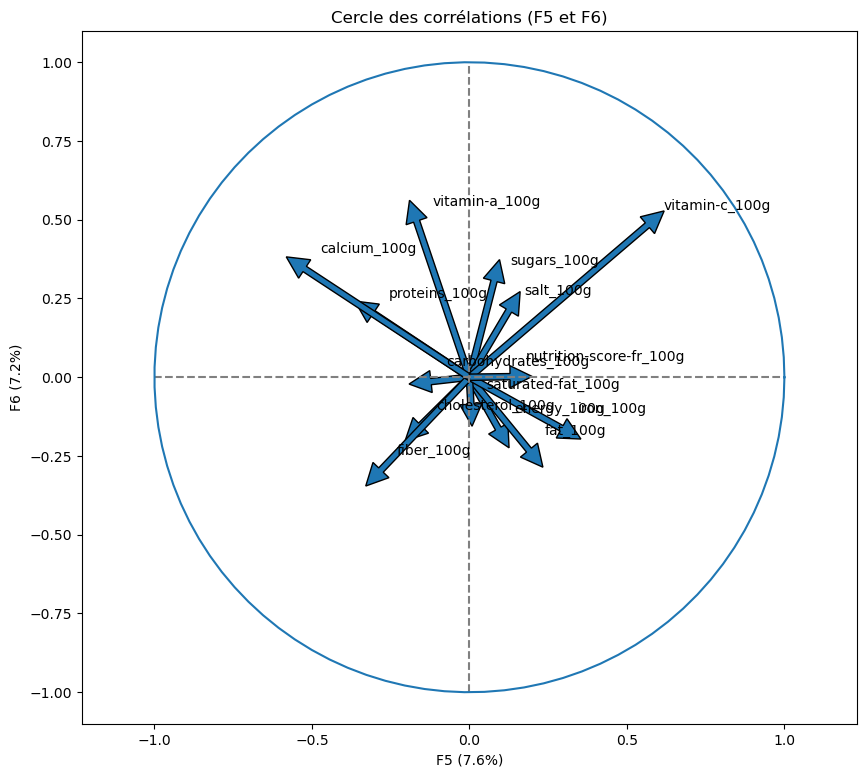

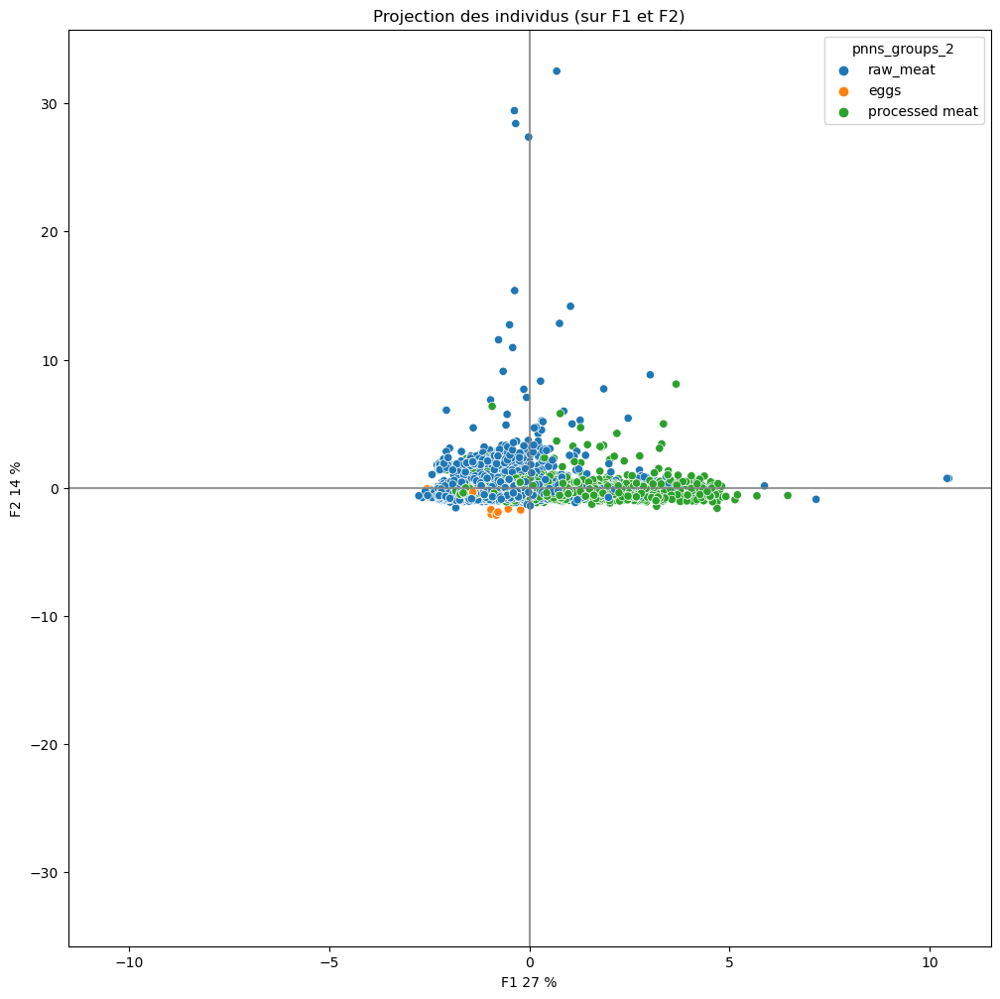

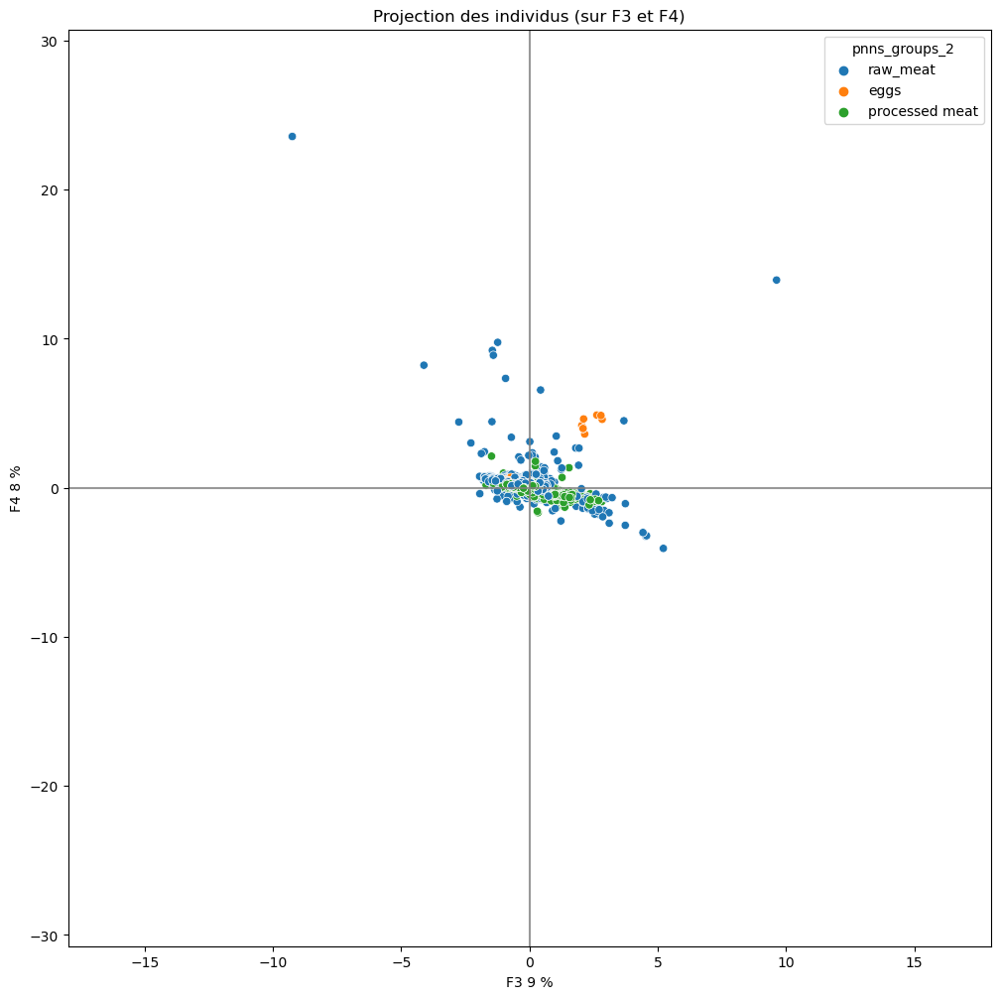

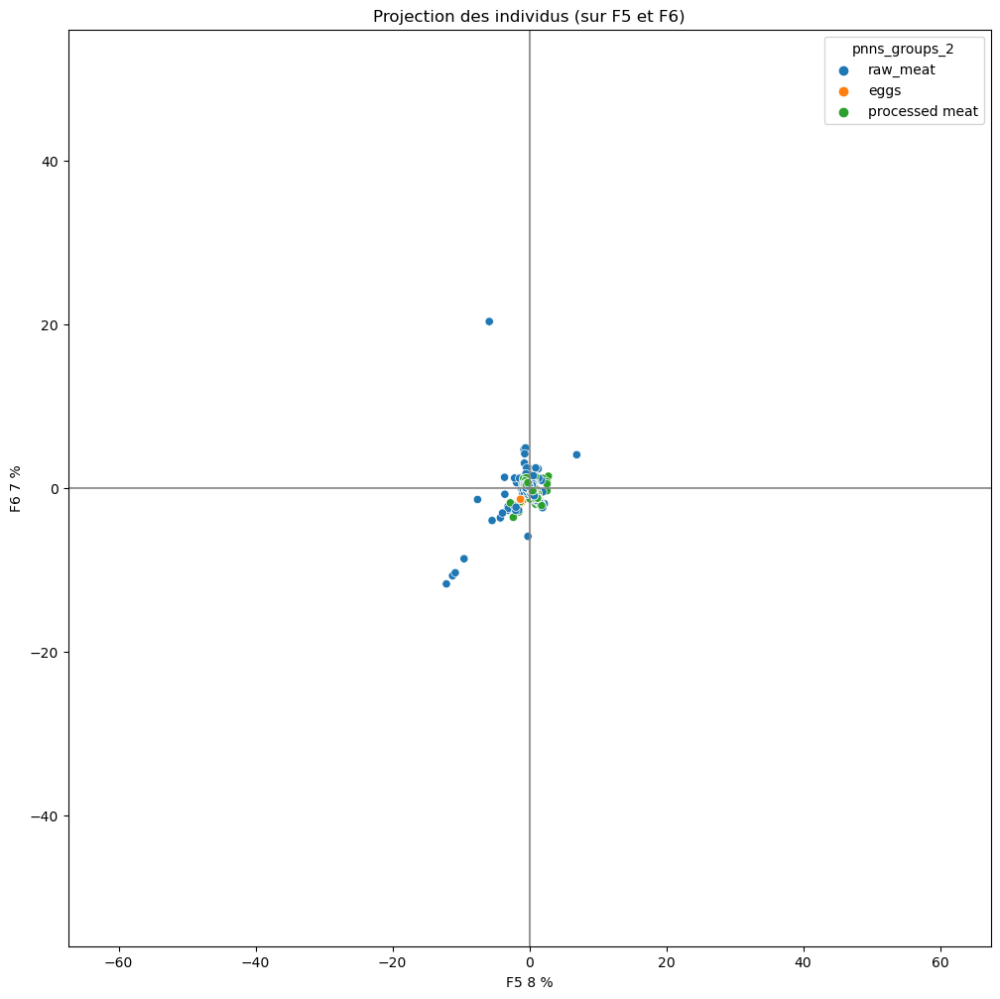

fruits and vegetables


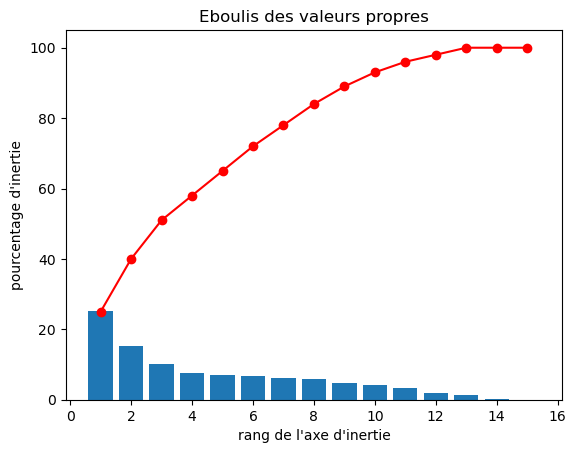

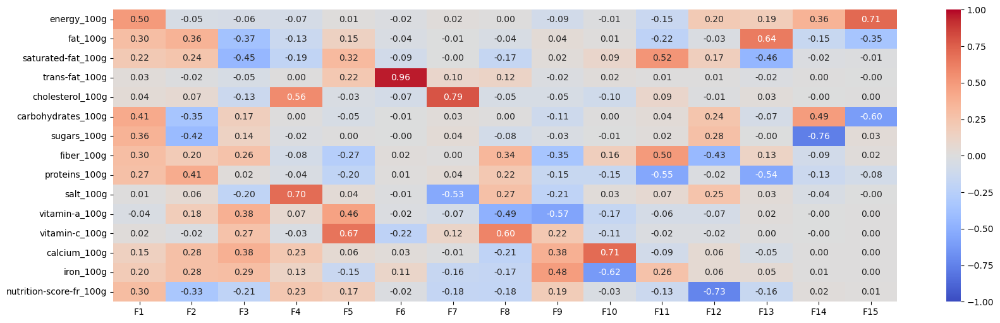

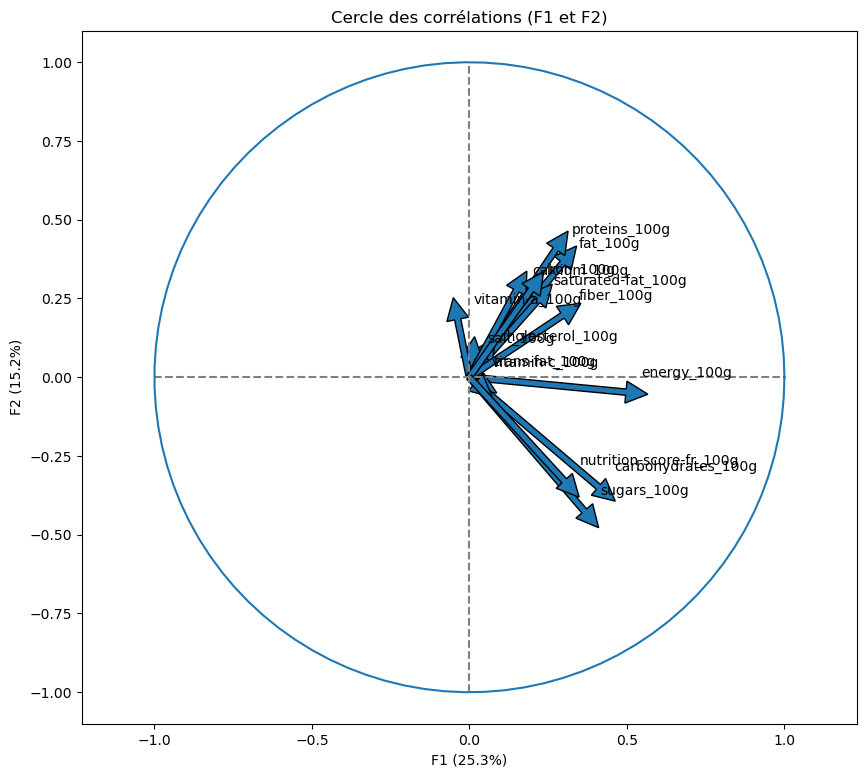

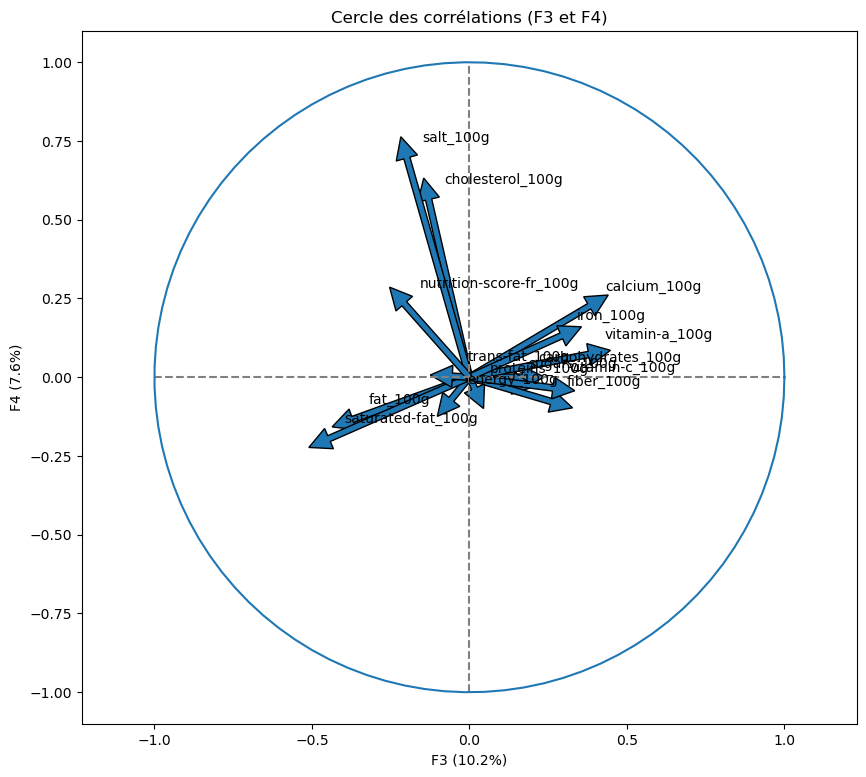

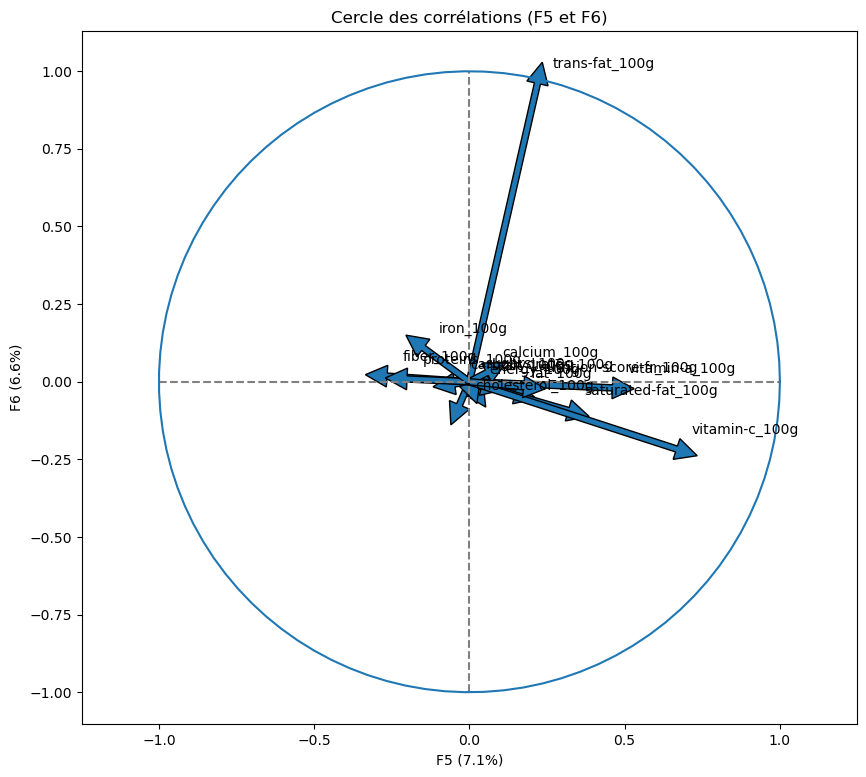

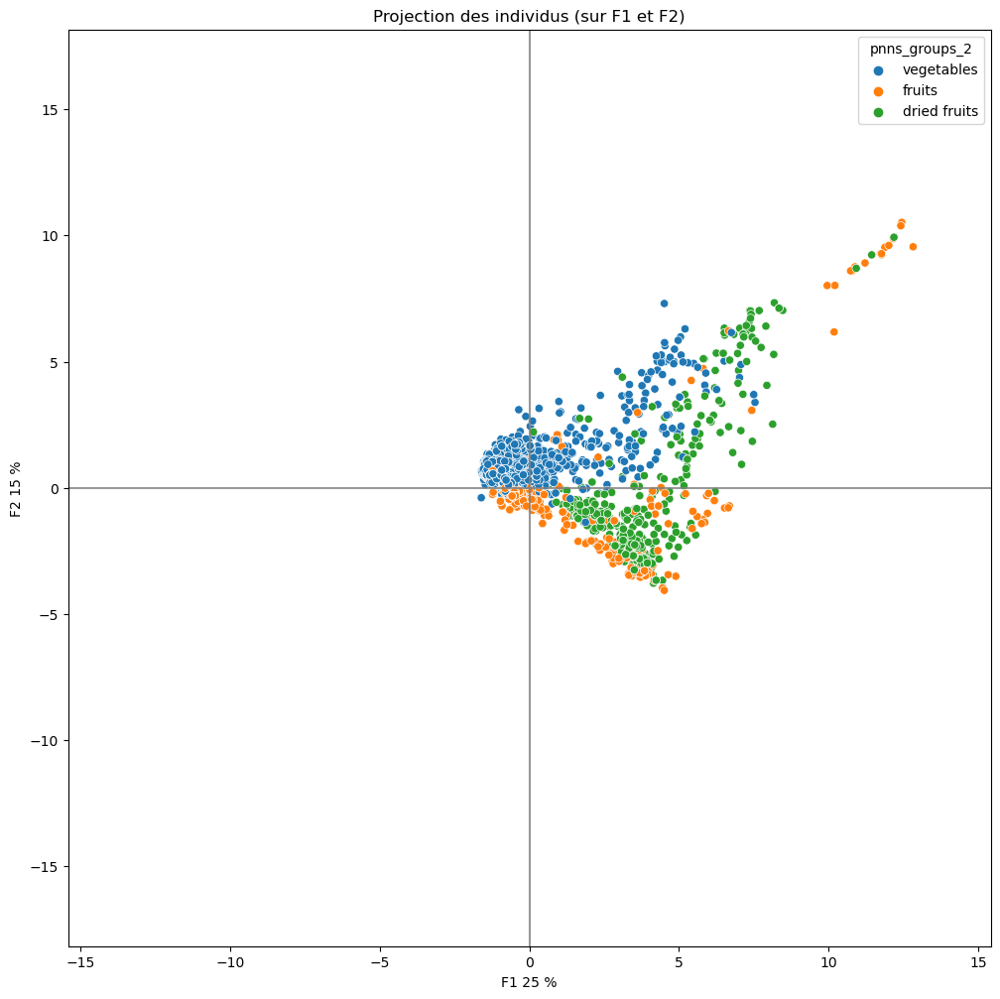

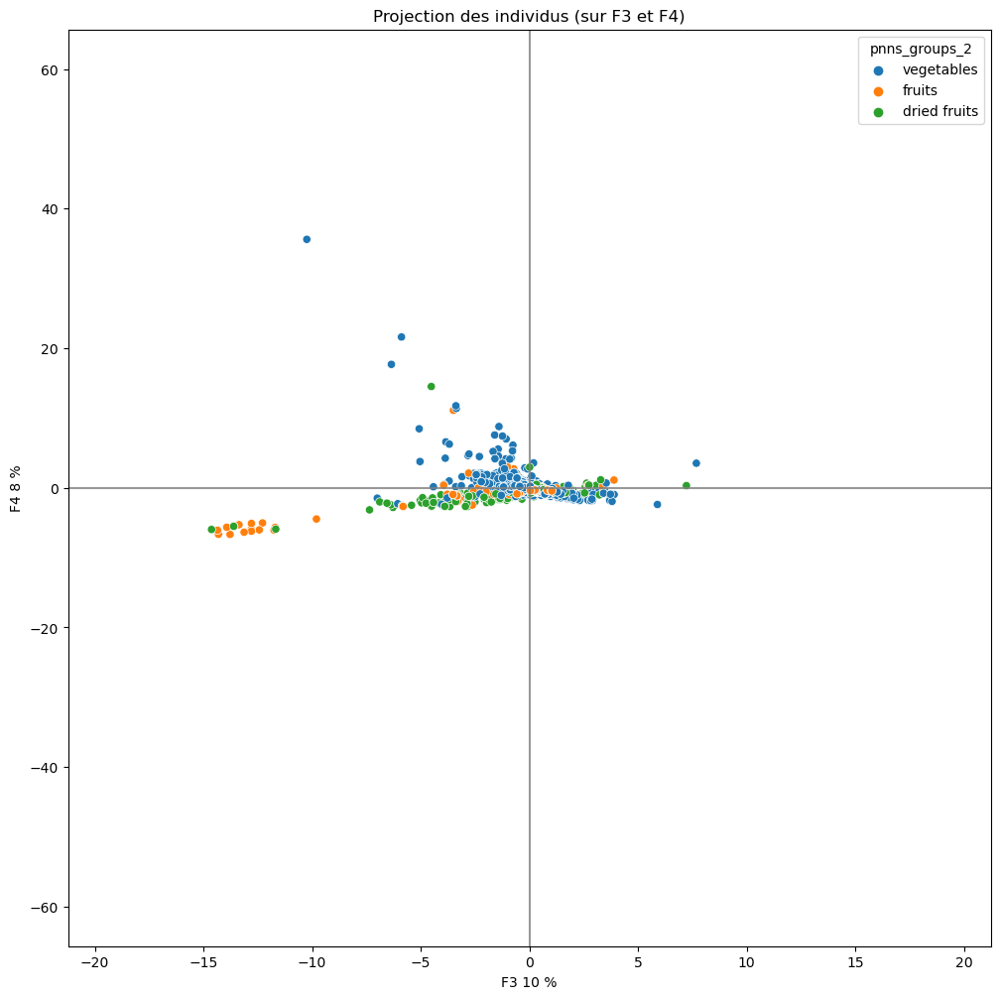

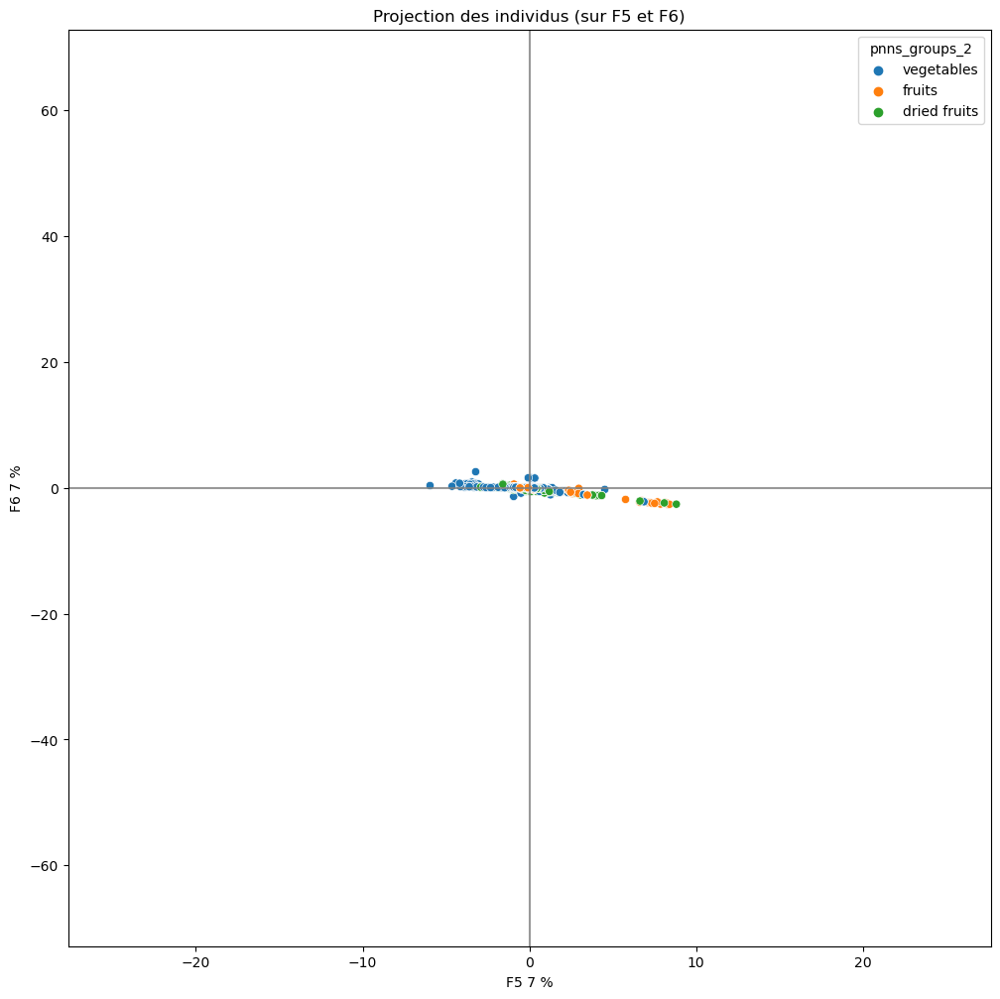

composite foods


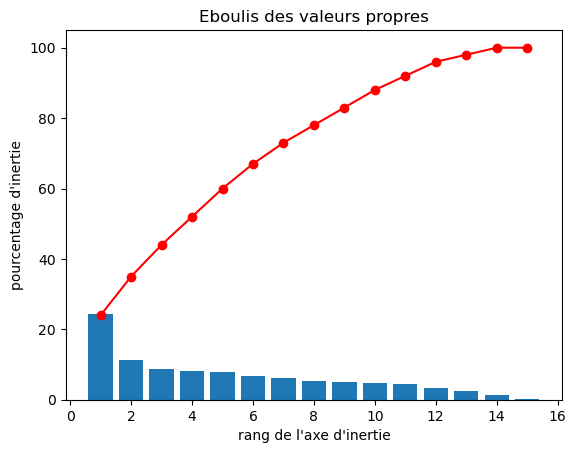

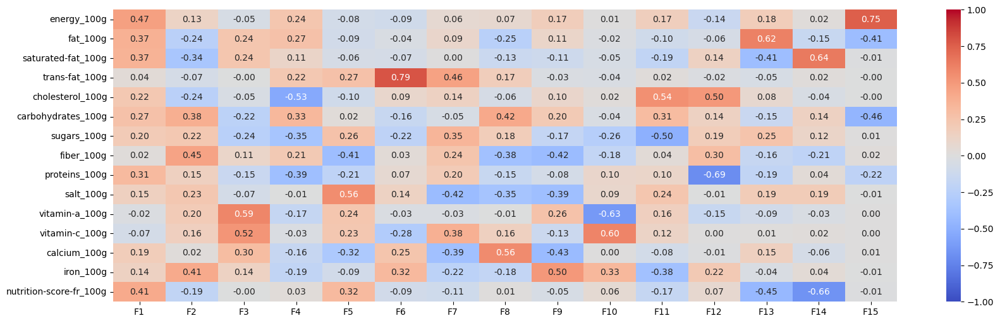

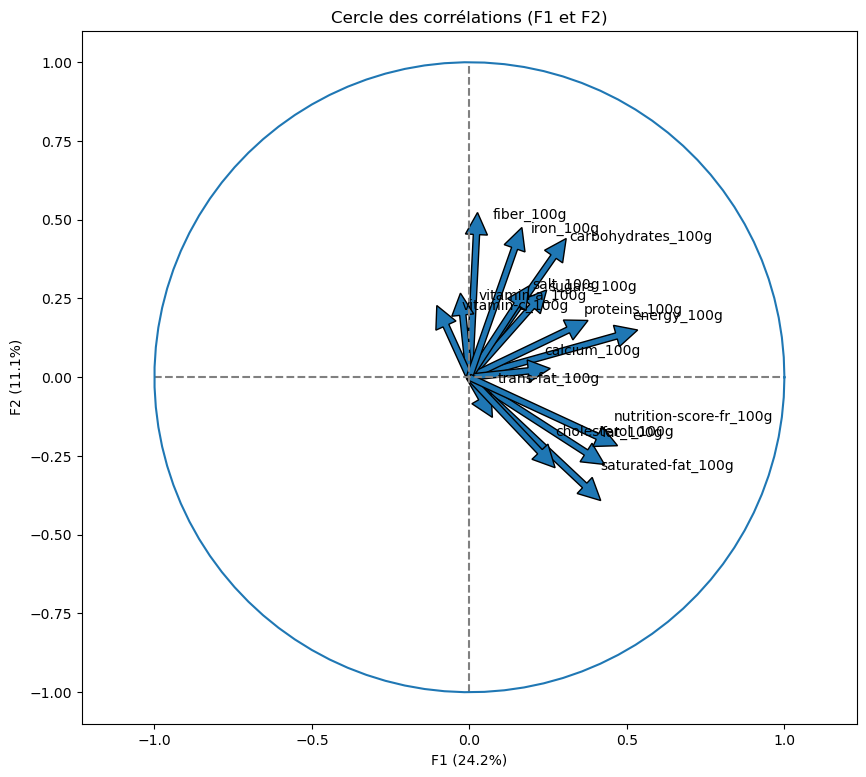

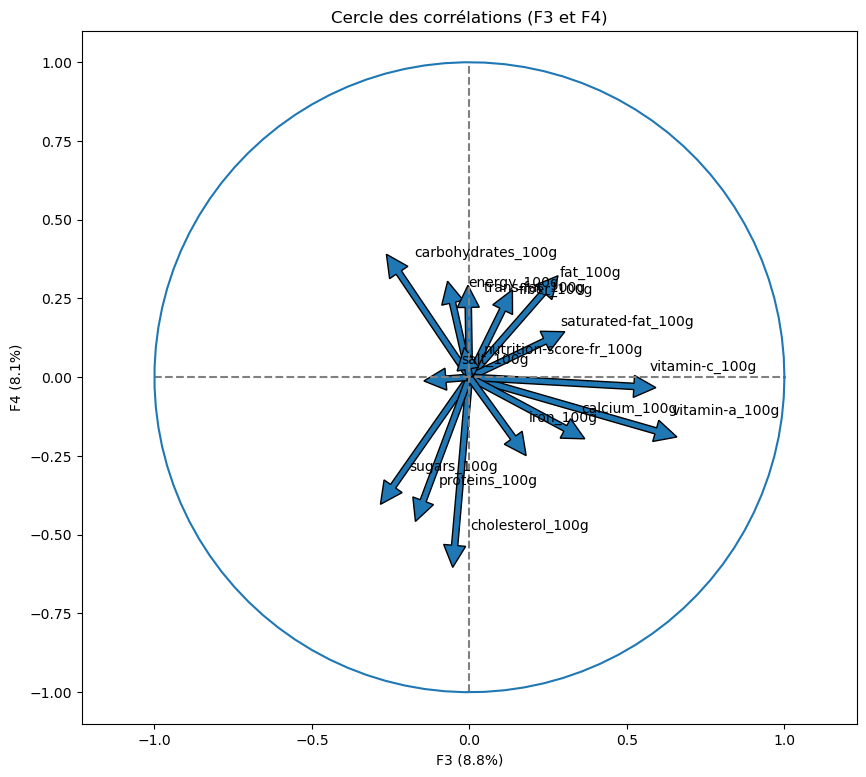

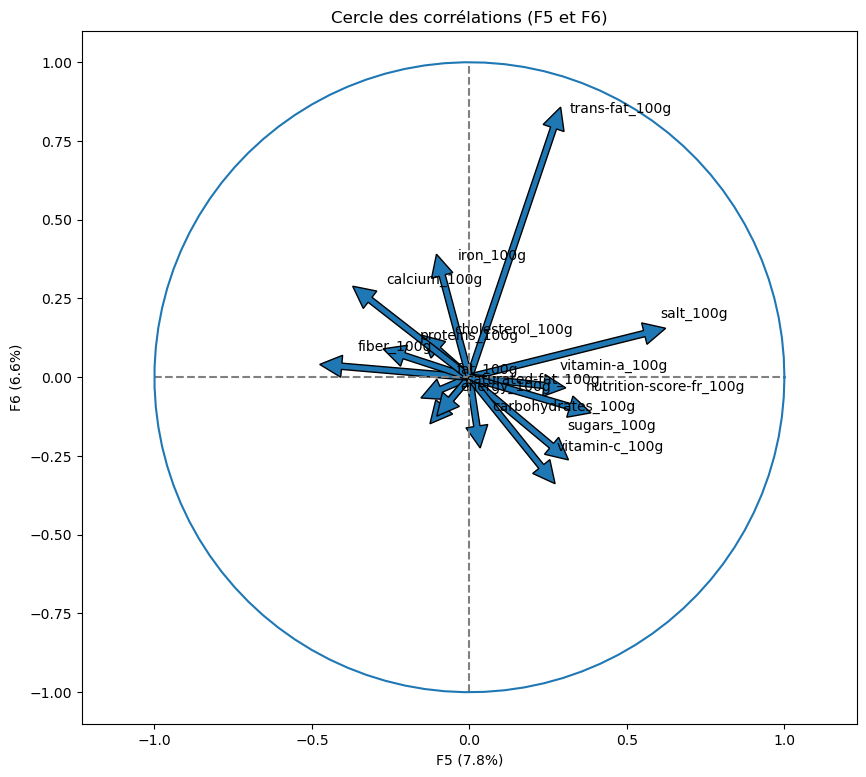

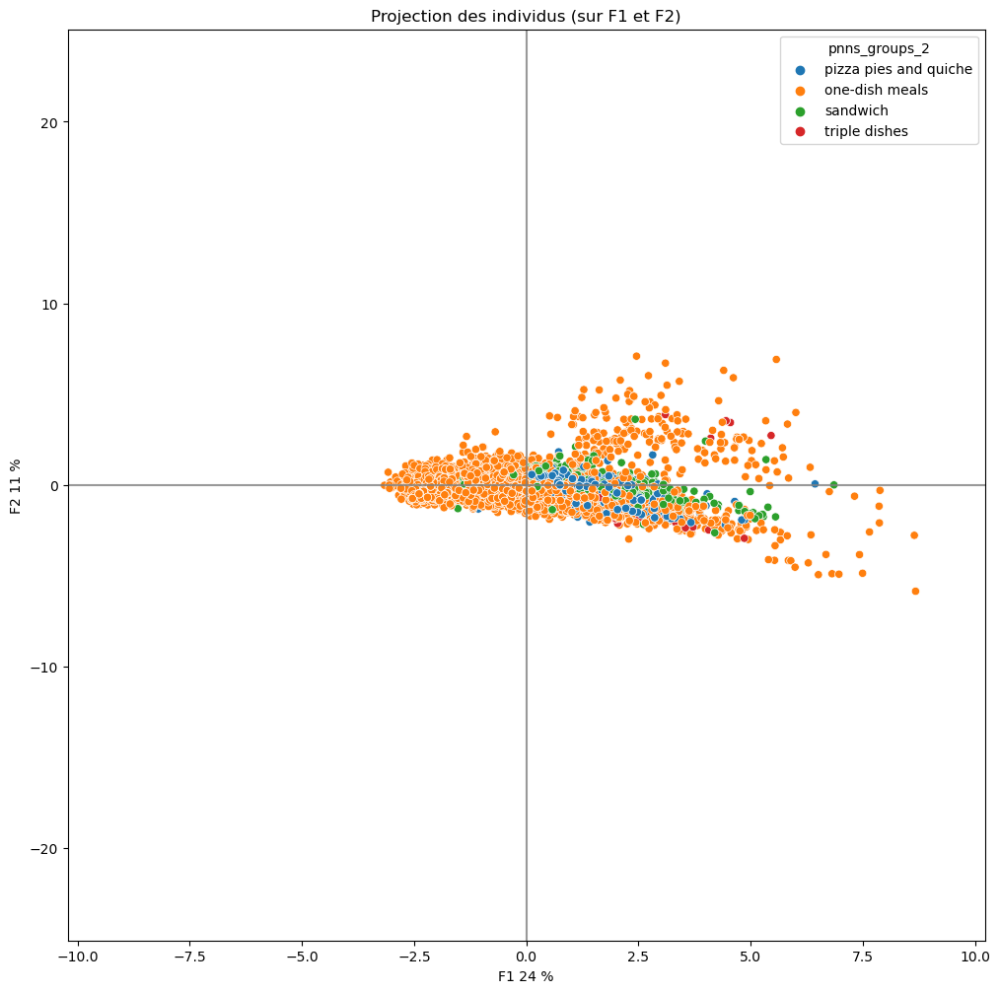

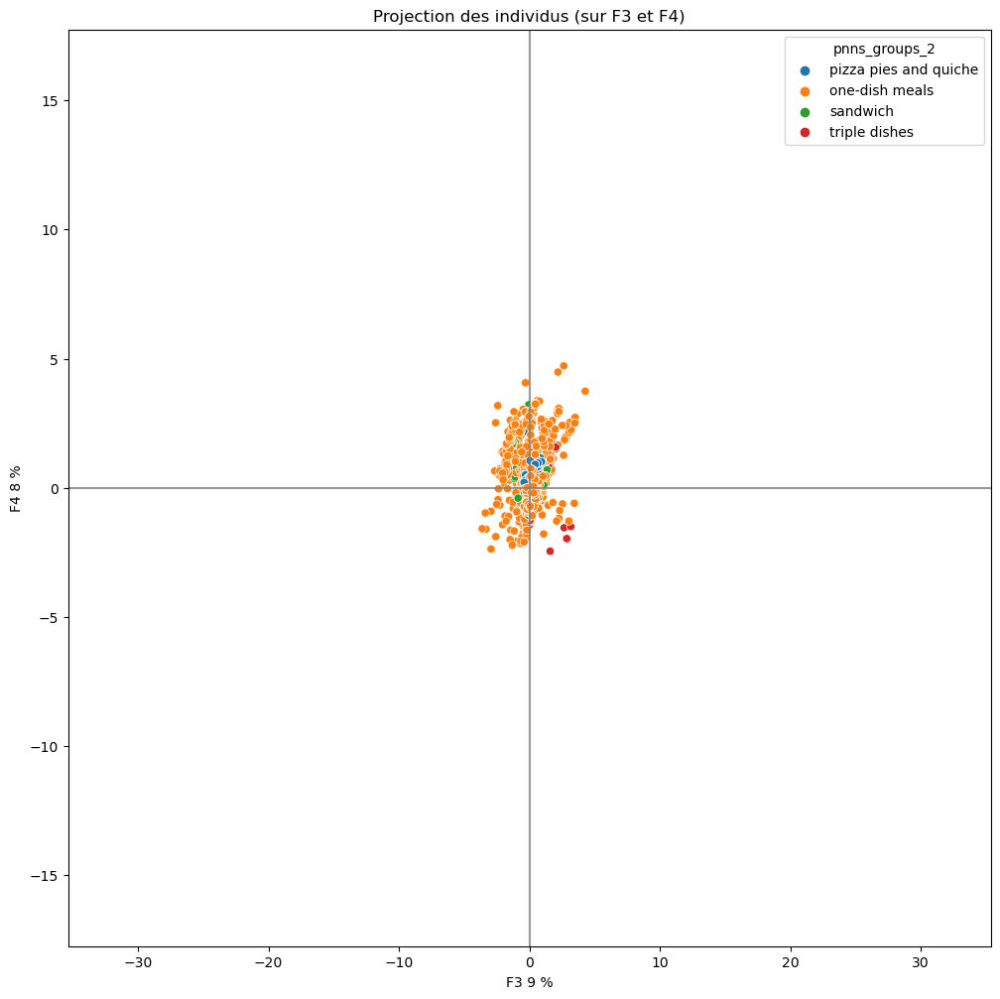

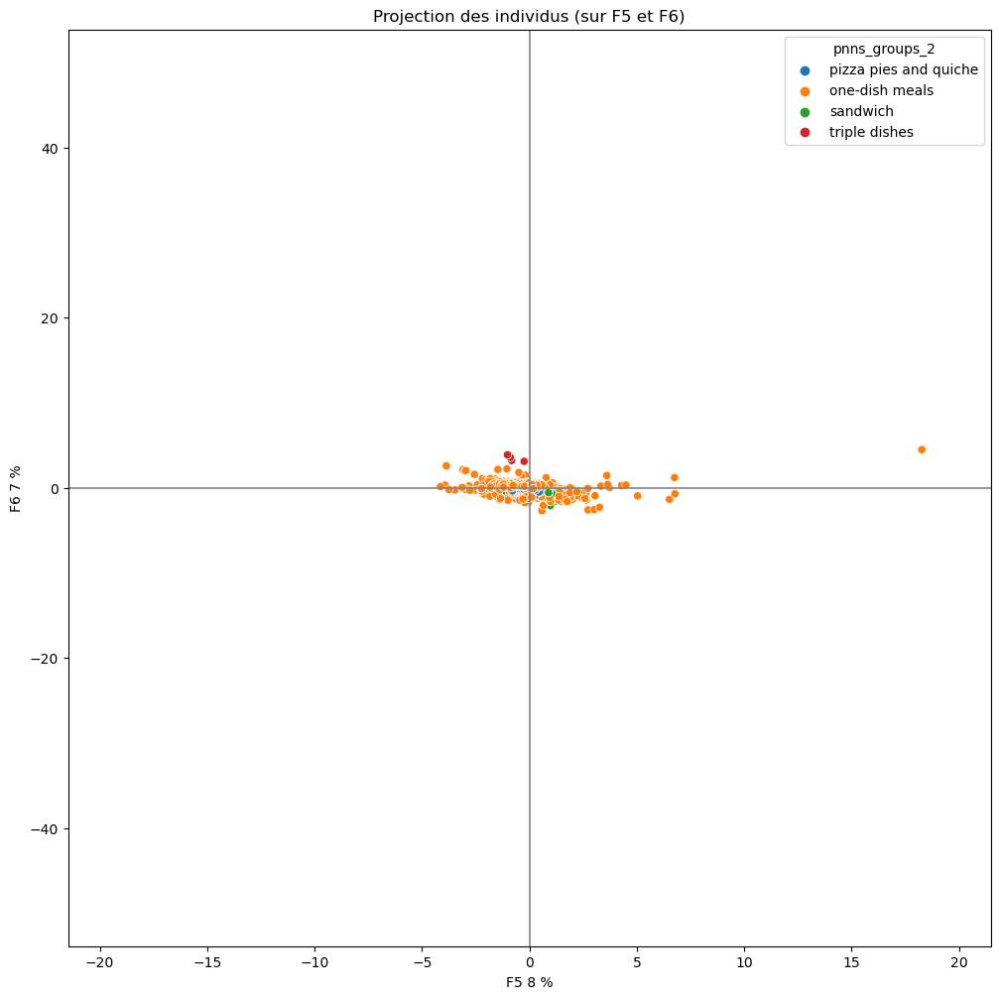

milk and dairy products


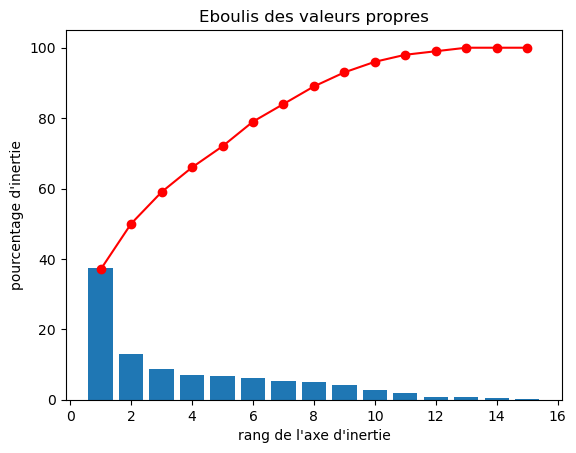

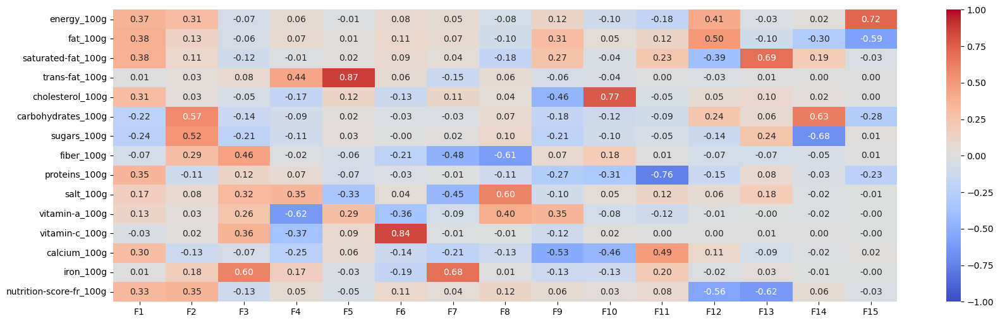

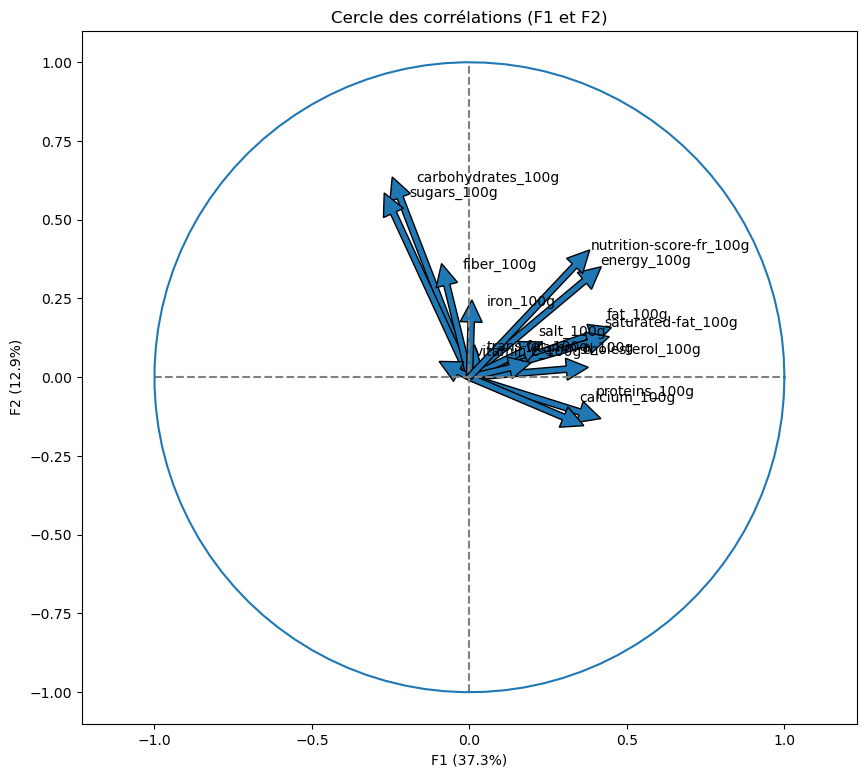

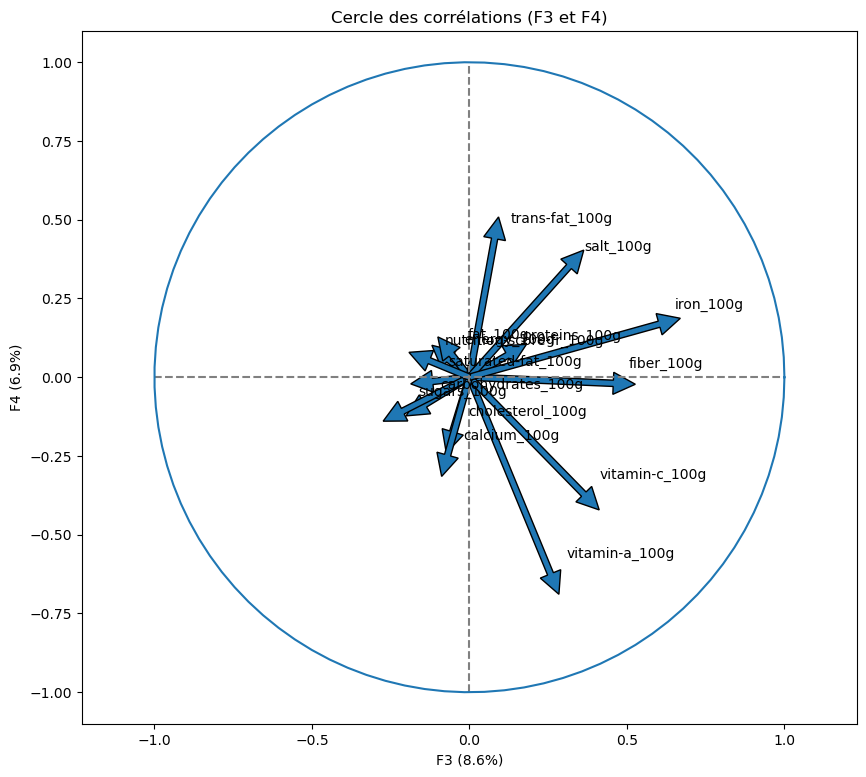

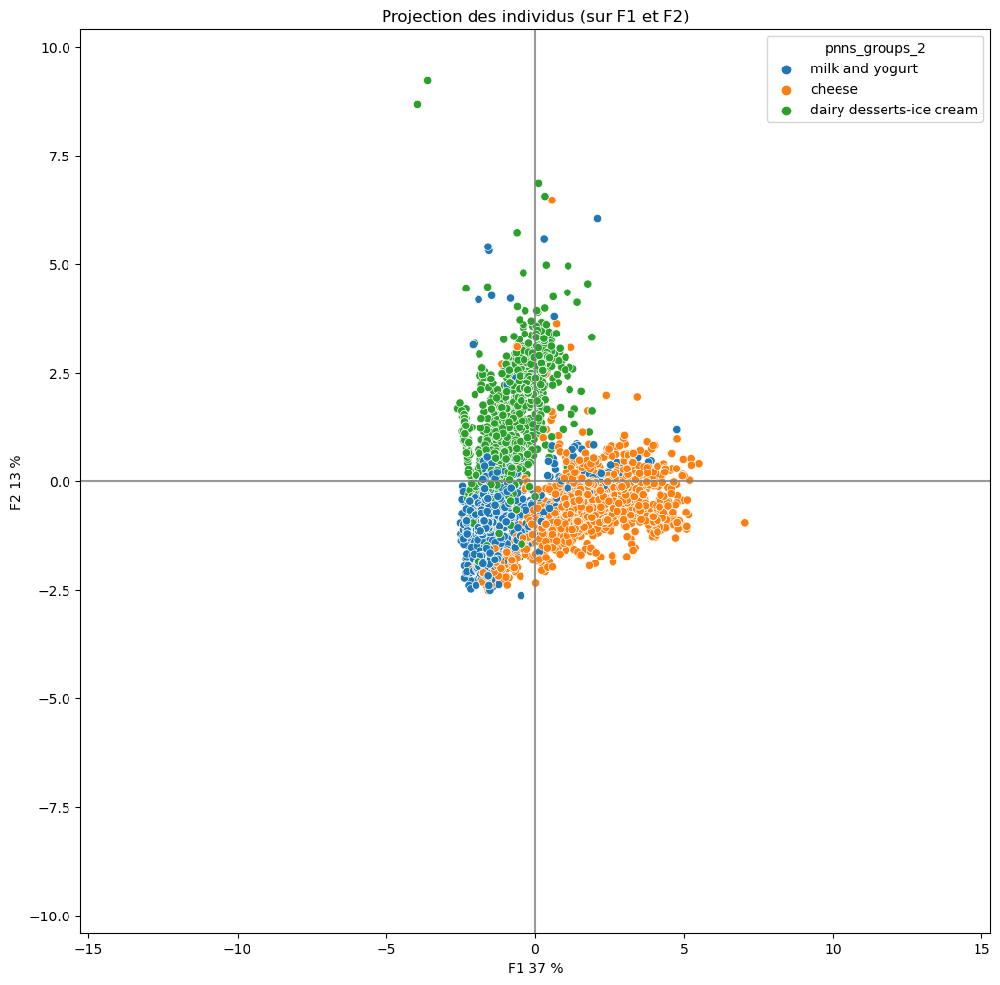

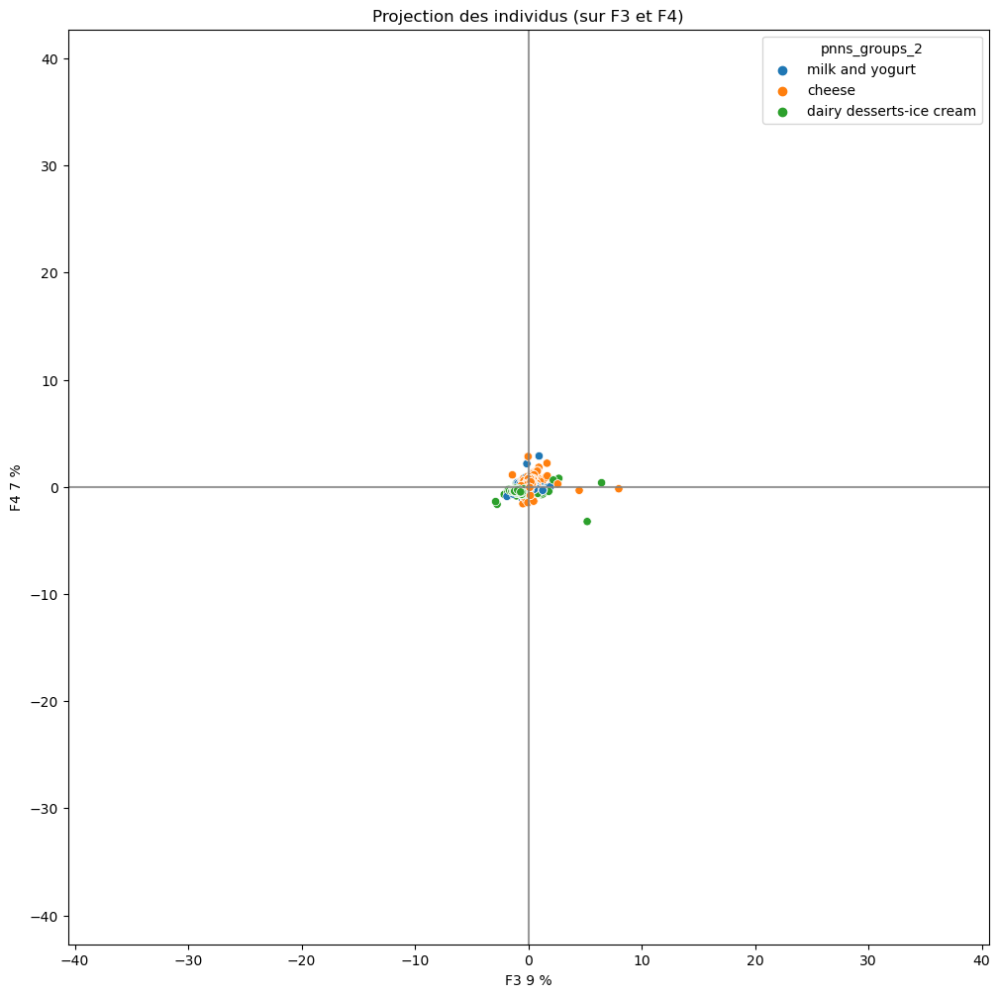

beverages


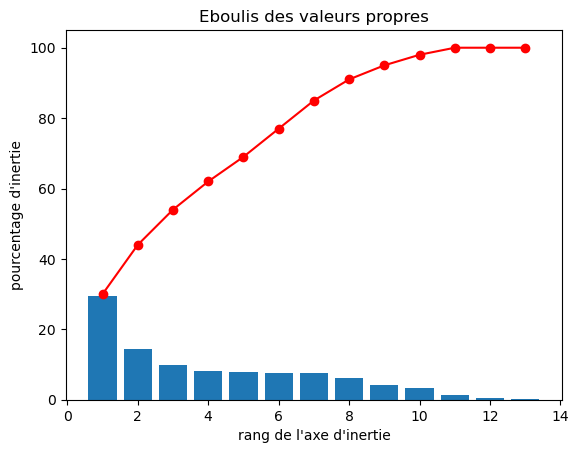

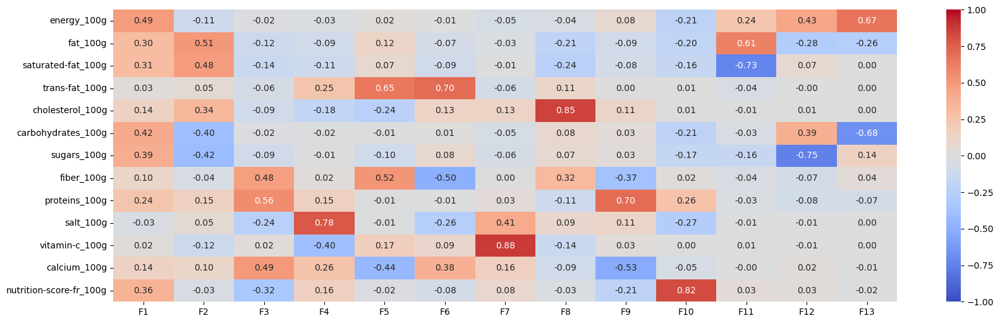

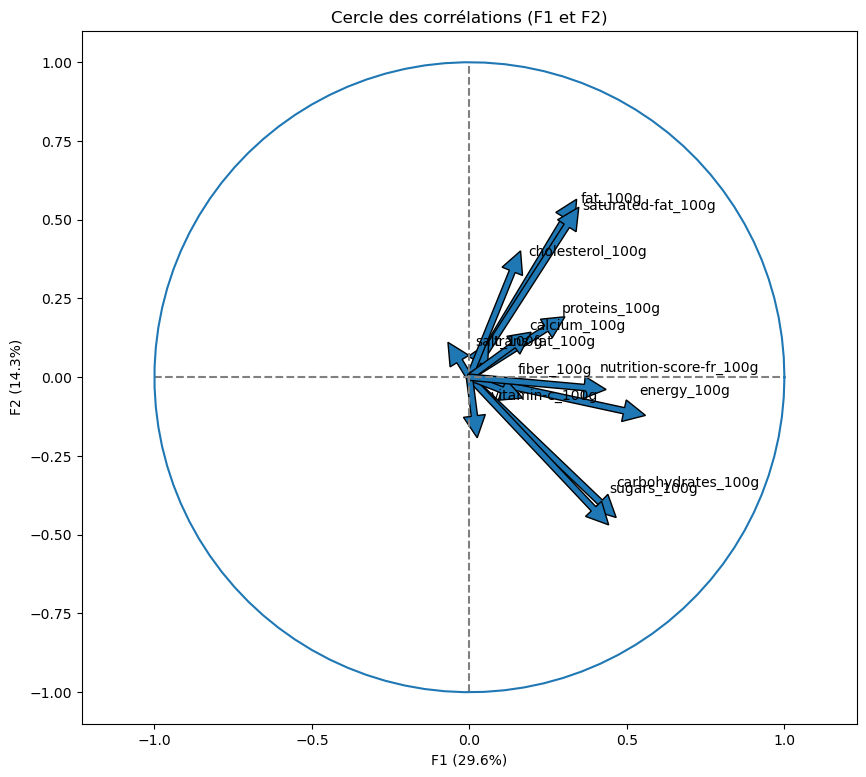

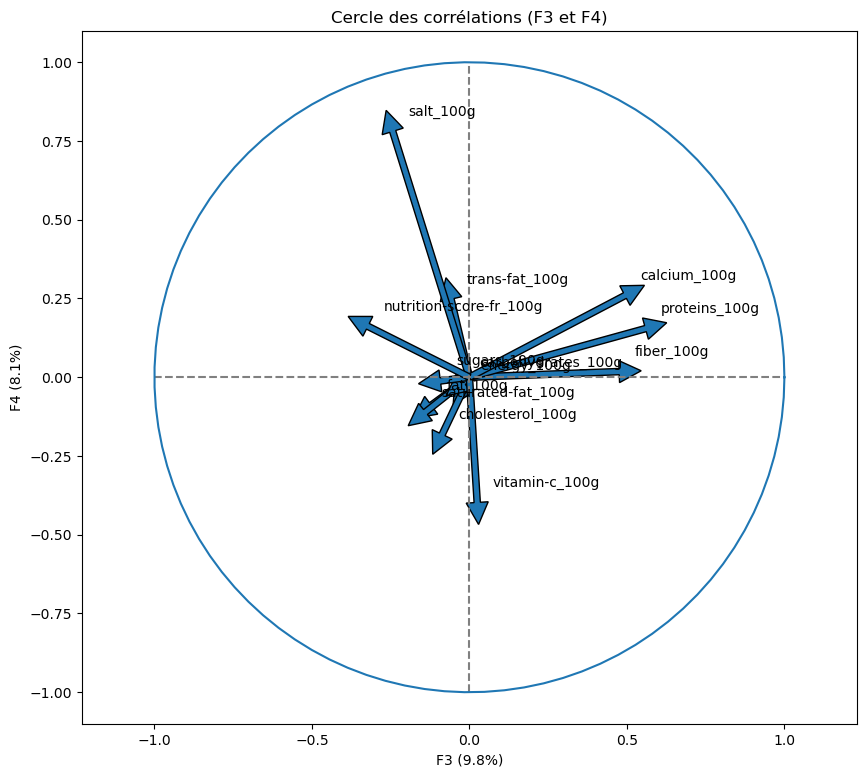

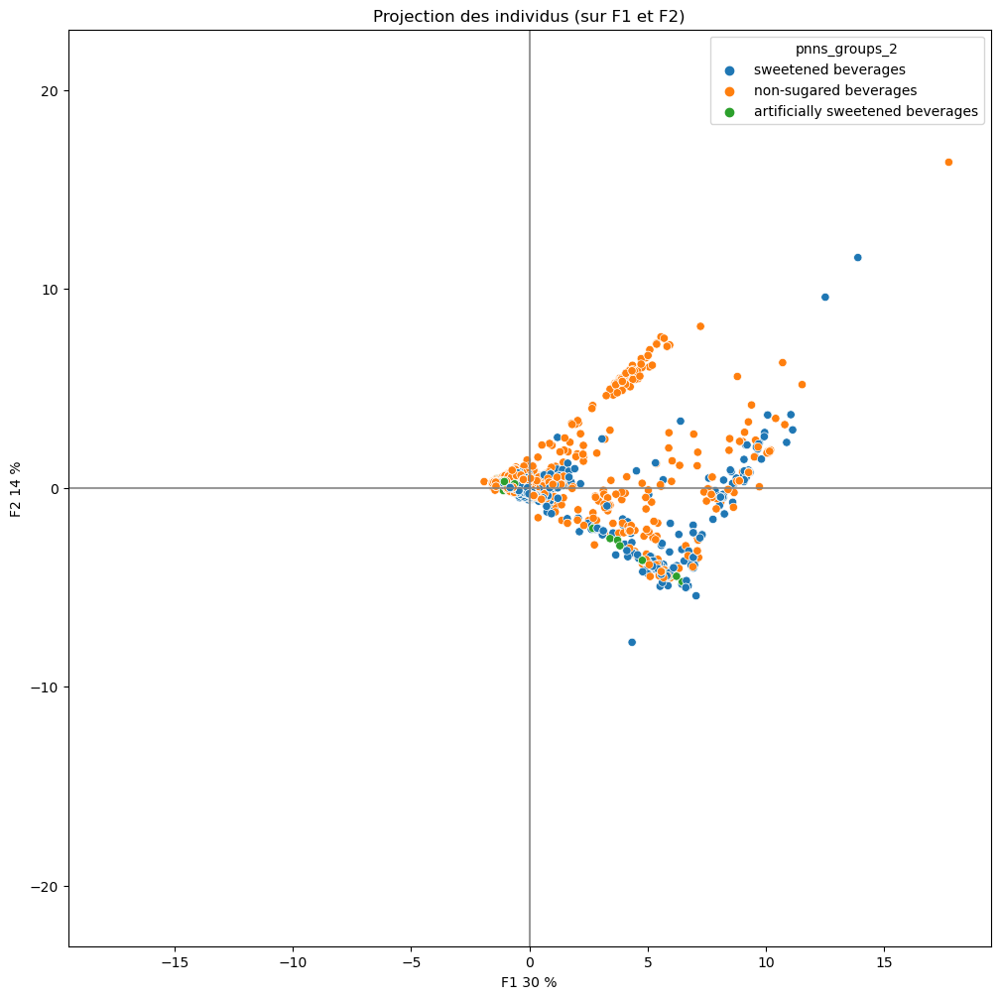

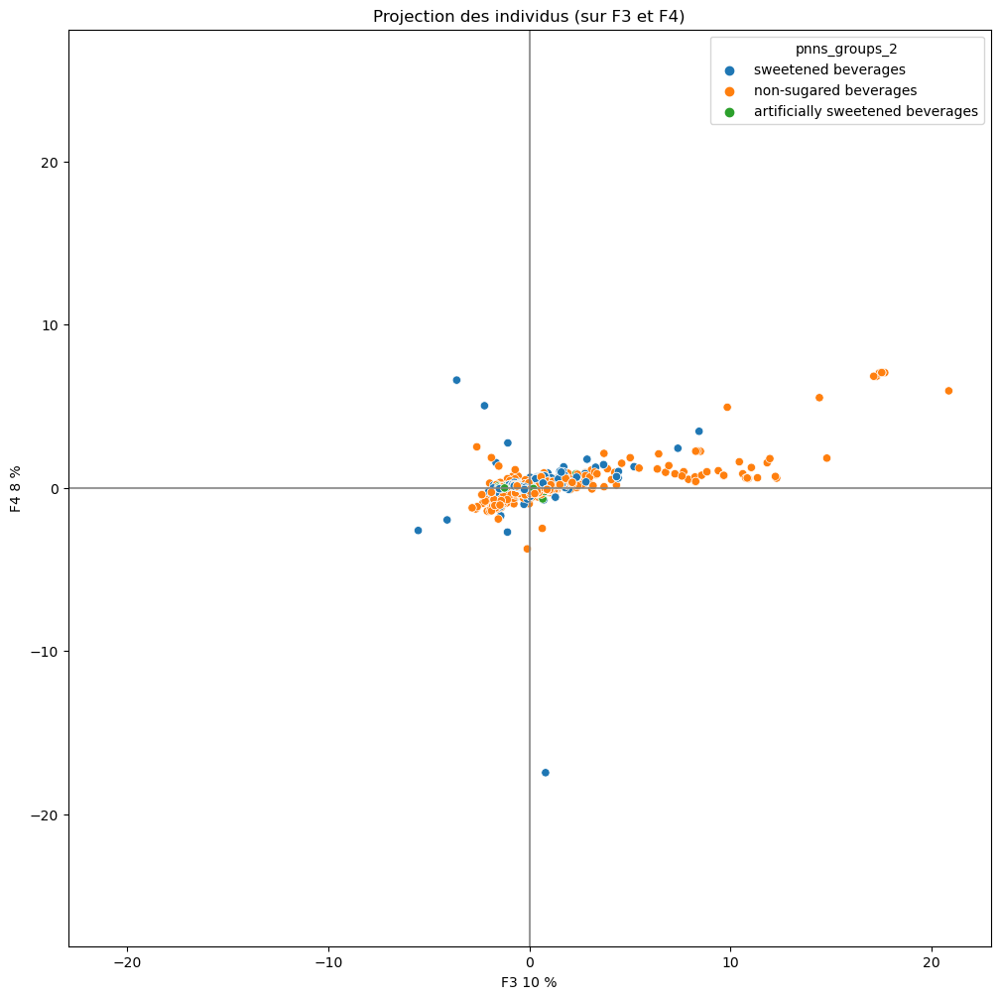

fat and sauces


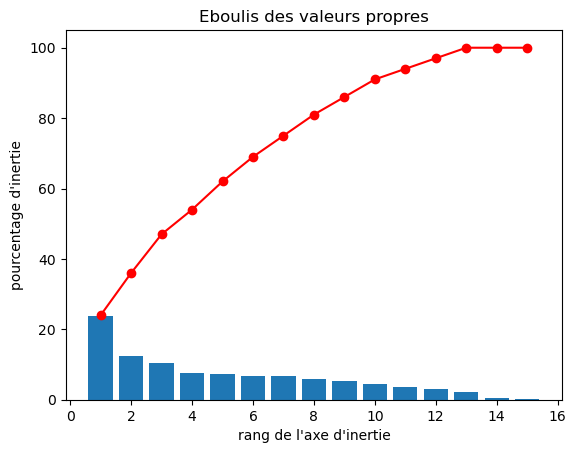

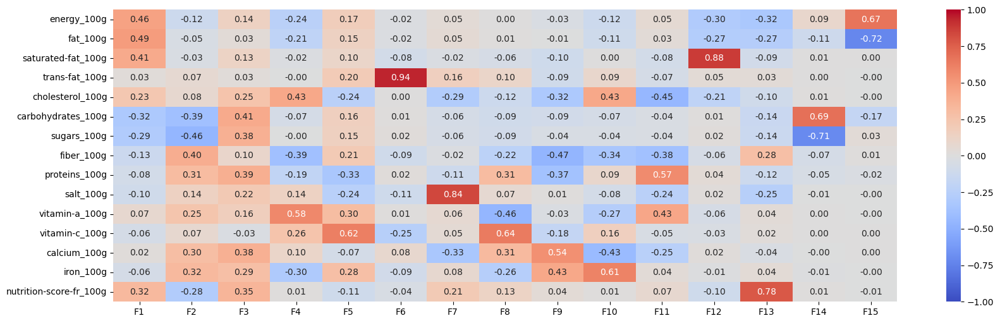

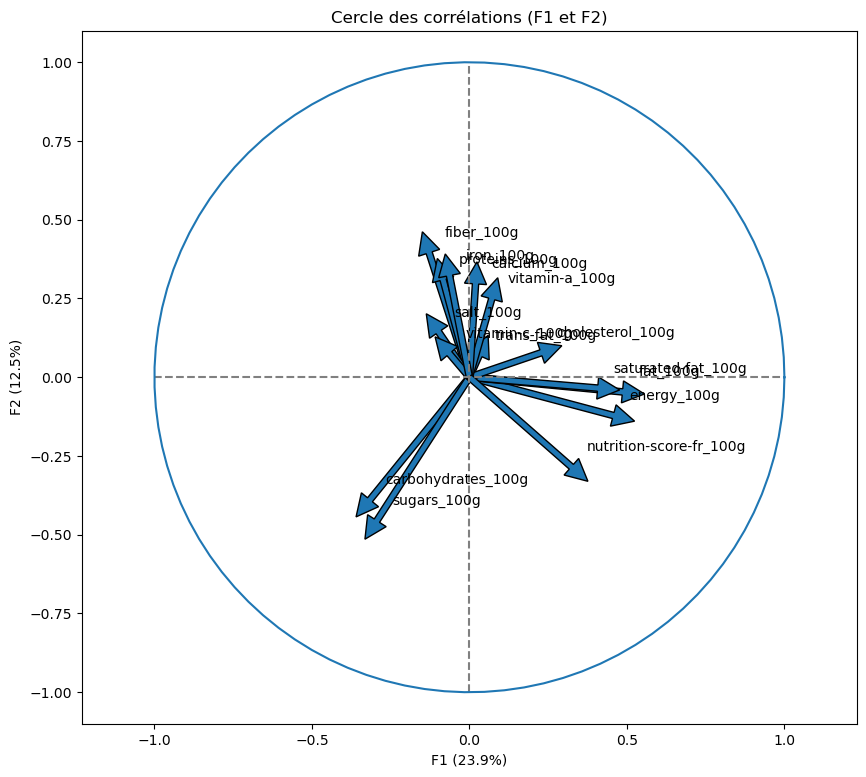

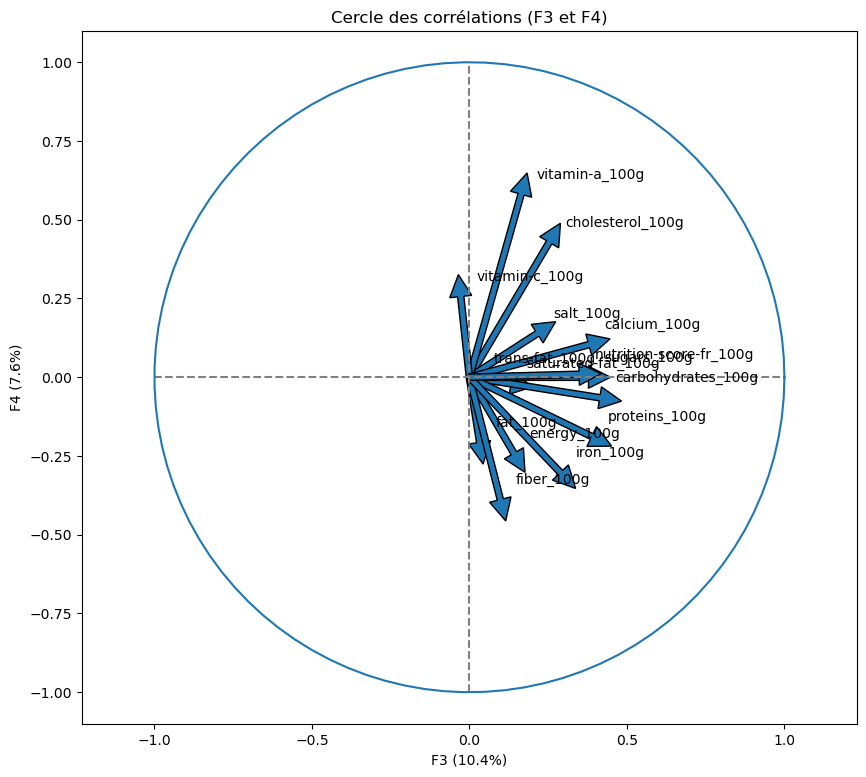

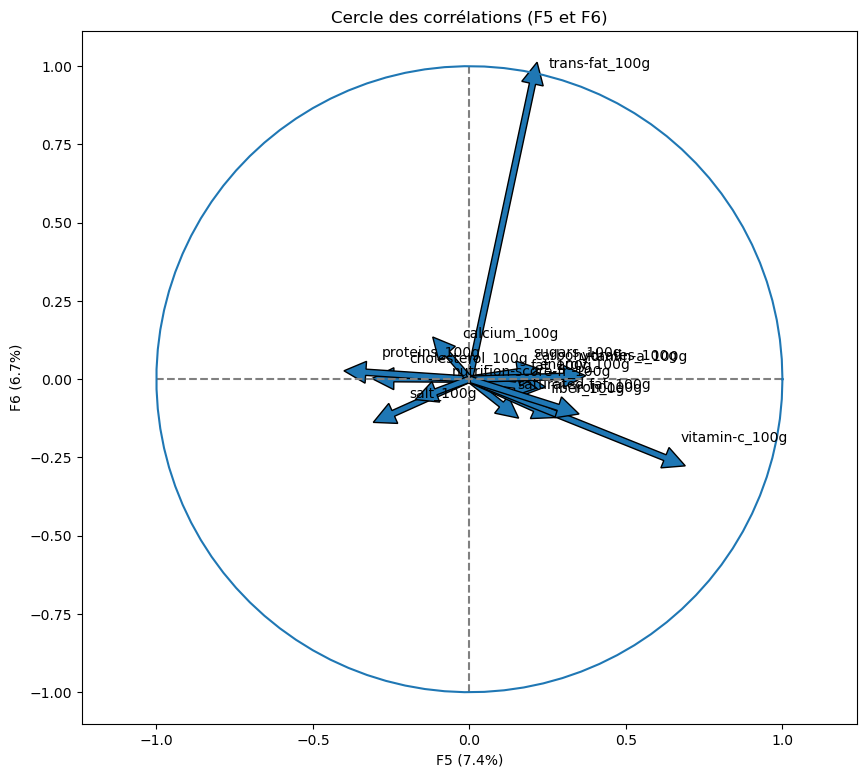

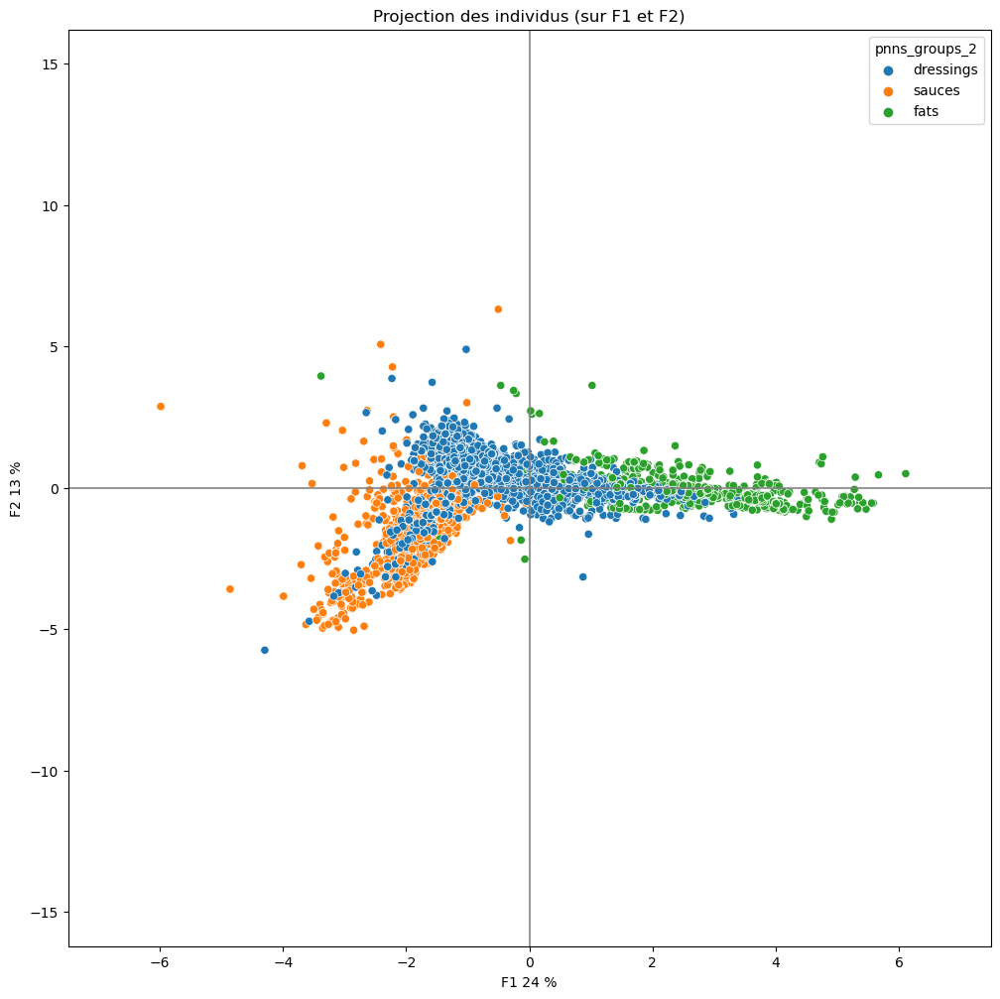

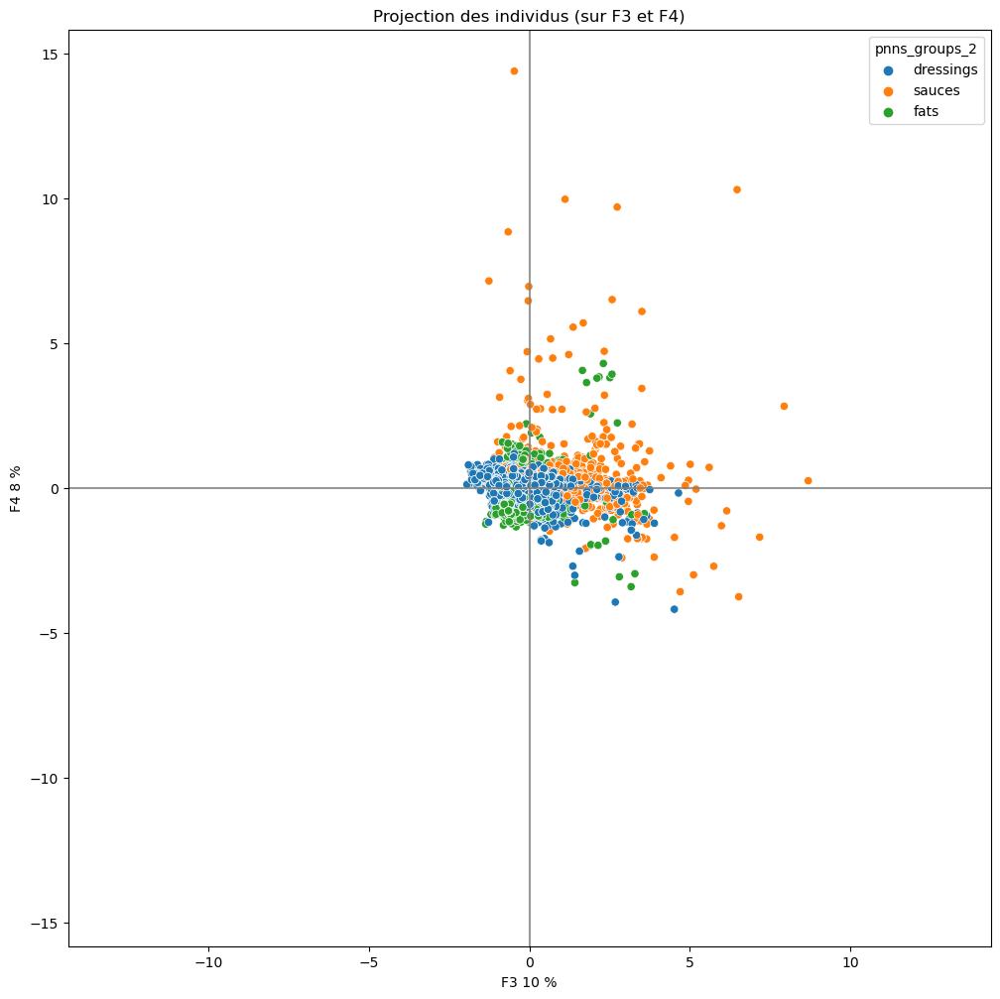

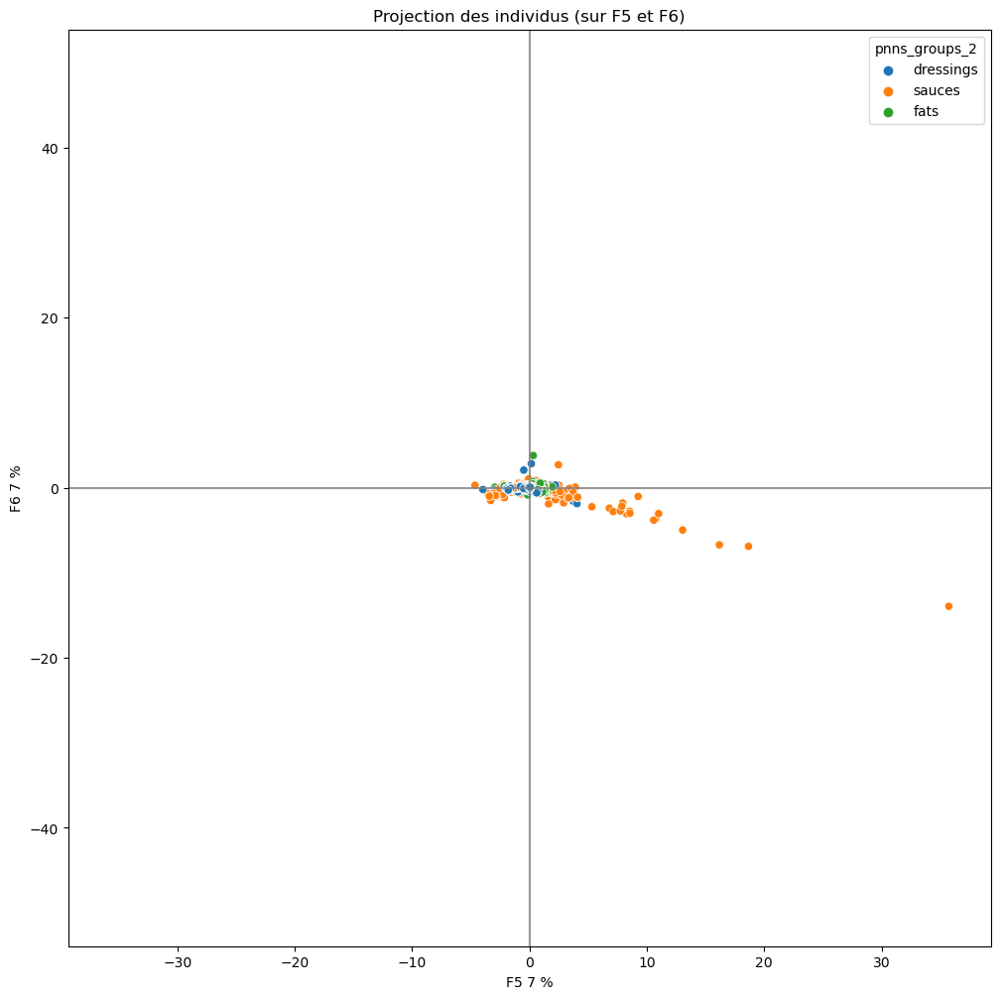

In [91]:
for pnns1 in data.loc[data["pnns_groups_1"].notnull(), "pnns_groups_1"].unique():
    print(pnns1)
    sous_data = data[data["pnns_groups_1"] == pnns1]
    ACP_generator(sous_data, "pnns_groups_2")

Les résultats de l'ACP montrent une meilleur séparation, mais qui pourrait encore être plus amélioré.

### <a name = "T4C10">10. pnns2 : remplissage par la méthode knn simple </a>

In [92]:
#On ne garde que les données ayant un pnns non nulle et informatif
dt = copy.deepcopy(data[(~data["pnns_groups_1"].isnull()) & (~data["pnns_groups_2"].isnull())])

In [93]:
#On ne garde que nos colonnes d'intérêts
dt_simple = dt[liste_feat_simple + ["pnns_groups_1"] + ["pnns_groups_2"]]

In [94]:
display(dt_simple.shape)

# On enlève les lignes  qui ne sont pas remplies à 100 %
dt_simple = dt_simple[dt_simple.isnull().sum(axis = 1) == 0]

display(dt_simple.shape)



(56481, 10)

(33401, 10)

On va regarder l'affiliation avec les éléments majeurs

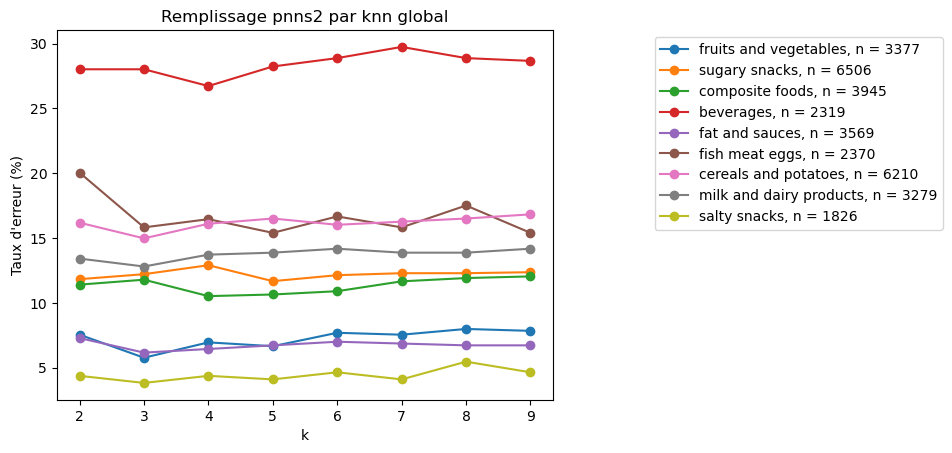

In [95]:
for pnns1 in dt_simple['pnns_groups_1'].unique():
    mask = dt_simple[dt_simple["pnns_groups_1"] == pnns1]
    
    xtrain, xtest, ytrain, ytest = train_test_split(mask[liste_feat_simple], mask['pnns_groups_2'], train_size=0.8)

    # on mesure le taux d'erreurs du modèle pour un knn de 2 à 10 
    errors = []
    for k in range(2, 10):
        knn = neighbors.KNeighborsClassifier(k)
        errors.append(100*(1 - knn.fit(xtrain, ytrain).score(xtest, ytest)))
    nb = mask.shape[0]
    plt.plot(range(2,10), errors, 'o-', label = pnns1 + ", n = " + str(nb))
   
plt.legend(loc="upper right", bbox_to_anchor = (1.8,1))

clear_output(wait=True)
plt.title("Remplissage pnns2 par knn global")
plt.xlabel("k")
plt.ylabel("Taux d'erreur (%)")
plt.show()

Fort taux d'erreur sur la méthode globale pour plusieurs des pnns1

Remplissage 1 à 1

array(['vegetables', 'fruits', 'dried fruits'], dtype=object)

vegetables 2 2123
vegetables 3 2123
vegetables 4 2123
vegetables 5 2123
vegetables 6 2123
vegetables 7 2123
vegetables 8 2123
vegetables 9 2123


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['vegetables', 'fruits', 'dried fruits'], dtype=object)

C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

fruits 2 967
fruits 3 967
fruits 4 967
fruits 5 967
fruits 6 967
fruits 7 967
fruits 8 967
fruits 9 967


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


array(['vegetables', 'fruits', 'dried fruits'], dtype=object)

C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

dried fruits 2 287
dried fruits 3 287
dried fruits 4 287
dried fruits 5 287
dried fruits 6 287
dried fruits 7 287
dried fruits 8 287
dried fruits 9 287


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


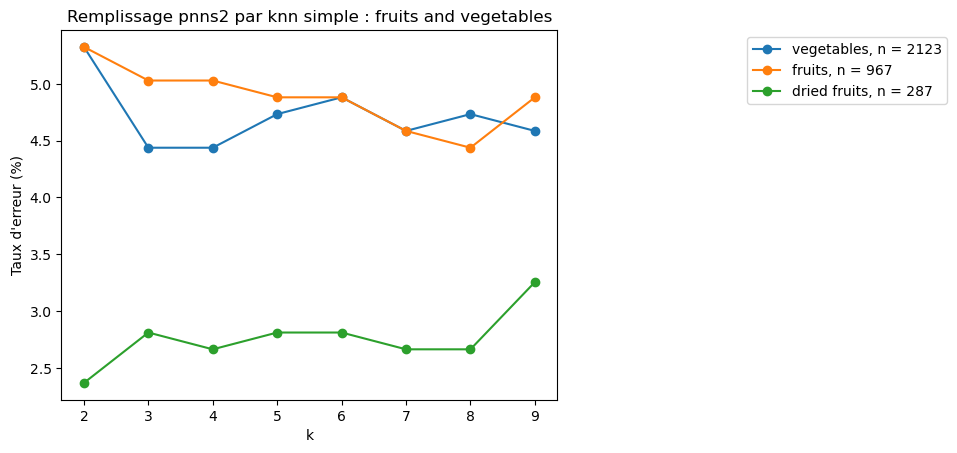

array(['biscuits and cakes', 'sweets', 'chocolate products'], dtype=object)

C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

biscuits and cakes 2 3106
biscuits and cakes 3 3106
biscuits and cakes 4 3106
biscuits and cakes 5 3106


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

biscuits and cakes 6 3106
biscuits and cakes 7 3106
biscuits and cakes 8 3106
biscuits and cakes 9 3106


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['biscuits and cakes', 'sweets', 'chocolate products'], dtype=object)

C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

sweets 2 1775
sweets 3 1775
sweets 4 1775
sweets 5 1775
sweets 6 1775


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

sweets 7 1775
sweets 8 1775
sweets 9 1775


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['biscuits and cakes', 'sweets', 'chocolate products'], dtype=object)

chocolate products 2 1625
chocolate products 3 1625


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

chocolate products 4 1625
chocolate products 5 1625


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

chocolate products 6 1625
chocolate products 7 1625
chocolate products 8 1625
chocolate products 9 1625


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

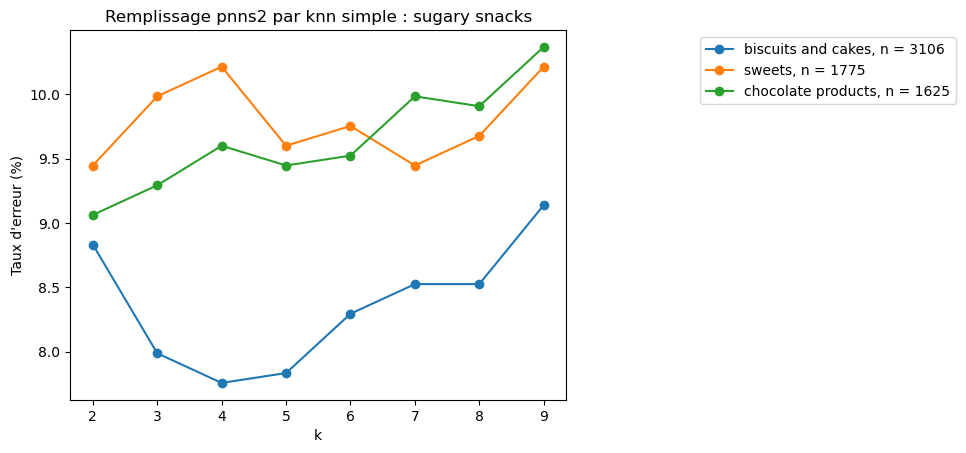

array(['pizza pies and quiche', 'one-dish meals', 'sandwich',
       'triple dishes'], dtype=object)

pizza pies and quiche 2 312
pizza pies and quiche 3 312
pizza pies and quiche 4 312
pizza pies and quiche 5 312
pizza pies and quiche 6 312
pizza pies and quiche 7 312
pizza pies and quiche 8 312


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pizza pies and quiche 9 312


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


array(['pizza pies and quiche', 'one-dish meals', 'sandwich',
       'triple dishes'], dtype=object)

one-dish meals 2 3281
one-dish meals 3 3281
one-dish meals 4 3281
one-dish meals 5 3281
one-dish meals 6 3281


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

one-dish meals 7 3281


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

one-dish meals 8 3281
one-dish meals 9 3281


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


array(['pizza pies and quiche', 'one-dish meals', 'sandwich',
       'triple dishes'], dtype=object)

sandwich 2 328
sandwich 3 328
sandwich 4 328


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

sandwich 5 328


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

sandwich 6 328
sandwich 7 328


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

sandwich 8 328
sandwich 9 328


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


array(['pizza pies and quiche', 'one-dish meals', 'sandwich',
       'triple dishes'], dtype=object)

triple dishes 2 24


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


triple dishes 3 24


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

triple dishes 4 24
triple dishes 5 24


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

triple dishes 6 24
triple dishes 7 24
triple dishes 8 24
triple dishes 9 24


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

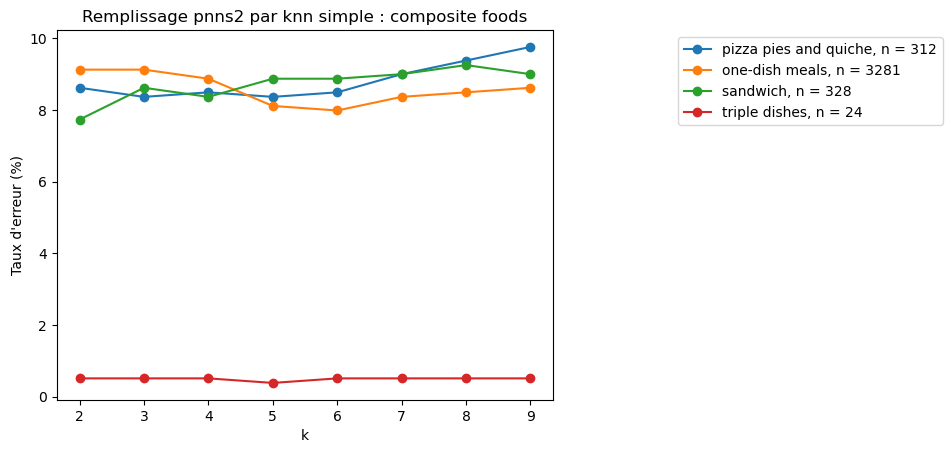

array(['sweetened beverages', 'non-sugared beverages',
       'artificially sweetened beverages'], dtype=object)

sweetened beverages 2 982
sweetened beverages 3 982
sweetened beverages 4 982
sweetened beverages 5 982
sweetened beverages 6 982
sweetened beverages 7 982
sweetened beverages 8 982
sweetened beverages 9 982


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['sweetened beverages', 'non-sugared beverages',
       'artificially sweetened beverages'], dtype=object)

non-sugared beverages 2 1182


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

non-sugared beverages 3 1182
non-sugared beverages 4 1182
non-sugared beverages 5 1182
non-sugared beverages 6 1182
non-sugared beverages 7 1182
non-sugared beverages 8 1182
non-sugared beverages 9 1182


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['sweetened beverages', 'non-sugared beverages',
       'artificially sweetened beverages'], dtype=object)

artificially sweetened beverages 2 155
artificially sweetened beverages 3 155


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

artificially sweetened beverages 4 155
artificially sweetened beverages 5 155
artificially sweetened beverages 6 155
artificially sweetened beverages 7 155
artificially sweetened beverages 8 155
artificially sweetened beverages 9 155


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

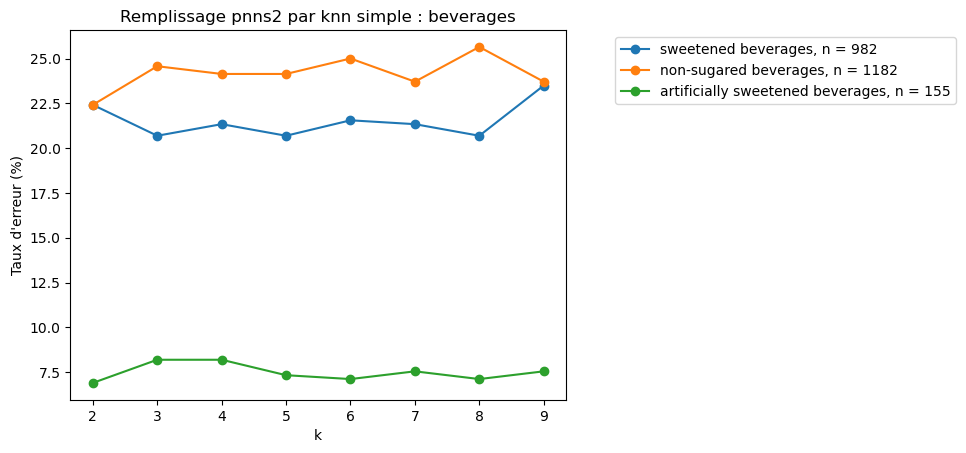

array(['sauces', 'fats', 'dressings'], dtype=object)

C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


sauces 2 1748
sauces 3 1748
sauces 4 1748
sauces 5 1748
sauces 6 1748
sauces 7 1748
sauces 8 1748
sauces 9 1748


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['sauces', 'fats', 'dressings'], dtype=object)

fats 2 535
fats 3 535
fats 4 535
fats 5 535
fats 6 535
fats 7 535
fats 8 535
fats 9 535


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['sauces', 'fats', 'dressings'], dtype=object)

dressings 2 1286
dressings 3 1286
dressings 4 1286
dressings 5 1286
dressings 6 1286
dressings 7 1286
dressings

C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

 8 1286
dressings 9 1286


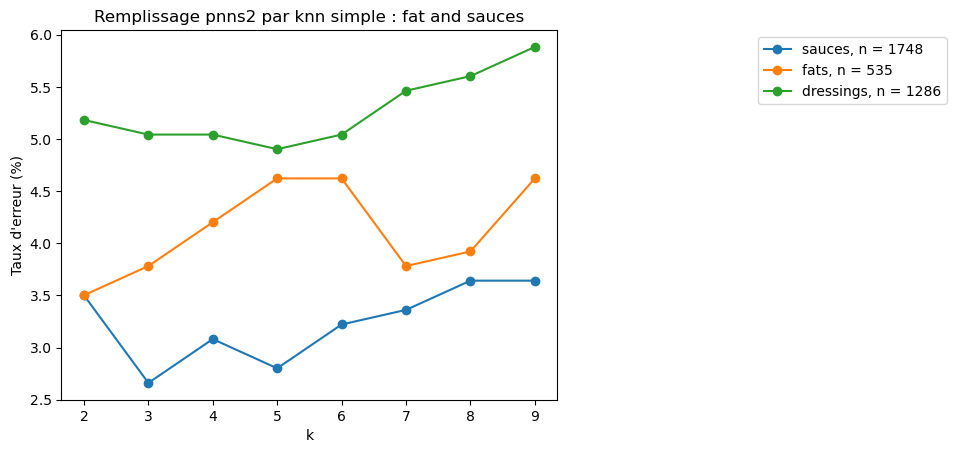

array(['raw_meat', 'eggs', 'processed meat'], dtype=object)

raw_meat 2 1387
raw_meat 3 1387
raw_meat 4 1387
raw_meat 5 1387
raw_meat 6 1387
raw_meat 7 1387
raw_meat 8 1387
raw_meat 9 1387


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['raw_meat', 'eggs', 'processed meat'], dtype=object)

eggs 2 89
eggs 3 89
eggs 4 89


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

eggs 5 89
eggs 6 89
eggs 7 89
eggs 8 89
eggs 9 89


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['raw_meat', 'eggs', 'processed meat'], dtype=object)

C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


processed meat 2 894
processed meat 3 894
processed meat 4 894
processed meat 5 894
processed meat 6 894
processed meat 7 894


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

processed meat 8 894
processed meat 9 894


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

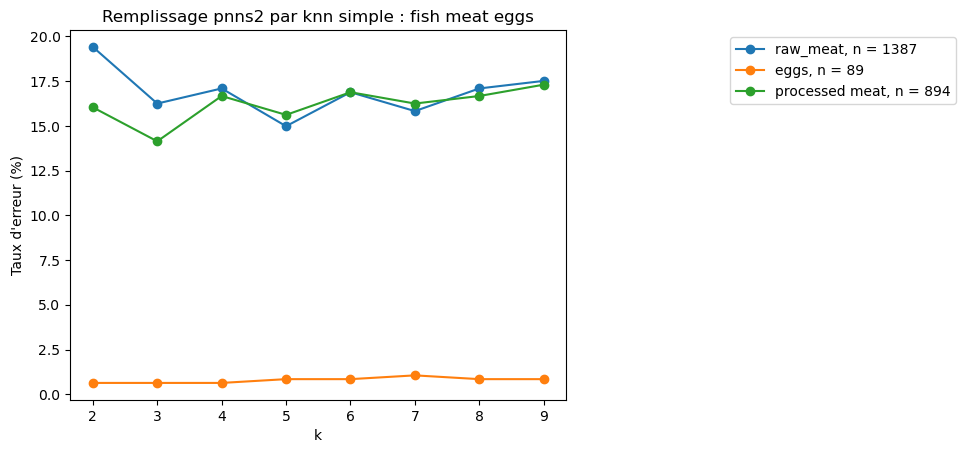

array(['cereals', 'bread', 'legumes', 'breakfast cereals', 'legumes-fat',
       'potatoes'], dtype=object)

cereals 2 2793
cereals 3 2793
cereals 4 2793
cereals 5 2793
cereals 6 2793


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

cereals 7 2793
cereals 8 2793
cereals 9 2793


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['cereals', 'bread', 'legumes', 'breakfast cereals', 'legumes-fat',
       'potatoes'], dtype=object)

bread 2 1380
bread 3 1380
bread 4 1380
bread 5 1380
bread 6 1380


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

bread 7 1380
bread 8 1380
bread 9 1380


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['cereals', 'bread', 'legumes', 'breakfast cereals', 'legumes-fat',
       'potatoes'], dtype=object)

legumes 2 495
legumes 3 495
legumes 4 495
legumes 5 495
legumes 6 495


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

legumes 7 495
legumes 8 495
legumes 9 495


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['cereals', 'bread', 'legumes', 'breakfast cereals', 'legumes-fat',
       'potatoes'], dtype=object)

breakfast cereals 2 1409


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


breakfast cereals 3 1409
breakfast cereals 4 1409
breakfast cereals 5 1409


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

breakfast cereals 6 1409
breakfast cereals 7 1409


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

breakfast cereals 8 1409
breakfast cereals 9 1409


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['cereals', 'bread', 'legumes', 'breakfast cereals', 'legumes-fat',
       'potatoes'], dtype=object)

legumes-fat 2 71
legumes-fat 3 71


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

legumes-fat 4 71
legumes-fat 5 71
legumes-fat 6 71


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

legumes-fat 7 71
legumes-fat 8 71


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


legumes-fat 9 71


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['cereals', 'bread', 'legumes', 'breakfast cereals', 'legumes-fat',
       'potatoes'], dtype=object)

potatoes 2 62


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

potatoes 3 62
potatoes 4 62
potatoes 5 62


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

potatoes 6 62


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

potatoes 7 62
potatoes 8 62
potatoes 9 62


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


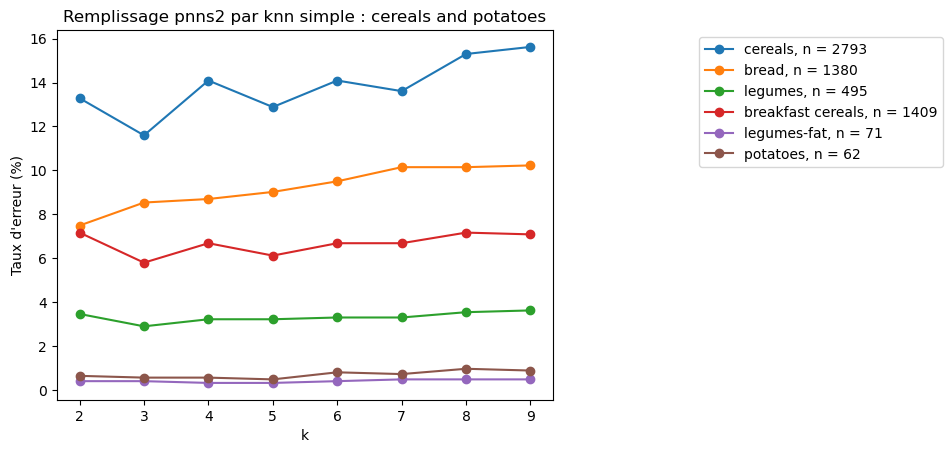

array(['milk and yogurt', 'cheese', 'dairy desserts-ice cream'],
      dtype=object)

milk and yogurt 2 1392
milk and yogurt 3 1392
milk and yogurt 4 1392
milk and yogurt 5 1392
milk and yogurt 6 1392
milk and yogurt 7 1392
milk and yogurt 8 1392
milk and yogurt 9 1392


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['milk and yogurt', 'cheese', 'dairy desserts-ice cream'],
      dtype=object)

cheese 2 1030
cheese 3 1030
cheese 4 1030
cheese 5 1030
cheese 6 1030
cheese 7 1030
cheese 8 1030
cheese 9 1030


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['milk and yogurt', 'cheese', 'dairy desserts-ice cream'],
      dtype=object)

dairy desserts-ice cream 2 857
dairy desserts-ice cream 3 857
dairy desserts-ice cream 4 857
dairy desserts-ice cream 5 857
dairy desserts-ice cream 6 857
dairy desserts-ice cream 7 857
dairy desserts-ice cream 8 857
dairy desserts-ice cream 9 857


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

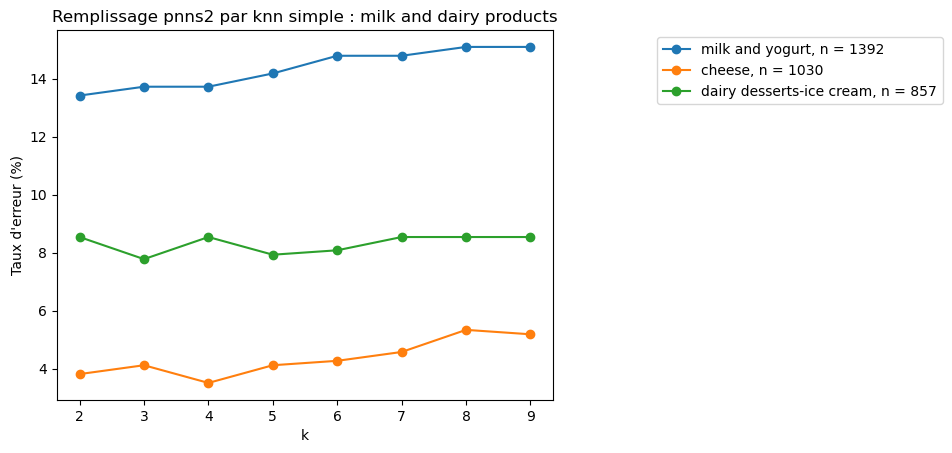

array(['nuts', 'appetizers', 'salty and fatty products'], dtype=object)

nuts 2 379
nuts 3 379
nuts 4 379
nuts 5 379
nuts 6 379
nuts 7 379
nuts 8 379
nuts 9 379


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['nuts', 'appetizers', 'salty and fatty products'], dtype=object)

appetizers 2 1429
appetizers 3 1429
appetizers 4 1429
appetizers 5 1429
appetizers 6 1429
appetizers 7 1429
appetizers 8 1429
appetizers 9 1429


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

array(['nuts', 'appetizers', 'salty and fatty products'], dtype=object)

salty and fatty products 2 18
salty and fatty products 3 18
salty and fatty products 4 18
salty and fatty products 5 18
salty and fatty products 6 18


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

salty and fatty products 7 18
salty and fatty products 8 18
salty and fatty products 9 18


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

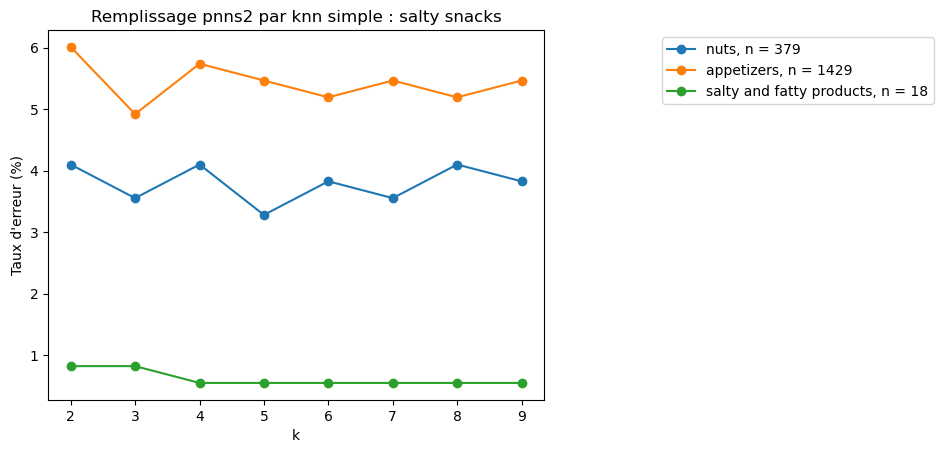

In [96]:
for pnns1 in dt_simple['pnns_groups_1'].unique():
    mask = dt_simple[dt_simple["pnns_groups_1"] == pnns1]
    for pnns2 in mask.pnns_groups_2.unique():
        mask2 = copy.deepcopy(mask)
        mask2.loc[mask2.pnns_groups_2 != pnns2, "pnns_groups_2"] = "Autre"
        display(mask.pnns_groups_2.unique())
        xtrain, xtest, ytrain, ytest = train_test_split(mask2[liste_feat_simple], mask2['pnns_groups_2'], train_size=0.8)
        nb = mask[mask['pnns_groups_2'] == pnns2].shape[0]
        errors = []
        for k in range(2, 10):
            print(pnns2, k, nb)
            knn = neighbors.KNeighborsClassifier(k)
            errors.append(100*(1 - knn.fit(xtrain, ytrain).score(xtest, ytest)))

        plt.plot(range(2,10), errors, 'o-', label = pnns2 + ", n = " + str(nb))    
    
    plt.legend(loc="upper right", bbox_to_anchor = (1.8,1))

    #clear_output(wait=True)
    plt.title("Remplissage pnns2 par knn simple : " + str(pnns1))
    plt.xlabel("k")
    plt.ylabel("Taux d'erreur (%)")
    plt.show()

Les catégories beverages et fish meat egg sont les plus compliquées à remplir.

La méthode de remplissage un à un génère moins d'erreurs néanmoins.

On verra si c'est améliorable, pour l'instant on va remplir de cette manière.

In [97]:
# On enlève les lignes où les features ne sont pas remplies à 100 %
condition1 = data[liste_feat_simple].isnull().sum(axis = 1) == 0

condition2 = data["pnns_groups_1"].notnull()

print("Le pnns2 peut être rempli sur", data[condition1 & condition2].shape[0], "produits sur un total de", data.shape[0])


Le pnns2 peut être rempli sur 180799 produits sur un total de 245871


In [98]:
## Fonction permettant de remplir le knn en plusieurs étapes et de récupérer le pourcentage d'erreur

def knn_pnns_Etapes_v3(df, liste_feat_simple, pnns):
    ## C'est à partir de l'étape 2 que nous remplissons le dataframe.
    ## Le pourcentage d'erreur à regarder est donc à cette étape
    
    df_originel = copy.deepcopy(df)
    
    # Première étape - affinage - simple# 
    print("Etape 1")
    dataframe_remplissage1 = remplissage_knn(df_originel, pnns, liste_feat_simple)

    # Seconde étape - remplissage - simple# 
    print("Etape 2")
    dataframe_remplissage2 = remplissage_knn(df.combine_first(dataframe_remplissage1), pnns, liste_feat_simple)
        
    # Troisième étape - remplissage global simple #
    print("Etape 3")
    dataframe_remplissage3 = remplissage_knn(df.combine_first(dataframe_remplissage2), pnns, liste_feat_simple, False)  
    
    # On complète df par les valeurs du dataframe 3
    df = df.combine_first(dataframe_remplissage3)
    
    ## On évalue le pourcentage d'erreur
    
    eval_erreur = [dataframe_remplissage1, dataframe_remplissage2, dataframe_remplissage3]
    
    for i, dataframes in enumerate(eval_erreur):
        pourcen = Pourcentage_Erreur(dataframes, df_originel, pnns)
        print("Etape n°:",i+1,"\tPourcentage d'erreur :", pourcen)
    
    
    ## On renvoie le df modifié et l'erreur associée au remplissage
    return df, Pourcentage_Erreur(dataframe_remplissage2, df_originel, pnns)
    

On appel la version 3 de notre fonction afin de remplir notre tableau de données.

On récupère le pourcentage d'erreur de remplissage du PNNS2.

On est en cours de remplissage des pnns2 compris dans sugary snacks
Etape 1
pnns_groups_2 :  biscuits and cakes
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  sweets
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  chocolate products
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

33358 lignes modifiées
Une prédiction a pu être réalisé sur 39864 produits

2063 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['biscuits and cakes', 8.371735791090629]\n", "['sweets', 11.213517665130567]\n", "['chocolate products', 9.984639016897079]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


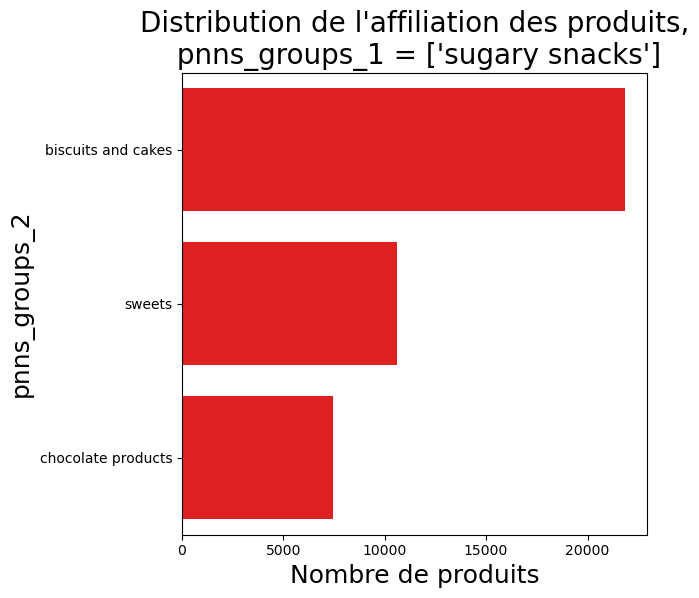

Etape 2
pnns_groups_2 :  biscuits and cakes
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  sweets
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  chocolate products
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

1323 lignes modifiées
Une prédiction a pu être réalisé sur 41394 produits

533 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['biscuits and cakes', 3.1690580162195836]\n", "['sweets', 3.4435433562071127]\n", "['chocolate products', 3.1191515907673106]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


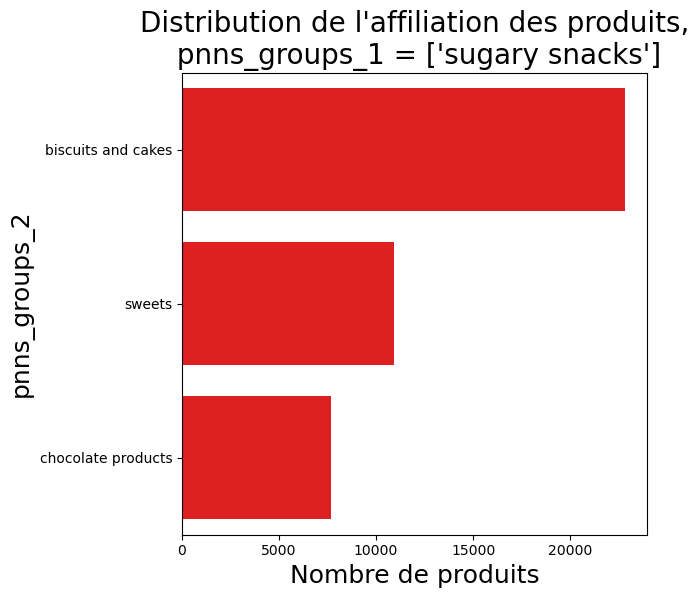

Etape 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

439 lignes modifiées
Une prédiction a pu être réalisé sur 41927 produits

0 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par sur training set : 3.7478910580862834
Etape n°: 1 	Pourcentage d'erreur : 7.731385934275282
Etape n°: 2 	Pourcentage d'erreur : 7.407985028072364
Etape n°: 3 	Pourcentage d'erreur : 8.284660313556717
On est en cours de remplissage des pnns2 compris dans cereals and potatoes
Etape 1
pnns_groups_2 :  cereals
1 / 6


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  bread
2 / 6


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  legumes
3 / 6


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  breakfast cereals
4 / 6


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  legumes-fat
5 / 6


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  potatoes
6 / 6


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

24236 lignes modifiées
Une prédiction a pu être réalisé sur 30446 produits

1450 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['cereals', 12.882447665056363]\n", "['bread', 7.4074074074074066]\n", "['legumes', 3.059581320450888]\n", "['breakfast cereals', 6.199677938808379]\n", "['legumes-fat', 0.24154589371980784]\n", "['potatoes', 1.046698872785834]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


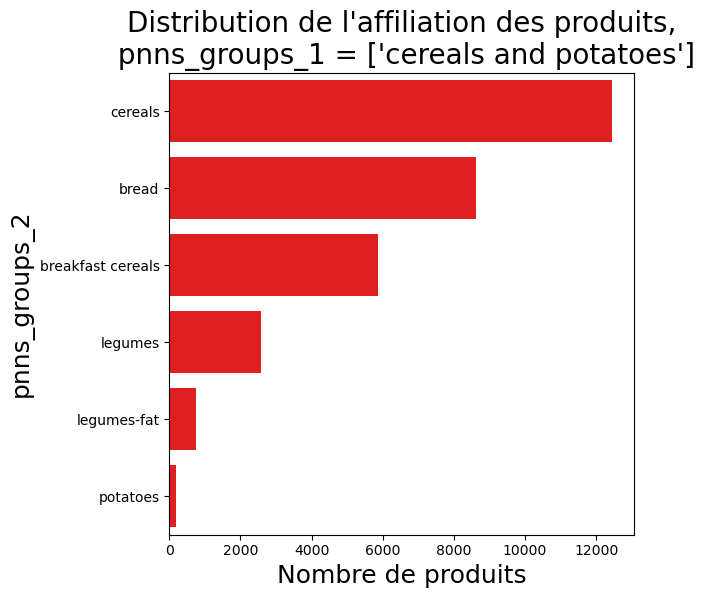

Etape 2
pnns_groups_2 :  breakfast cereals
1 / 6


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  cereals
2 / 6


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  bread
3 / 6


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  legumes
4 / 6


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  legumes-fat
5 / 6


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  potatoes
6 / 6


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

666 lignes modifiées
Une prédiction a pu être réalisé sur 31345 produits

551 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['breakfast cereals', 2.232724902216432]\n", "['cereals', 4.807692307692313]\n", "['bread', 3.3246414602346785]\n", "['legumes', 1.3037809647979182]\n", "['legumes-fat', 0.1792698826597161]\n", "['potatoes', 0.2933507170795324]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


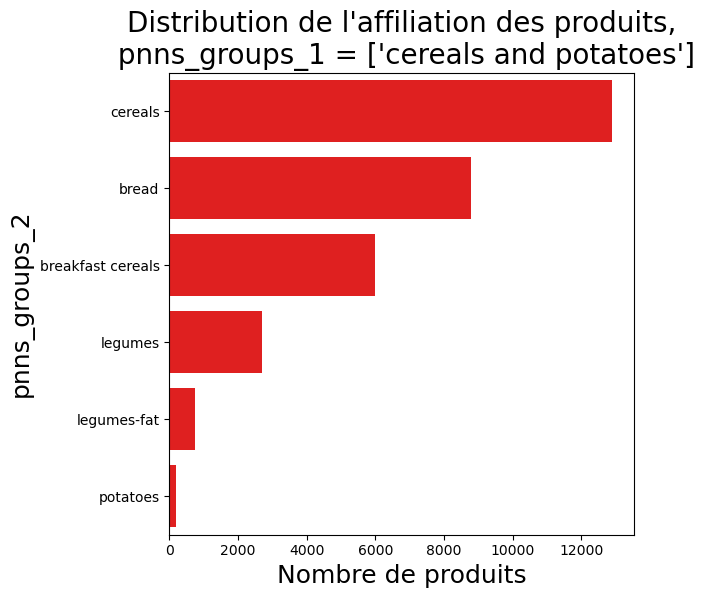

Etape 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

405 lignes modifiées
Une prédiction a pu être réalisé sur 31896 produits

0 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par sur training set : 4.159390379425309
Etape n°: 1 	Pourcentage d'erreur : 7.880207461937427
Etape n°: 2 	Pourcentage d'erreur : 7.767150395778365
Etape n°: 3 	Pourcentage d'erreur : 8.953301127214171
On est en cours de remplissage des pnns2 compris dans salty snacks
Etape 1
pnns_groups_2 :  nuts
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  appetizers
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  salty and fatty products
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

10596 lignes modifiées
Une prédiction a pu être réalisé sur 12422 produits

159 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['nuts', 4.6448087431694045]\n", "['appetizers', 3.551912568306015]\n", "['salty and fatty products', 0.2732240437158473]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


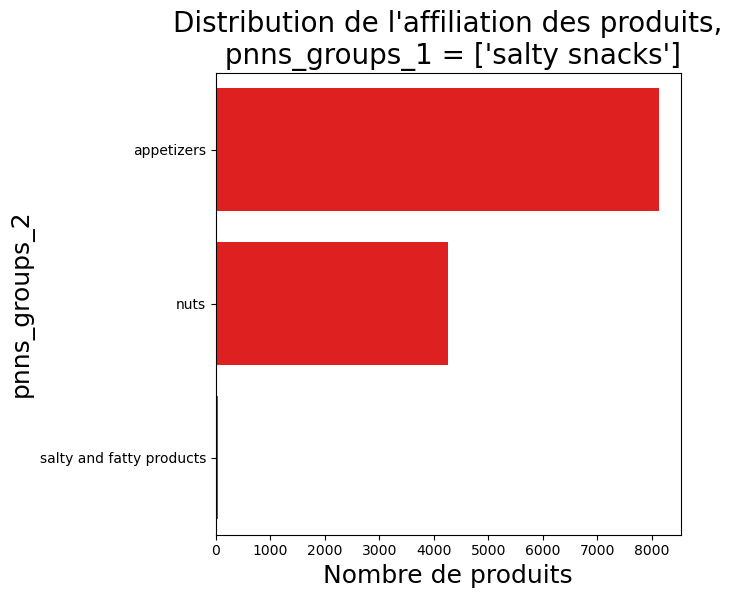

Etape 2
pnns_groups_2 :  nuts
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  appetizers
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  salty and fatty products
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

129 lignes modifiées
Une prédiction a pu être réalisé sur 12564 produits

17 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['nuts', 0.7237635705669487]\n", "['appetizers', 0.8443908323281013]\n", "['salty and fatty products', 0.12062726176115257]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


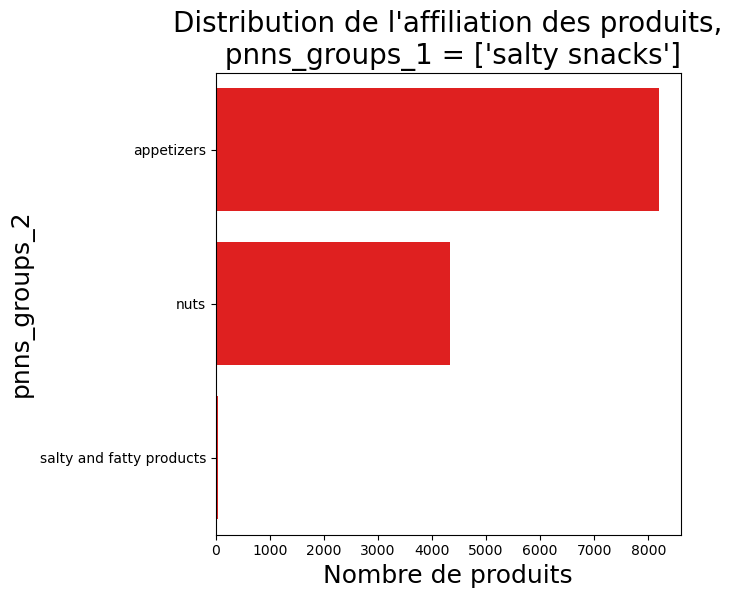

Etape 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

11 lignes modifiées
Une prédiction a pu être réalisé sur 12581 produits

0 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par sur training set : 0.8750994431185322
Etape n°: 1 	Pourcentage d'erreur : 2.7578599007170435
Etape n°: 2 	Pourcentage d'erreur : 2.7472527472527473
Etape n°: 3 	Pourcentage d'erreur : 3.1763417305585984
On est en cours de remplissage des pnns2 compris dans fish meat eggs
Etape 1
pnns_groups_2 :  raw_meat
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  eggs
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  processed meat
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

11290 lignes modifiées
Une prédiction a pu être réalisé sur 13660 produits

286 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['raw_meat', 15.822784810126578]\n", "['eggs', 1.0548523206751037]\n", "['processed meat', 17.08860759493671]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


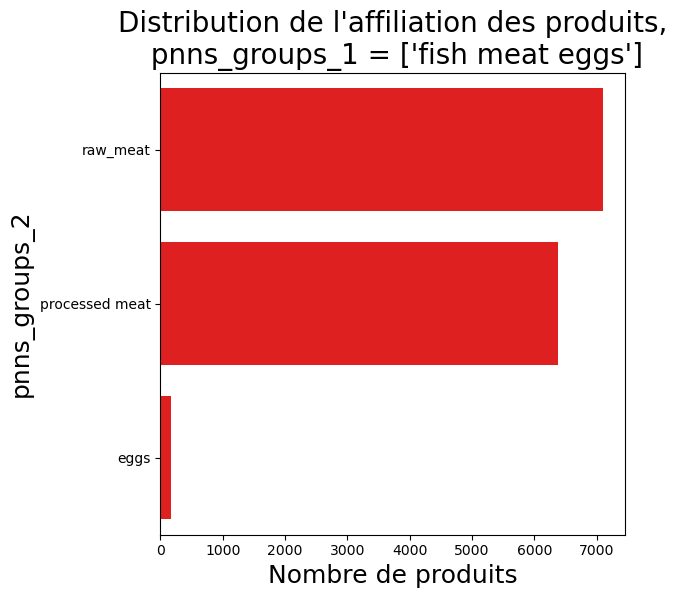

Etape 2
pnns_groups_2 :  processed meat
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  raw_meat
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  eggs
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

90 lignes modifiées
Une prédiction a pu être réalisé sur 13806 produits

140 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['processed meat', 5.174927113702621]\n", "['raw_meat', 4.701166180758021]\n", "['eggs', 0.1457725947521915]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


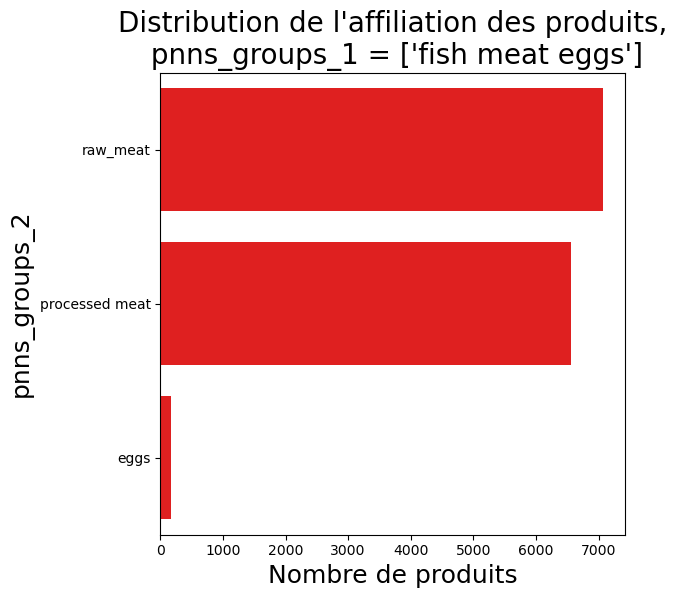

Etape 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

107 lignes modifiées
Une prédiction a pu être réalisé sur 13946 produits

0 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par sur training set : 3.576589595375723
Etape n°: 1 	Pourcentage d'erreur : 9.248055315471046
Etape n°: 2 	Pourcentage d'erreur : 8.172871202396234
Etape n°: 3 	Pourcentage d'erreur : 8.987341772151899
On est en cours de remplissage des pnns2 compris dans fruits and vegetables
Etape 1
pnns_groups_2 :  vegetables
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  fruits
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  dried fruits
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

10004 lignes modifiées
Une prédiction a pu être réalisé sur 13381 produits

85 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['vegetables', 3.2544378698224907]\n", "['fruits', 3.698224852071008]\n", "['dried fruits', 3.402366863905326]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


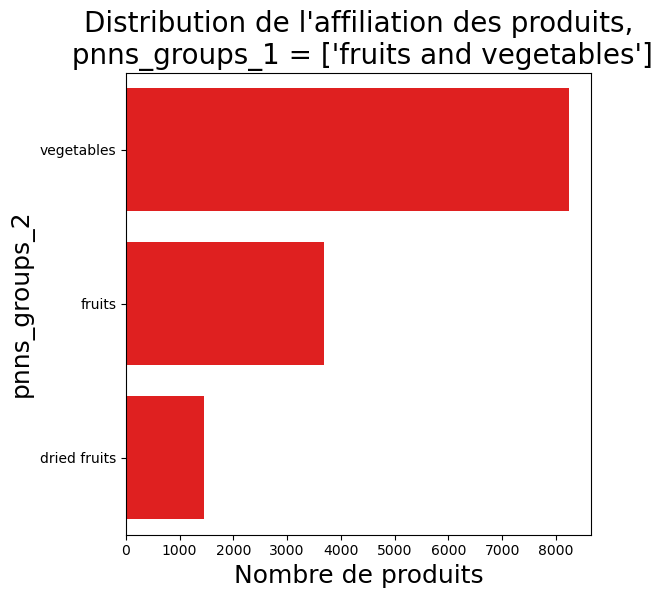

Etape 2
pnns_groups_2 :  dried fruits
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  vegetables
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  fruits
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

10 lignes modifiées
Une prédiction a pu être réalisé sur 13421 produits

45 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['dried fruits', 0.7081625046589601]\n", "['vegetables', 1.1926947446887826]\n", "['fruits', 1.5281401416325058]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


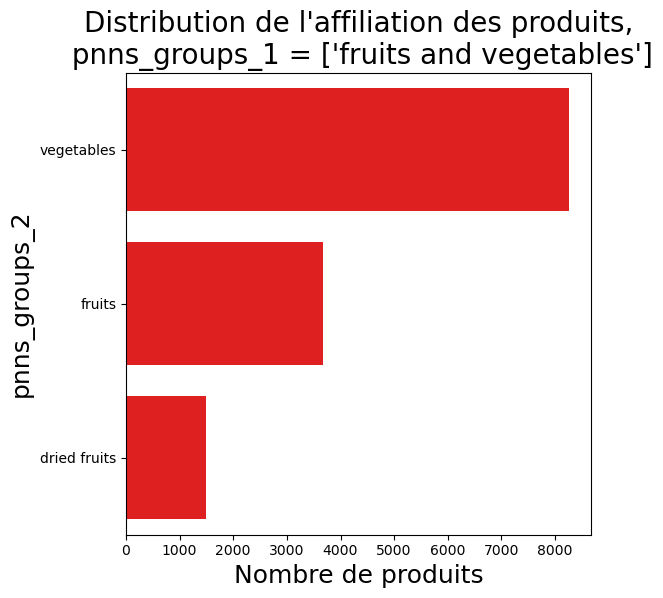

Etape 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

9 lignes modifiées
Une prédiction a pu être réalisé sur 13466 produits

0 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par sur training set : 2.0059435364041645
Etape n°: 1 	Pourcentage d'erreur : 3.4359127576934565
Etape n°: 2 	Pourcentage d'erreur : 3.3822208919485184
Etape n°: 3 	Pourcentage d'erreur : 4.293751850755108
On est en cours de remplissage des pnns2 compris dans composite foods
Etape 1
pnns_groups_2 :  pizza pies and quiche
1 / 4


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  one-dish meals
2 / 4


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  sandwich
3 / 4


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  triple dishes
4 / 4


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

15382 lignes modifiées
Une prédiction a pu être réalisé sur 19327 produits

1163 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['pizza pies and quiche', 7.984790874524716]\n", "['one-dish meals', 8.871989860583017]\n", "['sandwich', 9.125475285171103]\n", "['triple dishes', 0.38022813688213253]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


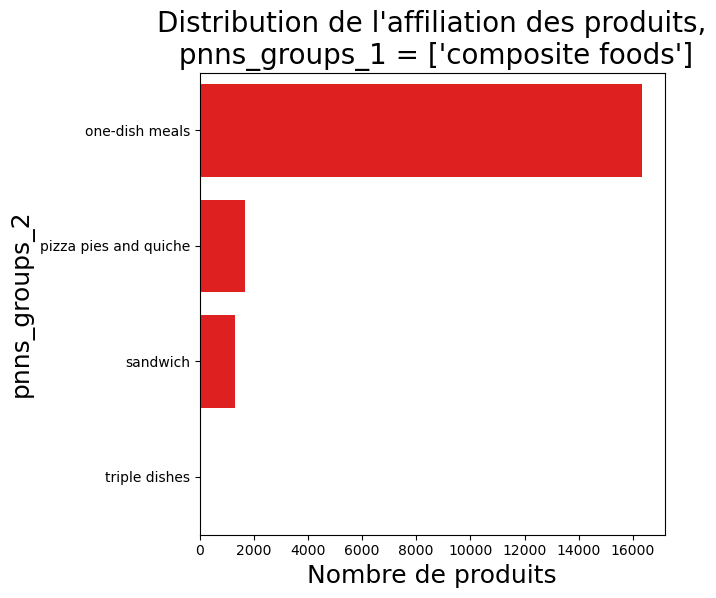

Etape 2
pnns_groups_2 :  pizza pies and quiche
1 / 4


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  one-dish meals
2 / 4


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  sandwich
3 / 4


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  triple dishes
4 / 4


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

626 lignes modifiées
Une prédiction a pu être réalisé sur 20108 produits

382 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['pizza pies and quiche', 2.771362586605086]\n", "['one-dish meals', 3.3102386451116295]\n", "['sandwich', 3.002309468822173]\n", "['triple dishes', 0.12830382345393465]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


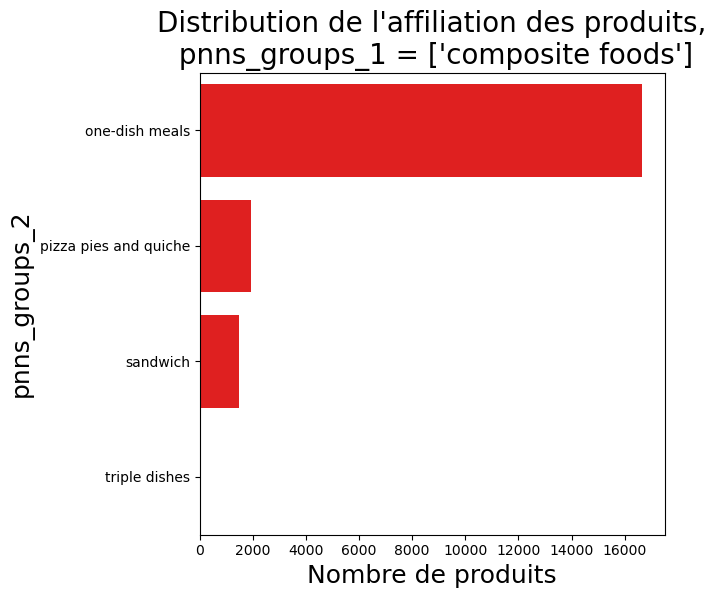

Etape 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

315 lignes modifiées
Une prédiction a pu être réalisé sur 20490 produits

0 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par sur training set : 3.7174721189591087
Etape n°: 1 	Pourcentage d'erreur : 6.174142480211082
Etape n°: 2 	Pourcentage d'erreur : 6.343476018566271
Etape n°: 3 	Pourcentage d'erreur : 6.844106463878327
On est en cours de remplissage des pnns2 compris dans milk and dairy products
Etape 1
pnns_groups_2 :  milk and yogurt
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  cheese
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  dairy desserts-ice cream
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

19160 lignes modifiées
Une prédiction a pu être réalisé sur 22439 produits

612 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['milk and yogurt', 10.97560975609756]\n", "['cheese', 5.640243902439024]\n", "['dairy desserts-ice cream', 8.536585365853655]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


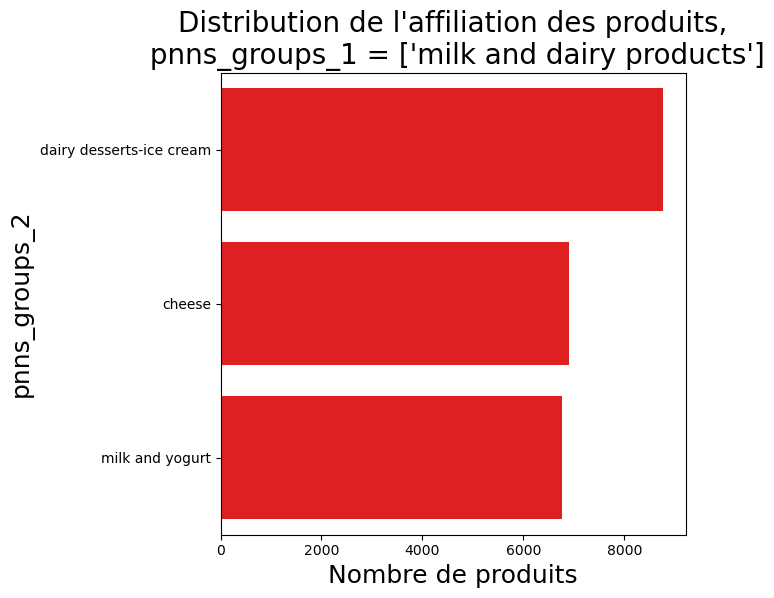

Etape 2
pnns_groups_2 :  dairy desserts-ice cream
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  cheese
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  milk and yogurt
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

386 lignes modifiées
Une prédiction a pu être réalisé sur 22910 produits

141 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['dairy desserts-ice cream', 2.352941176470591]\n", "['cheese', 0.8879023307436174]\n", "['milk and yogurt', 2.6859045504994405]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


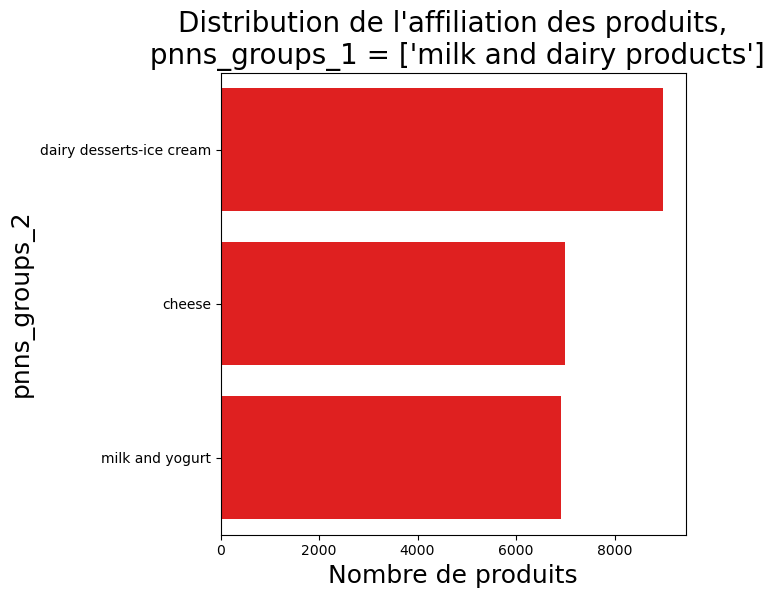

Etape 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

106 lignes modifiées
Une prédiction a pu être réalisé sur 23051 produits

0 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par sur training set : 2.397036391370666
Etape n°: 1 	Pourcentage d'erreur : 6.950532247964934
Etape n°: 2 	Pourcentage d'erreur : 6.504315659679408
Etape n°: 3 	Pourcentage d'erreur : 7.4412930771576695
On est en cours de remplissage des pnns2 compris dans beverages
Etape 1
pnns_groups_2 :  sweetened beverages
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  non-sugared beverages
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  artificially sweetened beverages
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

10260 lignes modifiées
Une prédiction a pu être réalisé sur 12579 produits

698 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['sweetened beverages', 20.905172413793103]\n", "['non-sugared beverages', 24.56896551724138]\n", "['artificially sweetened beverages', 8.836206896551724]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


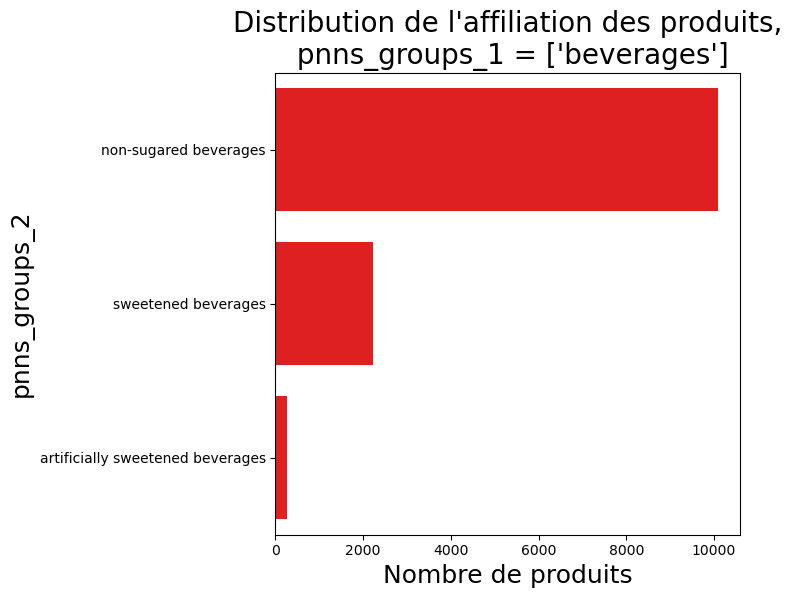

Etape 2
pnns_groups_2 :  sweetened beverages
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  artificially sweetened beverages
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  non-sugared beverages
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

362 lignes modifiées
Une prédiction a pu être réalisé sur 13093 produits

184 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['sweetened beverages', 5.182567726737341]\n", "['artificially sweetened beverages', 1.609736945425988]\n", "['non-sugared beverages', 6.085590891244596]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


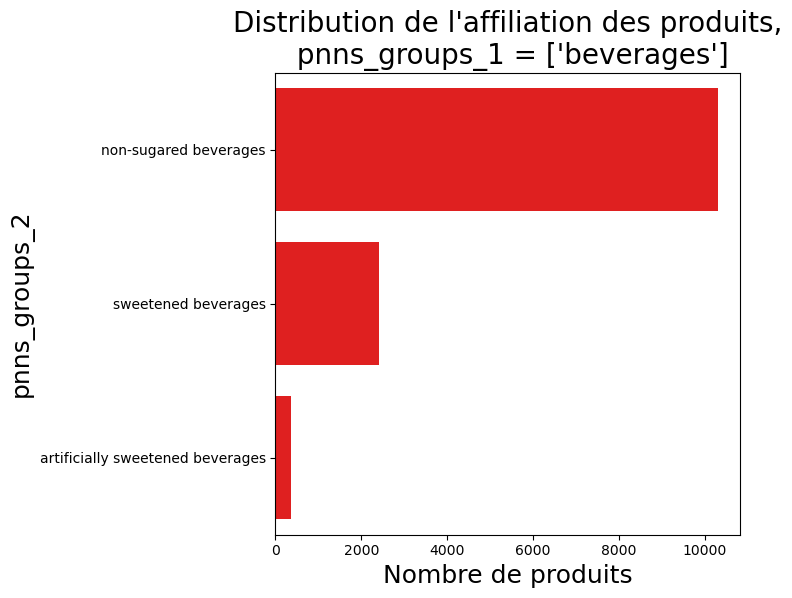

Etape 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

83 lignes modifiées
Une prédiction a pu être réalisé sur 13277 produits

0 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par sur training set : 4.547176960970067
Etape n°: 1 	Pourcentage d'erreur : 14.628518689432395
Etape n°: 2 	Pourcentage d'erreur : 14.923354373309289
Etape n°: 3 	Pourcentage d'erreur : 16.257007330746013
On est en cours de remplissage des pnns2 compris dans fat and sauces
Etape 1
pnns_groups_2 :  sauces
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  fats
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  dressings
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

6446 lignes modifiées
Une prédiction a pu être réalisé sur 10015 produits

150 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['sauces', 2.3809523809523836]\n", "['fats', 3.221288515406162]\n", "['dressings', 4.761904761904767]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


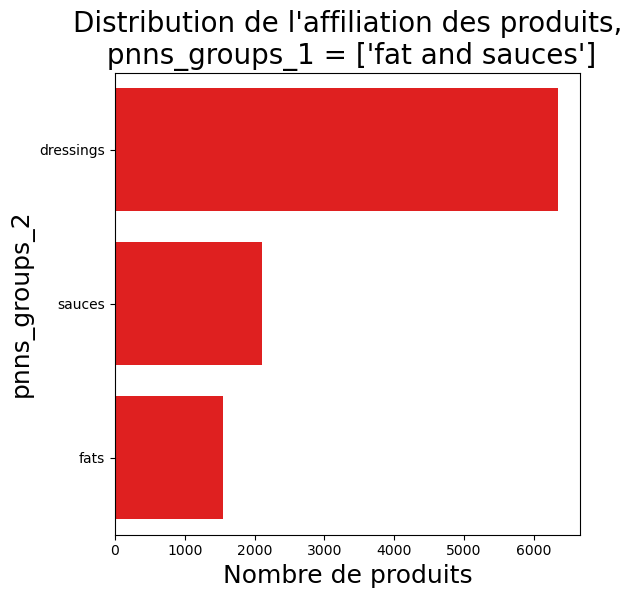

Etape 2
pnns_groups_2 :  dressings
1 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  fats
2 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

pnns_groups_2 :  sauces
3 / 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

85 lignes modifiées
Une prédiction a pu être réalisé sur 10126 produits

39 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par pnns_groups_2 sur training set :
["['dressings', 2.1403683424589315]\n", "['fats', 1.7421602787456414]\n", "['sauces', 0.9457441513190612]\n"]
pnns_groups_2 a cette distribution suivante au sein des échantillons


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\2572055600.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[type_pnns] = pd.Series(dict_lookup)


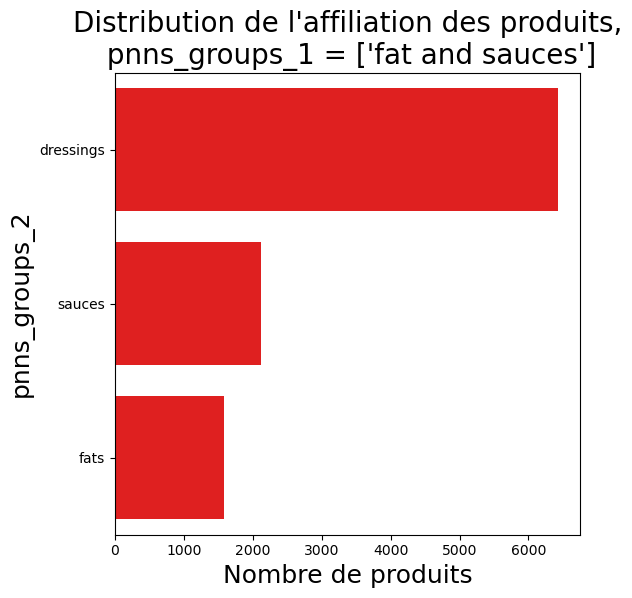

Etape 3


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

22 lignes modifiées
Une prédiction a pu être réalisé sur 10165 produits

0 produits n'ont donc pas d'affiliation

Pourcentage d'erreur par sur training set : 1.8235584031542684
Etape n°: 1 	Pourcentage d'erreur : 3.2176121930567314
Etape n°: 2 	Pourcentage d'erreur : 3.125
Etape n°: 3 	Pourcentage d'erreur : 3.4183244606332304


In [99]:
# Liste permettant de garder le % d'erreur par PNNS1
erreur_pnns = []

# On parcours les pnns1, on remplis les pnns2 de chaque catégorie
for pnns1 in data.loc[condition2, "pnns_groups_1"].unique():
    print("On est en cours de remplissage des pnns2 compris dans", pnns1)
    
    # Mask contenant le slice pnns1
    mask = data[data.pnns_groups_1 == pnns1]
    
    # On récupère le dataframe de sorti et % d'errreur
    data_remplissage, erreur = knn_pnns_Etapes_v3(mask, liste_feat_simple, "pnns_groups_2")
    
    # On combine les données déjà comprises dans data avec les nouvelles 
    data = data.combine_first(data_remplissage)
    
    # On ajoute à la liste le %d'erreur associé au pnns1 (ie : bon remplissage des pnns2 ?)
    erreur_pnns.append([pnns1, erreur])

pnns_groups_2 a cette distribution suivante au sein des échantillons


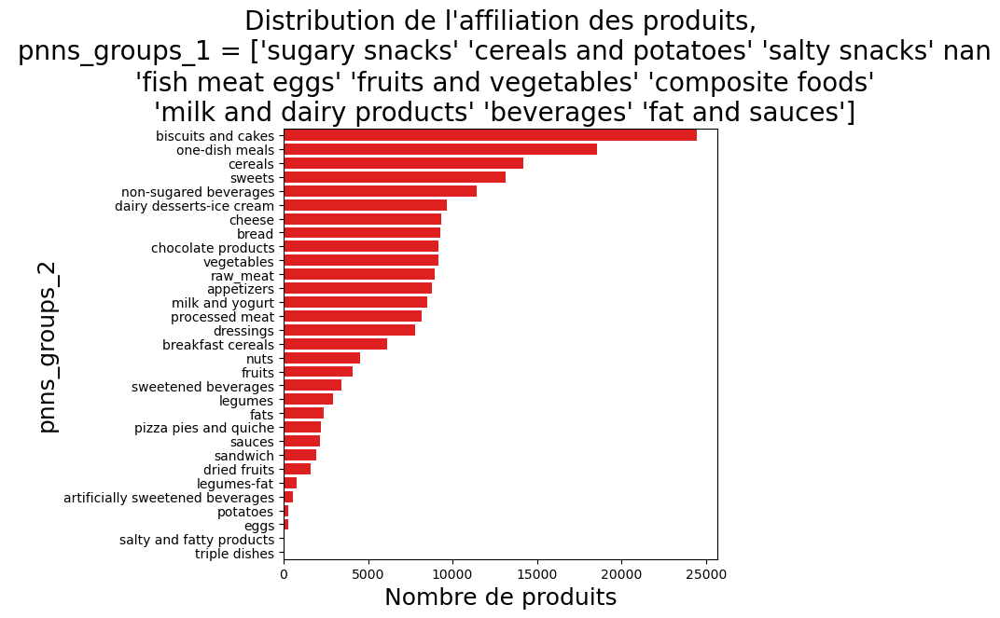

In [100]:
# Distribution par pnns2
distribution_pnns(data, "pnns_groups_2")

pnns_groups_2 a cette distribution suivante au sein des échantillons


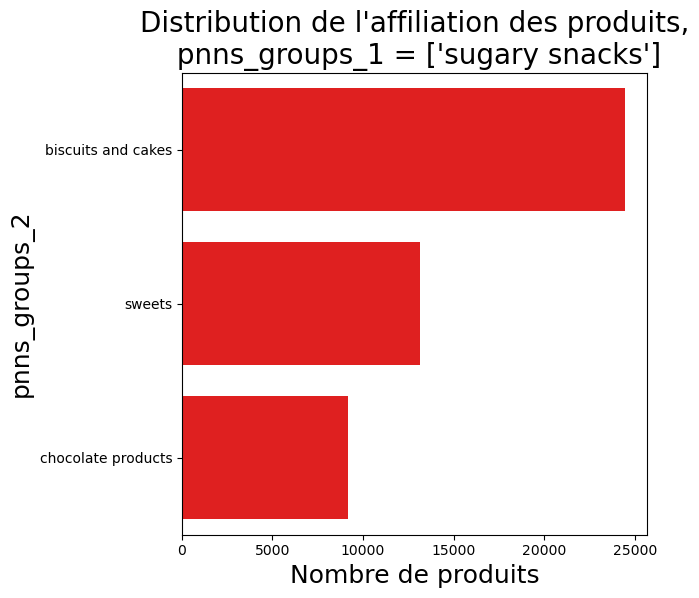

pnns_groups_2 a cette distribution suivante au sein des échantillons


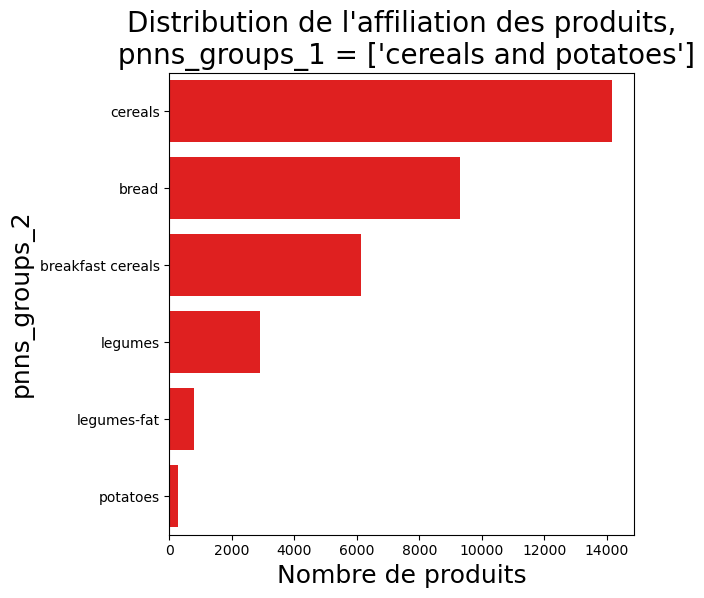

pnns_groups_2 a cette distribution suivante au sein des échantillons


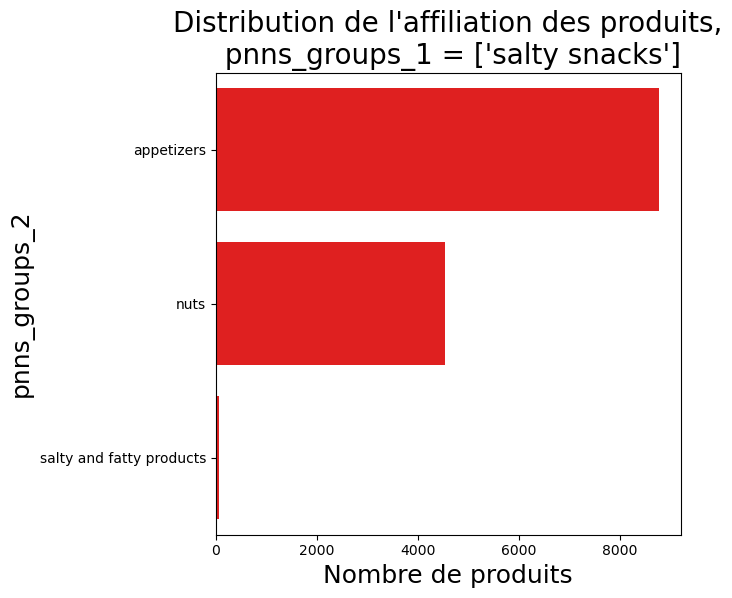

pnns_groups_2 a cette distribution suivante au sein des échantillons


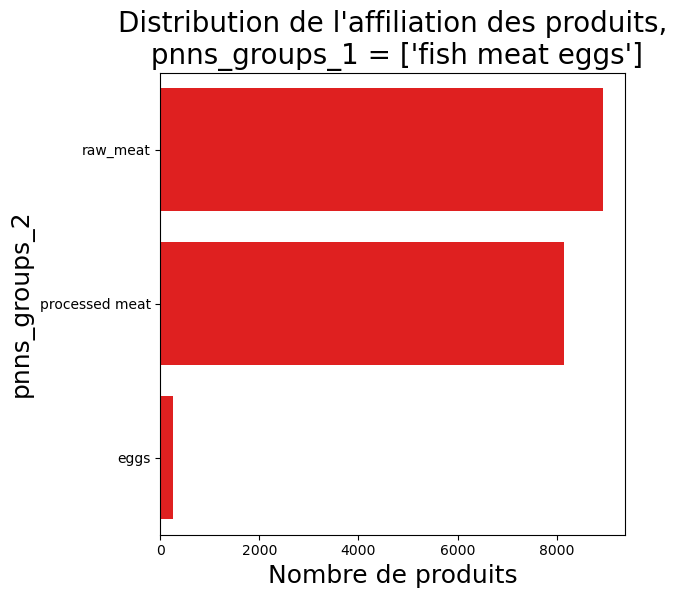

pnns_groups_2 a cette distribution suivante au sein des échantillons


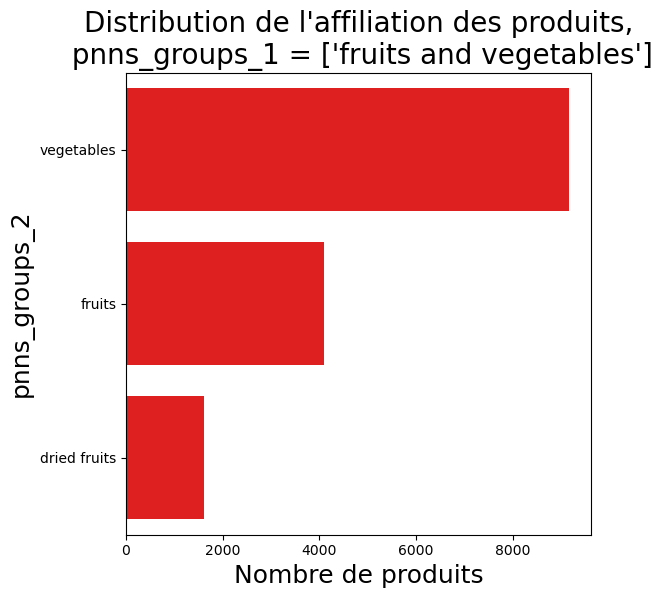

pnns_groups_2 a cette distribution suivante au sein des échantillons


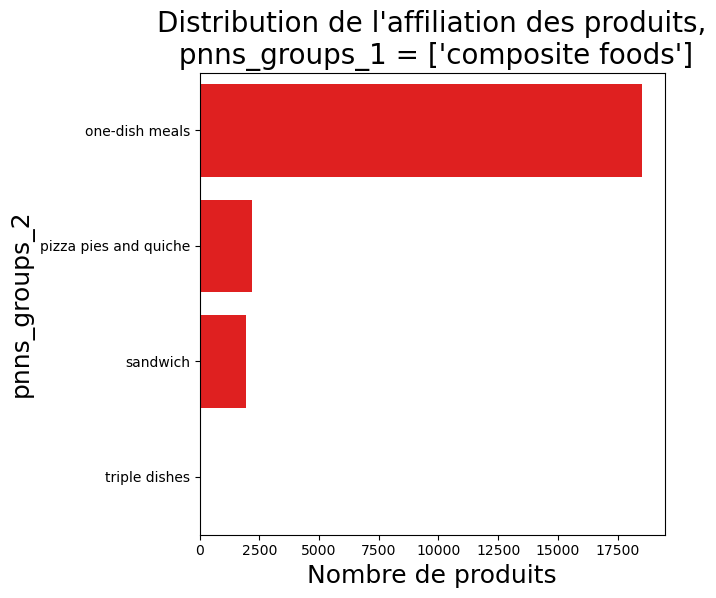

pnns_groups_2 a cette distribution suivante au sein des échantillons


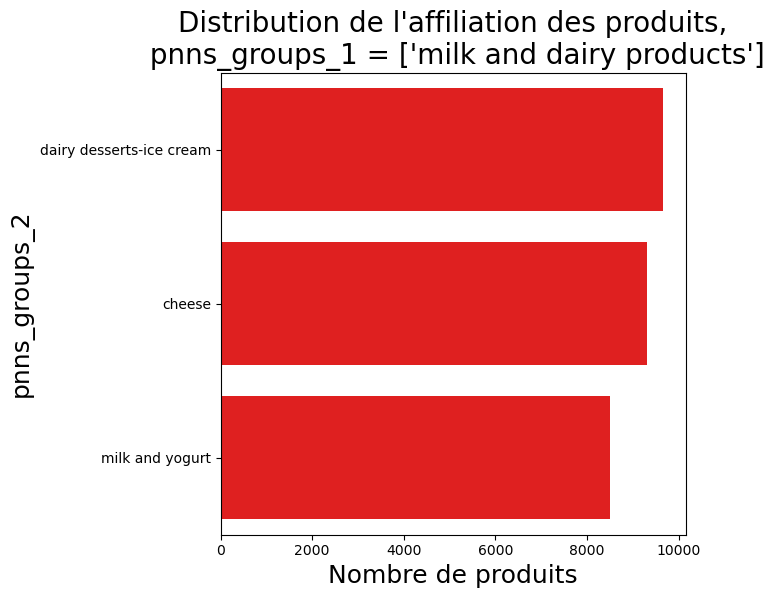

pnns_groups_2 a cette distribution suivante au sein des échantillons


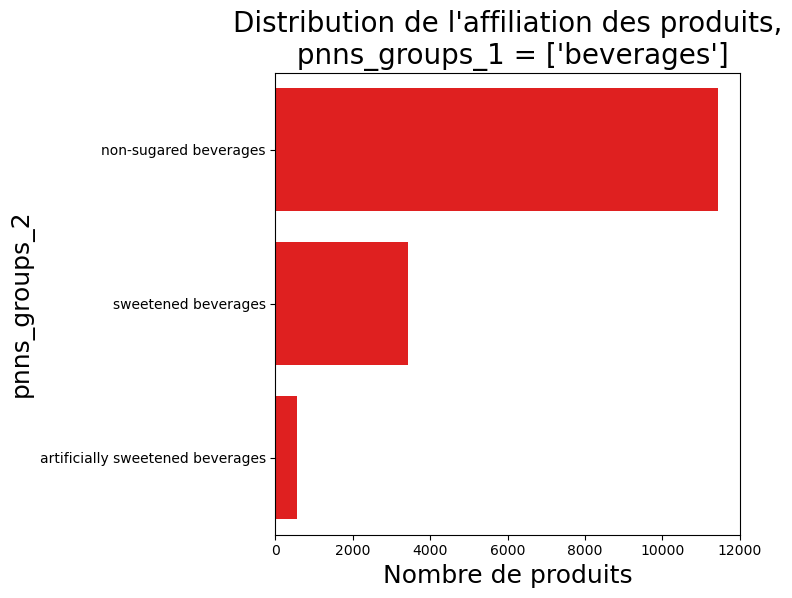

pnns_groups_2 a cette distribution suivante au sein des échantillons


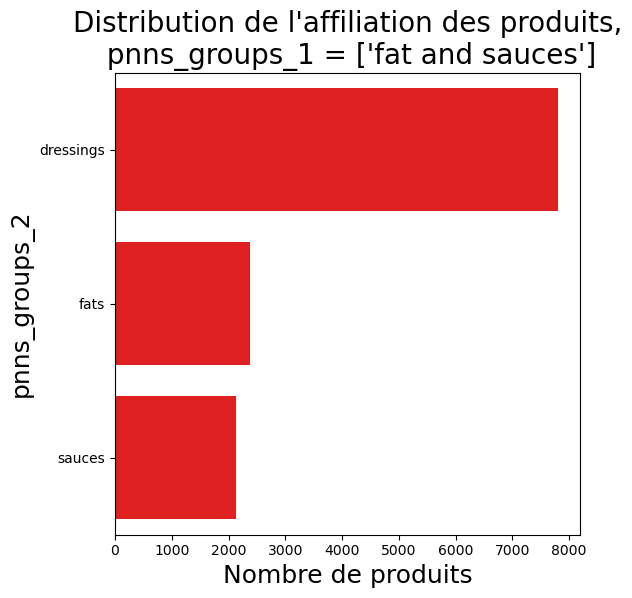

In [101]:
# Distribution pnns2 par pnns1
for pnns1 in data.loc[data["pnns_groups_1"].notnull(), "pnns_groups_1"].unique():
    distribution_pnns(data[data["pnns_groups_1"] == pnns1], "pnns_groups_2")
    

sugary snacks


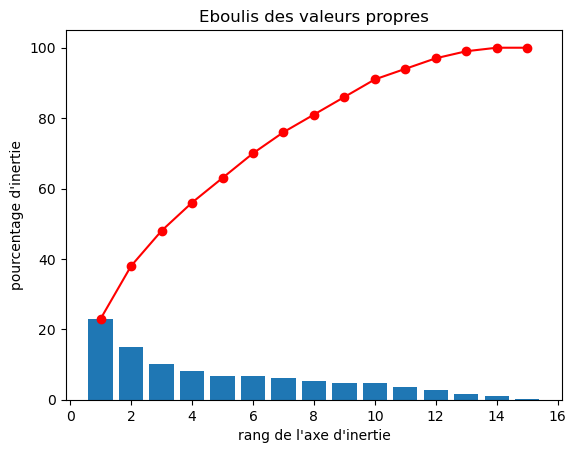

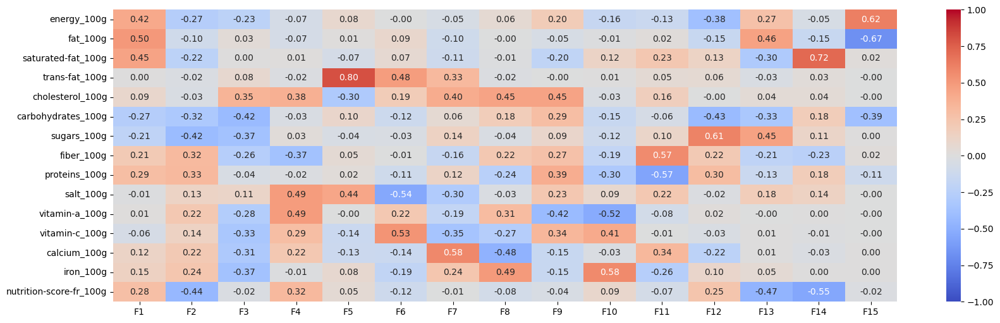

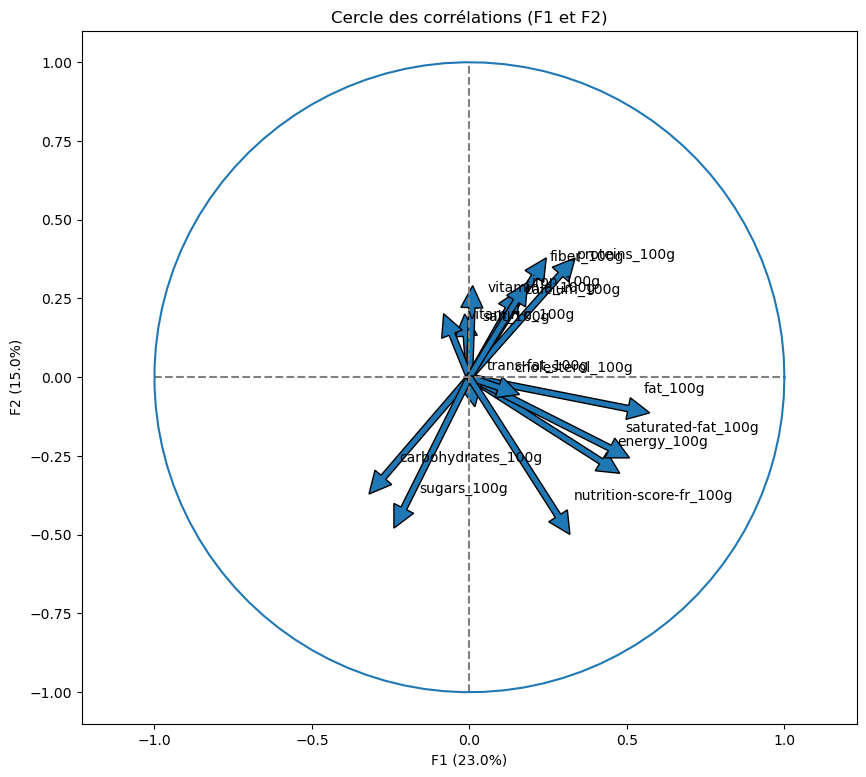

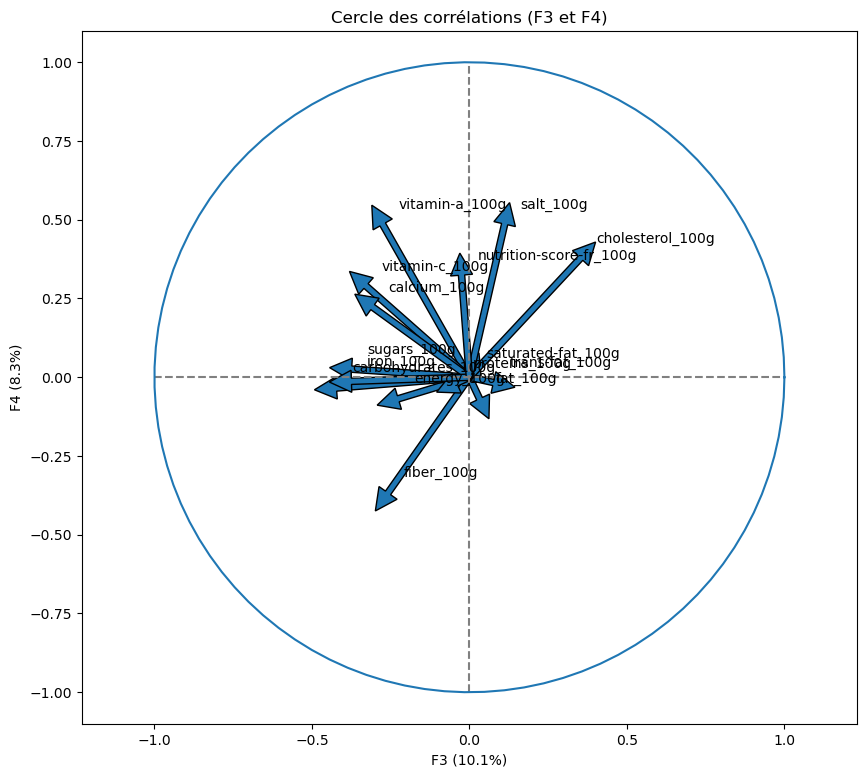

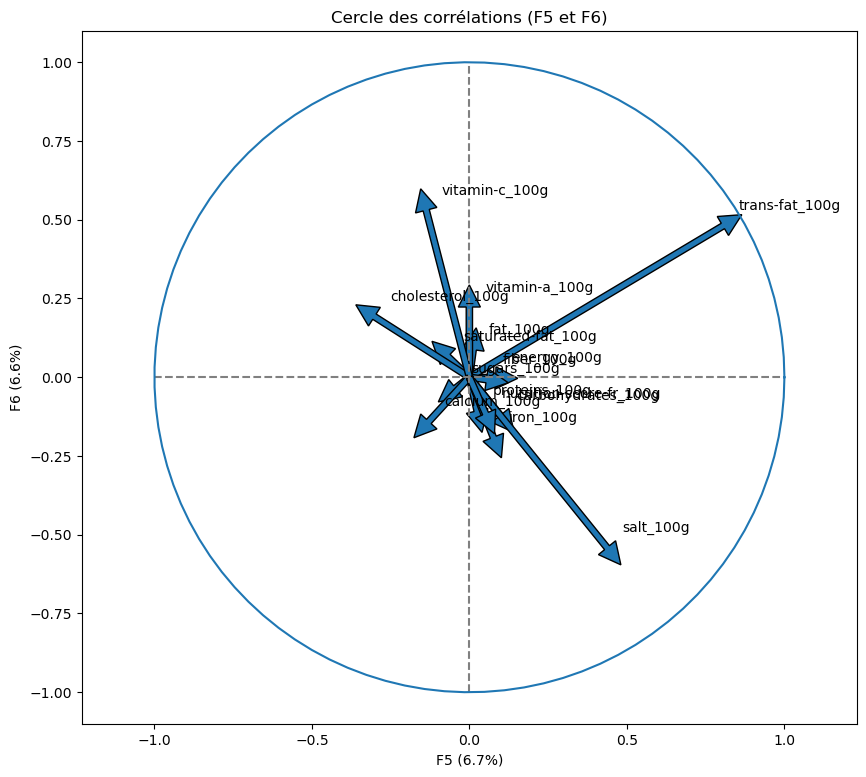

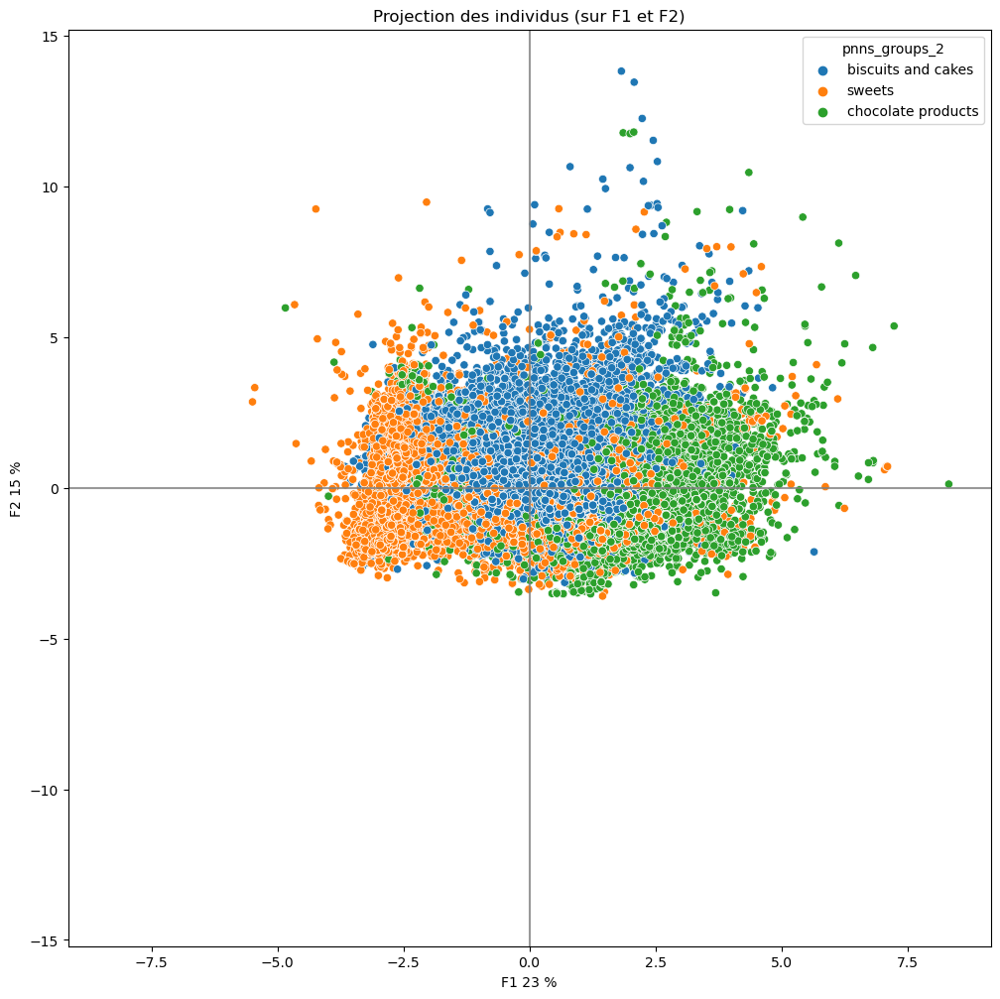

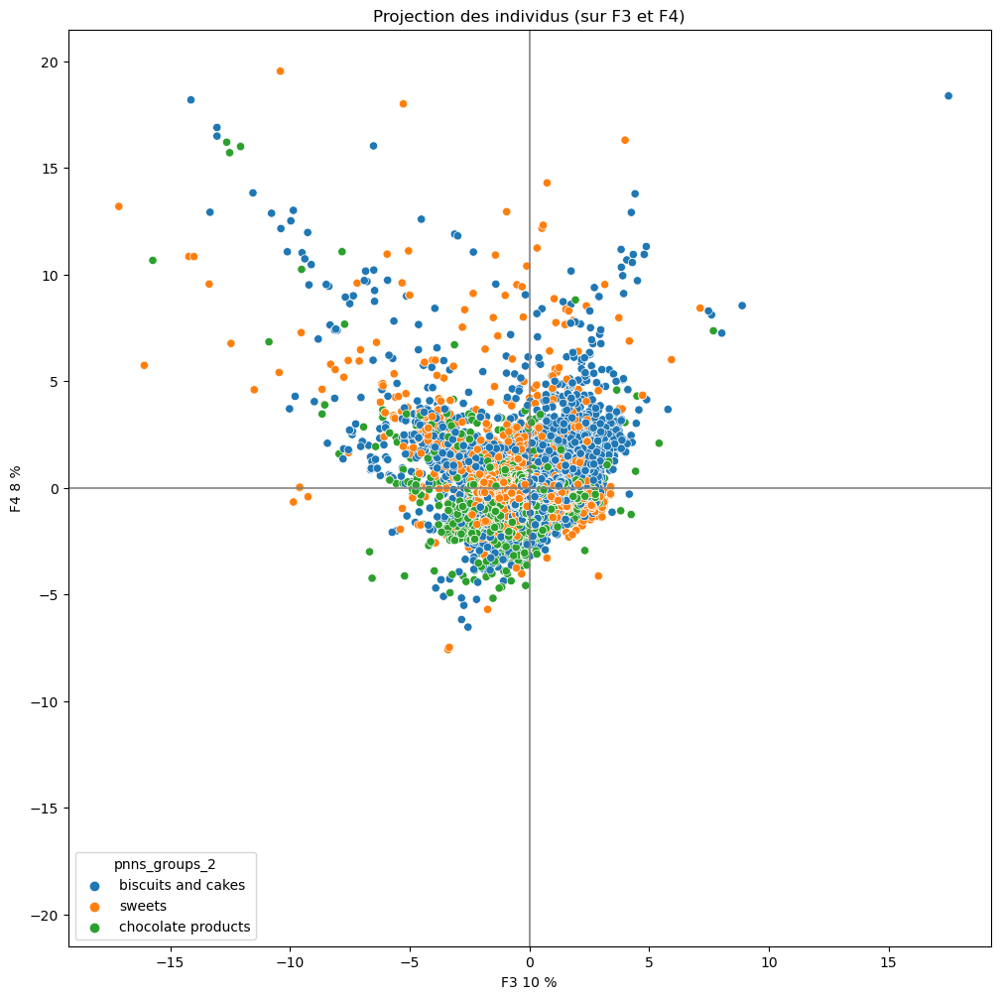

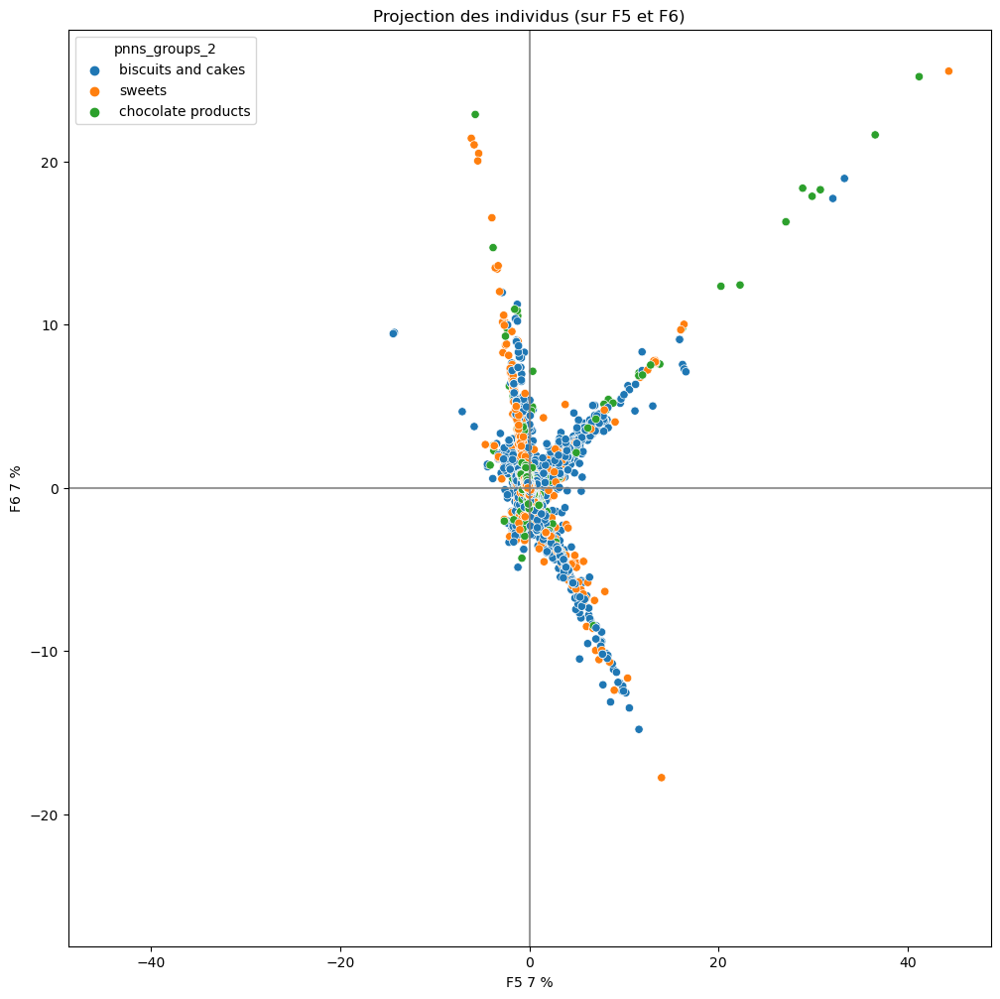

cereals and potatoes


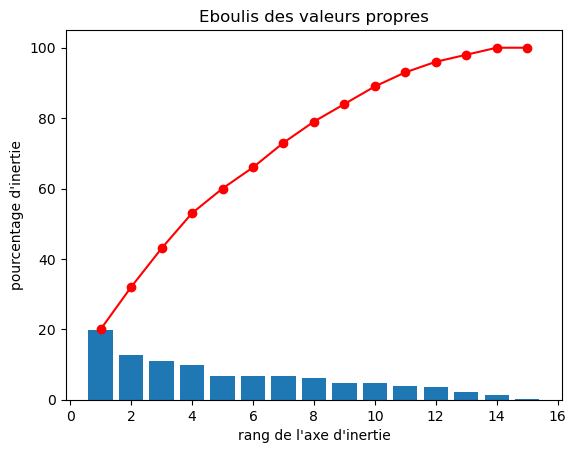

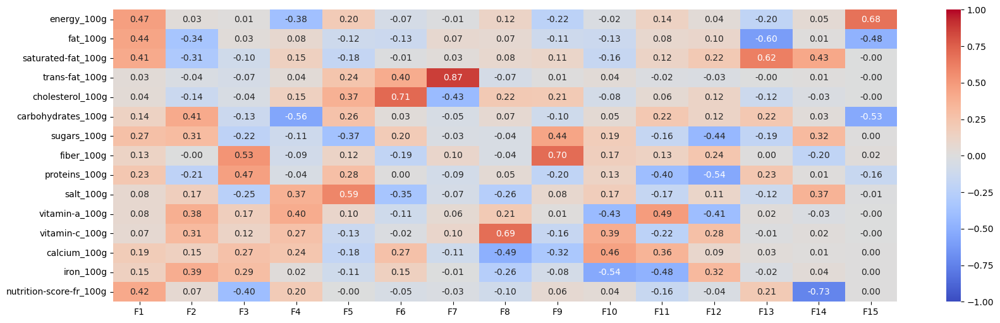

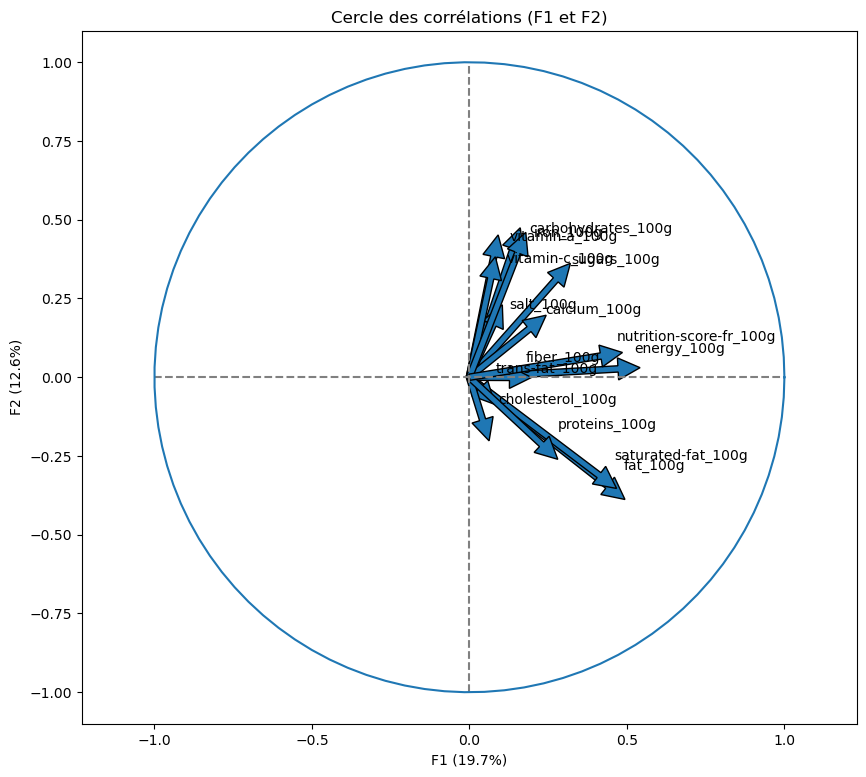

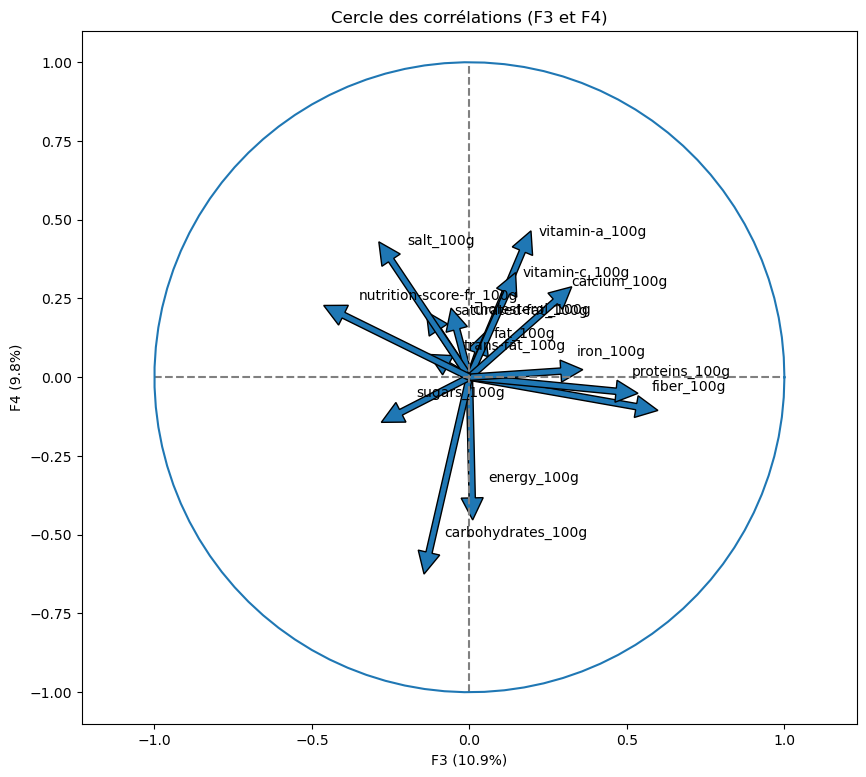

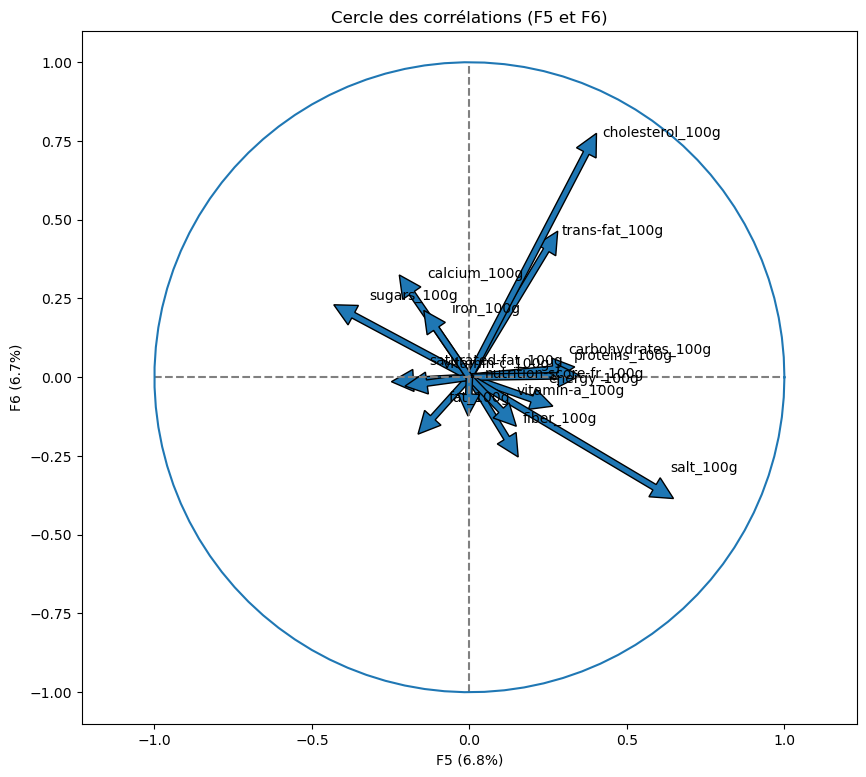

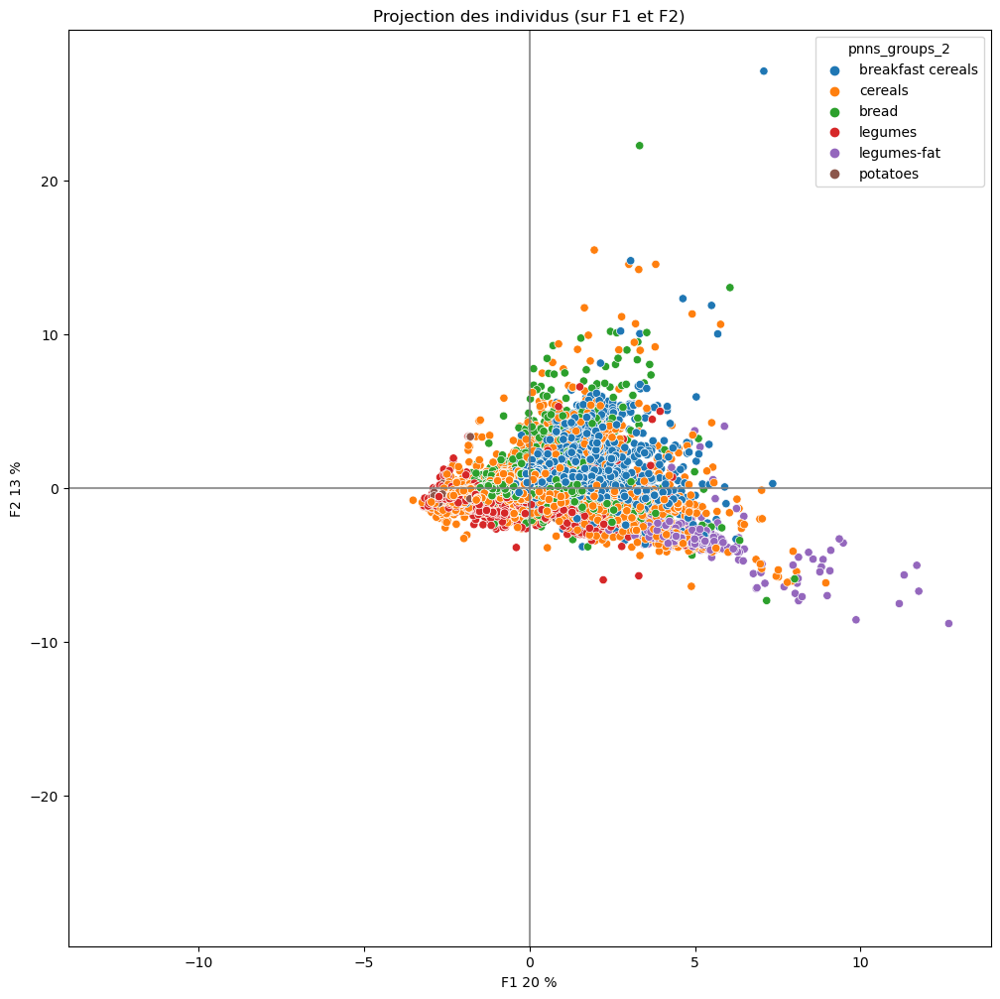

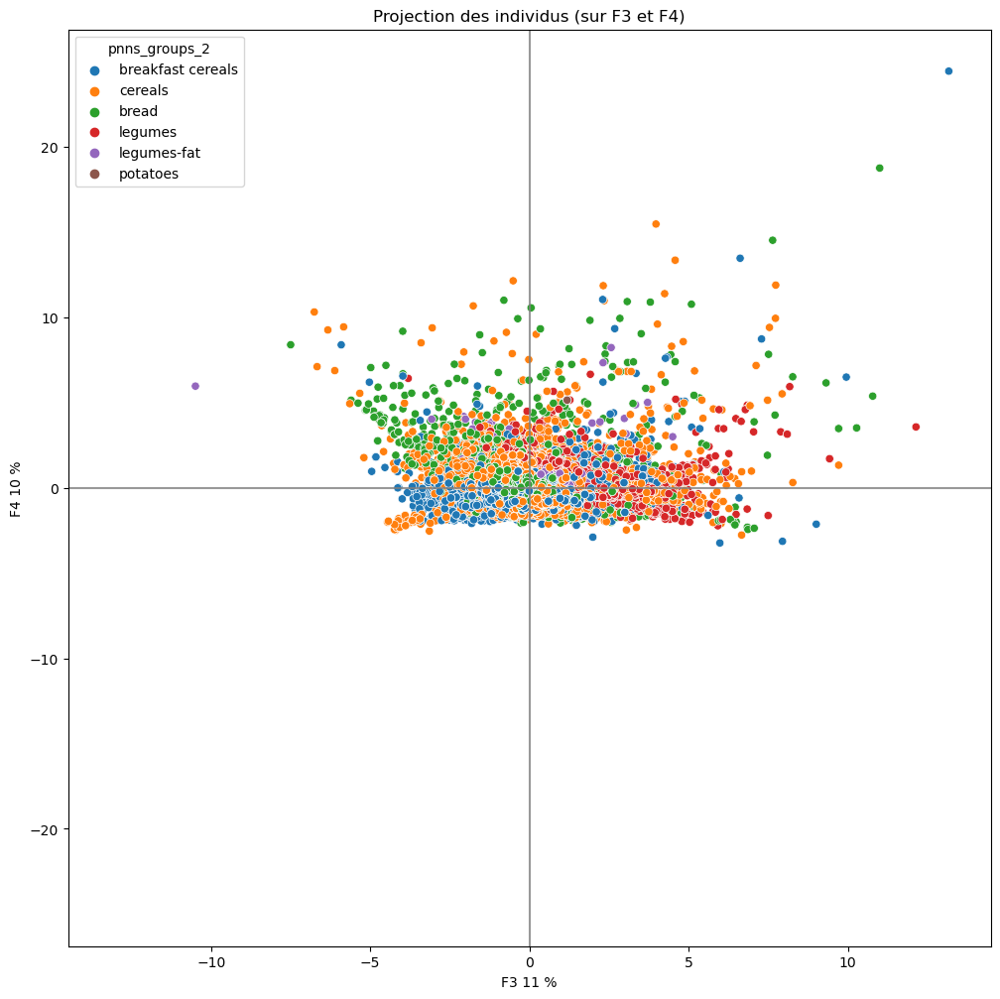

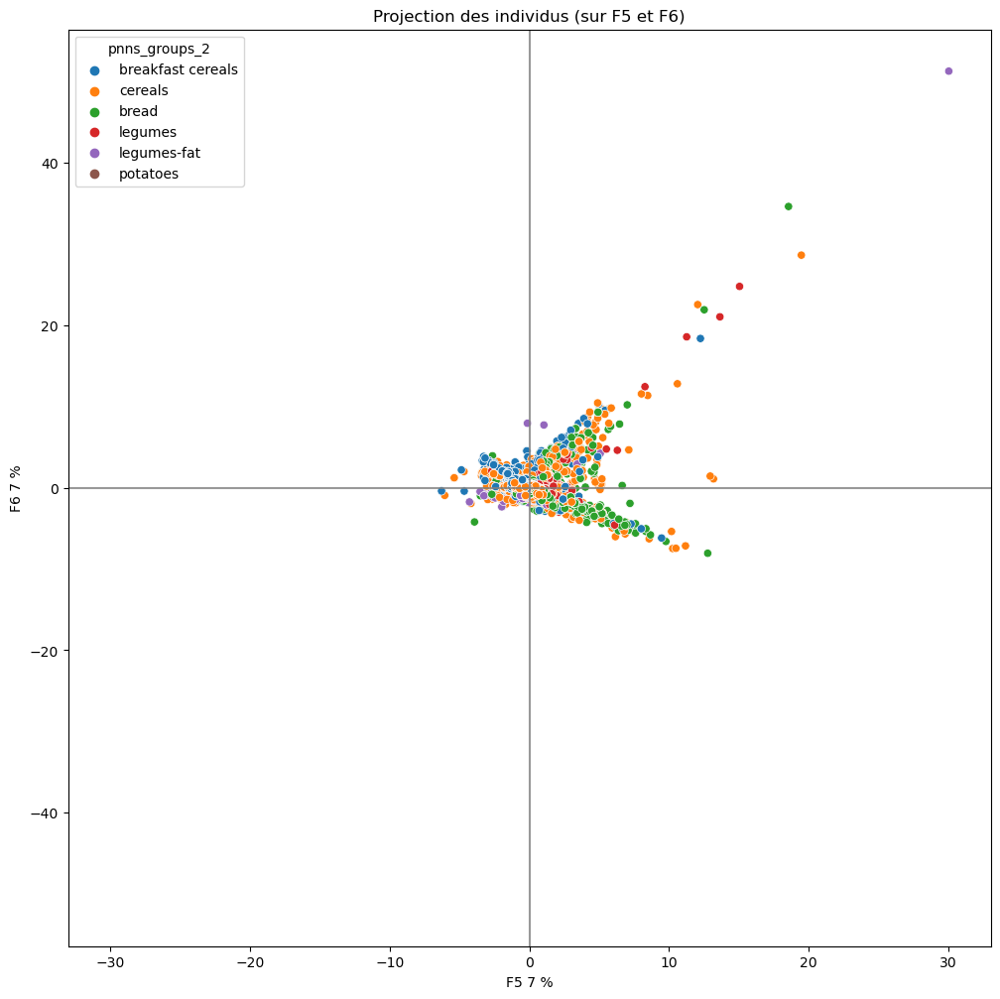

salty snacks


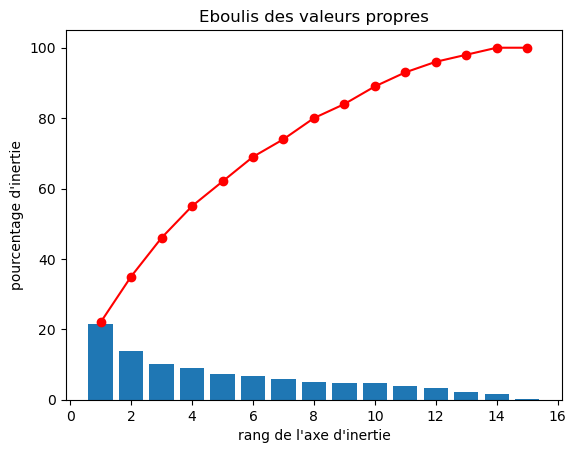

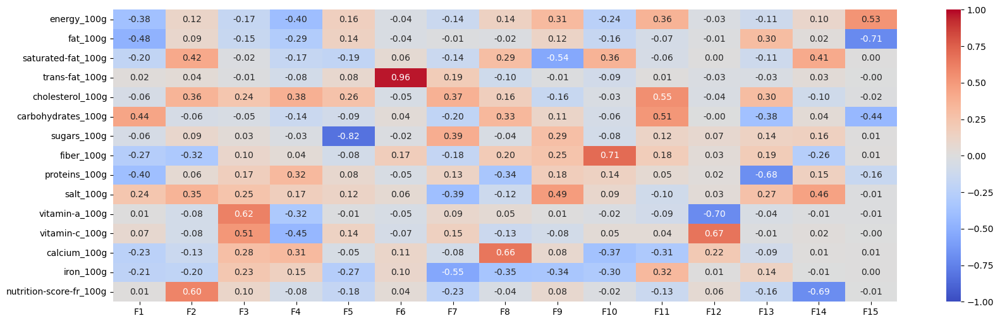

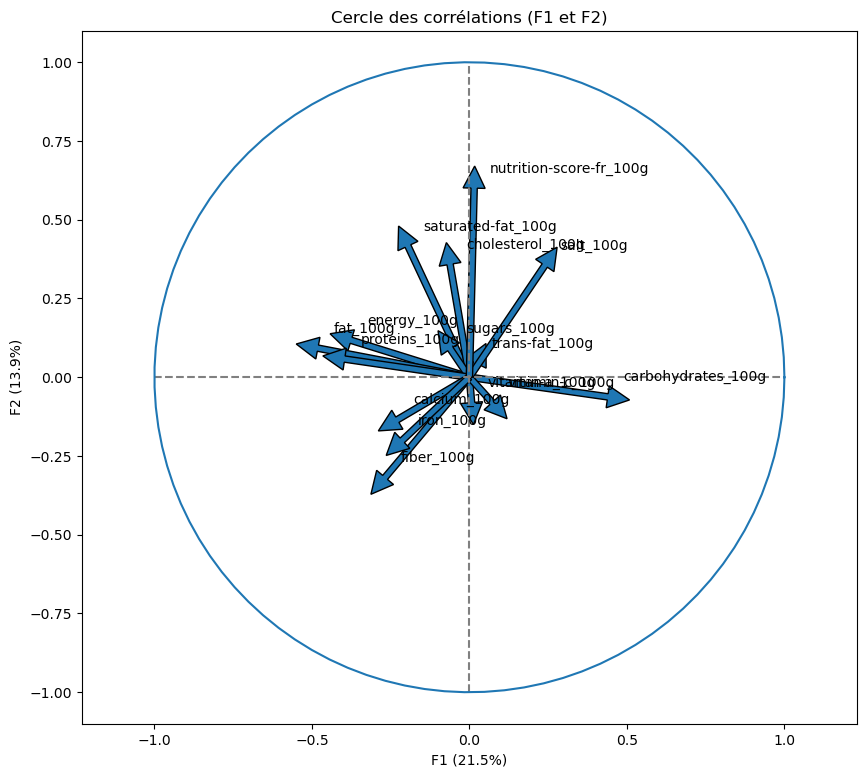

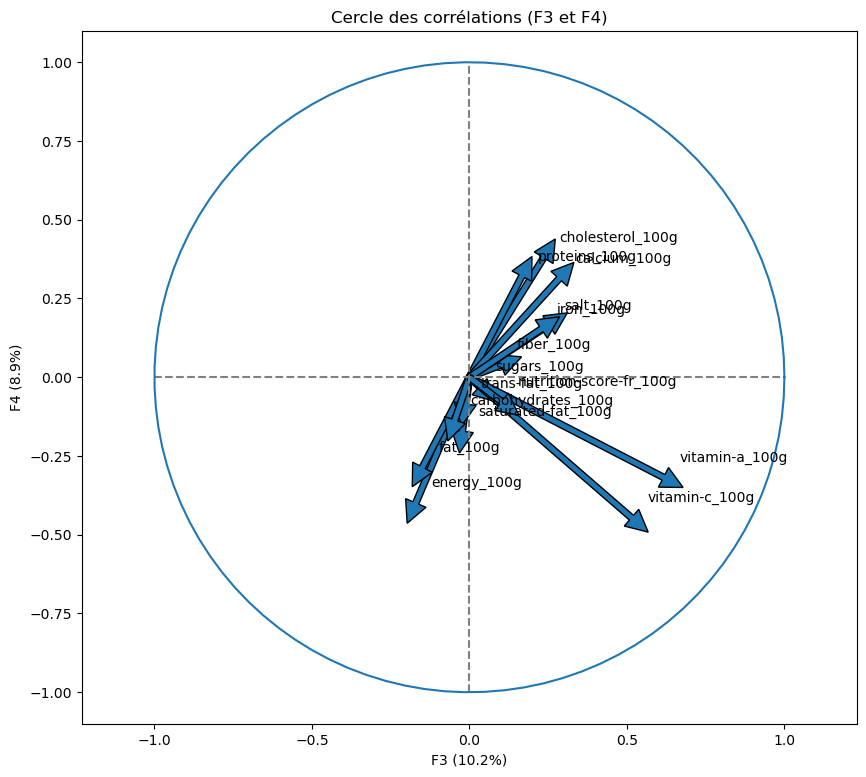

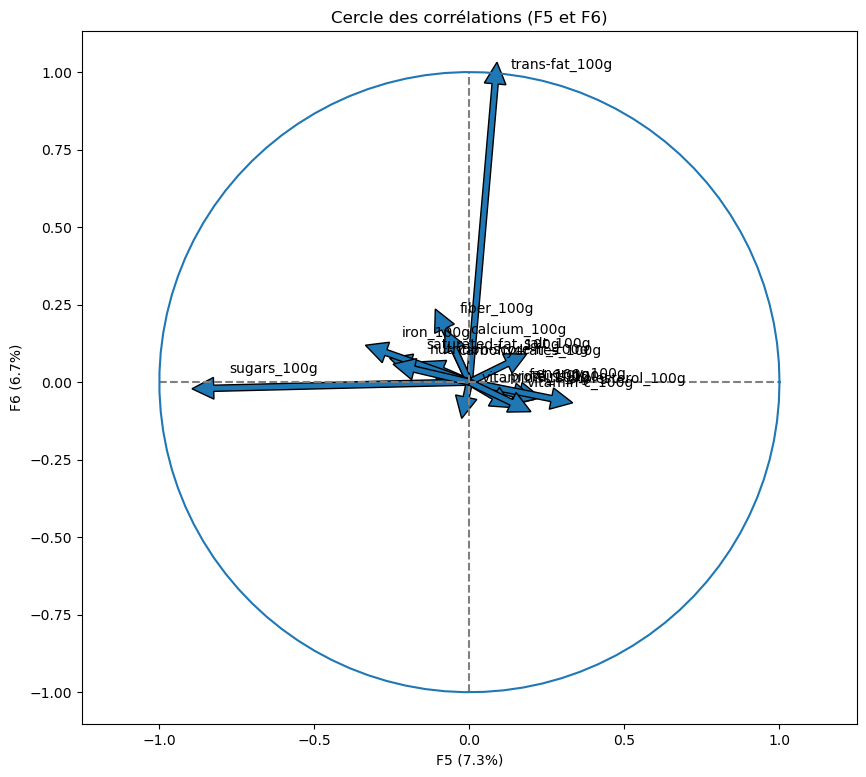

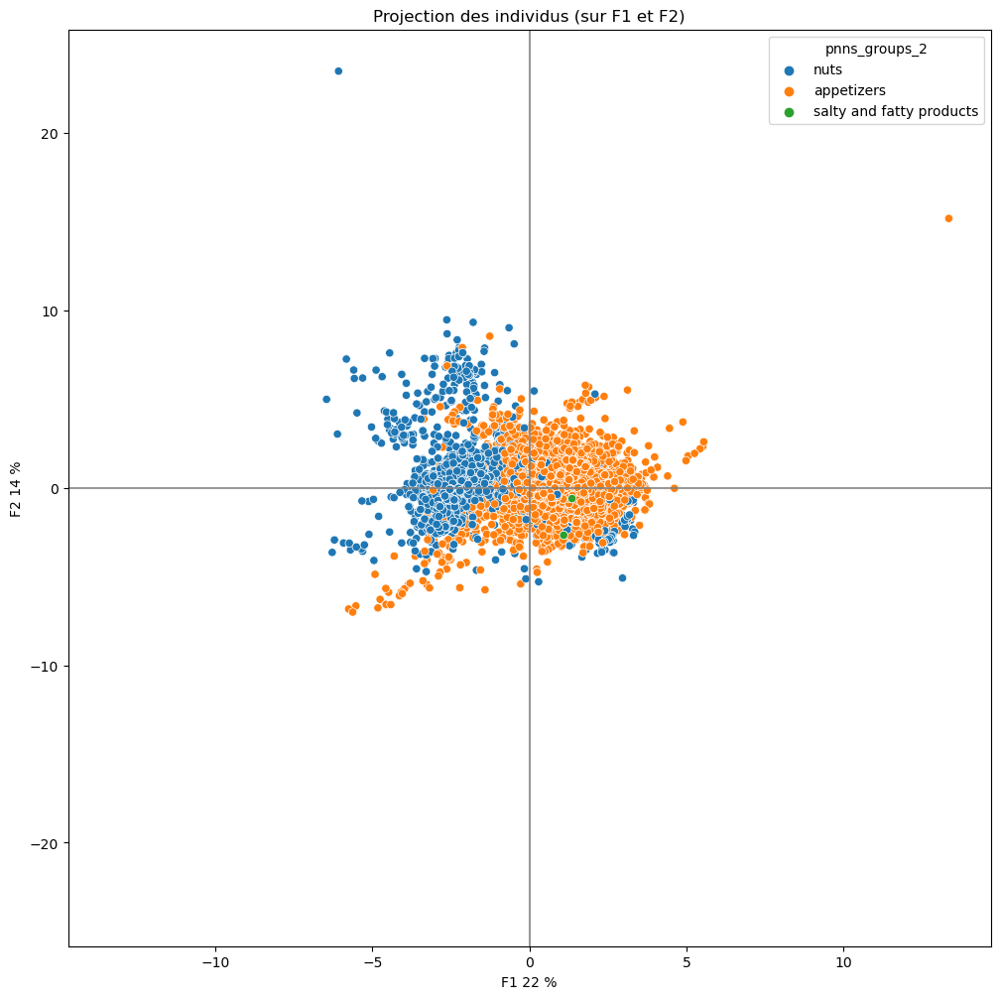

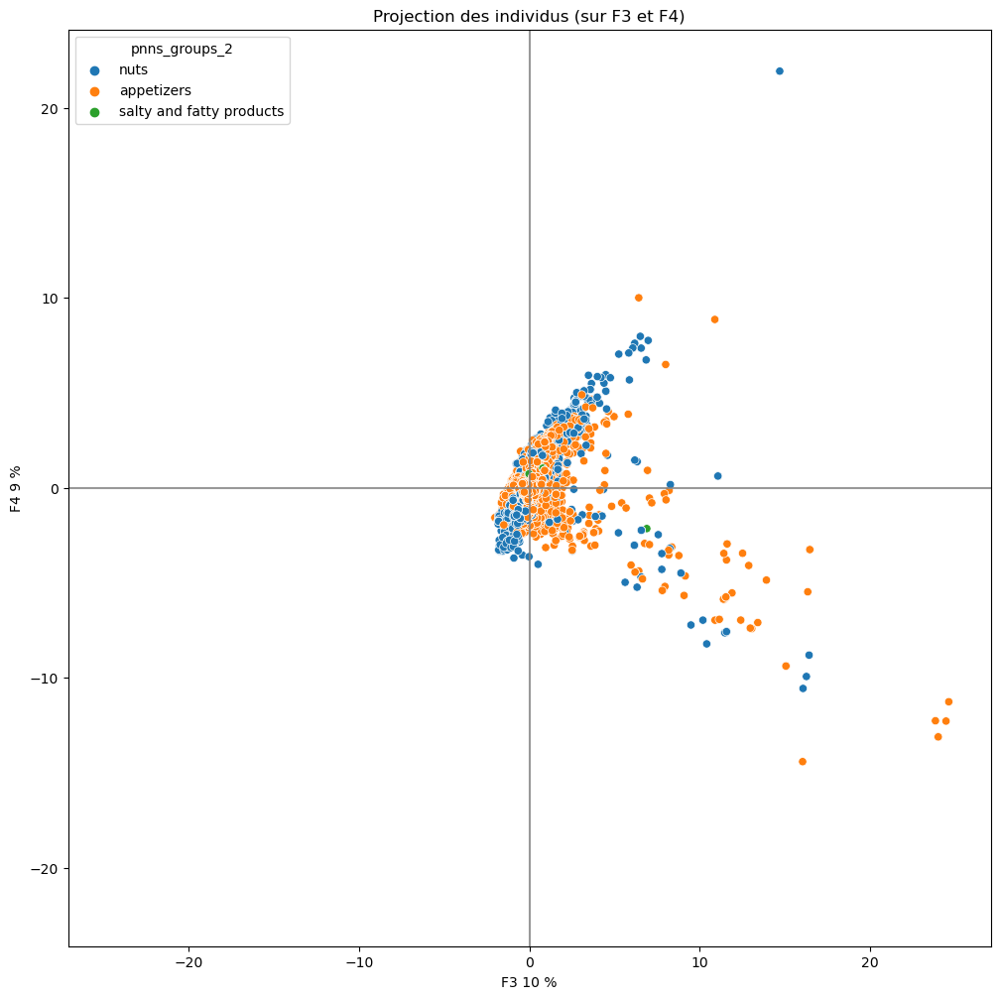

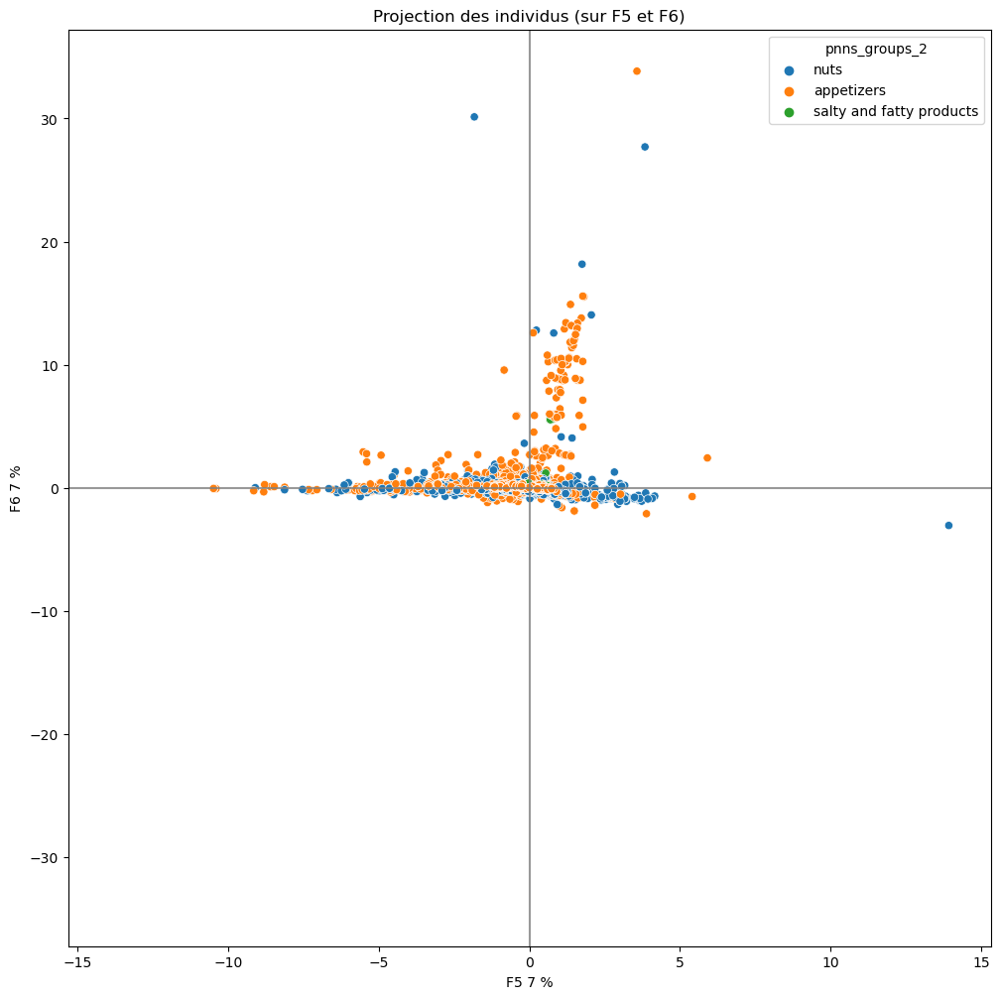

fish meat eggs


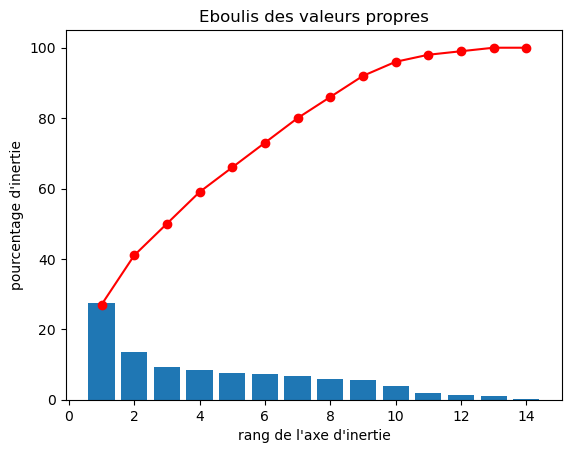

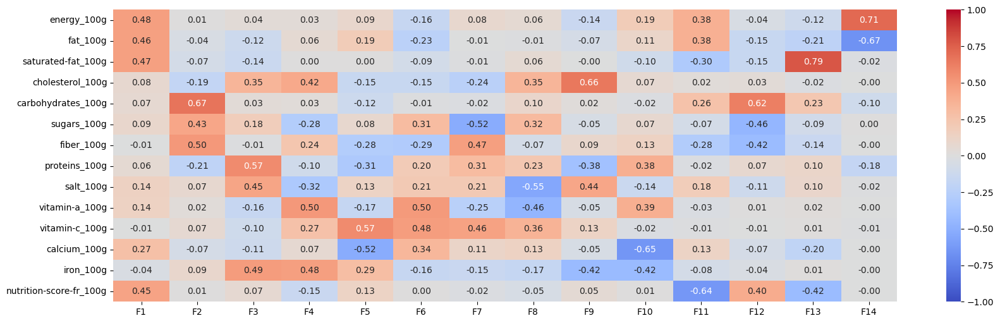

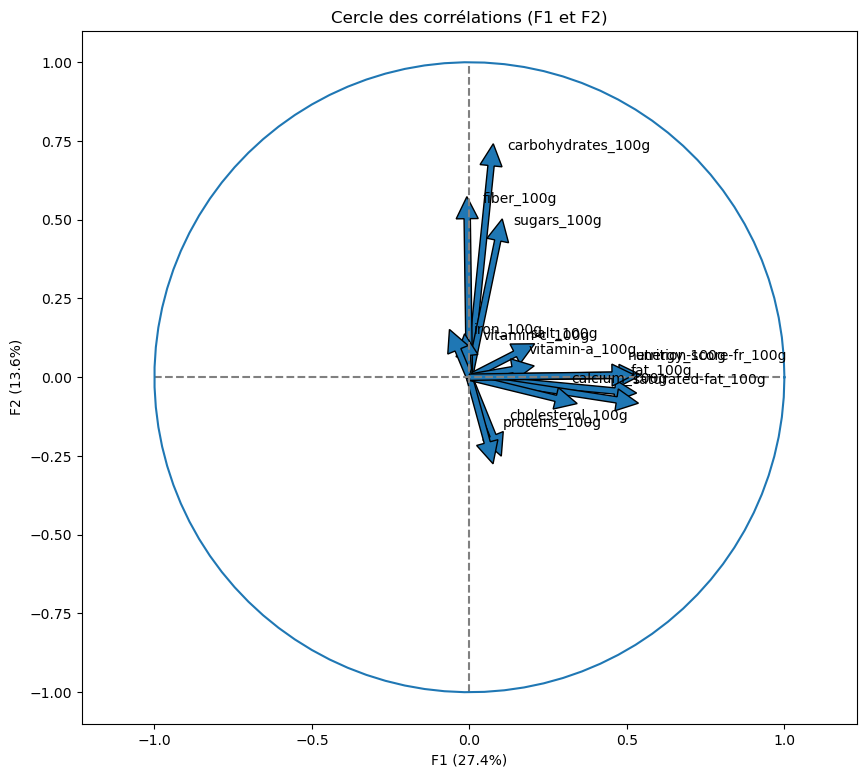

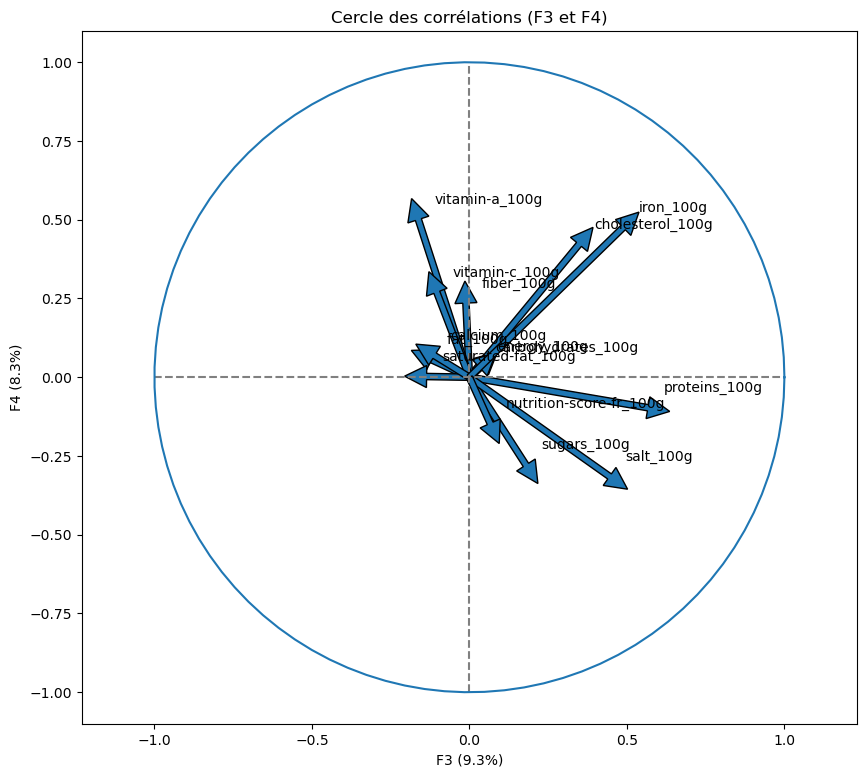

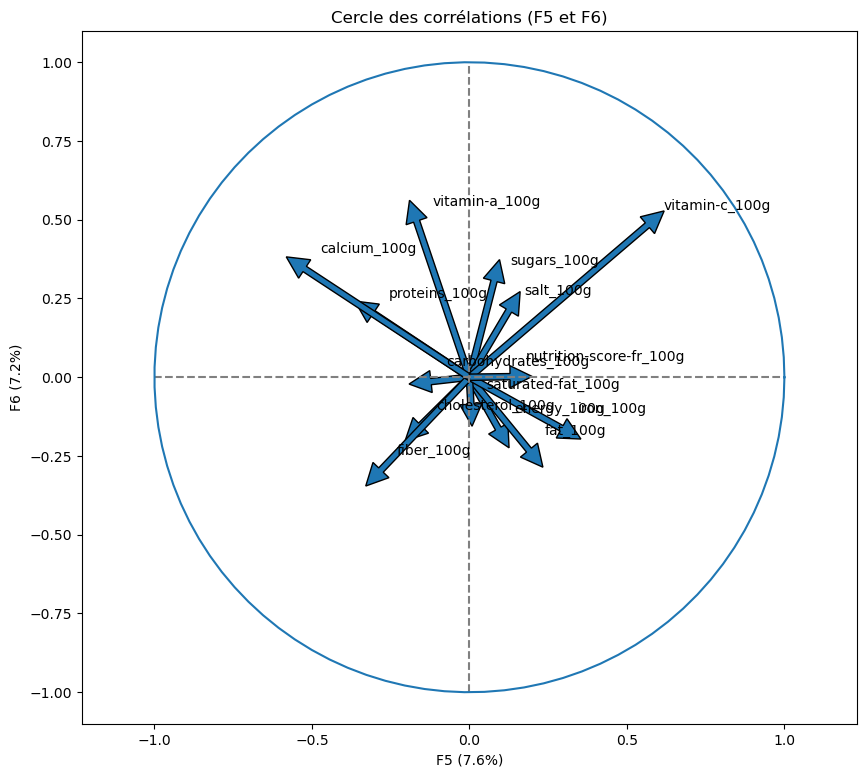

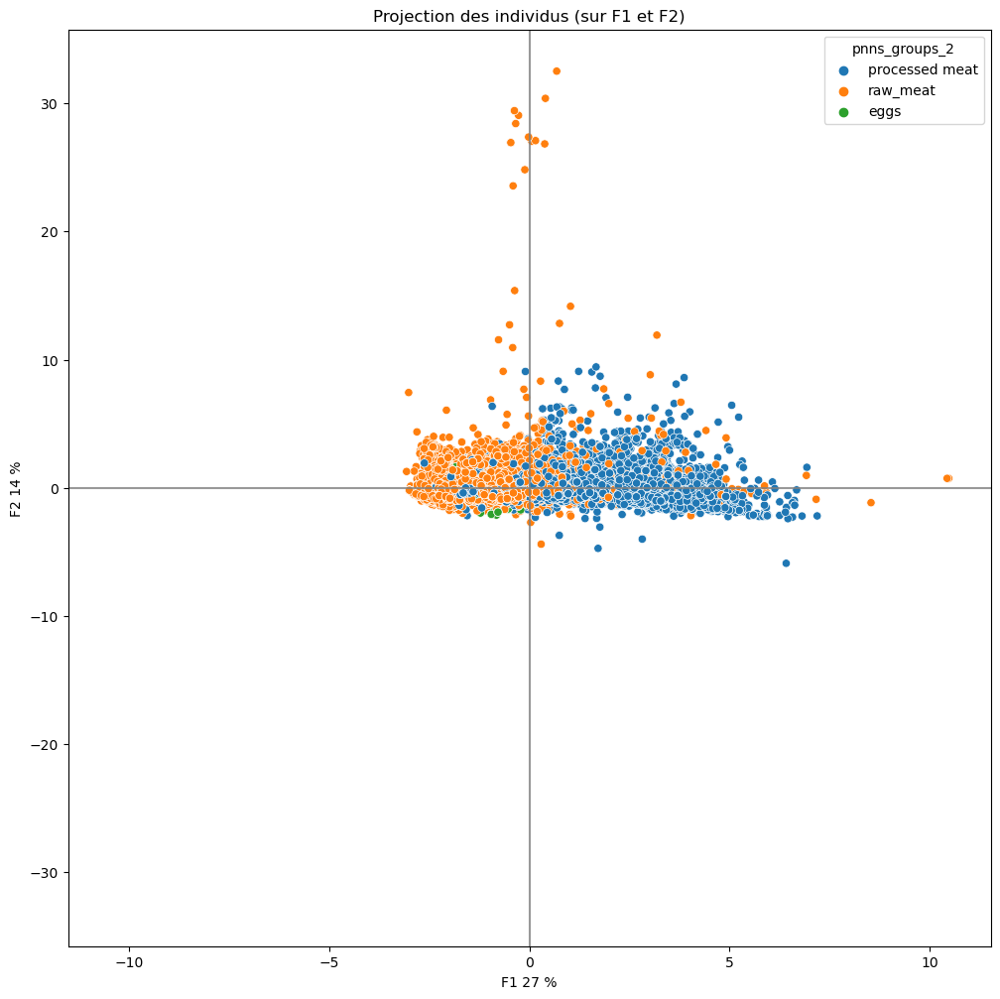

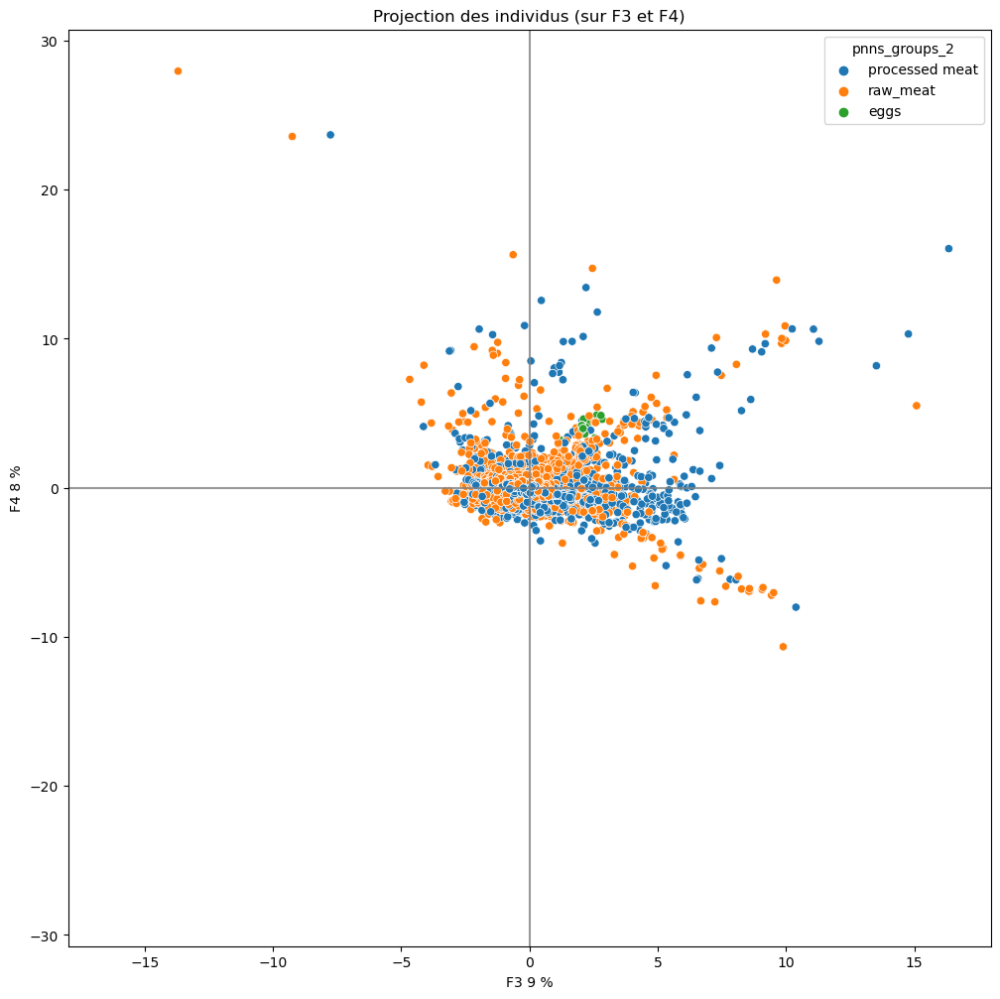

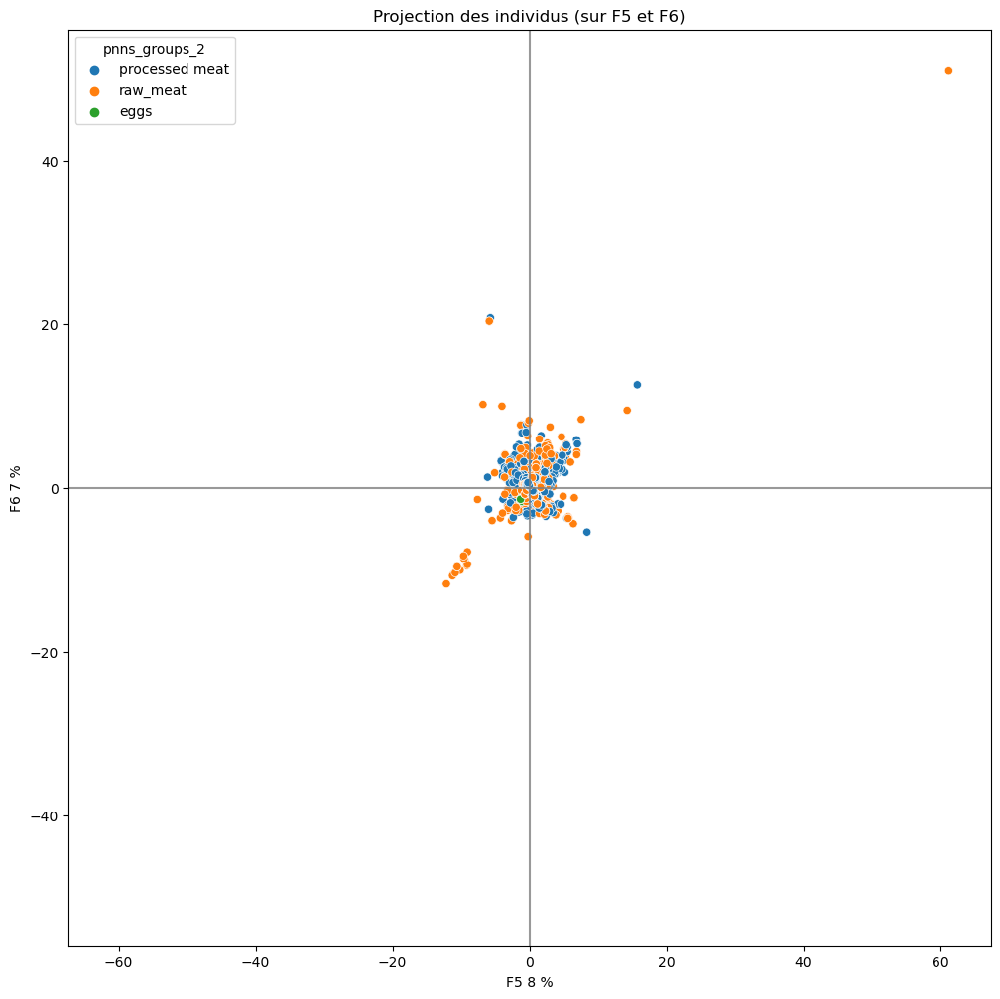

fruits and vegetables


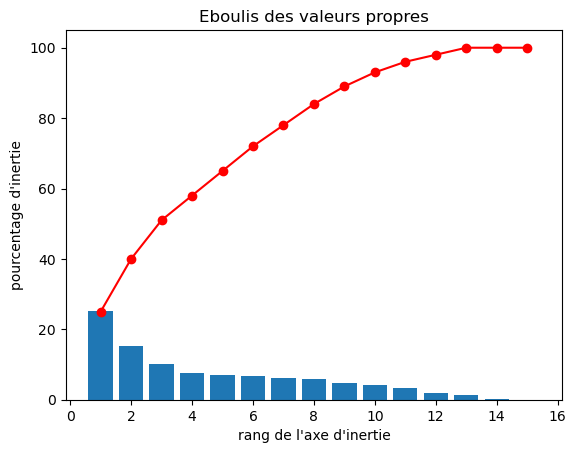

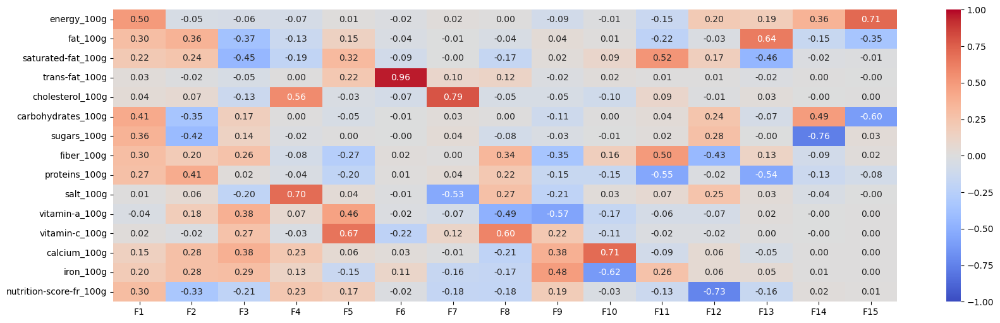

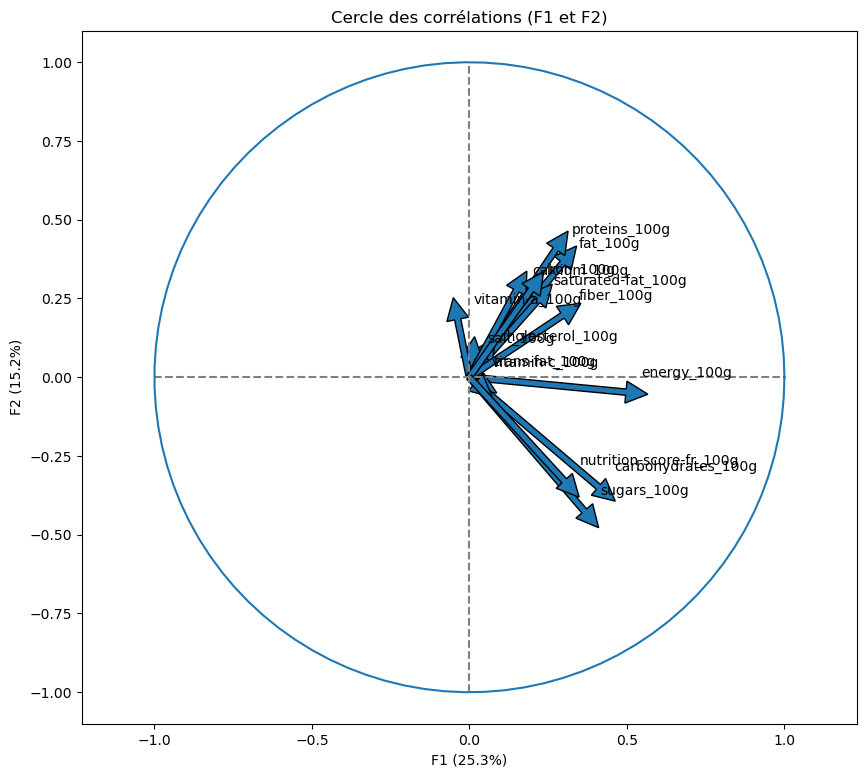

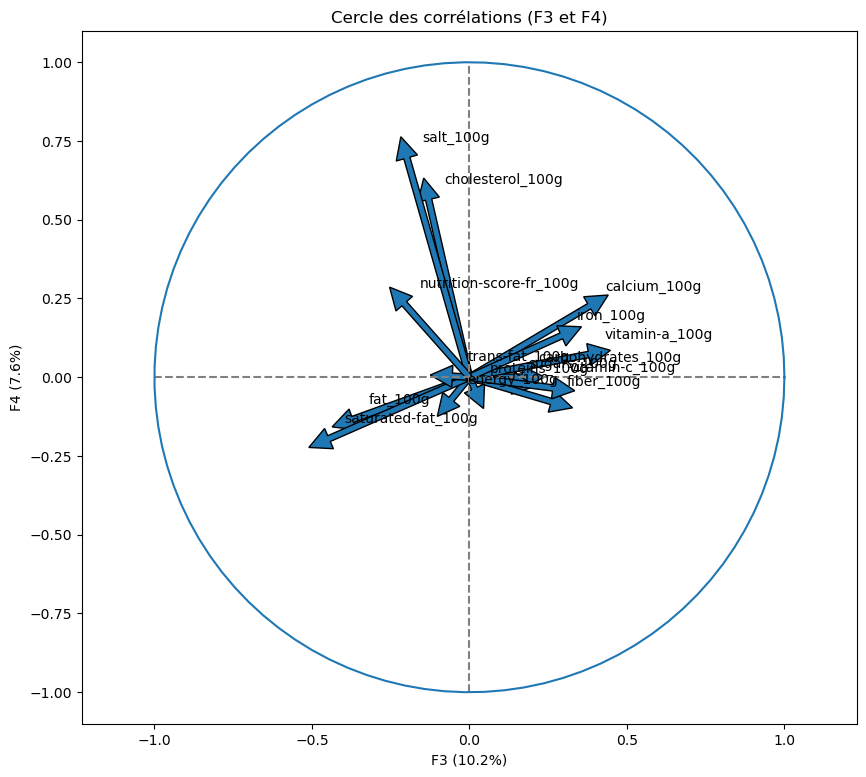

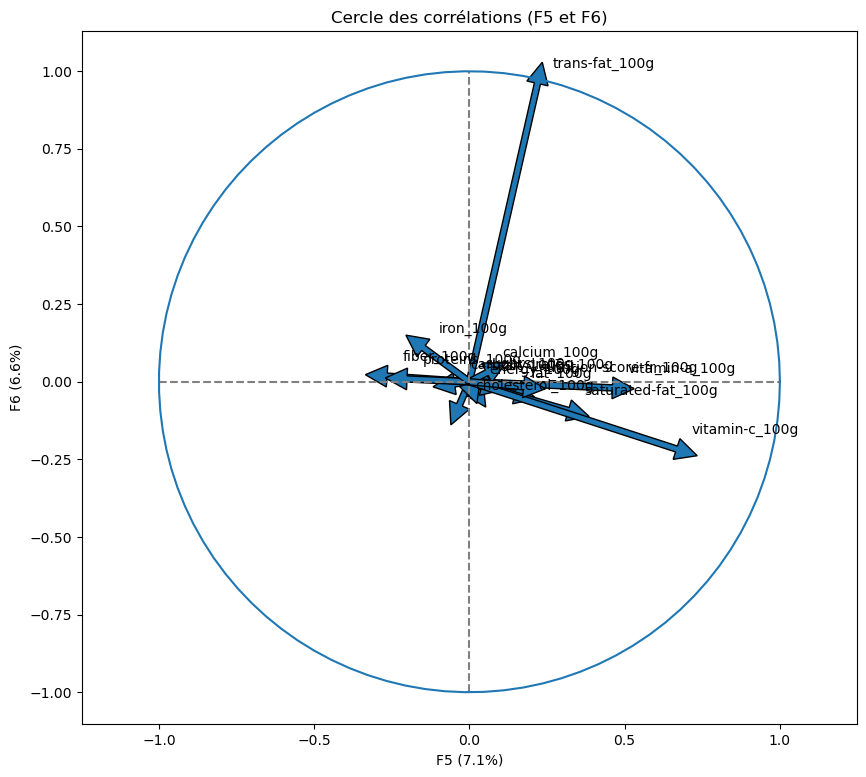

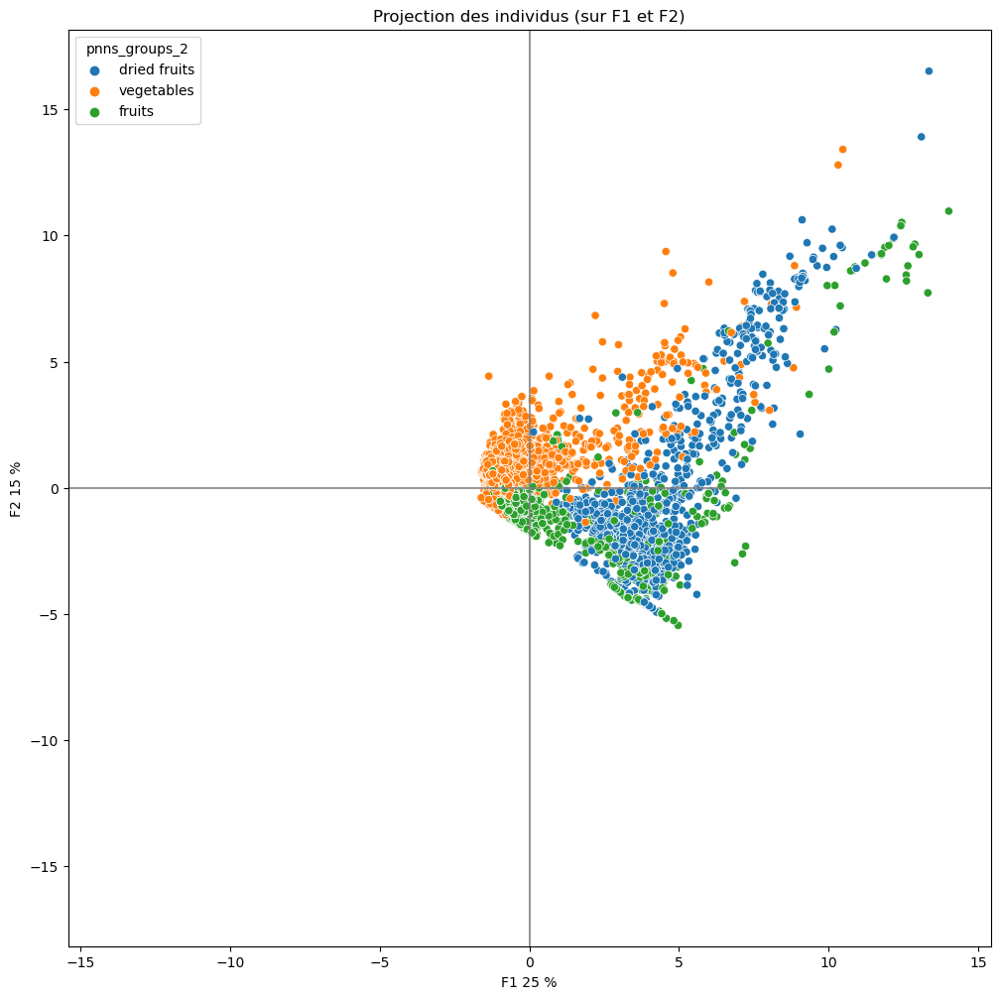

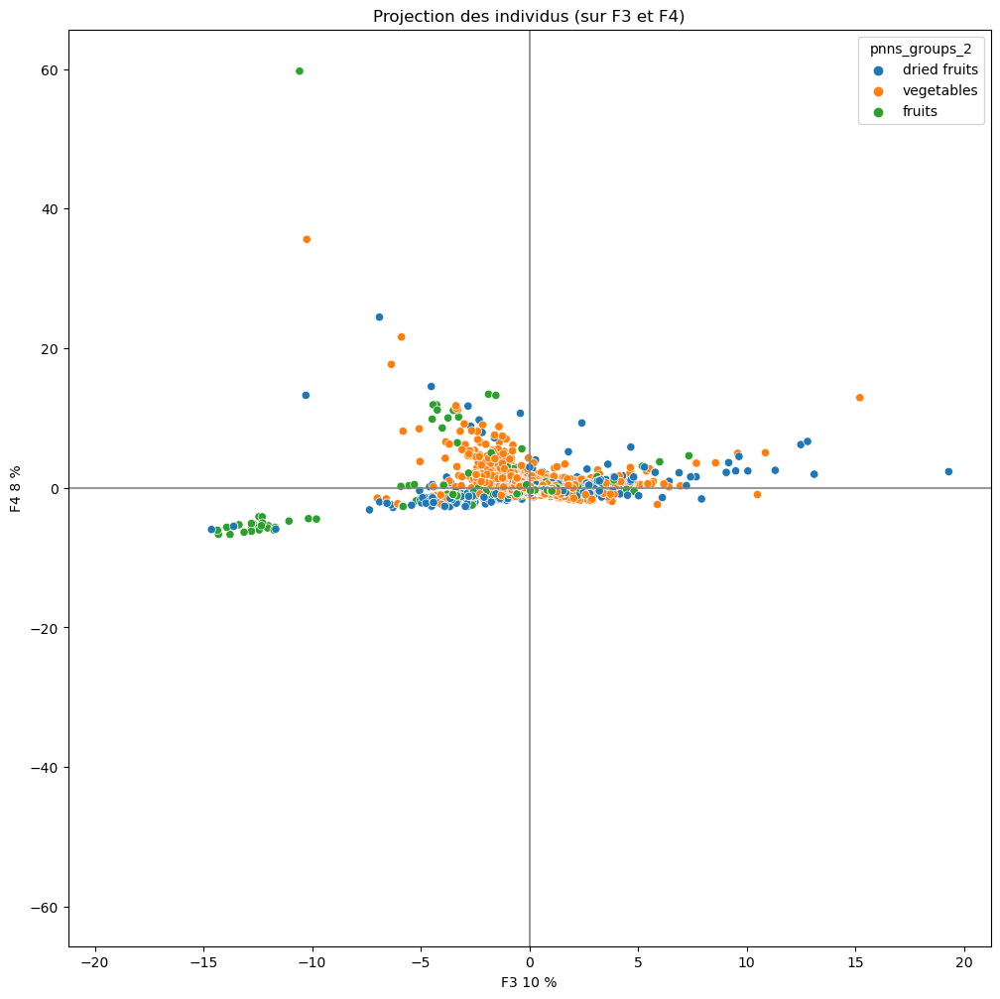

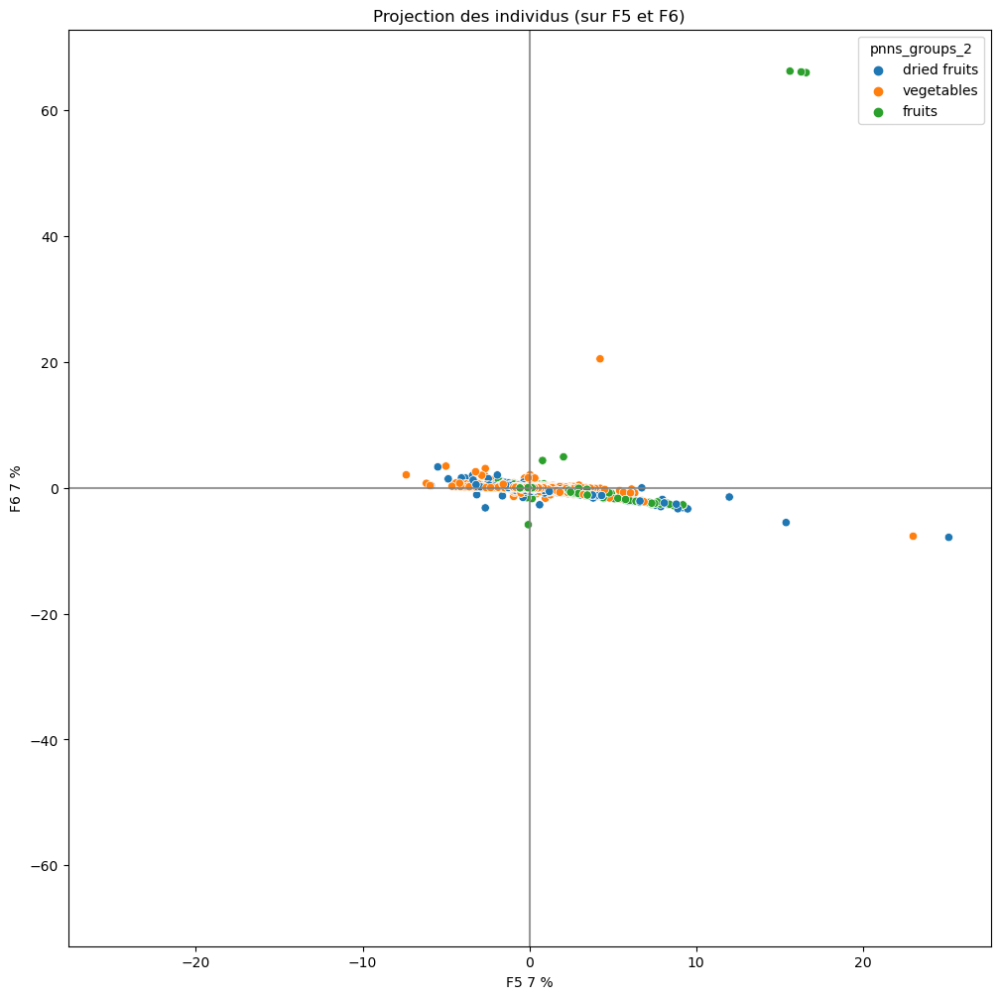

composite foods


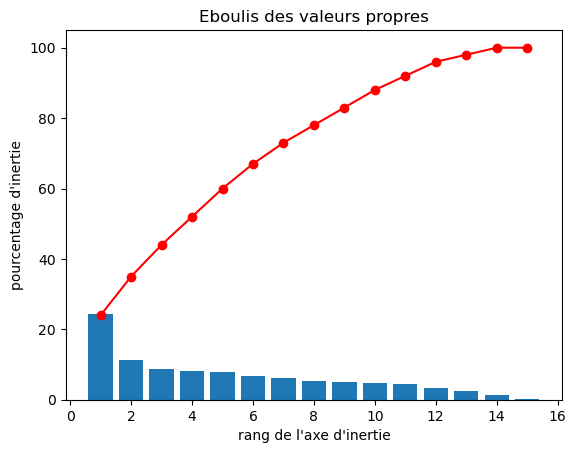

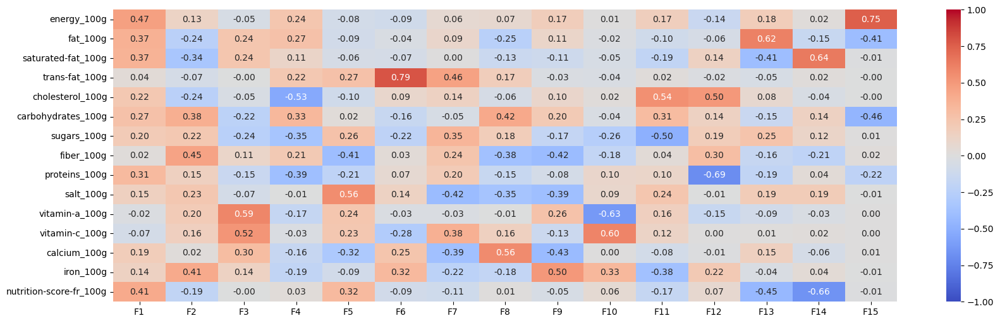

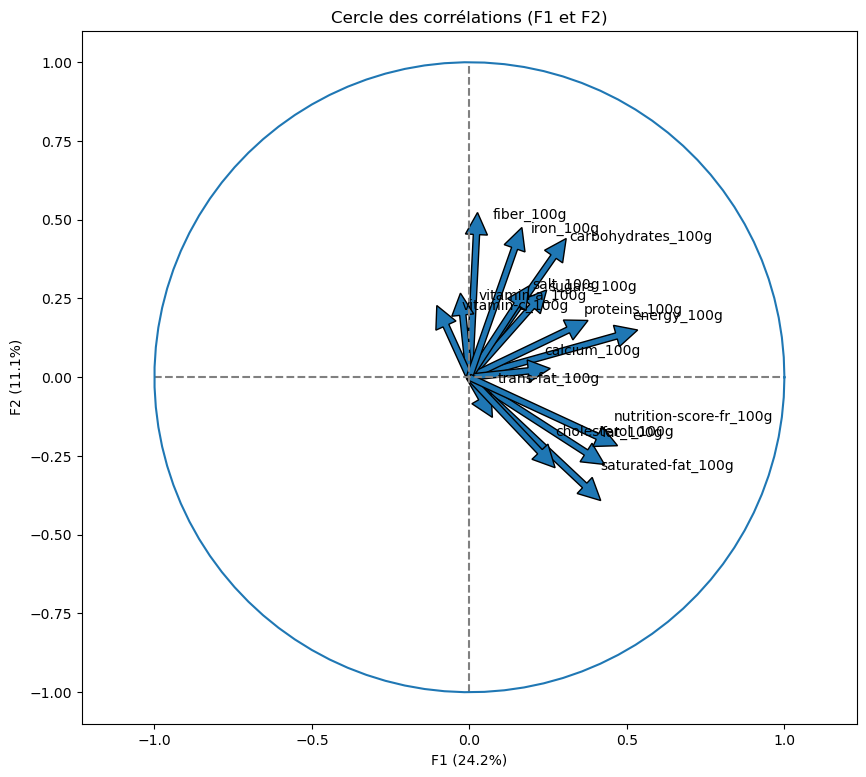

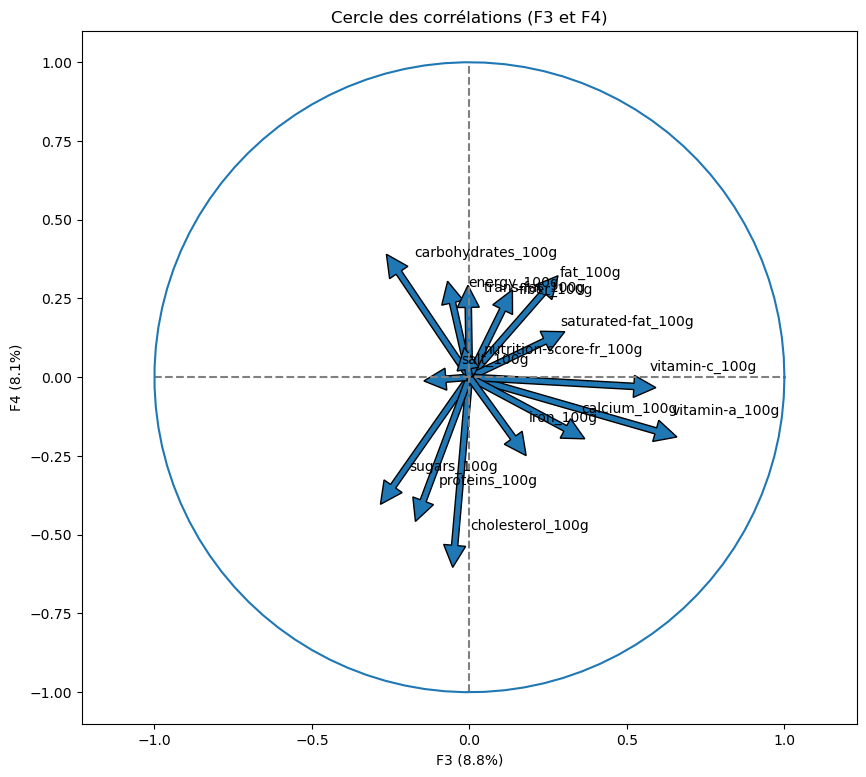

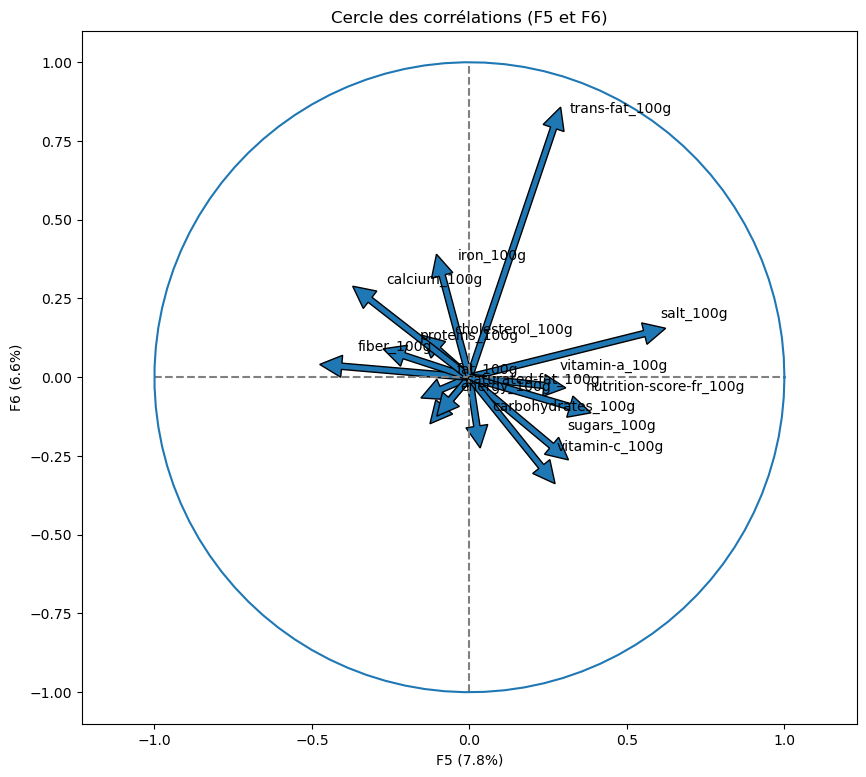

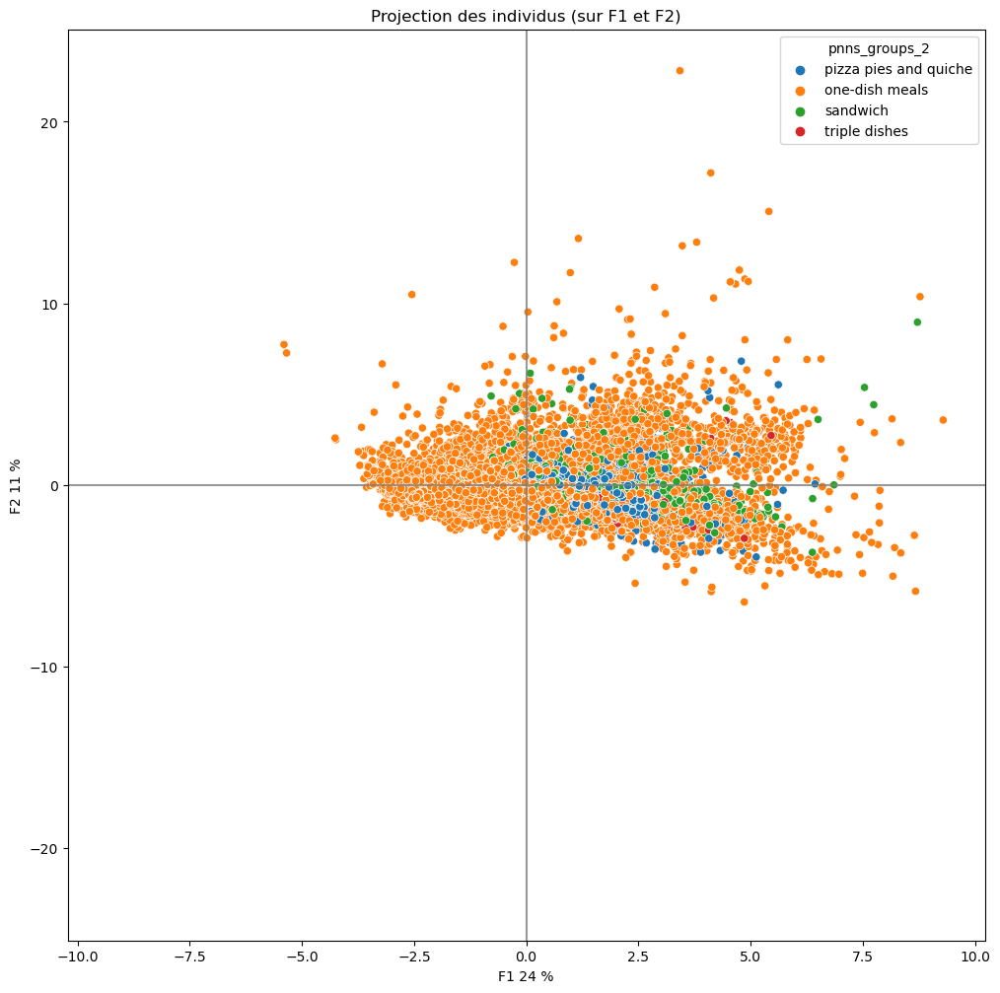

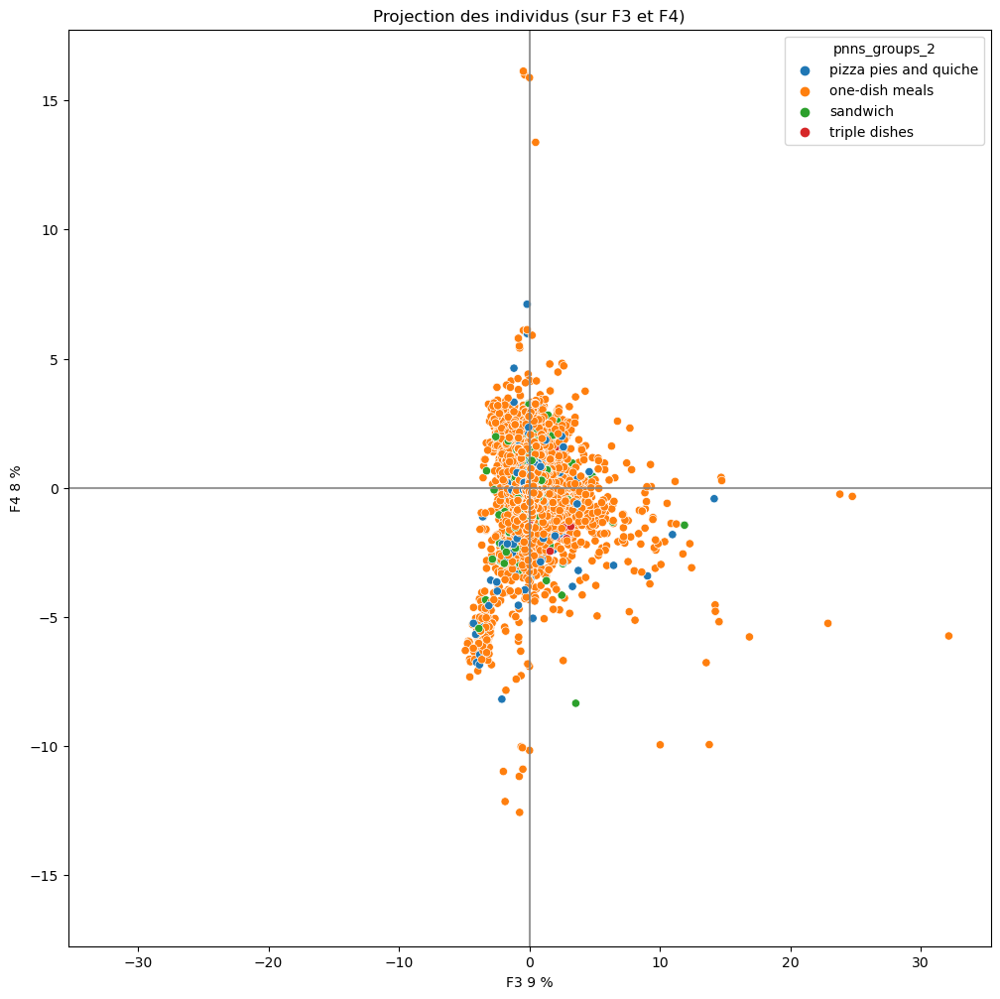

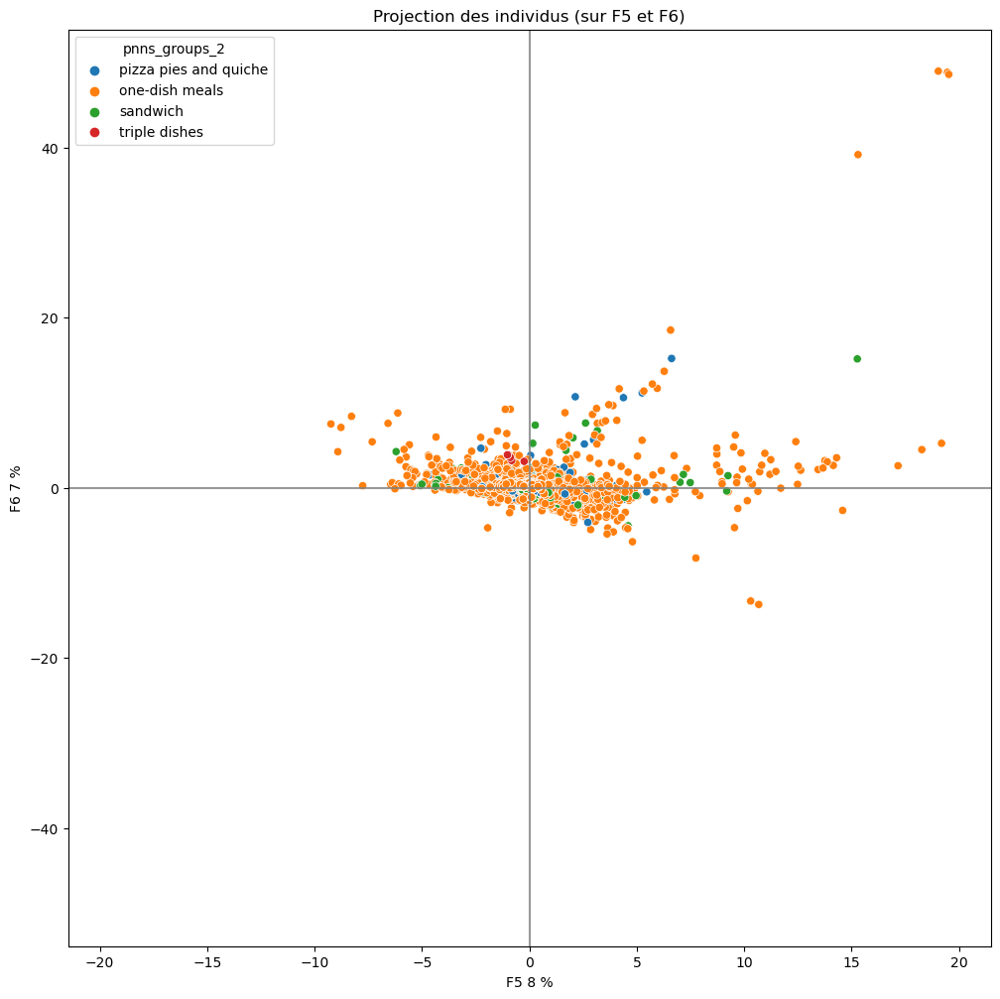

milk and dairy products


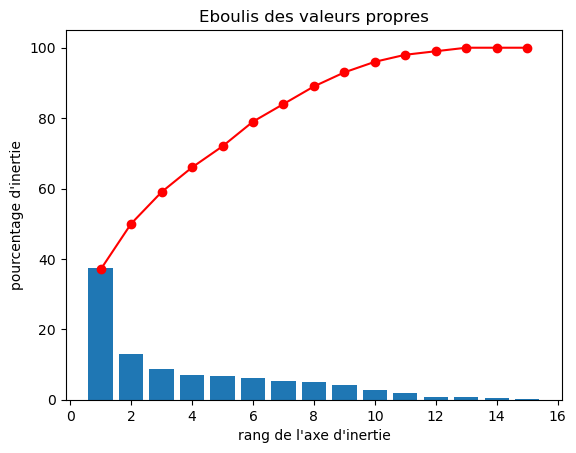

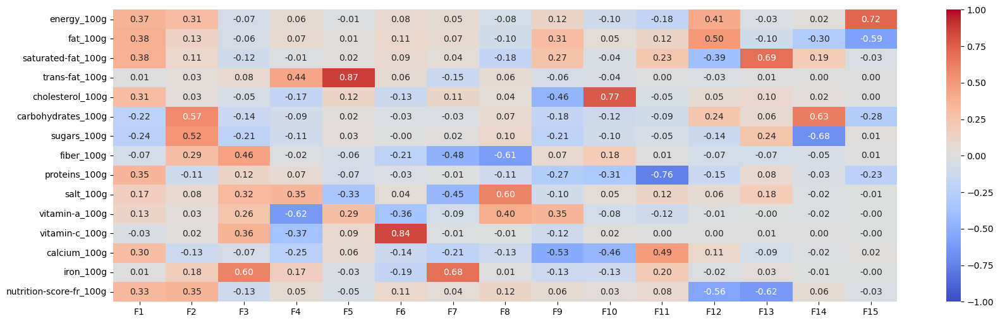

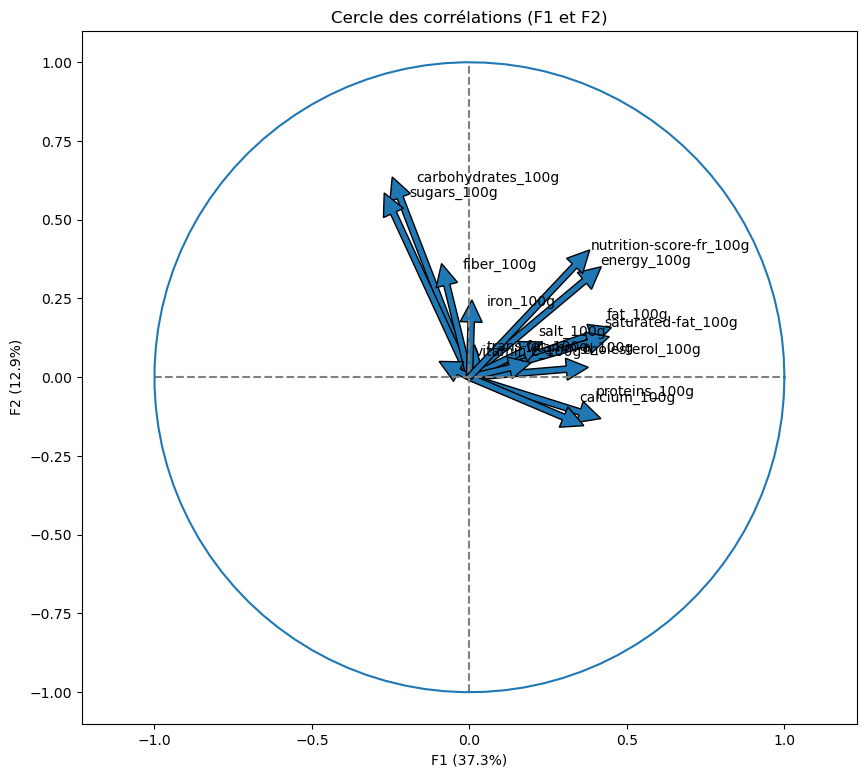

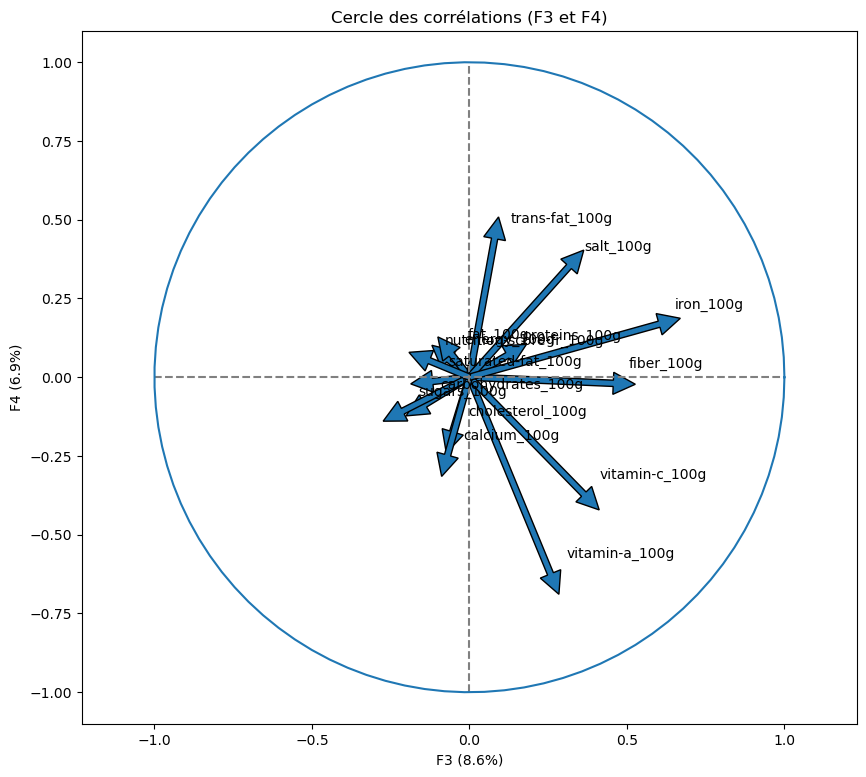

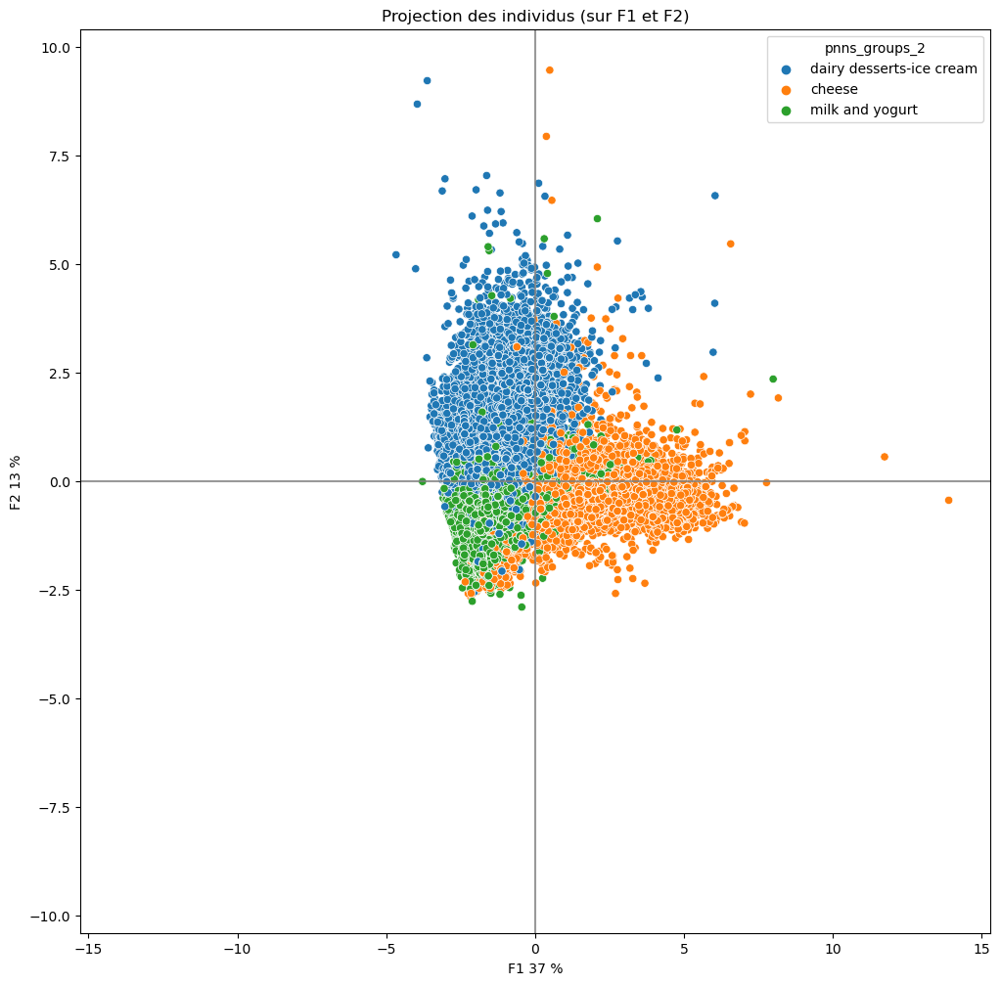

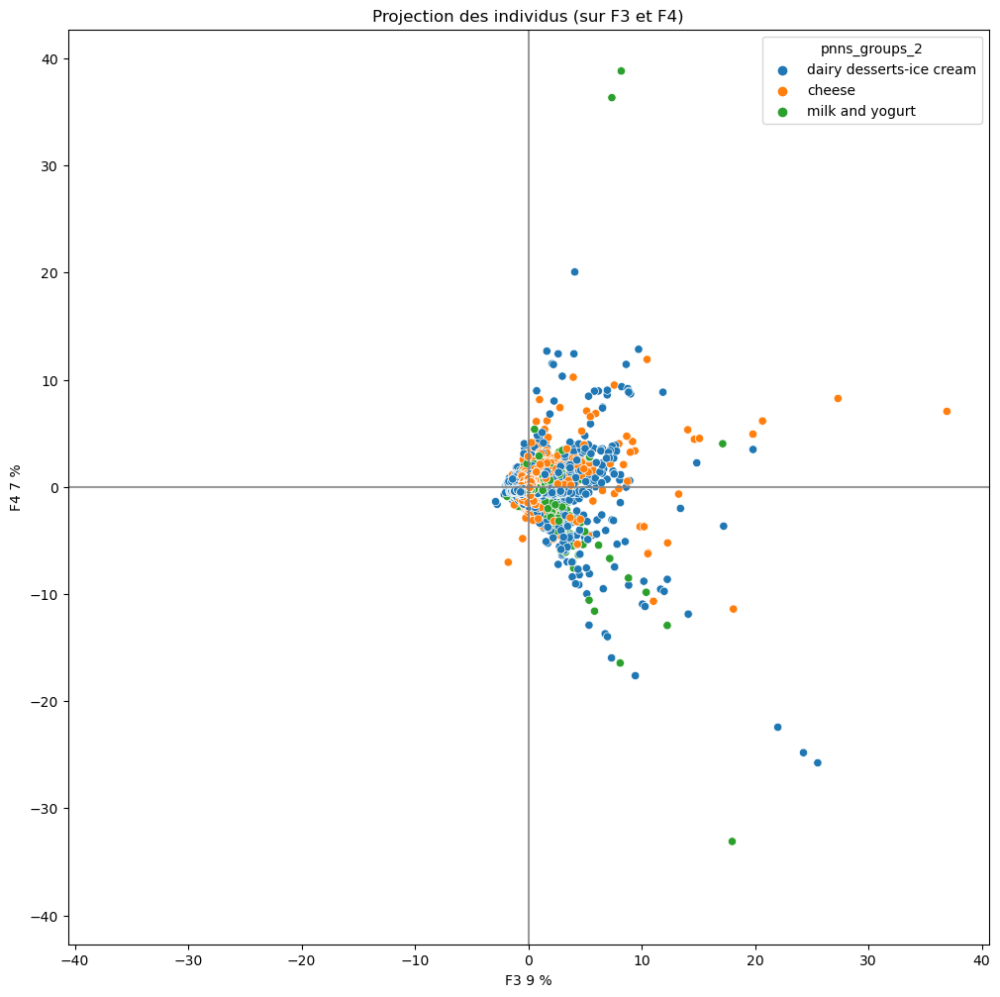

beverages


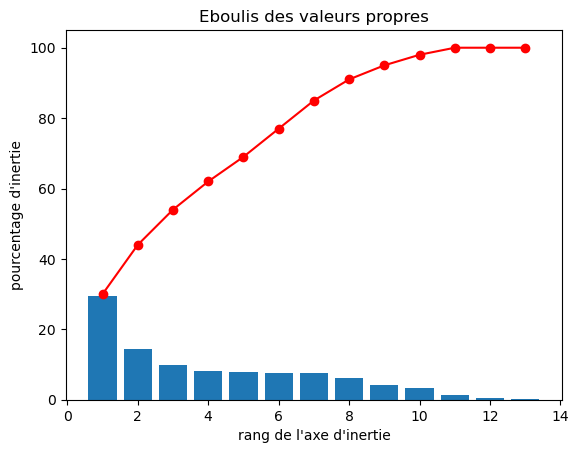

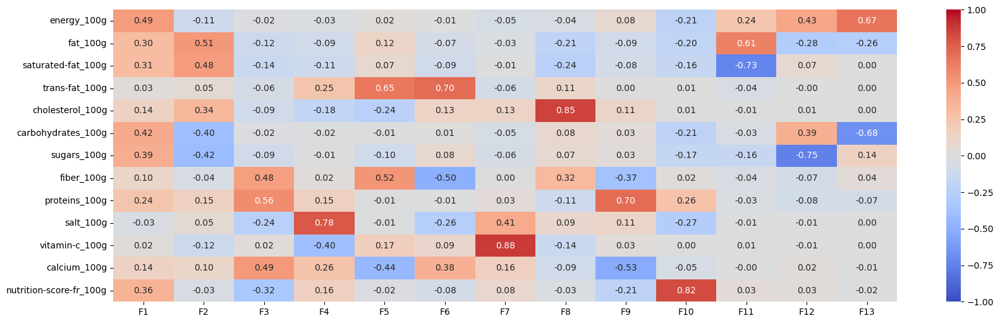

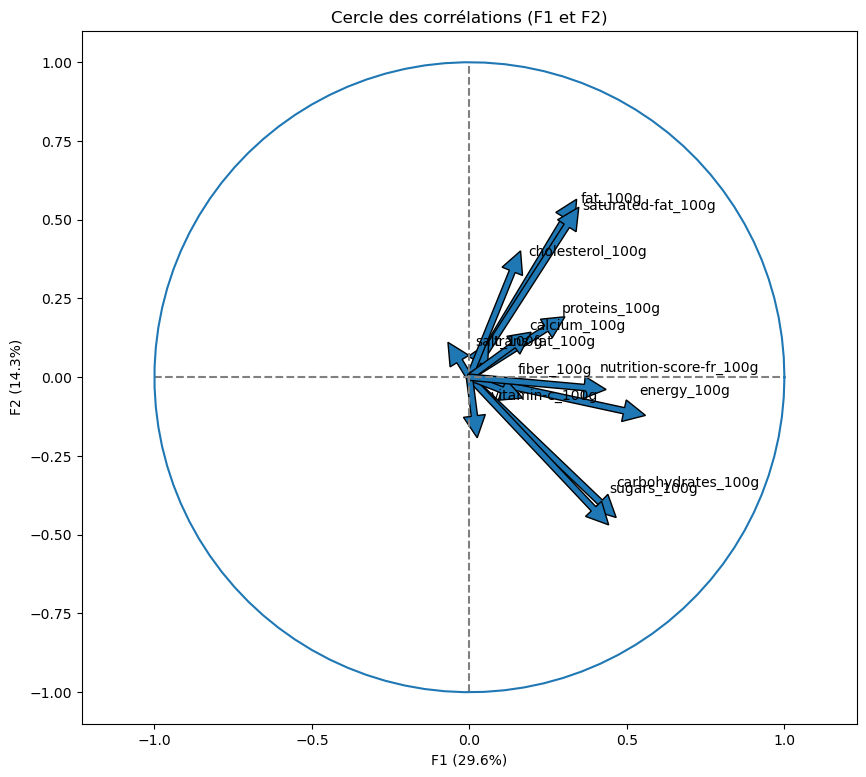

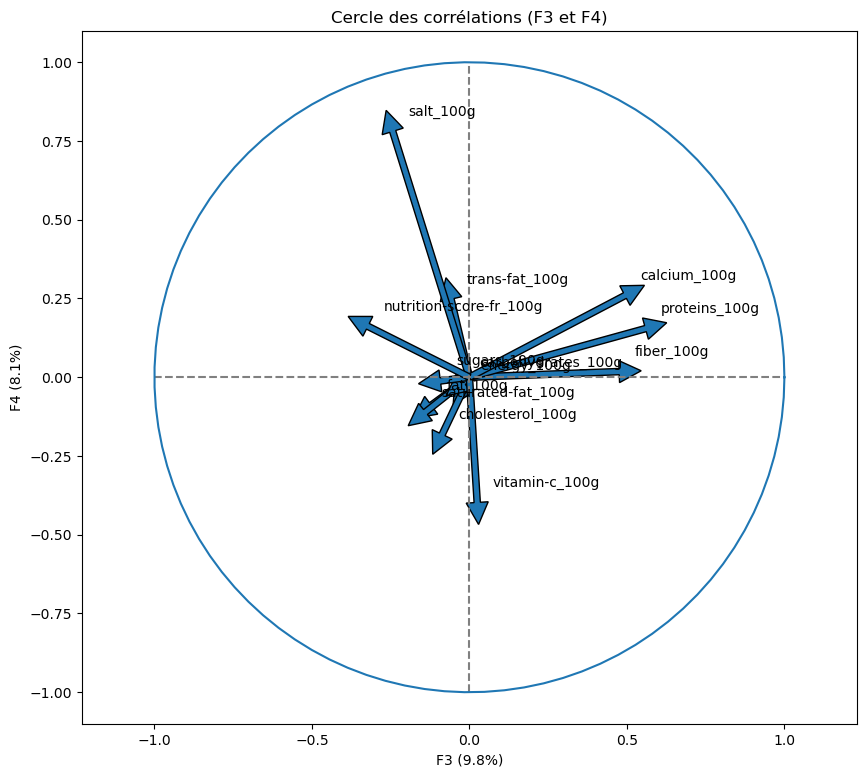

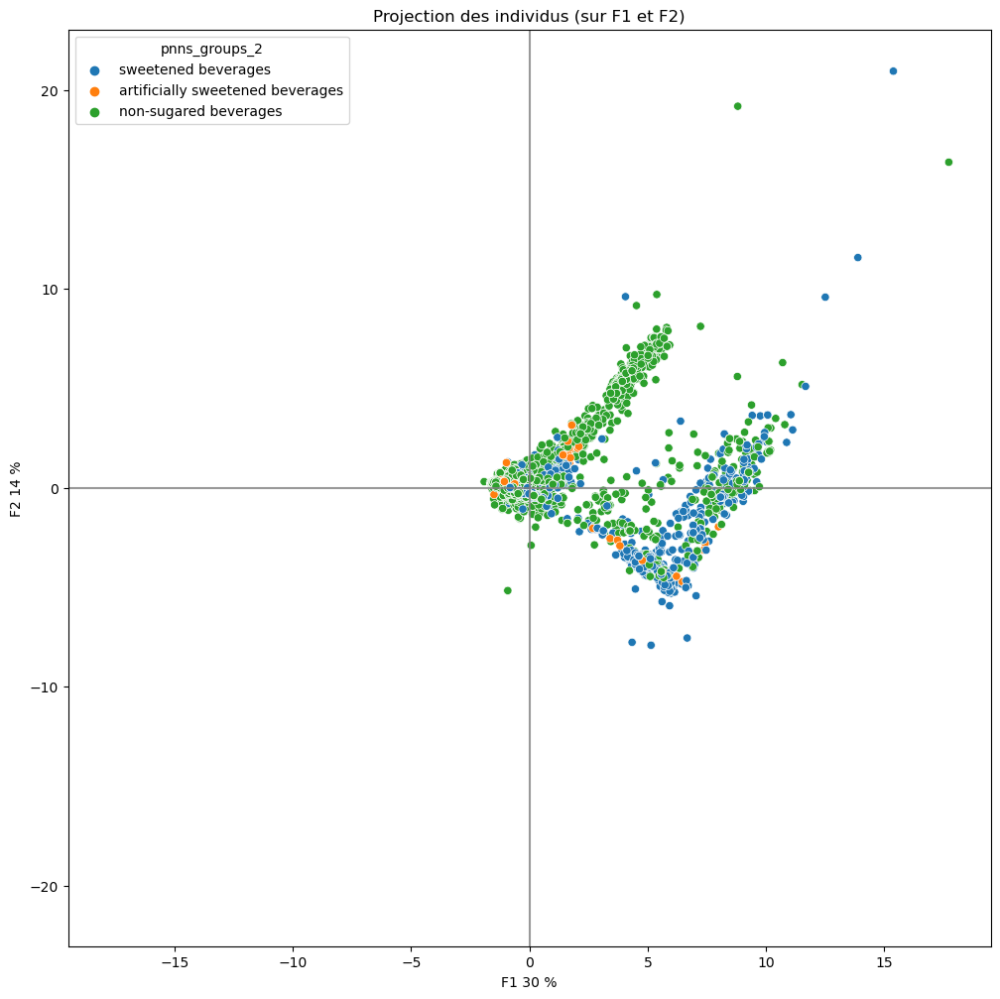

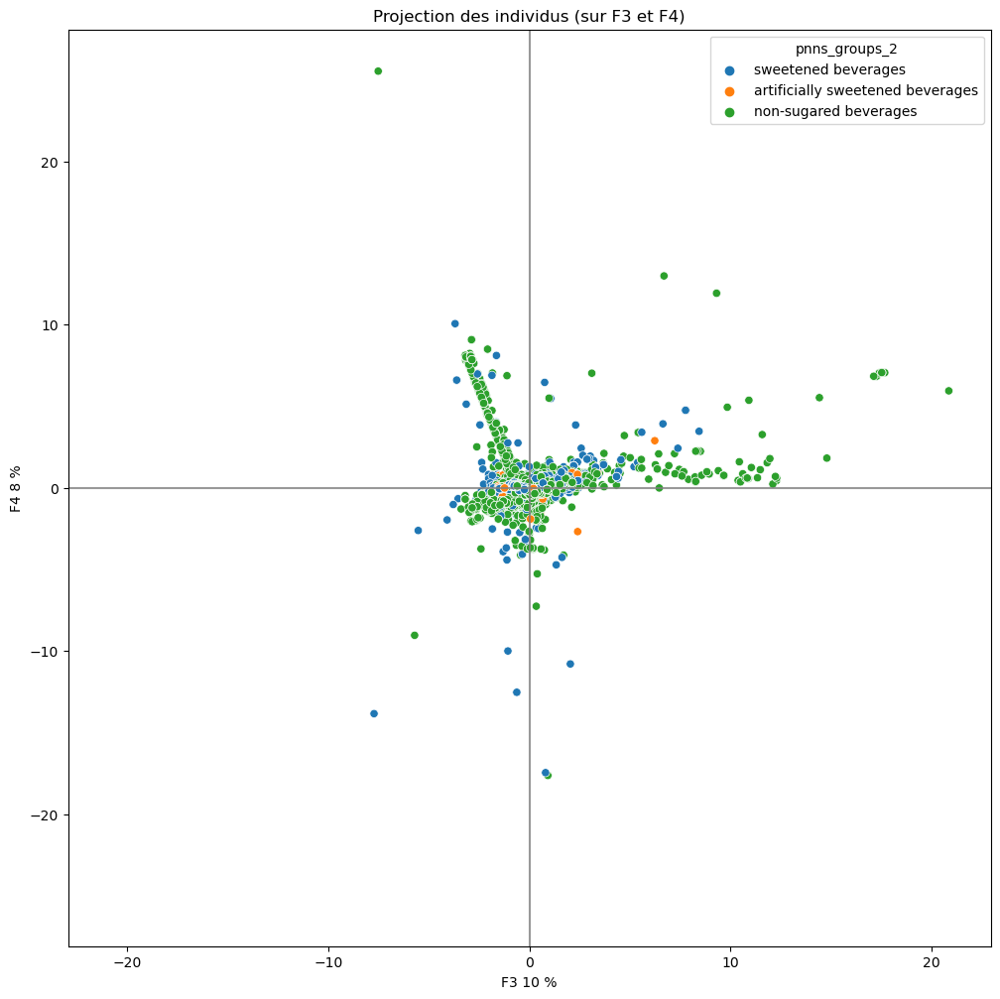

fat and sauces


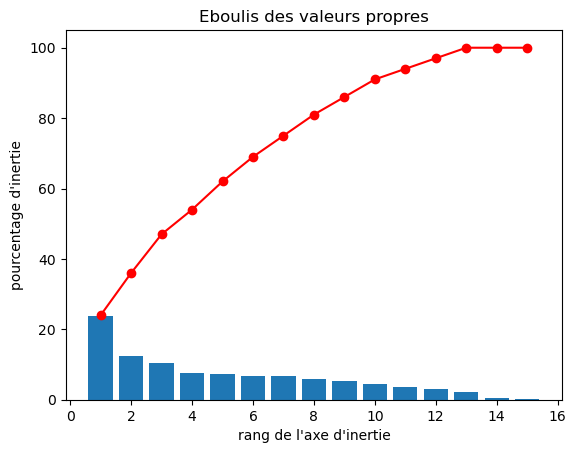

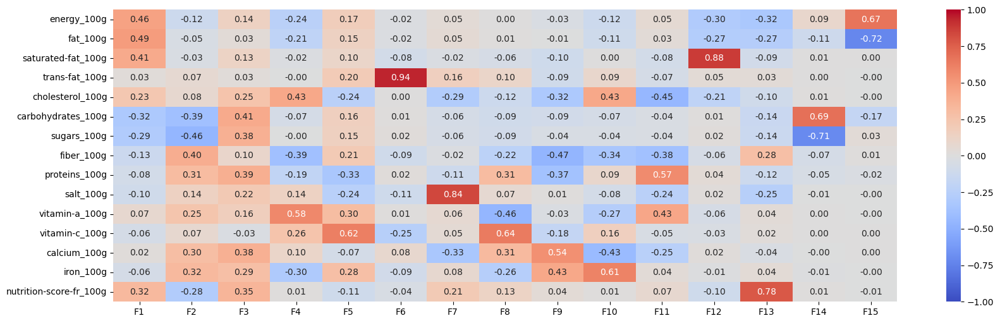

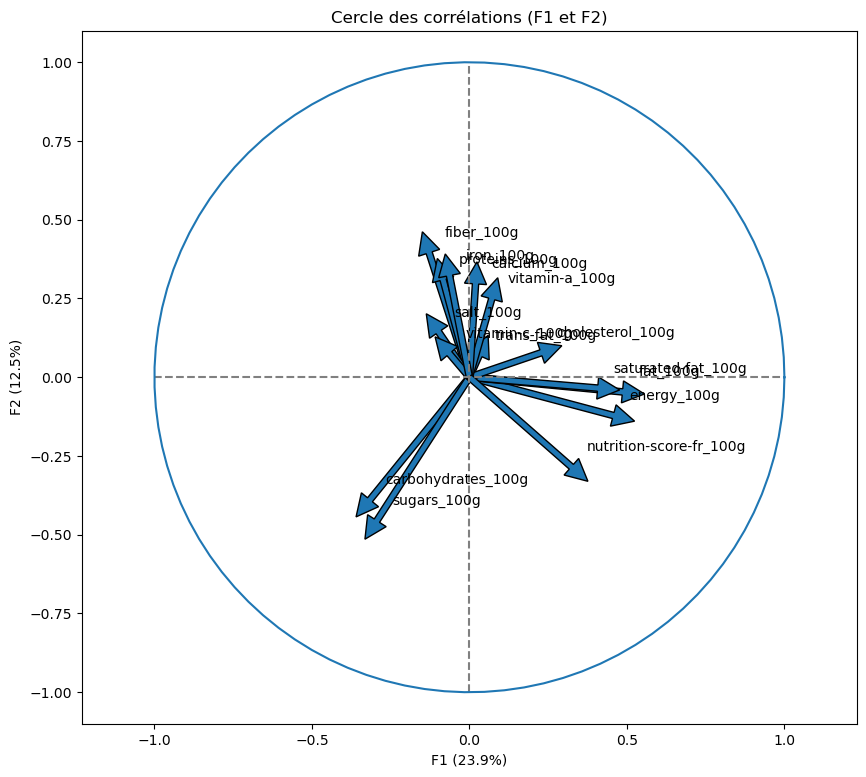

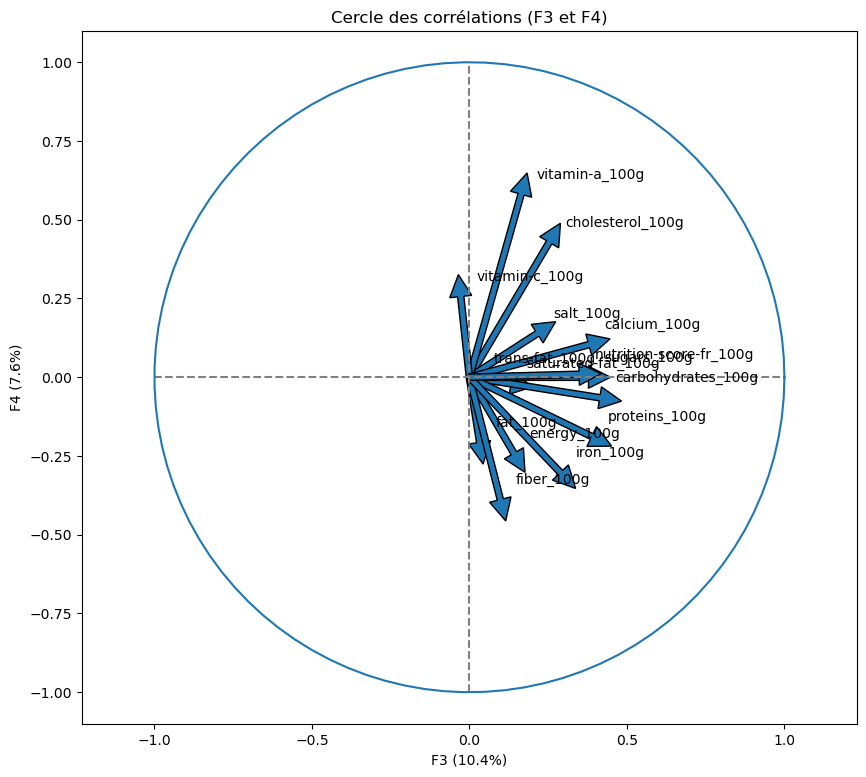

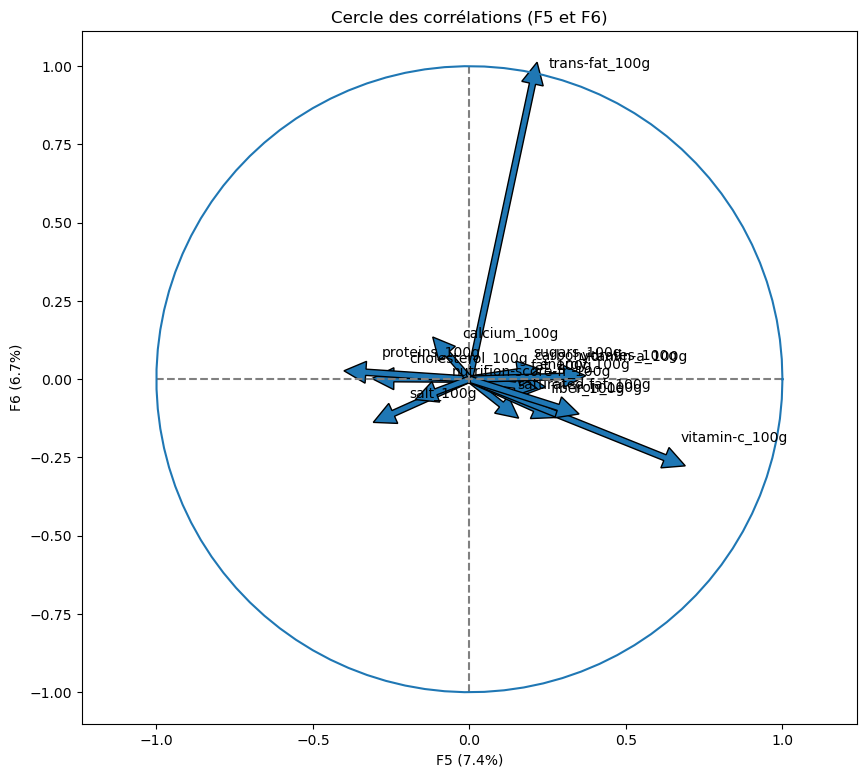

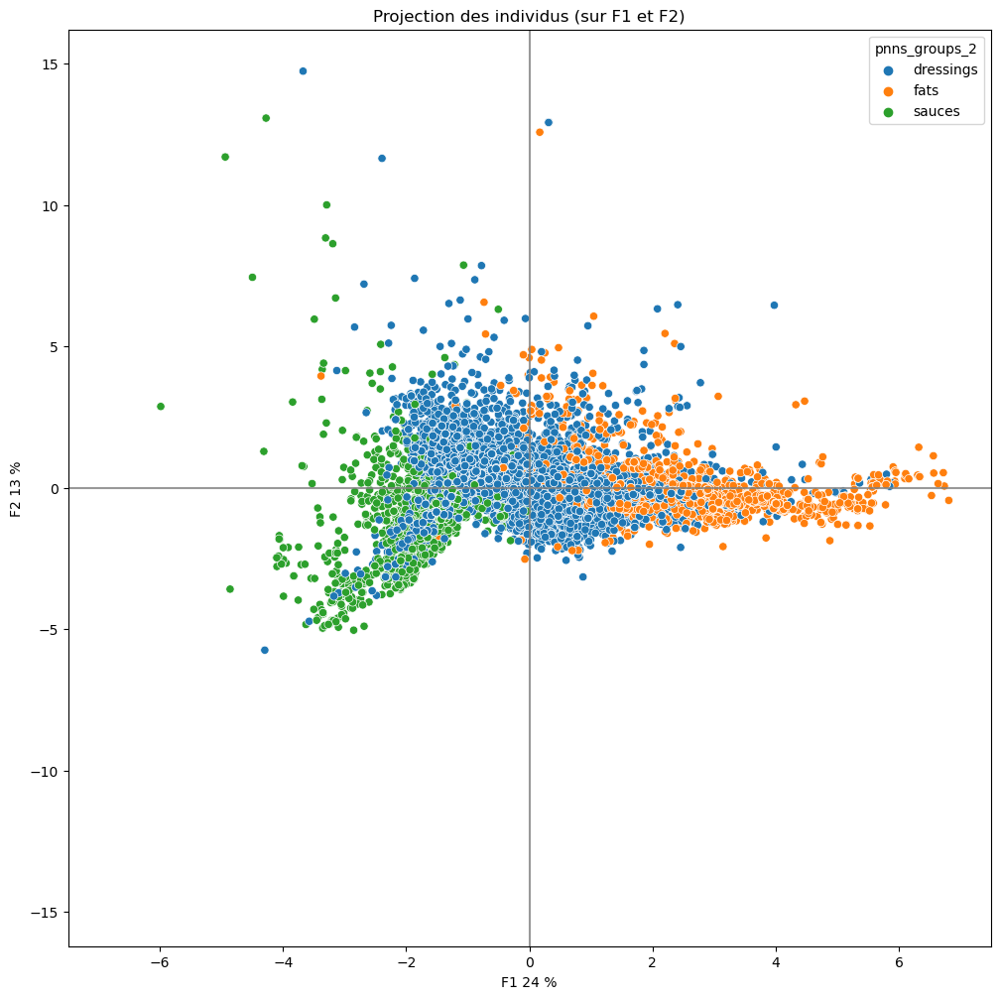

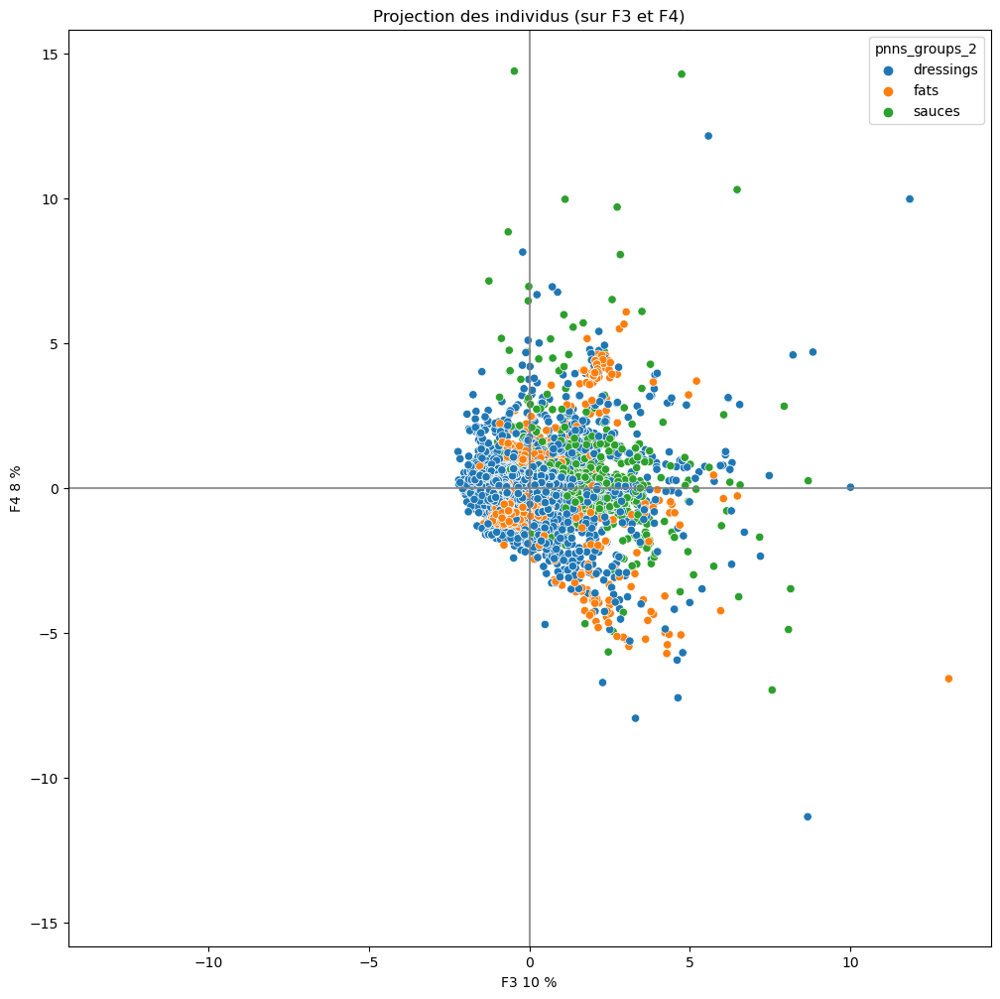

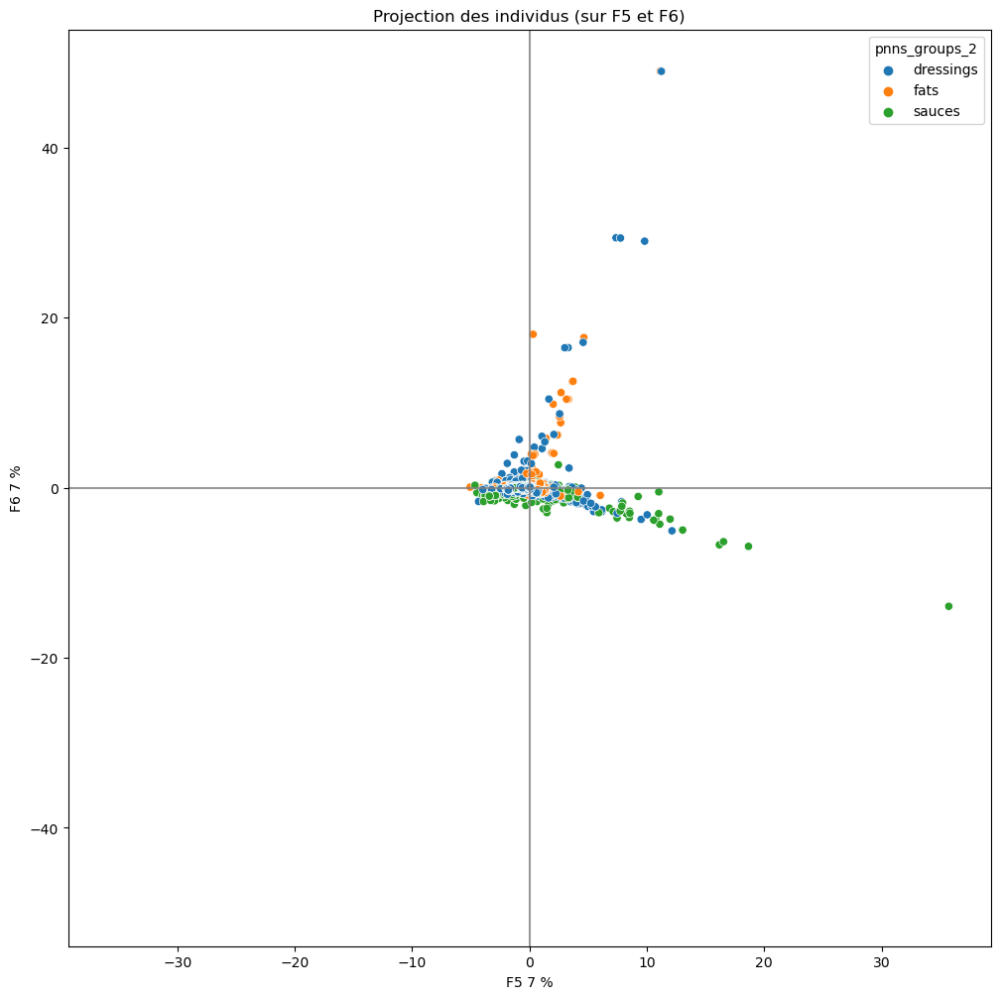

In [102]:
for pnns1 in data.loc[data["pnns_groups_1"].notnull(), "pnns_groups_1"].unique():
    print(pnns1)
    sous_data = data[data["pnns_groups_1"] == pnns1]
    ACP_generator(sous_data, "pnns_groups_2")
    

### <a name = "T4C11">11. pnns2 : pourcentage d'erreur de remplissage </a>

In [103]:
# On transforme la liste en dataframe et on trie par % erreur
erreur_pnns = pd.DataFrame(erreur_pnns, columns = ["pnns_groups_1", "erreur"]).sort_values("erreur", ascending = False)

display(erreur_pnns)
# Pourcentage d'erreur moyen (il faudrait pondéré par le nombre de lignes / pnns1)
erreur_pnns.mean()

,pnns_groups_1,erreur
7,beverages,14.923354
3,fish meat eggs,8.172871
1,cereals and potatoes,7.767150
0,sugary snacks,7.407985
6,milk and dairy products,6.504316
5,composite foods,6.343476
4,fruits and vegetables,3.382221
8,fat and sauces,3.125000
2,salty snacks,2.747253


C:\Users\33664\AppData\Local\Temp\ipykernel_9052\3435765771.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  erreur_pnns.mean()


erreur    6.708181
dtype: float64

Représentation du pourcentage d'erreur de remplissage des pnns2 par pnns1

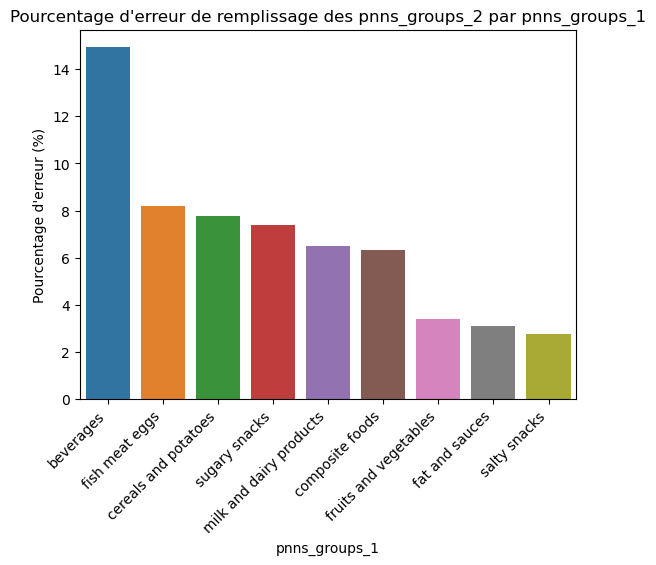

In [104]:
# Représentation par bar plot du pourcentage d'erreur après triage décroissant.
sns.barplot(data = erreur_pnns.sort_values("erreur", ascending = False), x = "pnns_groups_1", y = "erreur")

plt.ylabel("Pourcentage d'erreur (%)")
plt.xticks(rotation=45, ha='right')
plt.title("Pourcentage d'erreur de remplissage des pnns_groups_2 par pnns_groups_1")

plt.show()

In [105]:
[ pnns for pnns in erreur_pnns["pnns_groups_1"].unique()]


['beverages',
 'fish meat eggs',
 'cereals and potatoes',
 'sugary snacks',
 'milk and dairy products',
 'composite foods',
 'fruits and vegetables',
 'fat and sauces',
 'salty snacks']

In [106]:
# On compte le nombre de pnns_groups_1 non null avec un pnns2 non null.
pnns_count = data[data.pnns_groups_2.notnull()].groupby("pnns_groups_1")["pnns_groups_1"].count()
display(pnns_count)

# On créé une colonne qui contiendra le nombre d'erreurs par pnns1
erreur_pnns["erreur_n"] = np.nan

# On rempli la colonne
for pnns in erreur_pnns["pnns_groups_1"].unique():
    erreur_pnns["erreur_n"] = erreur_pnns["erreur_n"].combine_first(erreur_pnns.loc[erreur_pnns["pnns_groups_1"] == pnns, "erreur"] * pnns_count[pnns])

erreur_pnns["erreur_n"] = erreur_pnns["erreur_n"] / 100

display(erreur_pnns)

erreur_totale = erreur_pnns["erreur_n"].sum() / pnns_count.sum() * 100

print("Pourcentage d'erreur total du remplissage des pnns_groups_2 :", round(erreur_totale, 2))

pnns_groups_1
beverages                  15445
cereals and potatoes       33580
composite foods            22737
fat and sauces             12308
fish meat eggs             17359
fruits and vegetables      14856
milk and dairy products    27484
salty snacks               13371
sugary snacks              46739
Name: pnns_groups_1, dtype: int64

,pnns_groups_1,erreur,erreur_n
7,beverages,14.923354,2304.912083
3,fish meat eggs,8.172871,1418.728712
1,cereals and potatoes,7.767150,2608.209103
0,sugary snacks,7.407985,3462.418122
6,milk and dairy products,6.504316,1787.646116
5,composite foods,6.343476,1442.316142
4,fruits and vegetables,3.382221,502.462736
8,fat and sauces,3.125000,384.625000
2,salty snacks,2.747253,367.335165


Pourcentage d'erreur total du remplissage des pnns_groups_2 : 7.0


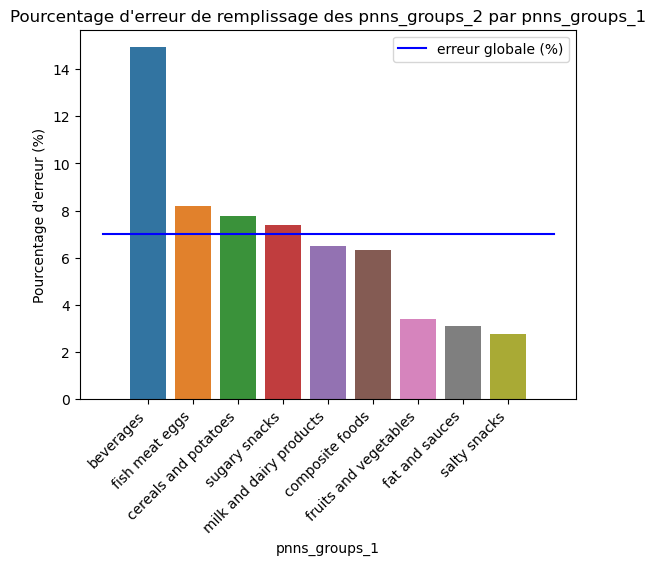

In [107]:
# Représentation par bar plot du pourcentage d'erreur après triage décroissant.
sns.barplot(data = erreur_pnns.sort_values("erreur", ascending = False), x = "pnns_groups_1", y = "erreur")
x = [-1, erreur_pnns.shape[0]]
y = [erreur_totale, erreur_totale]
plt.plot(x, y, color='b', label='erreur globale (%)')

plt.ylabel("Pourcentage d'erreur (%)")
plt.xticks(rotation=45, ha='right')
plt.title("Pourcentage d'erreur de remplissage des pnns_groups_2 par pnns_groups_1")
plt.legend()

plt.show()

On a un très bon score de remplissage des pnns_groups_2, avec une erreur globale autour des 7 %. Allant de 14 % pour les beverages à 3 % pour les salty snacks et fat and sauces.

***
# <a name="T5">Remplissage des valeurs manquantes</a>

### <a name = "T5C1">1. Remplissage des pnns_groups_1 manquants </a>

In [108]:
nb_pnns1_null = data[data.pnns_groups_1.isnull()].shape[0]
nb_pnns2_null = data[data.pnns_groups_2.isnull()].shape[0]

print("Il reste %d valeurs manquantes pour les pnns_groups_1" %nb_pnns1_null)
print("Il reste %d valeurs manquantes pour les pnns_groups_2" %nb_pnns2_null)

Il reste 41024 valeurs manquantes pour les pnns_groups_1
Il reste 41992 valeurs manquantes pour les pnns_groups_2


Il y a 0 lignes où nous ne retrouvons aucune valeur entrée
Statistiques sur la complétude des données :


count    41024.000000
mean        75.333341
std         10.473304
min         50.000000
25%         62.500000
50%         75.000000
75%         87.500000
max         87.500000
dtype: float64

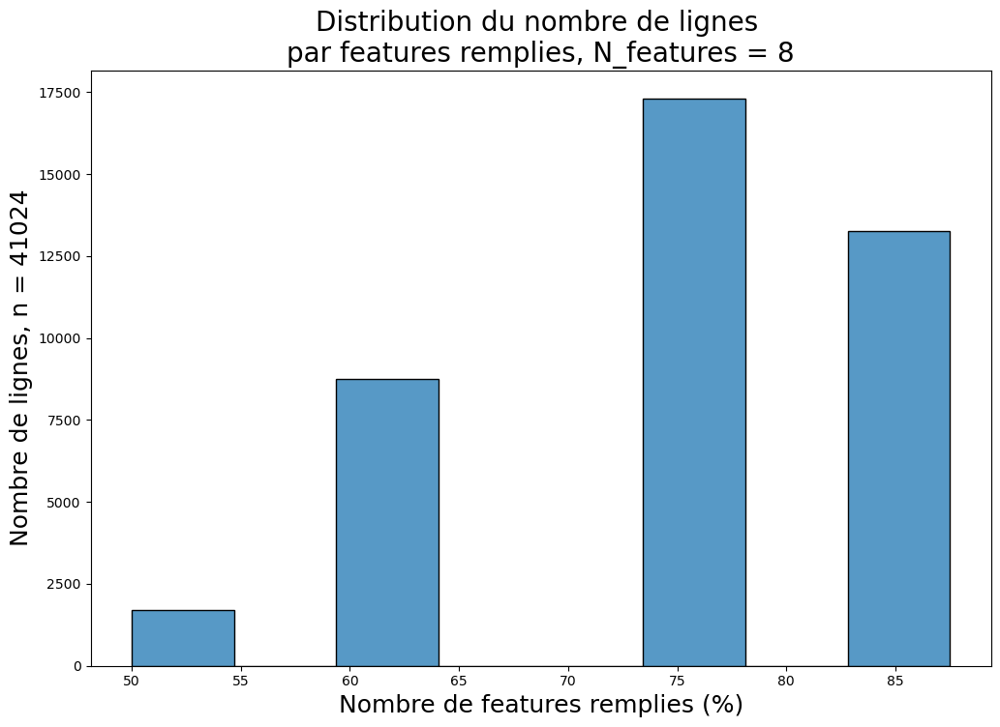

Il y a 0 lignes où nous ne retrouvons aucune valeur entrée
Statistiques sur la complétude des données :


count    41992.000000
mean        75.495928
std         10.560964
min         50.000000
25%         62.500000
50%         75.000000
75%         87.500000
max         87.500000
dtype: float64

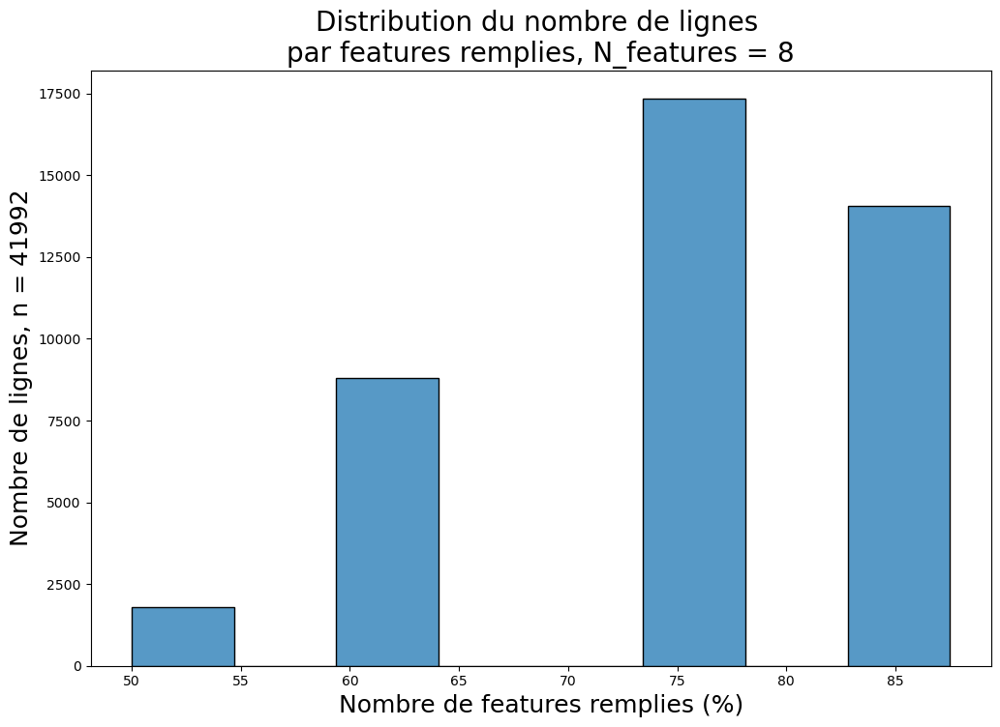

In [109]:
valeurs_manquantes_graph(data[data.pnns_groups_1.isnull()][liste_feat_simple],"row")
valeurs_manquantes_graph(data[data.pnns_groups_2.isnull()][liste_feat_simple],"row")

Les pnns 2 qui n'ont pas pu être remplis sont les mêmes que les pnns 1, dû à des données manquantes.

Il faudra donc remplir ces données pour remplir les pnns.

On va remplir soit par la moyenne, médiane ou avec un KNN.

On évaluera laquelle de ces méthodes entraînent le moins d'erreur et on implémentera à l'ensemble des données.

In [110]:
## Fonction permettant de retourner une liste de listes d'indexes choisies au hasard

def tabIndex(df, nb_taille):
    ## nb_taille = taille des groupes 
    
    mask = copy.deepcopy(df)
    
    liste_index = []
    
    #On parcours le dataframe tant qu'il y a des lignes et inférieur à nb_taille
    i = 0
    # Pour éviter une boucle infinie
    while (mask.shape[0] > nb_taille) & (i < 500) :
        # On ajoute à la liste
        liste_index.append(mask.sample(nb_taille).index)
        
        # On actualise le dataframe sans les lignes sélectionnées
        mask = mask[~mask.index.isin(liste_index[-1])]
        i += 1
    # On ajoute les dernière lignes
    if (mask.shape[0] > 0) & (mask.shape[0] < nb_taille):
        liste_index.append(mask.index)
    
    return liste_index
    


In [111]:
## Fonction permettant de remplir les valeurs manquantes (features) avec KNNImputer
## En utilisant les groupements par pnns_groups

def remplissage_value_knn_pnns (df, pnns_type, feature, type = 1):
    ## type == 0, quand nous n'avons pas toutes les informations sur les pnns_groups
    ## type == 1, quand il n'y a pas de valeurs nulles
    
    ## On utilise un n_neighbors de 3
    imputer = KNNImputer(n_neighbors = 3)
    
    if type == 0:
        
        # On découpe en plusieurs slice, car ça peut prendre du temps
        liste_df = tabIndex(df, 20000)
        for i, indexes in enumerate(liste_df):
            print("Slice :", i + 1,"/", len(liste_df))
            mask = copy.deepcopy(df[df.index.isin(indexes)])
            
            # On remplace toute les valeurs nulles et on obtient un dataframe
            df_remplacement = imputer.fit_transform(mask[feature])

            # On transforme en dataframe avec nos colonnes d'intérêts
            df_remplacement = pd.DataFrame(df_remplacement, columns = feature)

            # On ajoute les index
            df_remplacement.set_index(mask.index, inplace = True)

            # On actualise df
            df[feature] = df[feature].combine_first(df_remplacement[feature])
            
    elif type == 1:
        
        for i, pnns in enumerate(df[df[pnns_type].notnull()][pnns_type].unique()):
            print("pnns :", pnns, i+1,"/",df[pnns_type].unique().shape[0])
            
            # On sélection un slice contenant l'ensemble des données du pnns_groups
            mask = df[(df[pnns_type] == pnns)]

            # On remplace toute les valeurs nulles et on obtient un dataframe
            df_remplacement = imputer.fit_transform(mask[feature])

            # On transforme en dataframe avec nos colonnes d'intérêts
            df_remplacement = pd.DataFrame(df_remplacement, columns = feature)

            # On ajoute les index
            df_remplacement.set_index(mask.index, inplace = True)

            # On actualise df
            df[feature] = df[feature].combine_first(df_remplacement[feature])
        
    # On renvoie le dataframe de remplacement
    return df

On rempli les valeurs manquantes par un knn en utilisant le groupage par pnns_groups_1.

In [112]:
df_knn = copy.deepcopy(data)

df_knn = (
    df_knn.combine_first(
        remplissage_value_knn_pnns(df_knn, "pnns_groups_1", liste_feat_simple, 0)))


Slice : 1 / 13
Slice : 2 / 13
Slice : 3 / 13
Slice : 4 / 13
Slice : 5 / 13
Slice : 6 / 13
Slice : 7 / 13
Slice : 8 / 13
Slice : 9 / 13
Slice : 10 / 13
Slice : 11 / 13
Slice : 12 / 13
Slice : 13 / 13


In [113]:
display(df_knn[liste_feat_simple].isnull().sum())
display(data[liste_feat_simple].isnull().sum())

energy_100g                0
fat_100g                   0
nutrition-score-fr_100g    0
carbohydrates_100g         0
salt_100g                  0
sugars_100g                0
fiber_100g                 0
proteins_100g              0
dtype: int64

energy_100g                    0
fat_100g                    2332
nutrition-score-fr_100g    35110
carbohydrates_100g          1131
salt_100g                   5419
sugars_100g                14052
fiber_100g                 55631
proteins_100g               1109
dtype: int64

Nous n'avons plus de valeurs nulles 

On créé un tableau de moyenne et median pour chaque feature par pnns_groups_1

In [114]:
tableau_mean = ([[pnns, feat, round(data.loc[data.pnns_groups_1 == pnns][feat].mean(), 2)] 
                 for pnns in data.pnns_groups_1.unique() 
                 for feat in liste_feat_simple])
tableau_median = ([[pnns, feat, round(data.loc[data.pnns_groups_1 == pnns][feat].median(), 2)] 
                 for pnns in data.pnns_groups_1.unique() 
                 for feat in liste_feat_simple])


# On transforme en dataframe
tableau_mean = pd.DataFrame(tableau_mean, columns = ["pnns", "feat", "mean"])
tableau_median = pd.DataFrame(tableau_median, columns = ["pnns", "feat", "median"])

On vérifie que nous avons bien créé nos tableaux.

In [115]:
display(tableau_mean)
display(tableau_median)

,pnns,feat,mean
0,sugary snacks,energy_100g,1755.14
1,sugary snacks,fat_100g,17.83
2,sugary snacks,nutrition-score-fr_100g,17.55
3,sugary snacks,carbohydrates_100g,59.94
4,sugary snacks,salt_100g,0.68
...,...,...,...
75,fat and sauces,carbohydrates_100g,12.08
76,fat and sauces,salt_100g,2.44
77,fat and sauces,sugars_100g,8.23
78,fat and sauces,fiber_100g,1.02


,pnns,feat,median
0,sugary snacks,energy_100g,1795.00
1,sugary snacks,fat_100g,18.00
2,sugary snacks,nutrition-score-fr_100g,18.00
3,sugary snacks,carbohydrates_100g,59.90
4,sugary snacks,salt_100g,0.37
...,...,...,...
75,fat and sauces,carbohydrates_100g,7.30
76,fat and sauces,salt_100g,1.40
77,fat and sauces,sugars_100g,3.70
78,fat and sauces,fiber_100g,0.00


In [116]:
# Fonction remplaçant la valeur manquante en utilisant une table de correspondance
def remplacement_valeur(df, tableau, remplacement, pnns, feature):
    
    mask = tableau[tableau["pnns"] == pnns]
    
    # on créé un dictionnaire pour faire remplacement
    dict_lookup = dict(zip(mask["feat"], mask[remplacement]))
    
    for feat in feature:
        df.loc[df[feat].isnull(), feat] = dict_lookup[feat]
    
    return df


In [117]:
## Fonction permettant de remplir les derniers knn et de récupérer le pourcentage d'erreur
## Version adaptée

def knn_last_pnns(df, liste_feat_simple, pnns_groups):
    
    df_originel = copy.deepcopy(df)
    
    # Première étape - affinage - simple# 
    print("Etape 1")
    dataframe_remplissage1 = remplissage_last_knn(df_originel, pnns_groups, liste_feat_simple)

    # Deuxième étape - remplissage global simple #
    print("Etape 2")
    dataframe_remplissage2 = remplissage_last_knn(df_originel, pnns_groups, liste_feat_simple, False)  
    
    # On complète df par les valeurs du dataframe 1 puis 2
    df = df.combine_first(dataframe_remplissage1)
    df = df.combine_first(dataframe_remplissage2)
    
    ## On renvoie le df modifié et l'erreur associée au remplissage
    return df
    

In [118]:
## version adaptée
def knn_last_pnns_simple(df, liste_feat, type_pnns):
    # Création  d'une liste  contenant les prédictions 
    prediction = []

    pnns_group = df.loc[~df[type_pnns].isnull(),type_pnns]
    # On va faire une prédiction pour chaque pnns
    for i, pnns in enumerate(pnns_group.unique()):

        #clear_output(wait=True)
        print(type_pnns,": ", pnns)
        print(i+1, "/", len(pnns_group.unique()))

        # on copie notre dataframe
        dt = copy.deepcopy(df.loc[~df[type_pnns].isnull()])

        # On remplace le pnns1 des autres, pour n'avoir que 2 valeurs possibles
        dt.loc[dt[type_pnns] != pnns, type_pnns] = "Autre"

        # Données préliminaires ont montré qu'un knn = 3 était satisfaisant
        knn = neighbors.KNeighborsClassifier(n_neighbors=3)

        # On entraîne notre modèle sur l'ensemble des données
        knn.fit(dt[liste_feat], dt[type_pnns])

        # On fait la prédiction sur l'ensemble des données
        prediction.append([df.index, pnns, knn.predict(df[liste_feat])])

    #Etapes de réduction de la liste

    prediction = [[prediction[j][1], prediction[j][0][i], prediction[j][2][i]] for j in range(len(prediction)) for i in range(len(prediction[j][0]))]
    # Transformation en DataFrame
    prediction = pd.DataFrame(prediction, columns = [type_pnns,"Indexes","Prediction"])
    # Elimination des prédictions "Autre"
    prediction = prediction.loc[prediction["Prediction"] != "Autre"]
    # Elimination des prédictions quand il y en a plusieurs de proposé
    prediction = prediction.drop_duplicates(subset= "Indexes")
    # On fait le remplacement sur les valeurs nulles
    df = knn_pnn_remplacement(df, prediction, type_pnns)
    
    return df
    

In [119]:
# Fonction permettant de créer les models knn.
def pnns_model(df, liste_feat, type_pnns): 
    
    pnns_group = df.loc[~df[type_pnns].isnull(),type_pnns]
    models = []
    
    # On va faire une prédiction pour chaque pnns
    for i, pnns in enumerate(pnns_group.unique()):

        #clear_output(wait=True)
        print(type_pnns,": ", pnns)
        print(i+1, "/", len(pnns_group.unique()))

        # on copie notre dataframe
        dt = copy.deepcopy(df.loc[~df[type_pnns].isnull()])

        # On remplace le pnns1 des autres, pour n'avoir que 2 valeurs possibles
        dt.loc[dt[type_pnns] != pnns, type_pnns] = "Autre"

        # Données préliminaires ont montré qu'un knn = 3 était satisfaisant
        knn = neighbors.KNeighborsClassifier(n_neighbors=3)

        # On entraîne notre modèle sur l'ensemble des données
        models.append([pnns, knn.fit(dt[liste_feat], dt[type_pnns])])

    return models

In [120]:
#Version adaptée

def knn_last_pnns_global(df, liste_feat, type_pnns):

    # on copie notre dataframe
    dt = copy.deepcopy(df.loc[~df[type_pnns].isnull()])

    # Données préliminaires ont montré qu'un knn = 3 était satisfaisant
    knn = neighbors.KNeighborsClassifier(n_neighbors=3)

    # On entraîne notre modèle 
    knn.fit(dt[liste_feat], dt[type_pnns])

    error = (1 - knn.score(xtest, ytest)) * 100

    # On fait la prédiction sur l'ensemble des données
    prediction = [df.index, knn.predict(df[liste_feat])]
    
    # Transformation
    prediction = np.array(prediction).T.tolist()
    
    # Transformation en DataFrame
    prediction = pd.DataFrame(prediction, columns = ["Indexes","Prediction"])
    
    # On fait le remplacement sur les valeurs nulles
    df = knn_pnn_remplacement(df, prediction, type_pnns)
    
    return df

In [121]:
## version adaptée
def remplissage_last_knn(df, pnns, liste_feat, simple = True):
    
    # On créé une copie de notre dataframe pour le remplissage
    dataframe_remplissage = copy.deepcopy(df)
    # On met à 0 le pnns_group
    dataframe_remplissage[pnns] = np.nan
    
    # On ne prend en compte que les lignes où les features sont remplies à 100 %
    condition = df[liste_feat].isnull().sum(axis = 1) == 0
    
    if(simple == True):
        ## On appel notre fonction pour remplir notre pnns groupe.
        dataframe_remplis = knn_last_pnns_simple(df[condition], liste_feat, pnns)
    else :
        dataframe_remplis = knn_last_pnns_global(df[condition], liste_feat, pnns) 
        
    ## Puis on remplace les valeurs manquantes sur notre dataframe
    dataframe_remplissage = dataframe_remplissage.combine_first(dataframe_remplis)
    
    return dataframe_remplissage

On rempli les pnns_groups_1 pour les méthodes knn, mean et median

In [122]:
df_knn = knn_last_pnns(df_knn, liste_feat_simple, "pnns_groups_1")

Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


38768 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées


In [123]:
liste_df_mean = []
for i, pnns in enumerate(data[data.pnns_groups_1.notnull()]["pnns_groups_1"].unique()):
    
    rempla = copy.deepcopy(data)
    
    liste_df_mean.append([pnns, remplacement_valeur(rempla, tableau_mean, "mean", pnns, liste_feat_simple)])
    liste_df_mean[i][1] = knn_last_pnns(liste_df_mean[i][1], liste_feat_simple, "pnns_groups_1")    

Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


37328 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


37625 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


37561 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


38007 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


37956 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


38057 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


37786 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


38052 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


37834 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées


In [124]:
liste_df_median = []
for i, pnns in enumerate(data[data.pnns_groups_1.notnull()]["pnns_groups_1"].unique()):
    
    rempla = copy.deepcopy(data)
    
    liste_df_median.append([pnns, remplacement_valeur(rempla, tableau_median, "median", pnns, liste_feat_simple)])
    liste_df_median[i][1] = knn_last_pnns(liste_df_median[i][1], liste_feat_simple, "pnns_groups_1") 
    

Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


37426 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


37974 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


37658 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


38012 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


38169 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


38035 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


37935 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


38137 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées
Etape 1
pnns_groups_1 :  sugary snacks
1 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  cereals and potatoes
2 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  salty snacks
3 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fish meat eggs
4 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fruits and vegetables
5 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  composite foods
6 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  milk and dairy products
7 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  beverages
8 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_1 :  fat and sauces
9 / 9


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


37952 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

41024 lignes modifiées


Vérifions que ça a bien été rempli

In [125]:
test = copy.deepcopy(data)

In [126]:
data["pnns_groups_1"]

0                sugary snacks
1         cereals and potatoes
2                 salty snacks
3                          NaN
4                          NaN
                  ...         
247337          fat and sauces
247338    cereals and potatoes
247339    cereals and potatoes
247340            salty snacks
247341            salty snacks
Name: pnns_groups_1, Length: 245871, dtype: object

In [127]:
liste_df_median[0][1]["pnns_groups_1"]

0                sugary snacks
1         cereals and potatoes
2                 salty snacks
3         cereals and potatoes
4                 salty snacks
                  ...         
247337          fat and sauces
247338    cereals and potatoes
247339    cereals and potatoes
247340            salty snacks
247341            salty snacks
Name: pnns_groups_1, Length: 245871, dtype: object

Regardons comment le remplissage des features a affecté le remplissage des pnns

In [128]:
#On récupère les index des pnns null

index_null = data[data.pnns_groups_1.isnull()].index

In [129]:
# On rassemble les pnns dans un seul dataframe 

# On initialise avec le premier
liste_df_mean_total = liste_df_mean[0][1].loc[liste_df_mean[0][1].index.isin(index_null), "pnns_groups_1"]
liste_df_median_total = liste_df_median[0][1].loc[liste_df_median[0][1].index.isin(index_null), "pnns_groups_1"]

for i in range(1, len(liste_df_mean)):
    # On rajoute au fur et à mesure les autres
    liste_df_mean_total = pd.concat([liste_df_mean_total,liste_df_mean[i][1].loc[liste_df_mean[i][1].index.isin(index_null), "pnns_groups_1"]], axis = 1)
    liste_df_median_total = pd.concat([liste_df_median_total,liste_df_median[i][1].loc[liste_df_median[i][1].index.isin(index_null), "pnns_groups_1"]], axis = 1)
liste_df_mean_total.columns = [liste_df_mean[i][0] for i in range(0, len(liste_df_mean))] 
liste_df_median_total.columns = [liste_df_median[i][0] for i in range(0, len(liste_df_median))] 
display(liste_df_mean_total)


,sugary snacks,cereals and potatoes,salty snacks,fish meat eggs,fruits and vegetables,composite foods,milk and dairy products,beverages,fat and sauces
3,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes
4,salty snacks,composite foods,salty snacks,composite foods,composite foods,composite foods,composite foods,composite foods,composite foods
6,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks
8,sugary snacks,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes
9,cereals and potatoes,cereals and potatoes,composite foods,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes
...,...,...,...,...,...,...,...,...,...
247268,beverages,beverages,beverages,beverages,beverages,beverages,fruits and vegetables,beverages,beverages
247306,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks
247307,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks
247332,composite foods,composite foods,composite foods,composite foods,composite foods,composite foods,composite foods,composite foods,composite foods


On compte l'occurence pour chaque pnns par index.

In [130]:
liste_df_mean_total_count = liste_df_mean_total.stack().groupby(level=0).value_counts().unstack(fill_value=0)
liste_df_median_total_count = liste_df_median_total.stack().groupby(level=0).value_counts().unstack(fill_value=0)

On garde l'occurence maximum

In [131]:
liste_df_mean_total_count["Max"] = liste_df_mean_total_count.max(axis = 1)
liste_df_median_total_count["Max"] = liste_df_median_total_count.max(axis = 1)

On affiche la distribution 

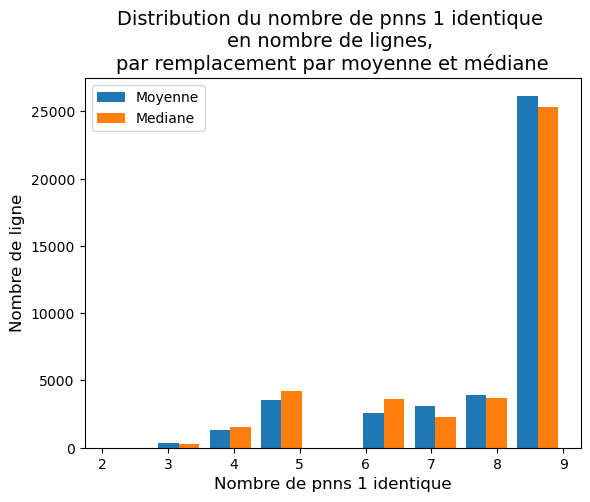

In [132]:
x = liste_df_mean_total_count["Max"]
y = liste_df_median_total_count["Max"]

plt.hist([x, y], bins = 9, label=['Moyenne', 'Mediane'])
plt.legend()

plt.title("Distribution du nombre de pnns 1 identique \nen nombre de lignes, \npar remplacement par moyenne et médiane", size = 14)
plt.xlabel("Nombre de pnns 1 identique", size = 12)
plt.ylabel("Nombre de ligne", size = 12)
plt.show()

On retrouve la même distribution si on utilise la moyenne ou la médiane, avec plus de certitude avec la médiane (8 et 9).

Retrouvons nous les mêmes pnns ?

In [133]:
liste_df_mean_total_count.columns

Index(['beverages', 'cereals and potatoes', 'composite foods',
       'fat and sauces', 'fish meat eggs', 'fruits and vegetables',
       'milk and dairy products', 'salty snacks', 'sugary snacks', 'Max'],
      dtype='object')

In [134]:
liste_df_mean_total_count["pnns_max"] = np.nan
for col in liste_df_mean_total_count.columns:
    if col != "Max":
        liste_df_mean_total_count.loc[liste_df_mean_total_count[col]  == liste_df_mean_total_count["Max"],"pnns_max"] = col
        liste_df_median_total_count.loc[liste_df_median_total_count[col]  == liste_df_median_total_count["Max"],"pnns_max"] = col

display(liste_df_mean_total_count)
display(liste_df_median_total_count)


,beverages,cereals and potatoes,composite foods,fat and sauces,fish meat eggs,fruits and vegetables,milk and dairy products,salty snacks,sugary snacks,Max,pnns_max
3,0,9,0,0,0,0,0,0,0,9,cereals and potatoes
4,0,0,7,0,0,0,0,2,0,7,composite foods
6,0,0,0,0,0,0,0,0,9,9,sugary snacks
8,0,8,0,0,0,0,0,0,1,8,cereals and potatoes
9,0,8,1,0,0,0,0,0,0,8,cereals and potatoes
...,...,...,...,...,...,...,...,...,...,...,...
247268,8,0,0,0,0,1,0,0,0,8,beverages
247306,0,0,0,0,0,0,0,0,9,9,sugary snacks
247307,0,0,0,0,0,0,0,0,9,9,sugary snacks
247332,0,0,9,0,0,0,0,0,0,9,composite foods


,beverages,cereals and potatoes,composite foods,fat and sauces,fish meat eggs,fruits and vegetables,milk and dairy products,salty snacks,sugary snacks,Max,pnns_max
3,0,9,0,0,0,0,0,0,0,9,cereals and potatoes
4,0,0,7,0,0,0,0,2,0,7,composite foods
6,0,0,0,0,0,0,0,0,9,9,sugary snacks
8,0,8,0,0,0,0,0,0,1,8,cereals and potatoes
9,0,9,0,0,0,0,0,0,0,9,cereals and potatoes
...,...,...,...,...,...,...,...,...,...,...,...
247268,7,0,0,0,0,2,0,0,0,7,beverages
247306,0,0,0,0,0,0,0,0,9,9,sugary snacks
247307,0,0,0,0,0,0,0,0,9,9,sugary snacks
247332,0,0,9,0,0,0,0,0,0,9,composite foods


Comparons également au remplissage avec knn

In [135]:
dif = pd.concat([liste_df_mean_total_count["pnns_max"],liste_df_median_total_count["pnns_max"], df_knn[df_knn.index.isin(index_null)]["pnns_groups_1"]],axis = 1)
dif.columns = ["Mean", "Median", "knn"]
dif["equal_3"] = dif.apply(lambda x: x['Mean'] if (x['Mean'] == x['Median']) & (x['Mean'] == x['knn']) else np.nan, axis=1)
dif["equal_2_mean_knn"] = dif.apply(lambda x: x['Mean'] if (x['Mean'] == x['knn']) else np.nan, axis=1)
dif["equal_2_median_knn"] = dif.apply(lambda x: x['Median'] if (x['knn'] == x['Median']) else np.nan, axis=1)
dif["equal_2_mean_median"] = dif.apply(lambda x: x['Mean'] if (x['Mean'] == x['Median'])  else np.nan, axis=1)

equal = dif[dif["equal_3"].notnull()].shape[0]
not_equal = dif[dif["equal_3"].isnull()].shape[0]
print("Entre mean, median et knn, il y a", equal,"résultats similaires et", not_equal,"non similaire")
equal = dif[dif["equal_2_mean_knn"].notnull()].shape[0]
not_equal = dif[dif["equal_2_mean_knn"].isnull()].shape[0]
print("Entre mean et knn, il y a", equal,"résultats similaires et", not_equal,"non similaire")
equal = dif[dif["equal_2_median_knn"].notnull()].shape[0]
not_equal = dif[dif["equal_2_median_knn"].isnull()].shape[0]
print("Entre median et knn, il y a", equal,"résultats similaires et", not_equal,"non similaire")
equal = dif[dif["equal_2_mean_median"].notnull()].shape[0]
not_equal = dif[dif["equal_2_mean_median"].isnull()].shape[0]
print("Entre mean, median, il y a", equal,"résultats similaires et", not_equal,"non similaire")


Entre mean, median et knn, il y a 33681 résultats similaires et 7343 non similaire
Entre mean et knn, il y a 34332 résultats similaires et 6692 non similaire
Entre median et knn, il y a 34912 résultats similaires et 6112 non similaire
Entre mean, median, il y a 38797 résultats similaires et 2227 non similaire


On va donc sélectionner les résultats où il est similaire entre les méthodes knn, mean et mediane.

La méthode par knn pourrait sûrement être plus précise avec un knn réalisé tel que pour la moyenne et médiane.

Mais la méthodologie actuelle présente l'avantage d'être beaucoup plus rapide que les deux autres.

In [136]:
dif

,Mean,Median,knn,equal_3,equal_2_mean_knn,equal_2_median_knn,equal_2_mean_median
3,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes
4,composite foods,composite foods,salty snacks,NaN,NaN,NaN,composite foods
6,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks
8,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes
9,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes,cereals and potatoes
...,...,...,...,...,...,...,...
247268,beverages,beverages,beverages,beverages,beverages,beverages,beverages
247306,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks
247307,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks,sugary snacks
247332,composite foods,composite foods,composite foods,composite foods,composite foods,composite foods,composite foods


In [137]:
liste_index = dif[(dif.equal_3.notnull())].index

print("Nombre de lignes modifiées :", liste_index.shape[0])

Nombre de lignes modifiées : 33681


On remplace les valeurs de pnns1 par les valeurs actualisées. 

In [138]:
# on créé un dictionnaire pour faire remplacement
dict_lookup = dict(zip(dif.index, dif["equal_3"]))

data.loc[data.index.isin(liste_index), "pnns_groups_1"] = pd.Series(dict_lookup)



In [139]:
print("Il ne reste plus que %d produits sans pnns_groups_1 d'affiliés"
      %data.loc[data.pnns_groups_1.isnull(), "pnns_groups_1"].shape[0])

Il ne reste plus que 7343 produits sans pnns_groups_1 d'affiliés


On élimine les produits dont on a pas pu mettre de pnns_groups_1.

In [140]:
print("On passe de %d" %data.shape[0], end = " ")

# On ne garde pas les lignes qui n'ont pas de pnns_groups_1
data = data[data.pnns_groups_1.notnull()]

print("à %d lignes" %data.shape[0])

On passe de 245871 à 238528 lignes


### <a name = "T5C2">2. Remplissage des pnns_groups_2 manquants </a>

Maintenant, nous allons remplir les pnns_groups_2.
- On utilisera une méthode de remplissage des valeurs avant d'affilier et on suivra la même méthodologie que pour le pnns_groups_1.

In [141]:
#Nombre de ligne avec pnns_groups_2 null et pnns_groups_1 non null
print(data[(data.pnns_groups_2.isnull()) & (data.pnns_groups_1.notnull())].shape[0])
#Nombre de ligne avec pnns_groups_2 null et pnns_groups_1 null
print(data[(data.pnns_groups_2.isnull()) & (data.pnns_groups_1.isnull())].shape[0])

34649
0


In [142]:
# on copie notre dataframe
df_mean = copy.deepcopy(data)
df_median = copy.deepcopy(data)
df_knn = copy.deepcopy(data)

pnns_groups =  data["pnns_groups_1"].unique()

# Remplissage des valeurs manquantes selon la moyenne ou median et par pnns groups 1.
# apply + lambda serait plus efficace.
for pnns in pnns_groups:
    for col in liste_feat_simple:
        cond1 = (df_mean[col].isnull()) & (df_mean["pnns_groups_1"] == pnns)
        cond2 = (df_mean[col].notnull()) & (df_mean["pnns_groups_1"] == pnns)
        df_mean.loc[cond1, col] = df_mean.loc[cond2, col].mean()
        
        cond1 = (df_median[col].isnull()) & (df_median["pnns_groups_1"] == pnns)
        cond2 = (df_median[col].notnull()) & (df_median["pnns_groups_1"] == pnns)
        df_median.loc[cond1, col] = df_median.loc[cond2, col].median()
        
# Remplissage des valeurs manquantes selon un knn par pnns_groups 1
df_knn = (
    df_knn.combine_first(
        remplissage_value_knn_pnns(df_knn, "pnns_groups_1", liste_feat_simple)))


pnns : sugary snacks 1 / 9
pnns : cereals and potatoes 2 / 9
pnns : salty snacks 3 / 9
pnns : fruits and vegetables 4 / 9
pnns : fat and sauces 5 / 9
pnns : fish meat eggs 6 / 9
pnns : composite foods 7 / 9
pnns : milk and dairy products 8 / 9
pnns : beverages 9 / 9


On vérifie le remplissage.

In [143]:
display(data[(data.pnns_groups_2.isnull())][liste_feat_simple + ["pnns_groups_1"]])
display(df_mean[(df_mean.pnns_groups_2.isnull())][liste_feat_simple + ["pnns_groups_1"]])
display(df_median[(df_median.pnns_groups_2.isnull())][liste_feat_simple + ["pnns_groups_1"]])
display(df_knn[(df_knn.pnns_groups_2.isnull())][liste_feat_simple + ["pnns_groups_1"]])

,energy_100g,fat_100g,nutrition-score-fr_100g,carbohydrates_100g,salt_100g,sugars_100g,fiber_100g,proteins_100g,pnns_groups_1
3,1552.0,1.43,NaN,77.14,NaN,NaN,5.7,8.57,cereals and potatoes
6,2406.0,37.50,NaN,55.00,NaN,42.5,7.5,5.00,sugary snacks
8,1393.0,1.04,NaN,62.50,NaN,NaN,12.5,22.92,cereals and potatoes
9,1540.0,1.75,NaN,73.68,NaN,NaN,1.8,14.04,cereals and potatoes
12,2536.0,48.48,NaN,15.20,0.57658,NaN,15.2,30.30,salty snacks
...,...,...,...,...,...,...,...,...,...
247298,179.0,0.00,2.0,8.80,0.00000,8.8,NaN,0.70,beverages
247306,2350.0,34.60,28.0,56.10,0.29210,56.1,NaN,6.90,sugary snacks
247307,2350.0,34.60,28.0,56.10,0.29210,56.1,NaN,6.90,sugary snacks
247332,1806.0,18.70,NaN,50.10,NaN,8.9,10.5,9.90,composite foods


,energy_100g,fat_100g,nutrition-score-fr_100g,carbohydrates_100g,salt_100g,sugars_100g,fiber_100g,proteins_100g,pnns_groups_1
3,1552.0,1.43,2.971853,77.14,1.389031,7.618794,5.700000,8.57,cereals and potatoes
6,2406.0,37.50,17.588741,55.00,0.711689,42.500000,7.500000,5.00,sugary snacks
8,1393.0,1.04,2.971853,62.50,1.389031,7.618794,12.500000,22.92,cereals and potatoes
9,1540.0,1.75,2.971853,73.68,1.389031,7.618794,1.800000,14.04,cereals and potatoes
12,2536.0,48.48,12.296200,15.20,0.576580,4.367416,15.200000,30.30,salty snacks
...,...,...,...,...,...,...,...,...,...
247298,179.0,0.00,2.000000,8.80,0.000000,8.800000,0.617394,0.70,beverages
247306,2350.0,34.60,28.000000,56.10,0.292100,56.100000,3.063233,6.90,sugary snacks
247307,2350.0,34.60,28.000000,56.10,0.292100,56.100000,3.063233,6.90,sugary snacks
247332,1806.0,18.70,3.644022,50.10,1.367464,8.900000,10.500000,9.90,composite foods


,energy_100g,fat_100g,nutrition-score-fr_100g,carbohydrates_100g,salt_100g,sugars_100g,fiber_100g,proteins_100g,pnns_groups_1
3,1552.0,1.43,1.0,77.14,0.77216,3.57,5.7,8.57,cereals and potatoes
6,2406.0,37.50,18.0,55.00,0.31750,42.50,7.5,5.00,sugary snacks
8,1393.0,1.04,1.0,62.50,0.77216,3.57,12.5,22.92,cereals and potatoes
9,1540.0,1.75,1.0,73.68,0.77216,3.57,1.8,14.04,cereals and potatoes
12,2536.0,48.48,12.0,15.20,0.57658,3.57,15.2,30.30,salty snacks
...,...,...,...,...,...,...,...,...,...
247298,179.0,0.00,2.0,8.80,0.00000,8.80,0.0,0.70,beverages
247306,2350.0,34.60,28.0,56.10,0.29210,56.10,2.3,6.90,sugary snacks
247307,2350.0,34.60,28.0,56.10,0.29210,56.10,2.3,6.90,sugary snacks
247332,1806.0,18.70,2.0,50.10,0.97028,8.90,10.5,9.90,composite foods


,energy_100g,fat_100g,nutrition-score-fr_100g,carbohydrates_100g,salt_100g,sugars_100g,fiber_100g,proteins_100g,pnns_groups_1
3,1552.0,1.43,-2.000000,77.14,0.333333,5.333333,5.7,8.57,cereals and potatoes
6,2406.0,37.50,21.000000,55.00,0.062653,42.500000,7.5,5.00,sugary snacks
8,1393.0,1.04,-6.000000,62.50,0.022013,2.513333,12.5,22.92,cereals and potatoes
9,1540.0,1.75,-3.666667,73.68,0.039793,2.336667,1.8,14.04,cereals and potatoes
12,2536.0,48.48,14.333333,15.20,0.576580,1.190000,15.2,30.30,salty snacks
...,...,...,...,...,...,...,...,...,...
247298,179.0,0.00,2.000000,8.80,0.000000,8.800000,0.1,0.70,beverages
247306,2350.0,34.60,28.000000,56.10,0.292100,56.100000,0.5,6.90,sugary snacks
247307,2350.0,34.60,28.000000,56.10,0.292100,56.100000,0.5,6.90,sugary snacks
247332,1806.0,18.70,10.000000,50.10,3.424767,8.900000,10.5,9.90,composite foods


On rempli les pnns_groups_2.

In [144]:
df_mean = knn_last_pnns(df_mean, liste_feat_simple, "pnns_groups_2")    

Etape 1
pnns_groups_2 :  biscuits and cakes
1 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  breakfast cereals
2 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  nuts
3 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  cereals
4 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  sweets
5 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  chocolate products
6 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  appetizers
7 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  bread
8 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  processed meat
9 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  dried fruits
10 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  vegetables
11 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  pizza pies and quiche
12 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  raw_meat
13 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  dairy desserts-ice cream
14 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  sweetened beverages
15 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  dressings
16 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  fats
17 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  cheese
18 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  milk and yogurt
19 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  artificially sweetened beverages
20 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  non-sugared beverages
21 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  sauces
22 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  legumes
23 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  one-dish meals
24 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  legumes-fat
25 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  fruits
26 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  sandwich
27 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  potatoes
28 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  eggs
29 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  salty and fatty products
30 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  triple dishes
31 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


30388 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

34649 lignes modifiées


In [145]:
df_median = knn_last_pnns(df_median, liste_feat_simple, "pnns_groups_2")    

Etape 1
pnns_groups_2 :  biscuits and cakes
1 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  breakfast cereals
2 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  nuts
3 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  cereals
4 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  sweets
5 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  chocolate products
6 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  appetizers
7 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  bread
8 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  processed meat
9 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  dried fruits
10 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  vegetables
11 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  pizza pies and quiche
12 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  raw_meat
13 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  dairy desserts-ice cream
14 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  sweetened beverages
15 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  dressings
16 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  fats
17 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  cheese
18 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  milk and yogurt
19 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  artificially sweetened beverages
20 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  non-sugared beverages
21 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  sauces
22 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  legumes
23 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  one-dish meals
24 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  legumes-fat
25 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  fruits
26 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  sandwich
27 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  potatoes
28 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  eggs
29 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  salty and fatty products
30 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  triple dishes
31 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


29836 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

34649 lignes modifiées


In [146]:
df_knn = knn_last_pnns(df_knn, liste_feat_simple, "pnns_groups_2") 

Etape 1
pnns_groups_2 :  biscuits and cakes
1 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  breakfast cereals
2 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  nuts
3 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  cereals
4 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  sweets
5 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  chocolate products
6 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  appetizers
7 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  bread
8 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  processed meat
9 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  dried fruits
10 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  vegetables
11 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  pizza pies and quiche
12 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  raw_meat
13 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  dairy desserts-ice cream
14 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  sweetened beverages
15 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  dressings
16 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  fats
17 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  cheese
18 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  milk and yogurt
19 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  artificially sweetened beverages
20 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  non-sugared beverages
21 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  sauces
22 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  legumes
23 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  one-dish meals
24 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  legumes-fat
25 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  fruits
26 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  sandwich
27 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  potatoes
28 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  eggs
29 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  salty and fatty products
30 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


pnns_groups_2 :  triple dishes
31 / 31


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


30997 lignes modifiées
Etape 2


C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\33664\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

34649 lignes modifiées


In [147]:
# On récupère les index des pnns_groups_2 qui étaient null
index_null = data[(data.pnns_groups_2.isnull())].index

# On concat les deux dataframes sur les pnns_groups_2 des anciennes valeurs nulles
dif = pd.concat([df_mean[df_mean.index.isin(index_null)]["pnns_groups_2"], df_median[df_median.index.isin(index_null)]["pnns_groups_2"], df_knn[df_knn.index.isin(index_null)]["pnns_groups_2"]], axis = 1)
dif.columns = ["Mean", "Median", "knn"]
dif["equal_3"] = dif.apply(lambda x: x['Mean'] if (x['Mean'] == x['Median']) & (x['Mean'] == x['knn']) else np.nan, axis=1)
dif["equal_2_mean_knn"] = dif.apply(lambda x: x['Mean'] if (x['Mean'] == x['knn']) else np.nan, axis=1)
dif["equal_2_median_knn"] = dif.apply(lambda x: x['Median'] if (x['knn'] == x['Median']) else np.nan, axis=1)
dif["equal_2_mean_median"] = dif.apply(lambda x: x['Mean'] if (x['Mean'] == x['Median'])  else np.nan, axis=1)

equal = dif[dif["equal_3"].notnull()].shape[0]
not_equal = dif[dif["equal_3"].isnull()].shape[0]
print("Entre mean, median et knn, il y a", equal,"résultats similaires et", not_equal,"non similaire")
equal = dif[dif["equal_2_mean_knn"].notnull()].shape[0]
not_equal = dif[dif["equal_2_mean_knn"].isnull()].shape[0]
print("Entre mean et knn, il y a", equal,"résultats similaires et", not_equal,"non similaire")
equal = dif[dif["equal_2_median_knn"].notnull()].shape[0]
not_equal = dif[dif["equal_2_median_knn"].isnull()].shape[0]
print("Entre median et knn, il y a", equal,"résultats similaires et", not_equal,"non similaire")
equal = dif[dif["equal_2_mean_median"].notnull()].shape[0]
not_equal = dif[dif["equal_2_mean_median"].isnull()].shape[0]
print("Entre mean, median, il y a", equal,"résultats similaires et", not_equal,"non similaire")


Entre mean, median et knn, il y a 28130 résultats similaires et 6519 non similaire
Entre mean et knn, il y a 29648 résultats similaires et 5001 non similaire
Entre median et knn, il y a 30444 résultats similaires et 4205 non similaire
Entre mean, median, il y a 30498 résultats similaires et 4151 non similaire


On garde le résultat quand c'est similaire sur les 3.

In [148]:
# on créé un dictionnaire pour faire remplacement
dict_lookup = dict(zip(dif.index, dif["equal_3"]))

data.loc[data.index.isin(index_null), "pnns_groups_2"] = pd.Series(dict_lookup)

In [149]:
print("Il ne reste plus que %d produits sans pnns_groups_2 d'affiliés"
      %data.loc[data.pnns_groups_2.isnull(), "pnns_groups_2"].shape[0])

Il ne reste plus que 6519 produits sans pnns_groups_2 d'affiliés


On élimine les produits dont nous n'avons pas pu faire l'affiliation.

In [150]:
print("On passe de %d" %data.shape[0], end = " ")

# On ne garde pas les lignes qui n'ont pas de pnns_groups_1
data = data[data.pnns_groups_2.notnull()]

print("à %d lignes" %data.shape[0])

On passe de 238528 à 232009 lignes


In [151]:
#Nombre de lignes avec pnns_groups_1 null 
print(data[data.pnns_groups_1.isnull()].shape[0])
#Nombre de lignes avec pnns_groups_2 null 
print(data[data.pnns_groups_2.isnull()].shape[0])

0
0


Nous n'avons plus de produits sans affiliation.

Cependant, nous avons toujours des produits qui ont des valeurs manquantes sur certaines features importantes.

Nous allons devoir remplacer ces valeurs nulles.

### <a name = "T5C3">3. Remplissage des features manquants </a>

Pour rappel :

Il y a 0 lignes où nous ne retrouvons aucune valeur entrée
Statistiques sur la complétude des données :


count    232009.000000
mean         95.436977
std          10.139027
min          50.000000
25%         100.000000
50%         100.000000
75%         100.000000
max         100.000000
dtype: float64

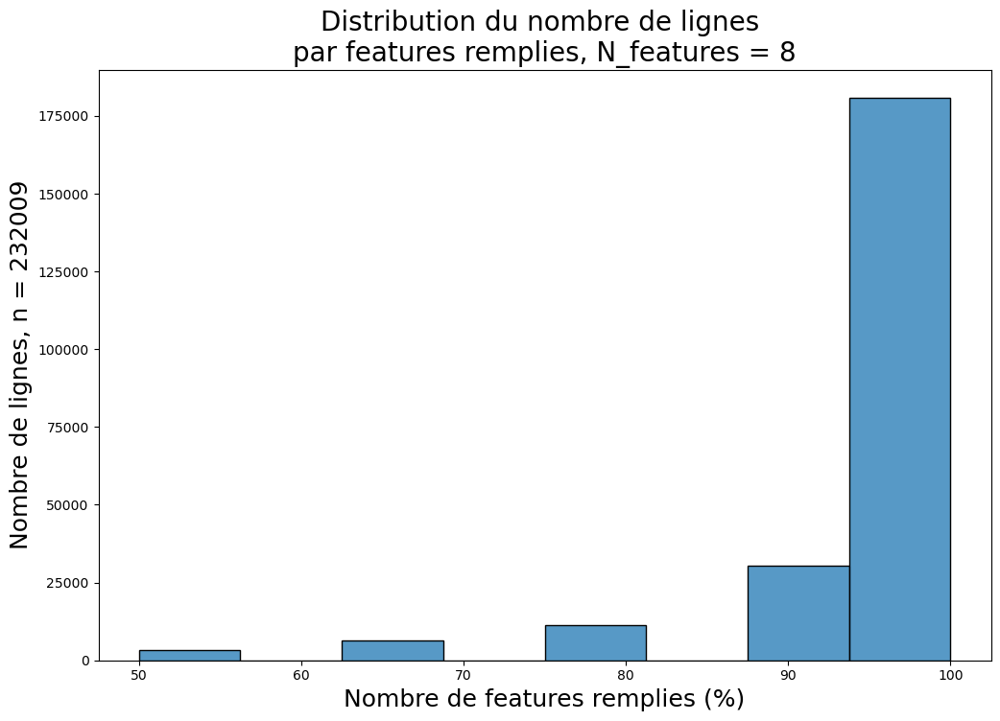

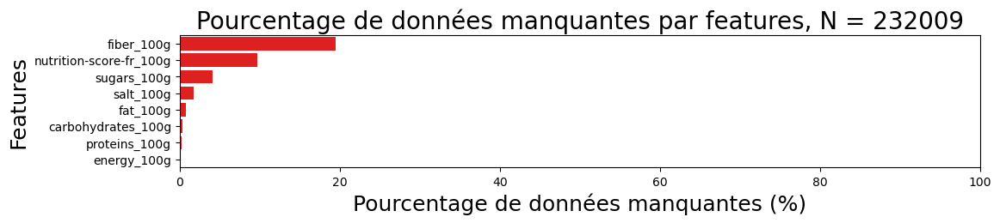

In [152]:
valeurs_manquantes_graph(data[liste_feat_simple],"row")
valeurs_manquantes_graph(data[liste_feat_simple],"column")

In [153]:
# on copie notre dataframe
df_mean = copy.deepcopy(data)
df_median = copy.deepcopy(data)
df_knn = copy.deepcopy(data)

pnns_groups_2 =  data["pnns_groups_2"].unique()

# Remplissage des valeurs manquantes selon la moyenne ou median et par pnns groups 2.
# apply + lambda serait plus efficace.
for pnns in pnns_groups_2:
    for col in liste_feat_simple:
        cond1 = (df_mean[col].isnull()) & (df_mean["pnns_groups_2"] == pnns)
        cond2 = (df_mean[col].notnull()) & (df_mean["pnns_groups_2"] == pnns)
        df_mean.loc[cond1, col] = df_mean.loc[cond2, col].mean()
        
        cond1 = (df_median[col].isnull()) & (df_median["pnns_groups_2"] == pnns)
        cond2 = (df_median[col].notnull()) & (df_median["pnns_groups_2"] == pnns)
        df_median.loc[cond1, col] = df_median.loc[cond2, col].median()
        
df_knn = (
    df_knn.combine_first(
        remplissage_value_knn_pnns(df_knn, "pnns_groups_2", liste_feat_simple)))

pnns : biscuits and cakes 1 / 31
pnns : breakfast cereals 2 / 31
pnns : nuts 3 / 31
pnns : chocolate products 4 / 31
pnns : legumes 5 / 31
pnns : cereals 6 / 31
pnns : appetizers 7 / 31
pnns : sweets 8 / 31
pnns : bread 9 / 31
pnns : vegetables 10 / 31
pnns : legumes-fat 11 / 31
pnns : dressings 12 / 31
pnns : processed meat 13 / 31
pnns : dried fruits 14 / 31
pnns : pizza pies and quiche 15 / 31
pnns : raw_meat 16 / 31
pnns : dairy desserts-ice cream 17 / 31
pnns : sweetened beverages 18 / 31
pnns : non-sugared beverages 19 / 31
pnns : fats 20 / 31
pnns : cheese 21 / 31
pnns : milk and yogurt 22 / 31
pnns : artificially sweetened beverages 23 / 31
pnns : sauces 24 / 31
pnns : one-dish meals 25 / 31
pnns : fruits 26 / 31
pnns : sandwich 27 / 31
pnns : potatoes 28 / 31
pnns : eggs 29 / 31
pnns : salty and fatty products 30 / 31
pnns : triple dishes 31 / 31


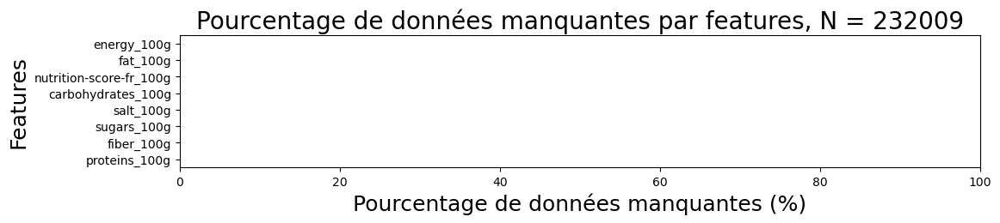

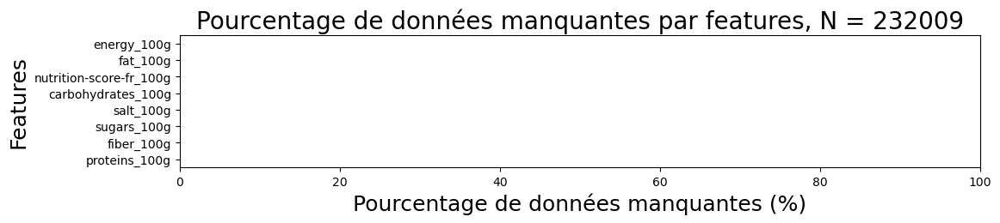

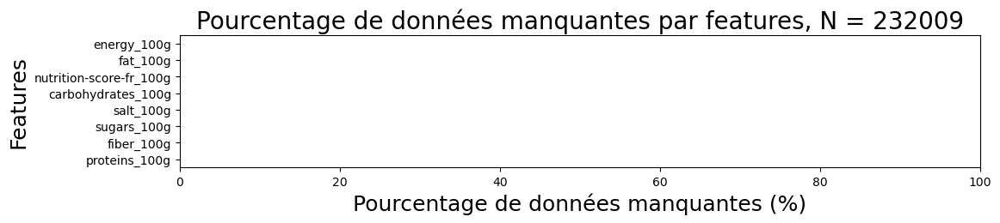

In [154]:
valeurs_manquantes_graph(df_mean[liste_feat_simple],"column")
valeurs_manquantes_graph(df_median[liste_feat_simple],"column")
valeurs_manquantes_graph(df_knn[liste_feat_simple],"column")

On confirme que nous n'avons plus de valeur null.

In [155]:
def standard_variation_multiple(old_df, liste_new_df, methode_names):
    
    sv = lambda x: np.std(x, ddof=1) / np.mean(x) * 100 

    sv_old = sv(old_df)
    sv_new = [sv(new_df) for new_df in liste_new_df]

    print("Calcul du coefficient de variation :")
    print("Avant traitement = ", sv_old)
    print("Après traitement : ")
    for i in range(0, len(sv_new)):
        print("\t\t",methode_names[i], ":", sv_new[i])
    
    near_method = proche_var(sv_old, sv_new, methode_names)
    print("Méthode la plus proche :", near_method)
    
    print("\n")
    
    return near_method
    
## Fonction qui retourne la méthode qui donne la valeur la plus proche de la référence
def proche_var(old_df, liste_new_df, methode_names):
    
    ## On garde la première valeur
    if len(liste_new_df) > 1:
        near = abs(old_df - liste_new_df[0])
        near_name = methode_names[0]

    count = 1
    ## On parcours les valeurs de la liste
    for i, var in enumerate(liste_new_df):
        if near > abs(old_df - liste_new_df[i]) :
            near = abs(old_df - liste_new_df[i])
            near_name = methode_names[i]
        ## On compte si plusieurs sont à égaliter
        elif (i > 0) & (old_df - liste_new_df[i] == near):
            count += 1
            
    if count == 1:
        ## On return le nom de la methode avec le résultat le plus proche de la valeur de référence
        return near_name
    
    elif count >1:
        return np.nan

In [156]:
liste_methode = ["mean", "median", "KNN"]

# Liste permettant de garder la méthode ayant le moins de variation par rapport aux données initiales.
near_method = []

for feat in liste_feat_simple :
    print(feat)
    near_method.append(standard_variation_multiple(data[feat], [df_mean[feat],df_median[feat], df_knn[feat]], liste_methode))


energy_100g
Calcul du coefficient de variation :
Avant traitement =  68.6338254395577
Après traitement : 
		 mean : 68.6338254395577
		 median : 68.6338254395577
		 KNN : 68.6338254395577
Méthode la plus proche : nan


fat_100g
Calcul du coefficient de variation :
Avant traitement =  132.49644828104138
Après traitement : 
		 mean : 132.8859957785141
		 median : 133.1333399312018
		 KNN : 133.15832953331105
Méthode la plus proche : mean


nutrition-score-fr_100g
Calcul du coefficient de variation :
Avant traitement =  98.31746082494398
Après traitement : 
		 mean : 96.65432534619617
		 median : 98.04557605947495
		 KNN : 97.90218198040243
Méthode la plus proche : median


carbohydrates_100g
Calcul du coefficient de variation :
Avant traitement =  89.51913078549539
Après traitement : 
		 mean : 89.74492343555457
		 median : 89.76537601549104
		 KNN : 89.73076708298609
Méthode la plus proche : KNN


salt_100g
Calcul du coefficient de variation :
Avant traitement =  395.2649021590343
Après

In [157]:
import collections

# Compte le nombre d'occurrences 
near_method = collections.Counter(near_method)

print(near_method)

Counter({'mean': 4, 'KNN': 2, nan: 1, 'median': 1})


Le remplissage par la mean est la méthode permettant d'avoir le moins de variations avec la valeur initiale

In [158]:
liste_methode = ["mean", "median", "KNN"]

# Liste permettant de garder la méthode ayant le moins de variation par rapport aux données initiales.
near_method = []


for pnns2 in data.pnns_groups_2.unique():
    mask1 = data[data.pnns_groups_2 == pnns2]
    mask2 = df_mean[df_mean.pnns_groups_2 == pnns2]
    mask3 = df_median[df_median.pnns_groups_2 == pnns2]
    mask4 = df_knn[df_knn.pnns_groups_2 == pnns2]
    for feat in liste_feat_simple :
        print(pnns2, feat)
        near_method.append(standard_variation_multiple(mask1[feat], [mask2[feat], mask3[feat], mask4[feat]], liste_methode))

biscuits and cakes energy_100g
Calcul du coefficient de variation :
Avant traitement =  18.39720388254955
Après traitement : 
		 mean : 18.39720388254955
		 median : 18.39720388254955
		 KNN : 18.39720388254955
Méthode la plus proche : nan


biscuits and cakes fat_100g
Calcul du coefficient de variation :
Avant traitement =  49.551355910725
Après traitement : 
		 mean : 49.51033222560858
		 median : 49.50786953454843
		 KNN : 49.613358939297555
Méthode la plus proche : mean


biscuits and cakes nutrition-score-fr_100g
Calcul du coefficient de variation :
Avant traitement =  31.614556126423192
Après traitement : 
		 mean : 31.09741130603883
		 median : 31.08197956785942
		 KNN : 31.480828584151947
Méthode la plus proche : KNN


biscuits and cakes carbohydrates_100g
Calcul du coefficient de variation :
Avant traitement =  24.3975012469321
Après traitement : 
		 mean : 24.3975012469321
		 median : 24.3975012469321
		 KNN : 24.3975012469321
Méthode la plus proche : nan


biscuits and cakes

appetizers energy_100g
Calcul du coefficient de variation :
Avant traitement =  17.662762925925577
Après traitement : 
		 mean : 17.662762925925577
		 median : 17.662762925925577
		 KNN : 17.662762925925577
Méthode la plus proche : nan


appetizers fat_100g
Calcul du coefficient de variation :
Avant traitement =  37.935625427466974
Après traitement : 
		 mean : 37.935625427466974
		 median : 37.935625427466974
		 KNN : 37.935625427466974
Méthode la plus proche : nan


appetizers nutrition-score-fr_100g
Calcul du coefficient de variation :
Avant traitement =  46.95803183230936
Après traitement : 
		 mean : 46.464937851750754
		 median : 46.5077194478178
		 KNN : 46.80386697099292
Méthode la plus proche : KNN


appetizers carbohydrates_100g
Calcul du coefficient de variation :
Avant traitement =  25.517573122361686
Après traitement : 
		 mean : 25.511901290079503
		 median : 25.511643613202523
		 KNN : 25.511872260782482
Méthode la plus proche : mean


appetizers salt_100g
Calcul du coef

dressings energy_100g
Calcul du coefficient de variation :
Avant traitement =  82.05649882615734
Après traitement : 
		 mean : 82.05649882615734
		 median : 82.05649882615734
		 KNN : 82.05649882615734
Méthode la plus proche : nan


dressings fat_100g
Calcul du coefficient de variation :
Avant traitement =  108.74959222886511
Après traitement : 
		 mean : 108.42332117071378
		 median : 108.80014862410971
		 KNN : 109.19064070214202
Méthode la plus proche : median


dressings nutrition-score-fr_100g
Calcul du coefficient de variation :
Avant traitement =  65.437403250793
Après traitement : 
		 mean : 62.74097658890258
		 median : 62.70606071234117
		 KNN : 64.21050308039035
Méthode la plus proche : KNN


dressings carbohydrates_100g
Calcul du coefficient de variation :
Avant traitement =  82.68885607896166
Après traitement : 
		 mean : 82.62339697992034
		 median : 82.64953199971572
		 KNN : 82.69520816209995
Méthode la plus proche : KNN


dressings salt_100g
Calcul du coefficient de va

dairy desserts-ice cream energy_100g
Calcul du coefficient de variation :
Avant traitement =  33.334382940578855
Après traitement : 
		 mean : 33.334382940578855
		 median : 33.334382940578855
		 KNN : 33.334382940578855
Méthode la plus proche : nan


dairy desserts-ice cream fat_100g
Calcul du coefficient de variation :
Avant traitement =  68.01501327420806
Après traitement : 
		 mean : 67.91601509460835
		 median : 67.91587294018721
		 KNN : 68.15708509668549
Méthode la plus proche : mean


dairy desserts-ice cream nutrition-score-fr_100g
Calcul du coefficient de variation :
Avant traitement =  51.664703177655824
Après traitement : 
		 mean : 50.87973666184954
		 median : 50.755592745821296
		 KNN : 51.590791864648864
Méthode la plus proche : KNN


dairy desserts-ice cream carbohydrates_100g
Calcul du coefficient de variation :
Avant traitement =  29.304619488016932
Après traitement : 
		 mean : 29.304619488016932
		 median : 29.304619488016932
		 KNN : 29.304619488016932
Méthode la 

artificially sweetened beverages energy_100g
Calcul du coefficient de variation :
Avant traitement =  230.4913833824954
Après traitement : 
		 mean : 230.4913833824954
		 median : 230.4913833824954
		 KNN : 230.4913833824954
Méthode la plus proche : nan


artificially sweetened beverages fat_100g
Calcul du coefficient de variation :
Avant traitement =  375.52433422487843
Après traitement : 
		 mean : 370.97559943388137
		 median : 380.4399800273567
		 KNN : 378.2971920593027
Méthode la plus proche : KNN


artificially sweetened beverages nutrition-score-fr_100g
Calcul du coefficient de variation :
Avant traitement =  133.32974634069416
Après traitement : 
		 mean : 121.05596517239707
		 median : 134.0620547827821
		 KNN : 132.51894793026466
Méthode la plus proche : median


artificially sweetened beverages carbohydrates_100g
Calcul du coefficient de variation :
Avant traitement =  241.42715837077984
Après traitement : 
		 mean : 240.91366507400633
		 median : 241.88894280738205
		 KNN 

triple dishes energy_100g
Calcul du coefficient de variation :
Avant traitement =  39.75682737914102
Après traitement : 
		 mean : 39.75682737914102
		 median : 39.75682737914102
		 KNN : 39.75682737914102
Méthode la plus proche : nan


triple dishes fat_100g
Calcul du coefficient de variation :
Avant traitement =  69.30648668595293
Après traitement : 
		 mean : 69.30648668595293
		 median : 69.30648668595293
		 KNN : 69.30648668595293
Méthode la plus proche : nan


triple dishes nutrition-score-fr_100g
Calcul du coefficient de variation :
Avant traitement =  75.94387563598164
Après traitement : 
		 mean : 75.2503097326306
		 median : 74.9179018467826
		 KNN : 77.01518369838585
Méthode la plus proche : mean


triple dishes carbohydrates_100g
Calcul du coefficient de variation :
Avant traitement =  78.29389905696881
Après traitement : 
		 mean : 78.29389905696881
		 median : 78.29389905696881
		 KNN : 78.29389905696881
Méthode la plus proche : nan


triple dishes salt_100g
Calcul du coe

In [159]:
# Compte le nombre d'occurrences 
near_method = collections.Counter(near_method)

print(near_method)

Counter({'KNN': 128, nan: 52, 'median': 48, 'mean': 20})


Quand on complète les données manquantes à l'aide des pnns_groups_2, le remplissage par knn est celui permettant d'avoir le moins de variation, suivi de la median, puis de la mean.

On va pouvoir donc remplacer les données manquantes par celles obtenues avec le knn. 

In [160]:
data = copy.deepcopy(df_knn)

***
# <a name = "T6">Observations des données après remplissage</a>

Maintenant que nous avons des données complètes sur les éléments de nutriments principaux, nous pouvons faire des observations sur la répartition nutritionnelle.

,index,countries_fr,pourcent
0,Etats-Unis,145535,62.728170
1,France,62137,26.782151
2,Suisse,9163,3.949416
3,Allemagne,4821,2.077937
4,Espagne,3073,1.324518
5,Royaume-Uni,1995,0.859880
6,Belgique,1236,0.532738
7,Australie,538,0.231888
8,Russie,488,0.210337
9,Portugal,451,0.194389


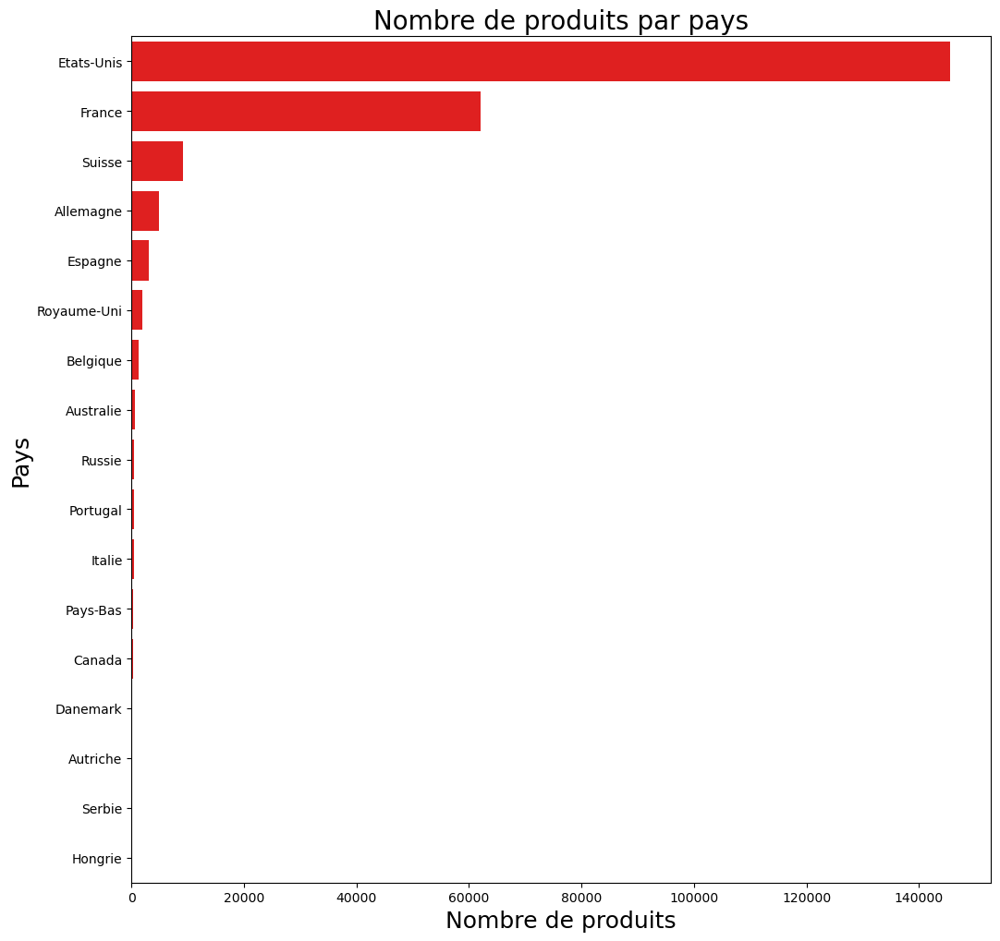

In [161]:
# Pour rappel, nous avons ces pays dans la base de données ( > 100 produits)
distributionPays(data)

### <a name = "T6C1">1. Distribution des pnns_groups_1 par pays </a>

In [162]:
#On compte le nombre de produits par pays
count_pays = data["countries_fr"].value_counts().reset_index()

# On garde une liste de pays 
liste_pays = list(count_pays[count_pays.countries_fr > 1000]["index"])
print(liste_pays)

['Etats-Unis', 'France', 'Suisse', 'Allemagne', 'Espagne', 'Royaume-Uni', 'Belgique']


In [163]:
mondial = [(data[data.pnns_groups_1 == pnns].shape[0] / data.shape[0] *100) for pnns in data.pnns_groups_1.unique()]
name_pnns1 = [pnns for pnns in data.pnns_groups_1.unique()]
mondial = pd.DataFrame(mondial, columns = ["cumsum_pnns1"]).T

mondial.columns = name_pnns1
mondial.set_axis(["Mondial"], axis=0, inplace = True)

display(mondial)



,sugary snacks,cereals and potatoes,salty snacks,fruits and vegetables,fat and sauces,fish meat eggs,composite foods,milk and dairy products,beverages
Mondial,23.13143,15.22053,5.988992,7.007056,6.850165,8.288472,10.311238,12.748643,10.453474


In [164]:
mask = data[data["countries_fr"].isin(liste_pays)]
cumsum_pnns = [[(mask[(mask.pnns_groups_1 == pnns) & (mask.countries_fr == pays)].shape[0] / mask[mask.countries_fr == pays].shape[0] *100)  for pnns in mask.pnns_groups_1.unique()] for pays in mask.countries_fr.unique()]

name_pnns = [pnns for pnns in mask.pnns_groups_1.unique()]
cumsum_pnns = pd.DataFrame(cumsum_pnns, columns = mask.pnns_groups_1.unique())

cumsum_pnns.set_axis(liste_pays, axis=0, inplace = True)
cumsum_pnns = pd.concat([cumsum_pnns ,mondial])
display(cumsum_pnns)


,sugary snacks,cereals and potatoes,salty snacks,fruits and vegetables,fat and sauces,fish meat eggs,milk and dairy products,beverages,composite foods
Etats-Unis,24.606452,16.390559,7.192771,6.709726,6.590854,7.024427,11.516130,10.799464,9.169616
France,19.539083,12.084587,3.719201,7.345060,7.172860,11.848013,14.952444,9.765518,13.573233
Suisse,22.360506,16.988177,3.733665,5.932379,6.699855,7.031736,21.385605,10.246837,5.621240
Allemagne,22.857143,11.779449,4.711779,7.318296,10.977444,13.383459,12.681704,7.568922,8.721805
Espagne,20.436056,16.270745,6.638464,23.690205,7.484543,2.375529,4.783599,9.990238,8.330622
Royaume-Uni,24.839027,15.649896,3.852450,5.904180,7.235622,7.115574,14.427589,8.774419,12.201244
Belgique,25.323625,16.423948,5.177994,4.045307,8.171521,5.663430,12.540453,16.666667,5.987055
Mondial,23.131430,15.220530,5.988992,7.007056,6.850165,8.288472,12.748643,10.453474,10.311238


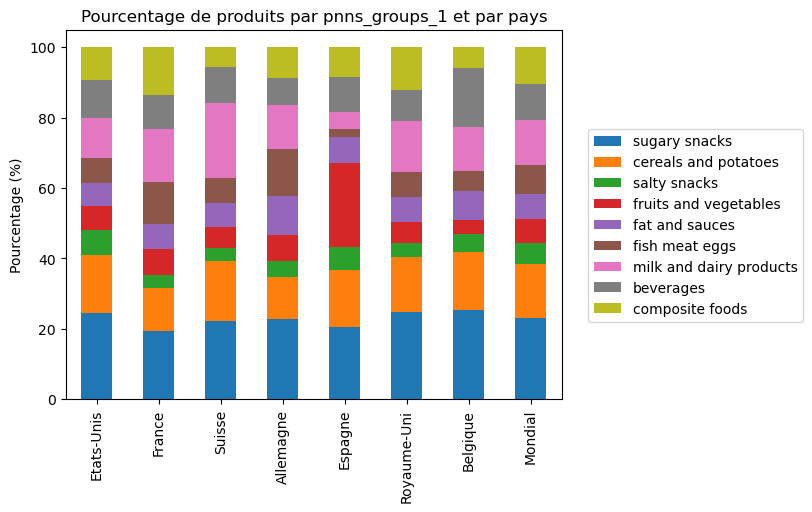

In [165]:
cumsum_pnns.plot(kind='bar', stacked=True)
plt.title("Pourcentage de produits par pnns_groups_1 et par pays")
plt.ylabel("Pourcentage (%)")
plt.legend(loc="upper right", bbox_to_anchor = (1.5,0.75))

Distributions assez similaires entre les pays, cependant avec quelques parrticularités.

En Espagne on retrouve plus de fruit et légumes en vente.

En Suisse, on retrouve plus de lait et produits laitiers.

### <a name = "T6C2">2. Distribution des pnns_groups_2 par pays </a>

In [166]:
mondial = [(data[data.pnns_groups_2 == pnns].shape[0] / data.shape[0] *100) for pnns in data.pnns_groups_2.unique()]
name_pnns2 = [pnns for pnns in data.pnns_groups_2.unique()]
mondial = pd.DataFrame(mondial, columns = ["cumsum_pnns2"]).T

mondial.columns = name_pnns2
mondial.set_axis(["Mondial"], axis=0, inplace = True)

display(mondial)



,biscuits and cakes,breakfast cereals,nuts,chocolate products,legumes,cereals,appetizers,sweets,bread,vegetables,...,milk and yogurt,artificially sweetened beverages,sauces,one-dish meals,fruits,sandwich,potatoes,eggs,salty and fatty products,triple dishes
Mondial,11.198272,2.71455,2.086988,4.216216,1.283571,6.550608,3.87916,7.724269,4.195958,4.251128,...,3.880884,0.30473,1.297794,8.409157,1.972337,0.868932,0.115082,0.126719,0.026292,0.024137


In [167]:
mask = data[data["countries_fr"].isin(liste_pays)]
cumsum_pnns2 = [[(mask[(mask.pnns_groups_2 == pnns) & (mask.countries_fr == pays)].shape[0] / mask[mask.countries_fr == pays].shape[0] *100)  for pnns in mask.pnns_groups_2.unique()] for pays in mask.countries_fr.unique()]

name_pnns2 = [pnns for pnns in mask.pnns_groups_2.unique()]
cumsum_pnns2 = pd.DataFrame(cumsum_pnns2, columns = mask.pnns_groups_2.unique())

cumsum_pnns2.set_axis(liste_pays, axis=0, inplace = True)
cumsum_pnns2 = pd.concat([cumsum_pnns2 ,mondial])
display(cumsum_pnns2)


,biscuits and cakes,breakfast cereals,nuts,chocolate products,legumes,cereals,appetizers,sweets,bread,vegetables,...,sauces,raw_meat,one-dish meals,pizza pies and quiche,fruits,sandwich,potatoes,eggs,salty and fatty products,triple dishes
Etats-Unis,12.469165,2.914076,2.713437,3.823135,1.227196,6.645137,4.456660,8.319648,5.011166,3.906964,...,1.729481,3.445906,7.404404,1.021060,1.932181,0.740028,0.109252,0.057718,0.024049,0.002061
France,9.379275,2.230555,0.914109,3.939682,1.326102,5.924007,2.780952,6.224955,2.442989,4.565718,...,0.564881,6.350484,11.316929,0.917328,2.130776,1.247244,0.088514,0.210824,0.027359,0.082077
Suisse,5.413815,2.717279,1.970546,8.525202,1.721635,8.566687,1.763120,8.442232,3.484754,3.007675,...,0.228168,3.733665,3.941091,1.099357,2.115744,0.477079,0.124456,0.539307,0.000000,0.000000
Allemagne,9.473684,1.303258,1.052632,5.062657,1.002506,5.664160,3.558897,8.370927,3.157895,5.563910,...,1.704261,9.223058,6.867168,0.701754,1.403509,1.152882,0.300752,0.952381,0.100251,0.000000
Espagne,4.360560,1.399284,2.147738,7.647250,4.425643,7.061503,4.393101,8.428246,2.928734,18.939147,...,0.292873,1.789782,7.582167,0.325415,3.547022,0.325415,0.065083,0.032541,0.097624,0.000000
Royaume-Uni,10.204082,2.902979,1.102259,7.475718,0.851250,7.442977,2.728364,7.181054,3.917931,3.710575,...,0.578413,3.896104,9.734803,1.418749,1.680672,0.960384,0.392884,0.163702,0.043654,0.010913
Belgique,9.061489,6.391586,0.242718,8.171521,0.404531,6.472492,4.935275,8.171521,2.993528,2.669903,...,0.728155,2.993528,4.692557,0.889968,0.970874,0.323625,0.080906,0.161812,0.000000,0.000000
Mondial,11.198272,2.714550,2.086988,4.216216,1.283571,6.550608,3.879160,7.724269,4.195958,4.251128,...,1.297794,4.268800,8.409157,0.997806,1.972337,0.868932,0.115082,0.126719,0.026292,0.024137


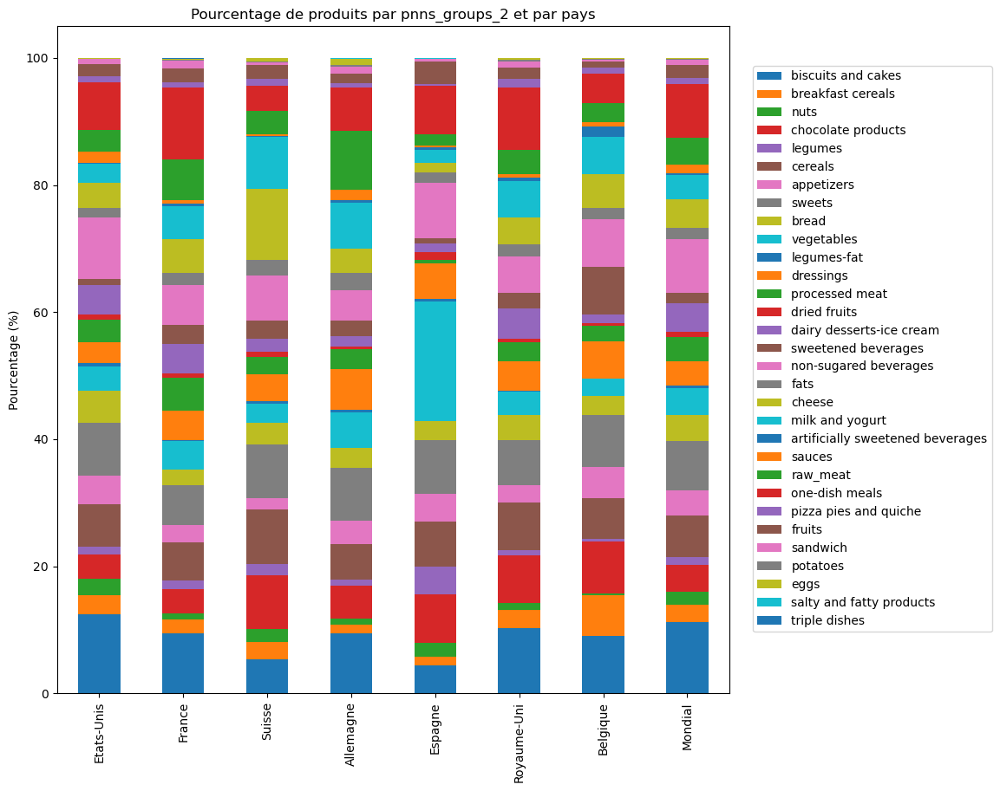

In [196]:
cumsum_pnns2.plot(kind='bar', stacked=True, figsize = [10,10])

plt.title("Pourcentage de produits par pnns_groups_2 et par pays")
plt.ylabel("Pourcentage (%)")
plt.legend(loc="upper right", bbox_to_anchor = (1.4,0.95))

On confirme pour l'Espagne et la Suisse, respectivement plus de fruits et de fromages.

### <a name = "T6C3">3. Produits labelisés </a>

Pour les labels, nous avons 3 catégories : "labels", "labels_fr" et "labels_tags"

In [169]:
display(data.loc[data["labels_fr"].notnull(), ["labels", "labels_fr", "labels_tags"]])

,labels,labels_fr,labels_tags
191,UTZ Certified Kakao,"Agriculture durable,UTZ Certified,UTZ Certifie...","en:sustainable-farming,en:utz-certified,en:utz..."
202,"Vegetariano,Vegano","Végétarien,Végétalien","en:vegetarian,en:vegan"
234,"Fabriqué en France,Point Vert","Point Vert,Fabriqué en France","en:green-dot,en:made-in-france"
237,"Point Vert,Fabriqué en France","Point Vert,Fabriqué en France","en:green-dot,en:made-in-france"
250,"Vegetarisch,Vegan","Végétarien,Végétalien","en:vegetarian,en:vegan"
...,...,...,...
247313,"Whole Grain,High Fibre","Riche en fibres,en:Whole-grain","en:high-fibres,en:whole-grain"
247322,Low GI,en:Low-gi,en:low-gi
247323,Low GI,en:Low-gi,en:low-gi
247336,"Sans conservateurs,Halal,Sans glutamate de sodium","Sans conservateurs,Halal,Sans-glutamate-de-sodium","en:no-preservatives,en:halal,fr:sans-glutamate..."


On va garder "labels_fr".

Regardons quels mots on retrouve.

In [170]:
## Fonction permettant de récupèrer une liste de mots et leur occurence dans une catégorie.

def liste_de_mots(df, category):
    liste_mots = []

    # On sépare pour chaque ligne, les mots en une liste de mots
    mots = df.loc[df[category].notnull(), category].str.split(",")

    [liste_mots.extend(l2) for l2 in mots.tolist()]
            
 
    # liste qui va garder le nombre d'occurences par mot unique
    occurence = []
    
    ##Retourne un dictionnaire avec le nombre d'occurences par mots.
    result = dict(zip(*np.unique(liste_mots, return_counts=True)))
    
    
    ## On transforme le dictionnaire en dataframe et on classee par valeur décroissante
    occurence = pd.DataFrame.from_dict(result,orient='index', columns= ["Occurences"]).reset_index().sort_values("Occurences", ascending = False)
    
    # On retourne un dataframe contenant les mots et leur occurence
    return occurence

In [171]:
# On récupère une liste de mots et leur occurence dans la catégorie labels_fr
occurence = liste_de_mots(data, "labels_fr")

display(occurence[:50])

,index,Occurences
509,Bio,11753
511,Bio européen,11044
259,AB Agriculture Biologique,8442
2300,Point Vert,8333
3251,Végétarien,4307
2697,Sans conservateurs,3299
3250,Végétalien,3226
1024,Eco-emballages,3119
2701,Sans gluten,3038
2692,Sans colorants,2178


On retrouve plusieurs labels bio.

On peut écrire une fonction retournant la liste de produits qui ont appelation bio.

In [172]:
def label_liste(df, label):
    
    # On créé une copie de notre dataframe
    mask = copy.deepcopy(df[df.labels_fr.notnull()])
    
    # On créé une variable liste qui va contenir la liste d'indexes
    liste_index_label = []
    
    ## On met tout en minuscule
    label = label.lower()
    mask["labels_fr"] = mask["labels_fr"].str.lower()
    
    liste_index_label = mask[mask["labels_fr"].str.find(label) != -1].index
    
    # Si aucun produit n'est identifié
    if liste_index_label.shape[0] == 0:
        print("Pas de produits avec ce label :", label)
    
    else : 
        return liste_index_label

In [173]:
data[(data["labels_fr"].notnull())&(data["labels_fr"].str.find("bio") != -1)]["labels_fr"]

48296     Bio,Végétarien,Bio-agriculture-non-ue,Carton-i...
59718     Ecocert,Ecocert Canada,Certifie-biologique-par...
95096     Bio,Kascher,Sans OGM,USDA Organic,Halal,Orthod...
116867    Certifie-biologique-par-quality-assurance-inte...
126668       Sans-utilisation-d-antibiotiques-ni-hormones-x
                                ...                        
245684    Peu ou pas de sucre,Bio,Sans sucre ajouté,Bour...
245685    Peu ou pas de sucre,Bio,Sans sucre ajouté,Bour...
245686    Peu ou pas de sucre,Bio,Sans sucre ajouté,Bour...
245750                    Bio,Bio européen,CH-BIO-006,M-bio
245751                    Bio,Bio européen,CH-BIO-006,M-bio
Name: labels_fr, Length: 370, dtype: object

In [174]:
## On récupère la liste de produits bio.

liste_index = label_liste(data, "Bio")

In [175]:
data_bio = data[data.index.isin(liste_index)]

In [176]:
# On récupère la liste de mots bio et leur occurence dans la catégorie labels_fr (et associés)
display(liste_de_mots(data_bio, "labels_fr")[:10])

,index,Occurences
136,Bio,11753
138,Bio européen,11044
32,AB Agriculture Biologique,8442
399,FR-BIO-01,2175
1029,Végétarien,1091
1028,Végétalien,1003
739,Point Vert,977
843,Sans gluten,803
58,Agriculture UE/Non UE,577
1077,de:EG-Öko-Verordnung,567


On regarde la distribution des produits bio par pays 

,index,countries_fr,pourcent
0,France,9373,79.257568
1,Allemagne,1131,9.563673
2,Espagne,495,4.185693
3,Suisse,279,2.359209
4,Etats-Unis,127,1.073905
5,Belgique,102,0.862506


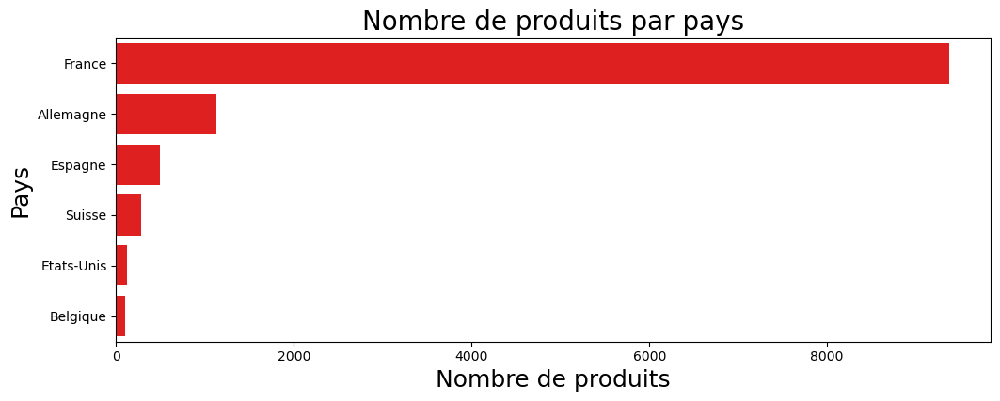

In [177]:
distributionPays(data_bio)

Seulement quelques pays présentent un label bio.

De façon étonnante, les Etats-Unis sont très bas dans ce classement, alors qu'ils ont le plus de produits.

Voyons le pourcent de produits Bio / total produits pays

In [178]:
# Fonction affichant la distribution des produits par pays et selon le label
def distributionPaysLabel(df, df_label):

    # On va garder les pays avec plus de 100 produits
    count_pays = df["countries_fr"].value_counts().reset_index()
    count_pays = count_pays[count_pays["countries_fr"] > 100]

    # On garde les pays qui ont > 100 produits et ceux qui ont un label bio
    cond1 = df.countries_fr.isin(count_pays["index"])
    cond2 = df.countries_fr.isin(df_label.countries_fr.unique())
    mask = df[cond1 & cond2]

    nombre_bio = mask[mask.index.isin(df_label.index)]["countries_fr"].value_counts()
    nombre_total = mask[(mask.countries_fr.isin(count_pays["index"]))]["countries_fr"].value_counts()

    pourcent = nombre_bio / nombre_total * 100

    pourcent = pd.DataFrame(pourcent, columns = ["countries_fr"]).reset_index()
    pourcent.sort_values("countries_fr", ascending = False, inplace = True)
    
    #On affiche ce comptage par un barplot
    plt.figure(figsize=(8,8))
    
    sns.barplot(data = pourcent, y = "index", x = "countries_fr", color = "red", orient = "h")    
    plt.title("Pourcentage de produits labelisés bio par pays", fontsize = 20)
    plt.xlabel("Pourcentage de produits labelisés bio (%)", fontsize=18)
    plt.ylabel("Pays", fontsize=18)

    plt.show()

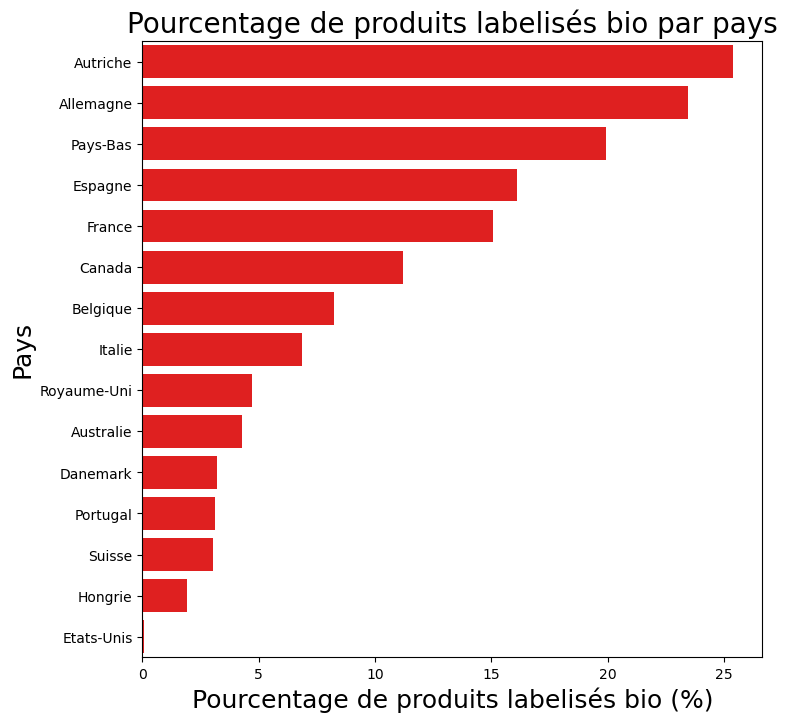

In [179]:
distributionPaysLabel(data, data_bio)

Observations : 

    - Pays européens ont plus de produits labelisés bio
    - Etats-Unis ont peu de produits labelisés bio.
    
    
On pourrait regarder plus précisément quels produits ont plus de chance d'être labelisés bio ou non.

***
# <a name = "T7">Développement de l'application</a>

### <a name = "T7C1">1. Description de l'application : utilisation et potentiel </a>

Pour rappel nous voudrios développer une application **recommandant des produits plus sains (selon un produit de référence (code) ou à partir d'une liste de course**

Par exemple : on a dans la liste "ketchup"

On voudrait qu'à partir de la base de données, on ait une recommandation de ketchup sain, basé sur le nutrition score (plus le nutrition score est faible, plus le produit est supposé être sain), mais également disponible dans le pays.

Il faudrait donc : 
- Avoir les informations du nutrition score
- Avoir les informations du pays
- Catégoriser les produits (un ketchup étant une marque, il faudrait identifier des produits similaires)

En plus de cela, on voudrait pouvoir identifier des produits riches en fibres, pauvres en sucres etc

Mettre en avant les produits issus de l'agriculture biologique.

### <a name = "T7C2">2. Mise en place de l'application </a>

Développement de la fonction permettant de récupérer une liste de produits

In [180]:
## Fonction basique renvoyant une liste des 10 produits les plus proches selon soit le pnns_groups_1 
# ou soit le 2 avec un nutriscore le plus sain "croissant à partir de -10"

# Version 1

def top10_liste_pnns(product, df, pnns_groups_type):
    
    # On récupère la liste de produit du même pnns_groups
    top10 = df[df[pnns_groups_type] == product[pnns_groups_type].values[0]]
    
    # On trie la liste selon le nutrition score
    top10 = top10.sort_values("nutrition-score-fr_100g")
    
    # On garde une liste des 10 produits les plus "sains"
    top10 = top10[0:10]

    # On retourne la liste + produit
    return pd.concat([top10, product])

On test avec un produit

In [181]:
product_test = data[data.code==4530]

On recherche des produits proches selon le pnns_groups_2

In [182]:
top10_liste_pnns(product_test, data, "pnns_groups_2")

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
32746,39978013231,http://world-fr.openfoodfacts.org/produit/0039...,usda-ndb-import,1489052568,2017-03-09T09:42:48Z,1489052568,2017-03-09T09:42:48Z,Organic Wholegrain Quinoa,NaN,NaN,...,69.57,0.00,4.3,15.22,0.05588,0.000000,0.0000,0.043,0.00587,-6.0
32674,39978005465,http://world-fr.openfoodfacts.org/produit/0039...,usda-ndb-import,1489094131,2017-03-09T21:15:31Z,1489094132,2017-03-09T21:15:32Z,Large Flake Nutritional Food Yeast,NaN,NaN,...,41.67,0.00,25.0,50.00,0.00000,0.000000,0.0000,0.000,0.00600,-6.0
121690,742392757949,http://world-fr.openfoodfacts.org/produit/0742...,usda-ndb-import,1489091391,2017-03-09T20:29:51Z,1489091391,2017-03-09T20:29:51Z,Toasted Quinoa,NaN,NaN,...,69.57,0.00,4.4,15.22,0.05588,0.000000,0.0000,0.043,0.00587,-6.0
138058,850086000643,http://world-fr.openfoodfacts.org/produit/0850...,usda-ndb-import,1489065302,2017-03-09T13:15:02Z,1489065302,2017-03-09T13:15:02Z,Mild Yellow Mustard Powder,NaN,NaN,...,27.50,2.50,12.5,21.25,0.00000,0.000019,0.0022,0.350,0.00630,-6.0
98275,183837000082,http://world-fr.openfoodfacts.org/produit/0183...,usda-ndb-import,1489076443,2017-03-09T16:20:43Z,1489076443,2017-03-09T16:20:43Z,Organiv Brown Flax Seeds,NaN,NaN,...,20.00,0.00,17.8,11.11,0.05588,0.000000,0.0000,0.178,0.00400,-6.0
120891,738529000255,http://world-fr.openfoodfacts.org/produit/0738...,usda-ndb-import,1489068876,2017-03-09T14:14:36Z,1489068876,2017-03-09T14:14:36Z,"Rio Grande Foods, Chilate Flour",NaN,NaN,...,84.29,0.00,4.3,12.14,0.11684,0.000000,0.0000,0.027,0.00000,-5.0
232507,8412170025783,http://world-fr.openfoodfacts.org/produit/8412...,openfoodfacts-contributors,1435576486,2015-06-29T11:14:46Z,1492713605,2017-04-20T18:40:05Z,Cooki sanas,NaN,150g,...,62.20,3.30,11.5,8.80,0.00000,NaN,NaN,NaN,NaN,-5.0
203998,3760081800216,http://world-fr.openfoodfacts.org/produit/3760...,kiliweb,1489398029,2017-03-13T09:40:29Z,1489398410,2017-03-13T09:46:50Z,Smart Pancake,NaN,2 préparations pour 10 pancakes chacune,...,8.60,0.20,8.4,16.80,1.10000,NaN,NaN,NaN,NaN,-5.0
185442,3300081001208,http://world-fr.openfoodfacts.org/produit/3300...,phoenix,1450524689,2015-12-19T11:31:29Z,1450607012,2015-12-20T10:23:32Z,Les Craquelins de Saint Malo Nature,NaN,180 g (x 20),...,71.60,1.60,5.0,14.00,0.21000,NaN,NaN,NaN,NaN,-5.0
185443,3300081002205,http://world-fr.openfoodfacts.org/produit/3300...,phoenix,1450524830,2015-12-19T11:33:50Z,1450607724,2015-12-20T10:35:24Z,Le Craquelins de Saint Malo Gout Sucré,NaN,180 g (x 20),...,71.60,1.60,5.0,14.00,0.08400,NaN,NaN,NaN,NaN,-5.0


On veut maintenant prendre en compte le pays du produit / utilisateur.

On actualise la version de la fonction

In [183]:
## Fonction basique renvoyant une liste des 10 produits les plus proches selon soit le pnns_groups_1 
# ou soit le 2 avec un nutriscore le plus sain "croissant à partir de -10"

# Version 2

def top10_liste_pnns(product, df, pnns_groups_type):
    
    # Quand le produit est vendu dans plusieurs pays, on veut connaître la géolocalisation de l'utilisateur
    if product.shape[0] > 1 :
        tentative = 3
        while tentative > 0:
            liste_pays = [pays for pays in product["countries_fr"]]
            print(tentative, "pour entrer le nom du pays")
            print(liste_pays, ":")
            geoloc = input()
            
            if geoloc in liste_pays:
                tentative = 0
            else :
                tentative -= 1
            
    else :
        geoloc = product["countries_fr"].values[0]
        
    condition1 = df[pnns_groups_type] == product[pnns_groups_type].values[0]
    condition2 = df["countries_fr"] == geoloc
    # On récupère la liste de produit du même pnns_groups
    top10 = df[condition1 & condition2]
    
    # On trie la liste selon le nutrition score
    top10 = top10.sort_values("nutrition-score-fr_100g")
    
    # On garde une liste des 10 produits les plus "sains"
    top10 = top10[0:10]

    # On retourne la liste + produit
    return pd.concat([top10, product])

On teste la version actualisée, avec le même produit que précédement.

In [184]:
top10_liste_pnns(product_test, data, "pnns_groups_2")

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
32746,39978013231,http://world-fr.openfoodfacts.org/produit/0039...,usda-ndb-import,1489052568,2017-03-09T09:42:48Z,1489052568,2017-03-09T09:42:48Z,Organic Wholegrain Quinoa,NaN,NaN,...,69.57,0.00,4.3,15.22,0.05588,0.000000,0.0000,0.043,0.00587,-6.0
32674,39978005465,http://world-fr.openfoodfacts.org/produit/0039...,usda-ndb-import,1489094131,2017-03-09T21:15:31Z,1489094132,2017-03-09T21:15:32Z,Large Flake Nutritional Food Yeast,NaN,NaN,...,41.67,0.00,25.0,50.00,0.00000,0.000000,0.0000,0.000,0.00600,-6.0
98275,183837000082,http://world-fr.openfoodfacts.org/produit/0183...,usda-ndb-import,1489076443,2017-03-09T16:20:43Z,1489076443,2017-03-09T16:20:43Z,Organiv Brown Flax Seeds,NaN,NaN,...,20.00,0.00,17.8,11.11,0.05588,0.000000,0.0000,0.178,0.00400,-6.0
121690,742392757949,http://world-fr.openfoodfacts.org/produit/0742...,usda-ndb-import,1489091391,2017-03-09T20:29:51Z,1489091391,2017-03-09T20:29:51Z,Toasted Quinoa,NaN,NaN,...,69.57,0.00,4.4,15.22,0.05588,0.000000,0.0000,0.043,0.00587,-6.0
138058,850086000643,http://world-fr.openfoodfacts.org/produit/0850...,usda-ndb-import,1489065302,2017-03-09T13:15:02Z,1489065302,2017-03-09T13:15:02Z,Mild Yellow Mustard Powder,NaN,NaN,...,27.50,2.50,12.5,21.25,0.00000,0.000019,0.0022,0.350,0.00630,-6.0
120891,738529000255,http://world-fr.openfoodfacts.org/produit/0738...,usda-ndb-import,1489068876,2017-03-09T14:14:36Z,1489068876,2017-03-09T14:14:36Z,"Rio Grande Foods, Chilate Flour",NaN,NaN,...,84.29,0.00,4.3,12.14,0.11684,0.000000,0.0000,0.027,0.00000,-5.0
121825,742987124095,http://world-fr.openfoodfacts.org/produit/0742...,usda-ndb-import,1489050420,2017-03-09T09:07:00Z,1489050420,2017-03-09T09:07:00Z,Corn Flour Mix,NaN,NaN,...,84.29,0.00,4.3,12.14,0.11684,0.000000,0.0021,0.143,0.00771,-4.0
25392,33079150949,http://world-fr.openfoodfacts.org/produit/0033...,usda-ndb-import,1489059266,2017-03-09T11:34:26Z,1489059266,2017-03-09T11:34:26Z,Sugar-Free Cookies,NaN,NaN,...,53.57,0.00,3.6,7.14,0.36322,0.000000,0.0000,0.000,0.00257,-4.0
126374,770338510518,http://world-fr.openfoodfacts.org/produit/0770...,usda-ndb-import,1489079641,2017-03-09T17:14:01Z,1489079641,2017-03-09T17:14:01Z,Split Yellow Peas,NaN,NaN,...,61.22,8.16,26.5,24.49,0.05080,0.000061,0.0024,0.082,0.00367,-4.0
58605,58449450573,http://world-fr.openfoodfacts.org/produit/0058...,usda-ndb-import,1489056356,2017-03-09T10:45:56Z,1489056356,2017-03-09T10:45:56Z,Homestyle Gluten Free Hot Oatmeal,NaN,NaN,...,75.00,0.00,10.0,15.00,0.00000,0.000000,0.0000,0.050,0.00450,-4.0


On teste la nouvelle version avec un produit vendu dans plusieurs pays.

In [185]:
product_test2 = data[data.code==9778564312457]

In [186]:
top10_liste_pnns(product_test2, data, "pnns_groups_2")

3 pour entrer le nom du pays
['France', 'Royaume-Uni'] :
France


,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
187445,3350030211264,http://world-fr.openfoodfacts.org/produit/3350...,amaurea,1385469003,2013-11-26T12:30:03Z,1481378244,2016-12-10T13:57:24Z,"Houmous au sésame et huile d'olive 3,2%",Préparation culinaire à base de pois chiches e...,115 g,...,8.3,0.5,7.8,9.2,1.00000,NaN,NaN,NaN,NaN,-9.0
205218,3770001404042,http://world-fr.openfoodfacts.org/produit/3770...,naudinsylvain,1397849483,2014-04-18T19:31:23Z,1449421365,2015-12-06T17:02:45Z,Petits crackers sans cuisson Betterave & Carotte,NaN,70 g,...,23.0,2.8,5.5,8.9,0.00000,NaN,NaN,NaN,NaN,-6.0
203253,3760020501334,http://world-fr.openfoodfacts.org/produit/3760...,openfoodfacts-contributors,1459164963,2016-03-28T11:36:03Z,1459165201,2016-03-28T11:40:01Z,Crackers complet son d'avoine,NaN,200g,...,72.0,1.5,8.0,11.0,0.00000,NaN,NaN,NaN,NaN,-6.0
194044,3560070423644,http://world-fr.openfoodfacts.org/produit/3560...,sebleouf,1464462229,2016-05-28T19:03:49Z,1490006375,2017-03-20T10:39:35Z,Antipasti Poivrons Grillés au Thym,Poivrons grillés assaisonnés au thym,140 g e,...,7.7,4.5,3.2,1.4,0.88000,NaN,NaN,NaN,NaN,-6.0
185448,3300085002201,http://world-fr.openfoodfacts.org/produit/3300...,miles67off,1382819077,2013-10-26T20:24:37Z,1487943324,2017-02-24T13:35:24Z,Mini Malo Nature Les Craquelins de Saint Malo,Mini Toasts,40 g,...,72.0,1.6,5.0,14.0,0.21000,NaN,NaN,NaN,NaN,-5.0
184437,3280220207152,http://world-fr.openfoodfacts.org/produit/3280...,sebleouf,1464519751,2016-05-29T11:02:31Z,1469264596,2016-07-23T09:03:16Z,Plateau 3 Légumes apéro,"Baby carottes, chou-fleur & radis, sauce au fr...",385 g,...,4.5,2.7,1.8,1.8,0.29000,NaN,NaN,NaN,NaN,-5.0
185449,3300085003307,http://world-fr.openfoodfacts.org/produit/3300...,miles67off,1382819575,2013-10-26T20:32:55Z,1449579429,2015-12-08T12:57:09Z,Mini Malo graines de lin Les Craquelins de Sai...,Mini toasts graines de lin,40 g,...,71.6,1.6,5.0,14.0,0.21336,NaN,NaN,NaN,NaN,-5.0
205373,3770004620081,http://world-fr.openfoodfacts.org/produit/3770...,openfoodfacts-contributors,1484596822,2017-01-16T20:00:22Z,1484603356,2017-01-16T21:49:16Z,Les Insectes Apéritifs Saveur Méditerranéenne,Vers de farine aromatisés saveur méditerranéenne,10 g,...,7.7,0.0,4.7,58.8,0.19000,NaN,NaN,NaN,NaN,-4.0
198695,3585510021150,http://world-fr.openfoodfacts.org/produit/3585...,phoenix,1465639380,2016-06-11T10:03:00Z,1466847426,2016-06-25T09:37:06Z,Poivrons grillés,NaN,125 g,...,11.7,8.1,3.6,1.8,1.30000,NaN,NaN,NaN,NaN,-4.0
198692,3585510021037,http://world-fr.openfoodfacts.org/produit/3585...,phoenix,1465639283,2016-06-11T10:01:23Z,1466846277,2016-06-25T09:17:57Z,Artichauts Grillés,NaN,125 g,...,5.7,1.1,4.6,2.8,1.40000,NaN,NaN,NaN,NaN,-4.0


On voudrait renvoyer une liste de produits qui vont répondre à des besoins nutritionnels, par exemple, riche fibre, pauvre en sucre, ou contenant des vitamines.


In [187]:
## Fonction basique renvoyant une liste des 10 produits les plus proches selon soit le pnns_groups_1 
# ou soit le 2 avec un nutriscore le plus sain "croissant à partir de -10"

# Version 3

def top10_liste_pnns(product, df, pnns_groups_type, regime = np.nan):
    
    # Quand le produit est vendu dans plusieurs pays, on veut connaître la géolocalisation de l'utilisateur
    if product.shape[0] > 1 :
        tentative = 3
        while tentative > 0:
            liste_pays = [pays for pays in product["countries_fr"]]
            print(tentative, "pour entrer le nom du pays")
            print(liste_pays, ":")
            geoloc = input()
            
            if geoloc in liste_pays:
                tentative = 0
            else :
                tentative -= 1
            
    else :
        geoloc = product["countries_fr"].values[0]
        
    condition1 = df[pnns_groups_type] == product[pnns_groups_type].values[0]
    condition2 = df["countries_fr"] == geoloc
    
    # On récupère une sous-liste du dataset selon les conditions d'un régime.
    liste_regime = regime_liste(df[condition1 & condition2], regime)
    condition3 = df.index.isin(liste_regime)
    
    # On récupère la liste de produit du même pnns_groups
    top10 = df[condition1 & condition2 & condition3]
    
    # On trie la liste selon le nutrition score
    top10 = top10.sort_values("nutrition-score-fr_100g")
    
    # On garde une liste des 10 produits les plus "sains"
    top10 = top10[0:10]

    # On retourne la liste + produit
    return pd.concat([top10, product])

def regime_liste(df, regime):
    
    # Si un régime est spécifié, on renvoie une liste de produits respectant ce régime
    if regime != "nan":
        
        liste_index = []
        if regime == "Low fat":
            feat = "fat_100g"
            quantile = df[feat].quantile(0.1)
            liste_index = df[df[feat] <= quantile].index
            
        elif regime == "Low sugar":
            feat = "sugars_100g"
            quantile = df[feat].quantile(0.1)
            liste_index = df[df[feat] <= quantile].index
            
        elif regime == "High fiber":
            feat = "fiber_100g"
            quantile = df[feat].quantile(0.9)
            liste_index = df[df[feat] >= quantile].index
            
        elif regime == "High protein":
            feat = "proteins_100g"
            quantile = df[feat].quantile(0.9)
            liste_index = df[df[feat] >= quantile].index
            
        elif regime == "Calcium":
            feat = "calcium_100g"
            liste_index = df[df[feat] > 0].index
            
        elif regime == "Vitamins":
            feat = ["vitamin-a_100g", "vitamin-c_100g"]
            liste_index = df[df[feat].sum(axis = 1) > 0].index
            
        return liste_index
    
    # Si aucun régime alimentaire n'est spécifié, on retourne la liste entière.
    else: 
        return df.index

On test notre nouvelle fonction avec un régime spécifié.

In [188]:
top10_liste_pnns(product_test, data, "pnns_groups_2", 'Calcium')

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
32746,39978013231,http://world-fr.openfoodfacts.org/produit/0039...,usda-ndb-import,1489052568,2017-03-09T09:42:48Z,1489052568,2017-03-09T09:42:48Z,Organic Wholegrain Quinoa,NaN,NaN,...,69.57,0.00,4.3,15.22,0.05588,0.000000,0.0000,0.043,0.00587,-6.0
138058,850086000643,http://world-fr.openfoodfacts.org/produit/0850...,usda-ndb-import,1489065302,2017-03-09T13:15:02Z,1489065302,2017-03-09T13:15:02Z,Mild Yellow Mustard Powder,NaN,NaN,...,27.50,2.50,12.5,21.25,0.00000,0.000019,0.0022,0.350,0.00630,-6.0
121690,742392757949,http://world-fr.openfoodfacts.org/produit/0742...,usda-ndb-import,1489091391,2017-03-09T20:29:51Z,1489091391,2017-03-09T20:29:51Z,Toasted Quinoa,NaN,NaN,...,69.57,0.00,4.4,15.22,0.05588,0.000000,0.0000,0.043,0.00587,-6.0
98275,183837000082,http://world-fr.openfoodfacts.org/produit/0183...,usda-ndb-import,1489076443,2017-03-09T16:20:43Z,1489076443,2017-03-09T16:20:43Z,Organiv Brown Flax Seeds,NaN,NaN,...,20.00,0.00,17.8,11.11,0.05588,0.000000,0.0000,0.178,0.00400,-6.0
120891,738529000255,http://world-fr.openfoodfacts.org/produit/0738...,usda-ndb-import,1489068876,2017-03-09T14:14:36Z,1489068876,2017-03-09T14:14:36Z,"Rio Grande Foods, Chilate Flour",NaN,NaN,...,84.29,0.00,4.3,12.14,0.11684,0.000000,0.0000,0.027,0.00000,-5.0
58605,58449450573,http://world-fr.openfoodfacts.org/produit/0058...,usda-ndb-import,1489056356,2017-03-09T10:45:56Z,1489056356,2017-03-09T10:45:56Z,Homestyle Gluten Free Hot Oatmeal,NaN,NaN,...,75.00,0.00,10.0,15.00,0.00000,0.000000,0.0000,0.050,0.00450,-4.0
59172,62356507336,http://world-fr.openfoodfacts.org/produit/0062...,usda-ndb-import,1489078765,2017-03-09T16:59:25Z,1489078765,2017-03-09T16:59:25Z,Green Peas,NaN,NaN,...,61.22,8.16,26.5,24.49,0.05080,0.000061,0.0024,0.061,0.00441,-4.0
121825,742987124095,http://world-fr.openfoodfacts.org/produit/0742...,usda-ndb-import,1489050420,2017-03-09T09:07:00Z,1489050420,2017-03-09T09:07:00Z,Corn Flour Mix,NaN,NaN,...,84.29,0.00,4.3,12.14,0.11684,0.000000,0.0021,0.143,0.00771,-4.0
126374,770338510518,http://world-fr.openfoodfacts.org/produit/0770...,usda-ndb-import,1489079641,2017-03-09T17:14:01Z,1489079641,2017-03-09T17:14:01Z,Split Yellow Peas,NaN,NaN,...,61.22,8.16,26.5,24.49,0.05080,0.000061,0.0024,0.082,0.00367,-4.0
137541,846548084108,http://world-fr.openfoodfacts.org/produit/0846...,usda-ndb-import,1489136805,2017-03-10T09:06:45Z,1489136805,2017-03-10T09:06:45Z,Entertainment Nut Platter,NaN,NaN,...,32.14,17.86,7.1,10.71,0.00000,0.000214,0.0043,0.071,0.00129,-3.0


Un élément qui n'est pas explicitement mis en avant dans le nutriscore, est le côté biologique du produit. 

C'est un aspect important pour améliorer la santé des individus. 

On fait l'hypothèse que les produit issus d'une culture biologique sont des produits de meilleur qualité.

In [189]:
## Fonction basique renvoyant une liste des 10 produits les plus proches selon soit le pnns_groups_1 
# ou soit le 2 avec un nutriscore le plus sain "croissant à partir de -10"

# Version 4

def top10_liste_pnns(product, df, pnns_groups_type, bio = np.nan, regime = np.nan):
    # Par défaut:
    #bio = np.nan
    #regime = np.nan
    # Quand le produit est vendu dans plusieurs pays, on veut connaître la géolocalisation de l'utilisateur
    if product.shape[0] > 1 :
        tentative = 3
        while tentative > 0:
            liste_pays = [pays for pays in product["countries_fr"]]
            print(tentative, "pour entrer le nom du pays")
            print(liste_pays, ":")
            geoloc = input()
            
            if geoloc in liste_pays:
                tentative = 0
            else :
                tentative -= 1
            
    else :
        geoloc = product["countries_fr"].values[0]
        
    condition1 = df[pnns_groups_type] == product[pnns_groups_type].values[0]
    condition2 = df["countries_fr"] == geoloc
    
    # On récupère une sous-liste du dataset selon les conditions d'un régime.
    liste_regime = regime_liste(df[condition1 & condition2], regime)
    condition3 = df.index.isin(liste_regime)
    
    
    # On initialise la condition4
    condition4 = df.index 
    
    # On récupère une sous-liste du dataset si on recherche un produit bio
    if bio == True:
        liste_bio = label_liste(df, "Bio")
        condition4 = df.index.isin(liste_bio)
    else :
        print("Les produits issus de l'agriculture biologique ne sont pas priorisés dans la recherche de produits")
    
    # On récupère la liste de produit du même pnns_groups
    top10 = df[condition1 & condition2 & condition3 & condition4]
    
    # On trie la liste selon le nutrition score
    top10 = top10.sort_values("nutrition-score-fr_100g")
    
    # On garde une liste des 10 produits les plus "sains"
    top10 = top10[0:10]

    # On retourne la liste + produit
    return pd.concat([top10, product])


# Mise à jour de la fonction, correction d'une erreur sur l'attribution d'un régime
def regime_liste(df, regime):
    
    typeRegime = ["Low fat", "Low sugar", "High fiber", "High protein", "Calcium", "Vitamins"]

    # Si un régime est spécifié, on renvoie une liste de produits respectant ce régime
    if regime in typeRegime:
        
        liste_index = []
        if regime == "Low fat":
            feat = "fat_100g"
            quantile = df[feat].quantile(0.1)
            liste_index = df[df[feat] <= quantile].index
            
        elif regime == "Low sugar":
            feat = "sugars_100g"
            quantile = df[feat].quantile(0.1)
            liste_index = df[df[feat] <= quantile].index
            
        elif regime == "High fiber":
            feat = "fiber_100g"
            quantile = df[feat].quantile(0.9)
            liste_index = df[df[feat] >= quantile].index
            
        elif regime == "High protein":
            feat = "proteins_100g"
            quantile = df[feat].quantile(0.9)
            liste_index = df[df[feat] >= quantile].index
            
        elif regime == "Calcium":
            feat = "calcium_100g"
            liste_index = df[df[feat] > 0].index
            
        elif regime == "Vitamins":
            feat = ["vitamin-a_100g", "vitamin-c_100g"]
            liste_index = df[df[feat].sum(axis = 1) > 0].index
            
        return liste_index
    
    # Si aucun régime alimentaire n'est spécifié, on retourne la liste entière.
    else: 
        print("Pas de régime pris en compte pour la recherche de produits")
        return df.index
    


In [190]:
top10_liste_pnns(product_test, data, "pnns_groups_2", True ,"Low sugar")

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
0,4530,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Banana Chips Sweetened (Whole),NaN,NaN,...,64.29,14.29,3.6,3.57,0.0,0.0,0.0214,0.0,0.00129,14.0


In [191]:
top10_liste_pnns(product_test, data, "pnns_groups_2", False ,"Low sugar")

Les produits issus de l'agriculture biologique ne sont pas priorisés dans la recherche de produits


,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
98275,183837000082,http://world-fr.openfoodfacts.org/produit/0183...,usda-ndb-import,1489076443,2017-03-09T16:20:43Z,1489076443,2017-03-09T16:20:43Z,Organiv Brown Flax Seeds,NaN,NaN,...,20.00,0.00,17.8,11.11,0.05588,0.00000,0.0000,0.178,0.00400,-6.0
120891,738529000255,http://world-fr.openfoodfacts.org/produit/0738...,usda-ndb-import,1489068876,2017-03-09T14:14:36Z,1489068876,2017-03-09T14:14:36Z,"Rio Grande Foods, Chilate Flour",NaN,NaN,...,84.29,0.00,4.3,12.14,0.11684,0.00000,0.0000,0.027,0.00000,-5.0
121825,742987124095,http://world-fr.openfoodfacts.org/produit/0742...,usda-ndb-import,1489050420,2017-03-09T09:07:00Z,1489050420,2017-03-09T09:07:00Z,Corn Flour Mix,NaN,NaN,...,84.29,0.00,4.3,12.14,0.11684,0.00000,0.0021,0.143,0.00771,-4.0
58605,58449450573,http://world-fr.openfoodfacts.org/produit/0058...,usda-ndb-import,1489056356,2017-03-09T10:45:56Z,1489056356,2017-03-09T10:45:56Z,Homestyle Gluten Free Hot Oatmeal,NaN,NaN,...,75.00,0.00,10.0,15.00,0.00000,0.00000,0.0000,0.050,0.00450,-4.0
128591,794213000130,http://world-fr.openfoodfacts.org/produit/0794...,usda-ndb-import,1489055736,2017-03-09T10:35:36Z,1489055736,2017-03-09T10:35:36Z,"Organic Veggie Burgers, Black Bean",NaN,NaN,...,25.33,4.00,10.7,13.33,0.64262,0.00040,0.0000,0.080,0.00480,-3.0
90469,85239064993,http://world-fr.openfoodfacts.org/produit/0085...,usda-ndb-import,1489133387,2017-03-10T08:09:47Z,1489133387,2017-03-10T08:09:47Z,Sun-Dried Tomatoes,NaN,NaN,...,20.03,13.33,6.7,6.67,0.67818,0.00020,0.0320,0.000,0.00240,-3.0
218703,5902172001937,http://world-fr.openfoodfacts.org/produit/5902...,usda-ndb-import,1489092546,2017-03-09T20:49:06Z,1489092546,2017-03-09T20:49:06Z,Slim Wafle Rice Cake With Sunflower,NaN,NaN,...,85.11,0.00,21.3,21.28,0.54102,0.00000,0.0000,0.000,0.00000,-3.0
152309,893615002008,http://world-fr.openfoodfacts.org/produit/0893...,usda-ndb-import,1489069923,2017-03-09T14:32:03Z,1489069923,2017-03-09T14:32:03Z,Flax Seed Crackers,NaN,NaN,...,32.00,0.00,28.0,20.00,0.76200,0.00024,0.0048,0.160,0.00576,-3.0
44991,41498220204,http://world-fr.openfoodfacts.org/produit/0041...,usda-ndb-import,1489139985,2017-03-10T09:59:45Z,1489139985,2017-03-10T09:59:45Z,Baked Green Pea Crisps Snack,NaN,NaN,...,57.14,7.14,10.7,17.86,0.68072,0.00000,0.0000,0.214,0.00514,-2.0
140147,852284005048,http://world-fr.openfoodfacts.org/produit/0852...,usda-ndb-import,1489075659,2017-03-09T16:07:39Z,1489075659,2017-03-09T16:07:39Z,"Popcorn, Lightly Salted",NaN,NaN,...,44.44,0.00,8.3,8.33,0.77724,0.00000,0.0000,0.000,0.00200,-2.0


Un des éléments fort de l'application qu'on veut développer, c'est de pouvoir promouvoir des produits sains à partir d'une liste de course.

Avec comme exemple de la farine.

In [192]:
## Fonction basique renvoyant une liste des 10 produits les plus proches selon soit le pnns_groups_1 
# ou soit le 2, soit le nom du produit, avec un nutriscore le plus sain "croissant à partir de -10"

# Version 5

# Ajout des fonctions : 
## askGeoLoc : Demande la localisation de l'utilisateurr
## name_liste : Recherche les produits selon un nom

## Quelques corrections dans le code

def top10_liste_pnns(product, df, pnns_groups_type = False, bio = False, regime = False):
    # Par défaut:
    # pnns_groups_type = False
    # bio = False
    # regime = False
    
    # Initialisation des conditions :
    
    condition_pnns = df.index.isin(df.index)
    condition_geo = df.index.isin(df.index)
    condition_regime = df.index.isin(df.index)
    condition_bio = df.index.isin(df.index)
    condition_name = df.index.isin(df.index)
    
    
    ## On identifie un produit par son code barre (il est donné sous la forme d'un dataframe)
    if type(product) == pd.DataFrame :
        
        # Quand le produit est vendu dans plusieurs pays, on veut connaître la géolocalisation de l'utilisateur
        if product.shape[0] > 1 : 
            geoloc = askGeoLoc([pays for pays in product["countries_fr"]])
        else :
            geoloc = product["countries_fr"].values[0]

        condition_pnns = df[pnns_groups_type] == product[pnns_groups_type].values[0]
           
    ## On identifie un nom de produit par un string
    elif type(product) == str :

        liste_index_name = name_liste(df, "farine")
        condition_name = df.index.isin(liste_index_name)
            
        geoloc = askGeoLoc([pays for pays in df[condition_name]["countries_fr"].unique()])

    # On prend en compte la geolocalisation de l'utilisateur    
    condition_geo = df["countries_fr"] == geoloc
    
    # On récupère une sous-liste du dataset selon les conditions d'un régime.
    liste_regime = regime_liste(df, regime)
    condition_regime = df.index.isin(liste_regime)
    
    # On récupère une sous-liste du dataset si on recherche un produit bio
    if bio == True:
        liste_bio = label_liste(df, "Bio")
        condition_bio = df.index.isin(liste_bio)
    else :
        print("Les produits issus de l'agriculture biologique ne sont pas priorisés dans la recherche de produits")
    
    # On récupère une liste de produits répondant aux différents critères 
    top10 = df[condition_pnns & condition_geo & condition_regime & condition_bio & condition_name]
    
    # On trie la liste selon le nutrition score
    top10 = top10.sort_values("nutrition-score-fr_100g")
    
    # On garde une liste des 10 produits les plus "sains"
    top10 = top10[0:10]

    if type(product) == pd.DataFrame : 
        # On retourne la liste + produit
        return pd.concat([top10, product])
    elif type(product) == str : 
        # On retourne la liste 
        return top10


# Mise à jour de la fonction, correction d'une erreur sur l'attribution d'un régime
def regime_liste(df, regime):
    
    typeRegime = ["Low fat", "Low sugar", "High fiber", "High protein", "Calcium", "Vitamins"]

    # Si un régime est spécifié, on renvoie une liste de produits respectant ce régime
    if regime in typeRegime:
        
        liste_index = []
        if regime == "Low fat":
            feat = "fat_100g"
            quantile = df[feat].quantile(0.1)
            liste_index = df[df[feat] <= quantile].index
            
        elif regime == "Low sugar":
            feat = "sugars_100g"
            quantile = df[feat].quantile(0.1)
            liste_index = df[df[feat] <= quantile].index
            
        elif regime == "High fiber":
            feat = "fiber_100g"
            quantile = df[feat].quantile(0.9)
            liste_index = df[df[feat] >= quantile].index
            
        elif regime == "High protein":
            feat = "proteins_100g"
            quantile = df[feat].quantile(0.9)
            liste_index = df[df[feat] >= quantile].index
            
        elif regime == "Calcium":
            feat = "calcium_100g"
            liste_index = df[df[feat] > 0].index
            
        elif regime == "Vitamins":
            feat = ["vitamin-a_100g", "vitamin-c_100g"]
            liste_index = df[df[feat].sum(axis = 1) > 0].index
            
        return liste_index
    
    # Si aucun régime alimentaire n'est spécifié, on retourne la liste entière.
    else: 
        print("Pas de régime pris en compte pour la recherche de produits")
        return df.index

## Fonction permettant de renvoyer une liste de produits contenant dans son nom le produit recherché
def name_liste(df, name):
    
    # On créé une copie de notre dataframe
    mask = copy.deepcopy(df[df.product_name.notnull()])
    
    # On créé une variable liste qui va contenir la liste d'indexes
    liste_index_product_name = []
    
    ## On met tout en minuscule
    name = name.lower()
    mask["product_name"] = mask["product_name"].str.lower()
    
    liste_index_product_name = mask[mask["product_name"].str.find(name) != -1].index
    
    # Si aucun produit n'est identifié
    if liste_index_product_name.shape[0] == 0:
        print("Pas de produits avec ce nom :", name)
    
    else : 
        return liste_index_product_name
    
## Fonction permettant de demander la localisation à l'utilisateur
def askGeoLoc(liste_pays):
    
    tentative = 3
        
    while tentative > 0:

        print(tentative, "pour entrer le nom du pays")
        print(liste_pays, ":")
            
        geoloc = input()

        if geoloc in liste_pays:
            tentative = 0
        else :
            tentative -= 1
            
    return geoloc


In [193]:
top10_liste_pnns("farine", data, False, False , False)

3 pour entrer le nom du pays
['France', 'Suisse', 'Canada', 'Belgique', 'Royaume-Uni', 'Portugal', 'Espagne'] :
France
Pas de régime pris en compte pour la recherche de produits
Les produits issus de l'agriculture biologique ne sont pas priorisés dans la recherche de produits


,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g
163373,3068110880230,http://world-fr.openfoodfacts.org/produit/3068...,domdom26,1427020697,2015-03-22T10:38:17Z,1476964547,2016-10-20T11:55:47Z,Farine de blé fluide,Farine de blé fluide,1.33 kg,...,75.6,0.7,3.9,10.1,0.000000,NaN,NaN,NaN,NaN,-9.000000
163397,3068112300125,http://world-fr.openfoodfacts.org/produit/3068...,domdom26,1430396595,2015-04-30T12:23:15Z,1430400235,2015-04-30T13:23:55Z,Farine aux légumes verts,NaN,500 g,...,72.3,1.8,5.2,11.8,0.050000,NaN,NaN,NaN,NaN,-9.000000
192125,3483050001420,http://world-fr.openfoodfacts.org/produit/3483...,openfoodfacts-contributors,1459167526,2016-03-28T12:18:46Z,1485874678,2017-01-31T14:57:58Z,Farine de Sarrasin,Farine de Sarrasin,1 kg,...,70.0,2.6,5.0,12.0,0.022000,NaN,NaN,NaN,NaN,-9.000000
181910,3268350120053,http://world-fr.openfoodfacts.org/produit/3268...,annexe,1405336806,2014-07-14T11:20:06Z,1485618957,2017-01-28T15:55:57Z,Biscottes à la farine bise,Biscottes à la farine bise,270 g,...,67.8,4.0,7.3,13.2,0.588000,NaN,NaN,NaN,NaN,-7.000000
181913,3268350120084,http://world-fr.openfoodfacts.org/produit/3268...,annexe,1405339393,2014-07-14T12:03:13Z,1491658257,2017-04-08T13:30:57Z,Biscottes à la farine complète,Biscottes,270 g,...,63.8,3.3,9.9,12.6,0.542000,NaN,NaN,NaN,NaN,-7.000000
188972,3380380054921,http://world-fr.openfoodfacts.org/produit/3380...,openfoodfacts-contributors,1445296818,2015-10-19T23:20:18Z,1490345731,2017-03-24T08:55:31Z,Farine bio de millet,Farine de millet,500 g,...,74.3,0.6,2.1,8.4,0.010000,NaN,NaN,NaN,NaN,-7.000000
204031,3760087360752,http://world-fr.openfoodfacts.org/produit/3760...,jopa,1462533918,2016-05-06T11:25:18Z,1462535710,2016-05-06T11:55:10Z,Farine de pépins de raisin,NaN,400 g,...,63.7,5.4,58.3,9.5,0.084667,NaN,NaN,0.59,0.007,-6.666667
192126,3483050001444,http://world-fr.openfoodfacts.org/produit/3483...,kiliweb,1487231081,2017-02-16T07:44:41Z,1490274375,2017-03-23T13:06:15Z,1KG Farine De Ble Noir Tradition Treblec,NaN,1 kg,...,7.6,2.6,5.0,12.0,0.022000,NaN,NaN,NaN,NaN,-6.000000
178851,3263330050023,http://world-fr.openfoodfacts.org/produit/3263...,rneymann,1355417792,2012-12-13T16:56:32Z,1355417967,2012-12-13T16:59:27Z,Les Matsot de Wasselonne à la farine complète,Pain azyme cacher de Pessah à la farine complète,450 g.,...,80.4,2.6,8.7,12.3,0.005080,NaN,NaN,NaN,NaN,-6.000000
192127,3483050001727,http://world-fr.openfoodfacts.org/produit/3483...,openfoodfacts-contributors,1447612277,2015-11-15T18:31:17Z,1447612890,2015-11-15T18:41:30Z,Farine de blé bio type 65 Lemaire,Farine de blé bio type 65,1 kg,...,70.4,0.7,3.9,9.7,0.002000,NaN,NaN,NaN,NaN,-6.000000


***
# <a name = "T8">Conclusions sur le développement de l'application </a>

A partir de données nettoyées issues de open food facts, nous avons pu réaliser une application d'intérêt général.

En effet, avec cette application, nous pouvons recommander des produits de meilleur qualité en scannant un produit en supermarché ou en recherchant un produit précis (exemples : lait, farine, viande). 

La recommandation est basée sur une première catégorisation des produits en pnns_groups_1 et en une seconde catégorisation, plus précise, pnns_groups_2. Ensuite, les produits sont classés selon leur nutrition score, de façon croissante. Une liste de 10 produits est donc recommandée à partir de la liste.

La recommandation peut être optimisée en y ajoutant des critères :

- issus de l'agriculture biologique
- contenant des vitamines ou du calcium
- riches ou pauvres en certains macronutriments

L'application se focalise principalement sur des macro nutriments et quelques micro nutriments, car seulement ces informations étaient renseignées de façon plus attentive.

Il serait néanmoins judicieux de garder l'ensemble des données. En effet, des individus pourraient être à la recherche de certains micro nutriments précis pour leur régime alimentaire, tel que certaines vitamines spécifiques ou des aliments riches en magnésium.